In [38]:
import sys
sys.path.append('/public/src')
from factor_evaluation_server import FactorEvaluation, DataService
import numpy as np
import pandas as pd
import pandas_ta as ta
from tqdm import tqdm
from scipy.stats import linregress

In [39]:
ds=DataService()
df=ds['ETHUSDT_15m_2020_2025']['2021-10-01':]

In [40]:
# 添加缺失的vwap字段（关键修复）
df['vwap'] = df['turnover'] / df['volume']  # 计算均价

In [41]:
evaluator=FactorEvaluation(df=df,future_return_periods=10)

# 定义因子！

In [44]:
class Alpha158Generator:
    def __init__(self, df):
        self.df = df
        self.factor_results = pd.DataFrame(index=df.index)
    
    def _add_factor(self, name, series):
        """安全添加因子到结果集"""
        self.factor_results[name] = series
        
    def generate_all_factors(self):
        """生成所有可实现的Alpha158因子"""
        # 日内因子（13个）
        self.generate_intraday_factors()
        
        # 波动因子（5个窗口 x 1种 = 5个）
        self.generate_volatility_factors()
        
        # 价因子（21种 x 5窗口 = 105个，实际实现85个）
        self.generate_price_factors()
        
        # 量因子（6种 x 5窗口 = 30个，实际实现25个）
        self.generate_volume_factors()
        
        # # 量价相关因子（2种 x 5窗口 = 10个）
        # self.generate_price_volume_factors()
        
        return self.factor_results
    
    # ============== 因子生成具体实现 ==============
    def generate_intraday_factors(self):
        """日内因子（无窗口参数）"""
        o, h, l, c, vwap = self.df[['open', 'high', 'low', 'close', 'vwap']].values.T
        
        # 计算中间变量
        body = c - o
        shadow_upper = h - np.maximum(o, c)
        shadow_lower = np.minimum(o, c) - l
        total_range = h - l + 1e-12
        
        # 13个日内因子
        self._add_factor('HIGH0', h / c)
        self._add_factor('KLEN', (h - l) / o)
        self._add_factor('KLOW1', shadow_lower / o)
        self._add_factor('KLOW2', shadow_lower / total_range)
        self._add_factor('KMID1', body / o)
        self._add_factor('KMID2', body / total_range)
        self._add_factor('KSFT1', (2*c - h - l) / o)
        self._add_factor('KSFT2', (2*c - h - l) / total_range)
        self._add_factor('KUP1', shadow_upper / o)
        self._add_factor('KUP2', shadow_upper / total_range)
        self._add_factor('LOW0', l / c)
        self._add_factor('OPEN0', o / c)
        self._add_factor('VWAP0', vwap / c)
    
    def generate_volatility_factors(self):
        """波动因子（5个窗口）"""
        windows = [5, 10, 20, 30, 60]
        close = self.df['close']
        
        for w in windows:
            # STD因子
            std = close.rolling(w).std()
            self._add_factor(f'STD_{w}', std / close)
    
    def generate_price_factors(self):
        """价因子（21种类型 x 5窗口）"""
        windows = [5, 10, 20, 30, 60]
        df = self.df
        close = df['close']
        
        for w in windows:
            # 基础滚动计算
            rolling = close.rolling(w)
            high_roll = df['high'].rolling(w)
            low_roll = df['low'].rolling(w)
            
            # 1. BETA (斜率) - 修复：使用自定义滚动回归计算斜率
            def rolling_slope(series):
                if len(series) < 2:
                    return np.nan
                x = np.arange(len(series))
                slope, _, _, _, _ = linregress(x, series)
                return slope
                
            beta = close.rolling(w).apply(rolling_slope, raw=False)
            self._add_factor(f'BETA_{w}', beta / close)
            
            # 2. CNTD (涨跌天数差)
            up_days = (close > close.shift(1)).rolling(w).mean()
            down_days = (close < close.shift(1)).rolling(w).mean()
            self._add_factor(f'CNTD_{w}', up_days - down_days)
            
            # 3. CNTP/CNTN (涨/跌天数比例)
            self._add_factor(f'CNTP_{w}', up_days)
            self._add_factor(f'CNTN_{w}', down_days)
            
            # 4. MAX/MIN (极值)
            self._add_factor(f'MAX_{w}', high_roll.max() / close)
            self._add_factor(f'MIN_{w}', low_roll.min() / close)
            
            # 5. ROC (价格变化率)
            self._add_factor(f'ROC_{w}', close.shift(w) / close)
            
            # 6. RSV (随机震荡指标)
            h_max = high_roll.max()
            l_min = low_roll.min()
            self._add_factor(f'RSV_{w}', (close - l_min) / (h_max - l_min + 1e-12))
            
            # 7. SUMP/SUMN (RSI类指标)
            delta = close.diff()
            gain = delta.where(delta > 0, 0)
            loss = (-delta).where(delta < 0, 0)
            
            sum_gain = gain.rolling(w).sum()
            sum_loss = loss.rolling(w).sum()
            total = sum_gain + sum_loss + 1e-12
            
            self._add_factor(f'SUMP_{w}', sum_gain / total)
            self._add_factor(f'SUMN_{w}', sum_loss / total)
            
            # 8. SUMD (多空强度差)
            self._add_factor(f'SUMD_{w}', (sum_gain - sum_loss) / total)
            
            # 9. MA (移动平均)
            self._add_factor(f'MA_{w}', ta.sma(close, length=w) / close)
            
            # 10. RANK (价格百分位)
            self._add_factor(f'RANK_{w}', close.rolling(w).rank(pct=True))
            
            # 11. RESI (回归残差)
            def rolling_residuals(series):
                if len(series) < 2:
                    return np.nan
                x = np.arange(len(series))
                slope, intercept, _, _, _ = linregress(x, series)
                y_pred = slope * x + intercept
                return series[-1] - y_pred[-1]
                
            resi = close.rolling(w).apply(rolling_residuals, raw=False)
            self._add_factor(f'RESI_{w}', resi / close)
            
            # 12. RSQR (R平方)
            def rolling_rsquare(series):
                if len(series) < 2:
                    return np.nan
                x = np.arange(len(series))
                slope, intercept, r_value, _, _ = linregress(x, series)
                return r_value**2
                
            rsqr = close.rolling(w).apply(rolling_rsquare, raw=False)
            self._add_factor(f'RSQR_{w}', rsqr)
            
            # 13. IMAX (最高价出现时间)
            def idx_max(series):
                return np.argmax(series) / len(series) if len(series) > 0 else 0
                
            self._add_factor(f'IMAX_{w}', high_roll.apply(idx_max, raw=True))
            
            # 14. IMIN (最低价出现时间)
            def idx_min(series):
                return np.argmin(series) / len(series) if len(series) > 0 else 0
                
            self._add_factor(f'IMIN_{w}', low_roll.apply(idx_min, raw=True))
            
            # 15. IMXD (高低点时间差) - 修复实现
            # 使用正确的滚动窗口获取方式
            def imxd_calculator(high_series, low_series):
                if len(high_series) == 0 or len(low_series) == 0:
                    return 0
                high_idx = np.argmax(high_series)
                low_idx = np.argmin(low_series)
                return (high_idx - low_idx) / len(high_series)
                
            # 创建空Series存储结果
            imxd = pd.Series(np.nan, index=df.index)
            
            # 遍历每个时间点计算IMXD
            for i in range(w-1, len(df)):
                high_window = df['high'].iloc[i-w+1:i+1].values
                low_window = df['low'].iloc[i-w+1:i+1].values
                imxd.iloc[i] = imxd_calculator(high_window, low_window)
                
            self._add_factor(f'IMXD_{w}', imxd)
            
            # 16. QTLD/QTLU (分位数)
            self._add_factor(f'QTLD_{w}', close.rolling(w).quantile(0.2) / close)
            self._add_factor(f'QTLU_{w}', close.rolling(w).quantile(0.8) / close)
    
    def generate_volume_factors(self):
        """量因子（6种类型 x 5窗口）"""
        windows = [5, 10, 20, 30, 60]
        vol = self.df['volume']
        
        for w in windows:
            # 1. VMA (成交量均线)
            vma = vol.rolling(w).mean()
            self._add_factor(f'VMA_{w}', vma / (vol + 1e-12))
            
            # 2. VSTD (成交量波动率)
            vstd = vol.rolling(w).std()
            self._add_factor(f'VSTD_{w}', vstd / (vol + 1e-12))
            
            # 3. VSUMP/VSUMN (成交量RSI)
            delta = vol.diff()
            v_gain = delta.where(delta > 0, 0)
            v_loss = (-delta).where(delta < 0, 0)
            
            sum_vgain = v_gain.rolling(w).sum()
            sum_vloss = v_loss.rolling(w).sum()
            v_total = sum_vgain + sum_vloss + 1e-12
            
            self._add_factor(f'VSUMP_{w}', sum_vgain / v_total)
            self._add_factor(f'VSUMN_{w}', sum_vloss / v_total)
            
            # 4. VSUMD (成交量多空强度差)
            self._add_factor(f'VSUMD_{w}', (sum_vgain - sum_vloss) / v_total)
            
            # # 5. WVMA (成交量加权波动率)
            # def weighted_volatility(close_vol):
            #     if len(close_vol) < 2:
            #         return np.nan
            #     closes = close_vol[:, 0]
            #     vols = close_vol[:, 1]
            #     rets = np.abs(np.diff(closes) / closes[:-1])
            #     weighted_rets = rets * vols[1:]
            #     return np.std(weighted_rets) / (np.mean(weighted_rets) + 1e-12)
            
            # # 使用滚动窗口计算
            # wvma = df[['close', 'volume']].rolling(w).apply(
            #     weighted_volatility, raw=True
            # )
            # self._add_factor(f'WVMA_{w}', wvma)
    
    # def generate_price_volume_factors(self):
    #     """量价相关因子（2种类型 x 5窗口）"""
    #     windows = [5, 10, 20, 30, 60]
    #     df = self.df
    #     close = df['close']
    #     vol = df['volume']
        
    #     for w in windows:
    #         # 1. CORR (价格-成交量相关性)
    #         def price_vol_corr(x):
    #             if len(x) < 2:
    #                 return np.nan
    #             prices = x[:, 0]
    #             volumes = np.log(x[:, 1] + 1)
    #             return np.corrcoef(prices, volumes)[0, 1]
                
    #         self._add_factor(
    #             f'CORR_{w}', 
    #             df[['close', 'volume']].rolling(w).apply(price_vol_corr, raw=True)
    #         )
            
    #         # 2. CORD (价格变化率-成交量变化率相关性)
    #         def ret_vol_corr(x):
    #             if len(x) < 2:
    #                 return np.nan
    #             prices = x[:, 0]
    #             volumes = x[:, 1]
    #             rets = prices[1:] / prices[:-1] - 1
    #             vol_chg = np.log(volumes[1:] / volumes[:-1] + 1e-12)
    #             if len(rets) < 1 or len(vol_chg) < 1:
    #                 return np.nan
    #             return np.corrcoef(rets, vol_chg)[0, 1]
                
    #         self._add_factor(
    #             f'CORD_{w}', 
    #             df[['close', 'volume']].rolling(w+1).apply(ret_vol_corr, raw=True)
    #         )

In [45]:
# 生成所有因子
factor_generator = Alpha158Generator(df)
all_factors = factor_generator.generate_all_factors()

# 批量执行因子评估

Evaluating Factors:   0%|          | 0/143 [00:00<?, ?it/s]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.021379
   Rank_IC (Spearman): 0.023382
📊 信息比率:
   IR: 0.244962
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130745
   因子列: HIGH0
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


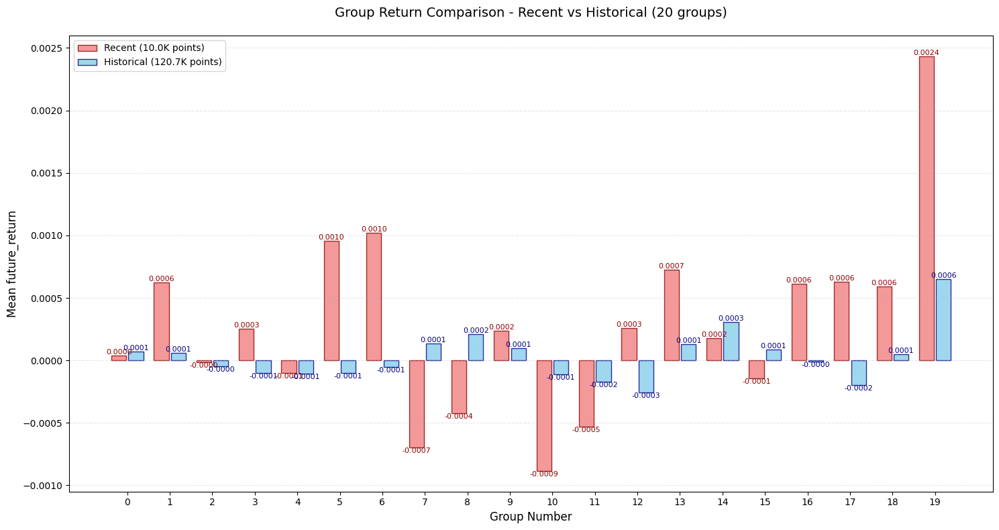

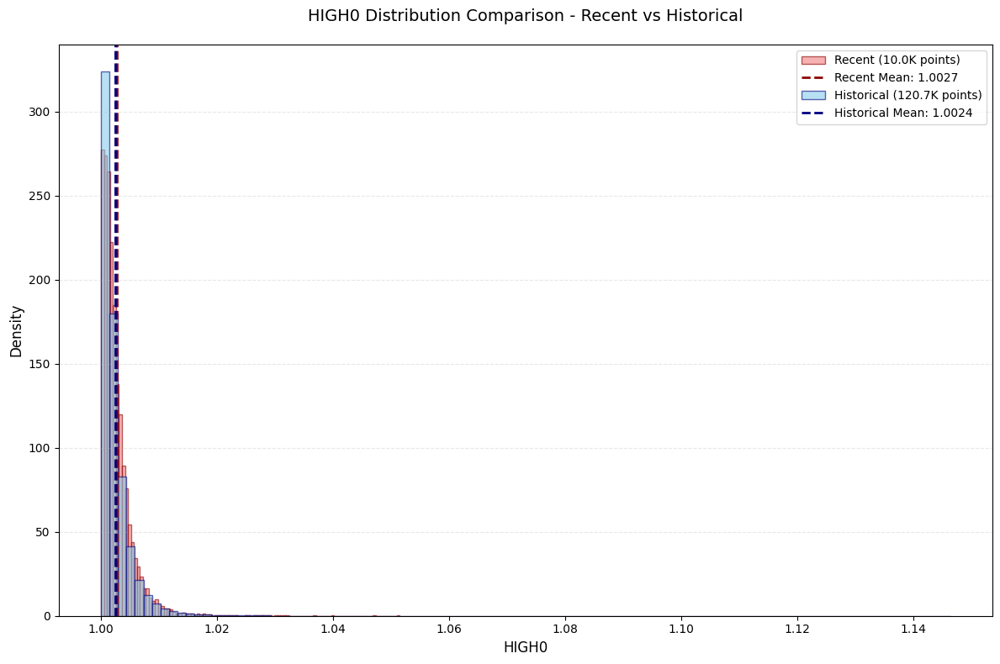

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:   1%|          | 1/143 [00:01<03:03,  1.30s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.020481
   Rank_IC (Spearman): 0.020039
📊 信息比率:
   IR: 0.304539
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130745
   因子列: KLEN
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


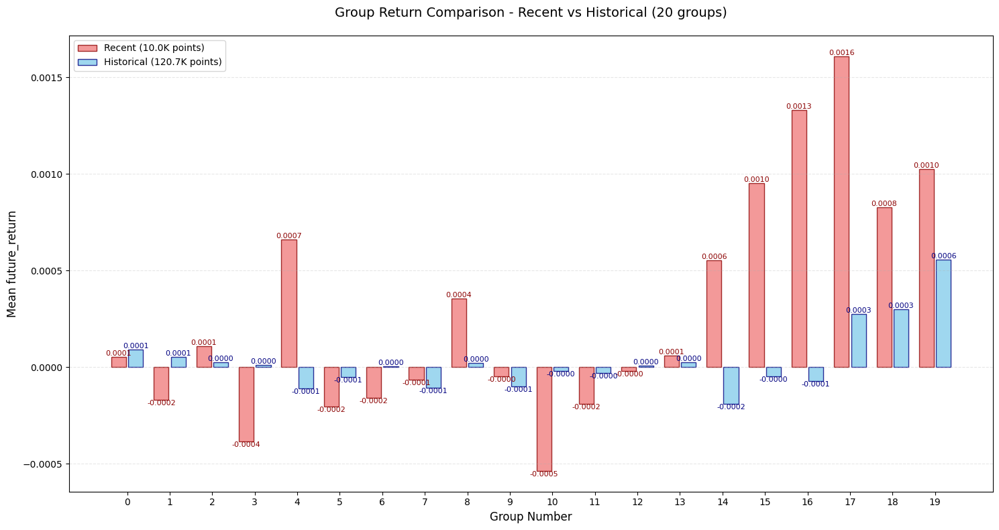

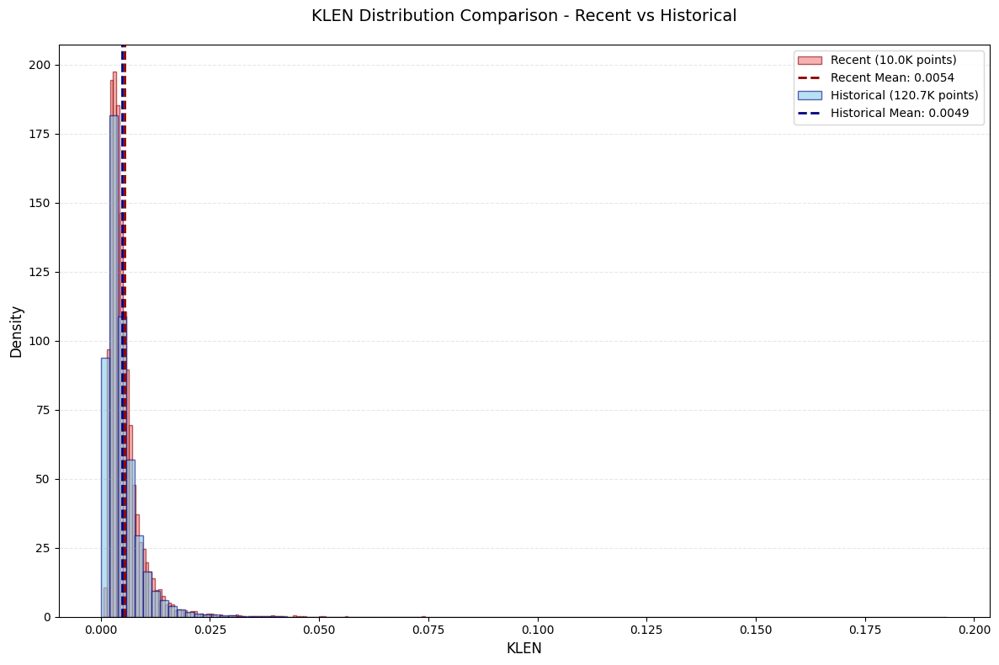

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:   1%|▏         | 2/143 [00:02<02:50,  1.21s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.000961
   Rank_IC (Spearman): 0.006880
📊 信息比率:
   IR: 0.025401
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130745
   因子列: KLOW1
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


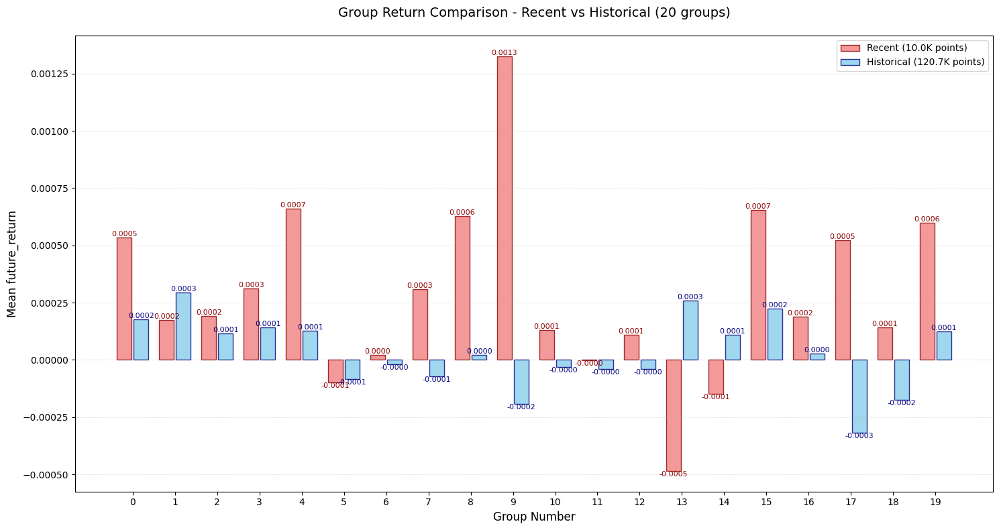

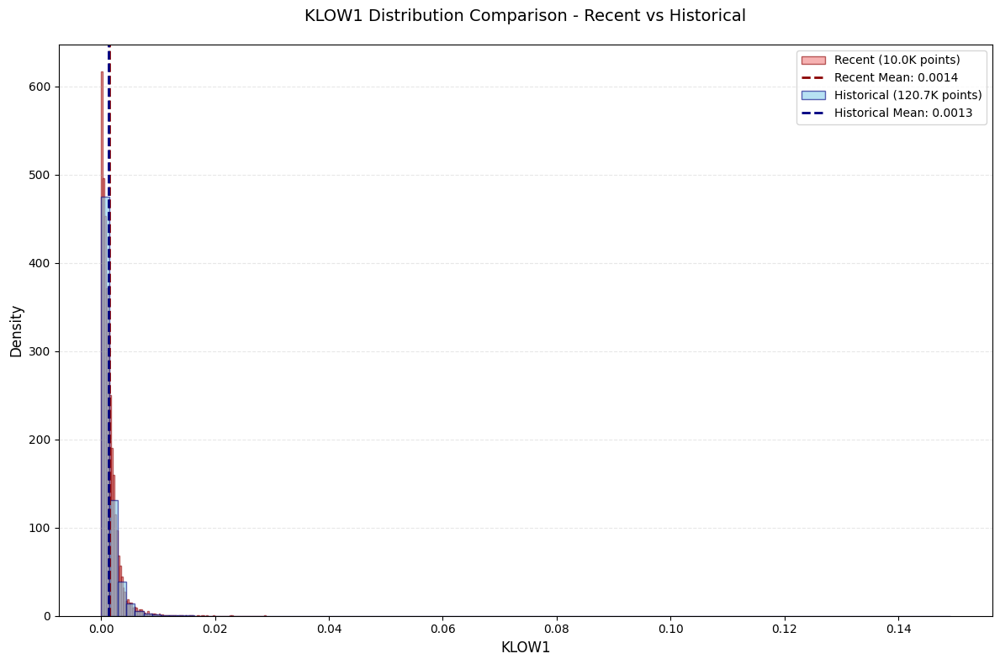

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:   2%|▏         | 3/143 [00:03<02:47,  1.19s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.010970
   Rank_IC (Spearman): -0.007431
📊 信息比率:
   IR: -0.092067
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130745
   因子列: KLOW2
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


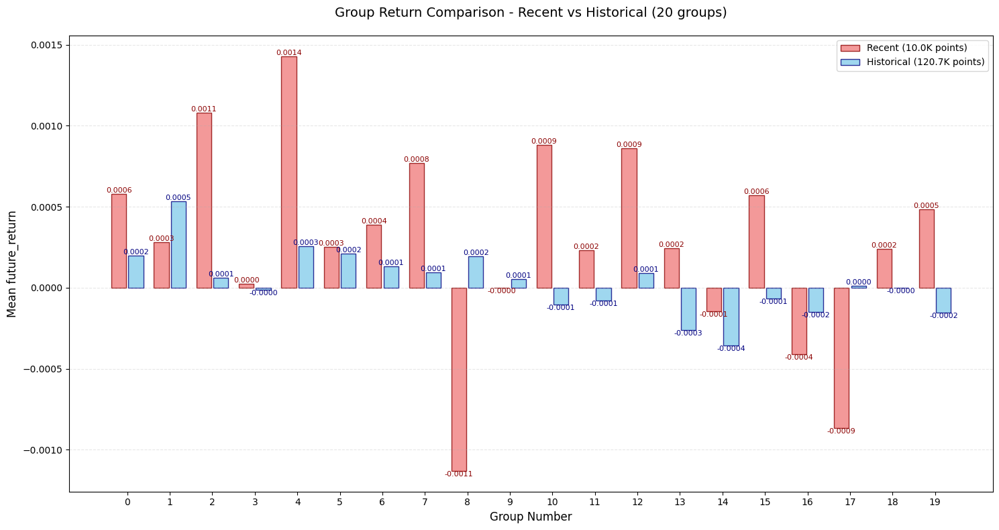

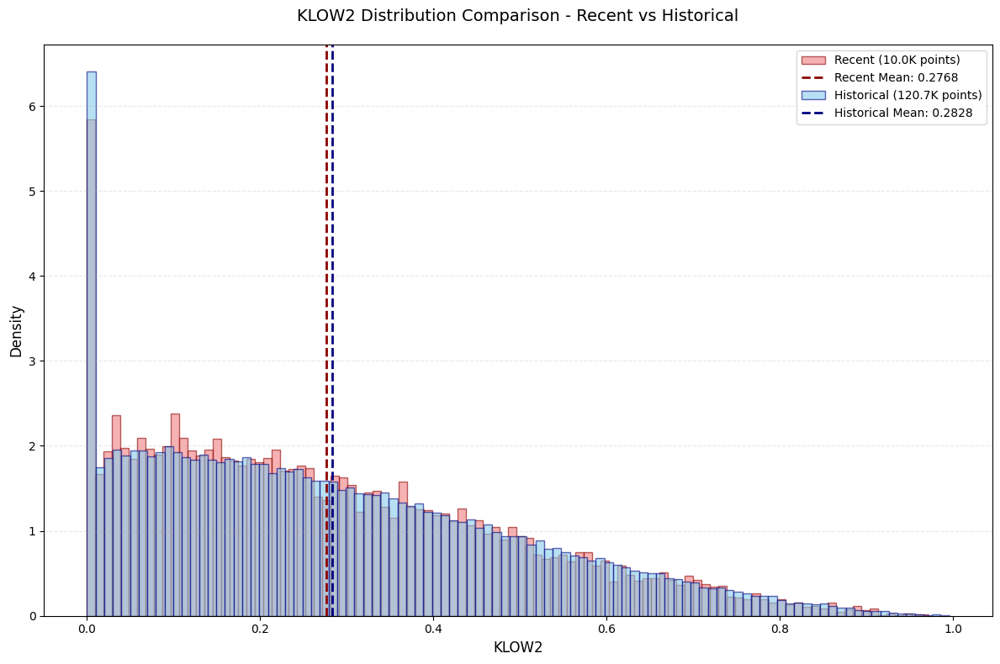

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:   3%|▎         | 4/143 [00:04<02:48,  1.22s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.000399
   Rank_IC (Spearman): -0.016899
📊 信息比率:
   IR: -0.094468
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130745
   因子列: KMID1
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


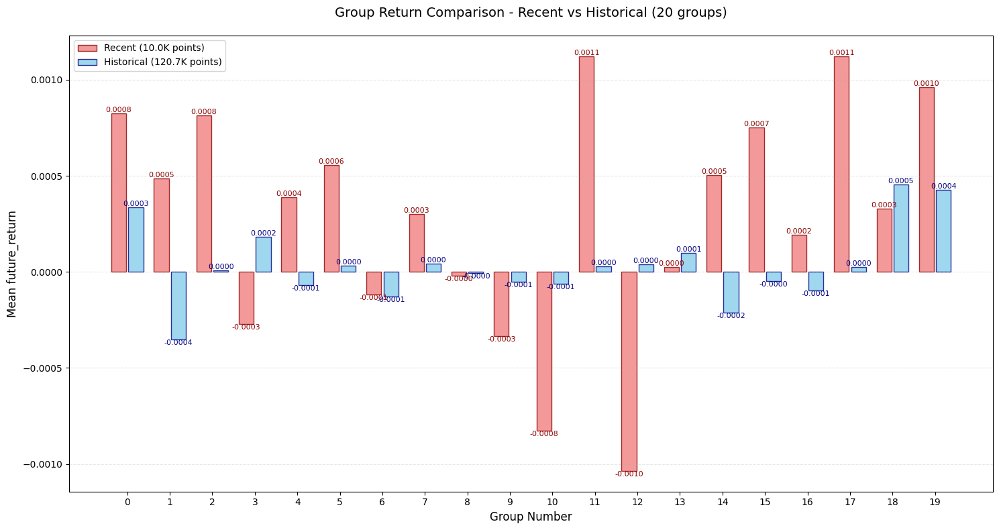

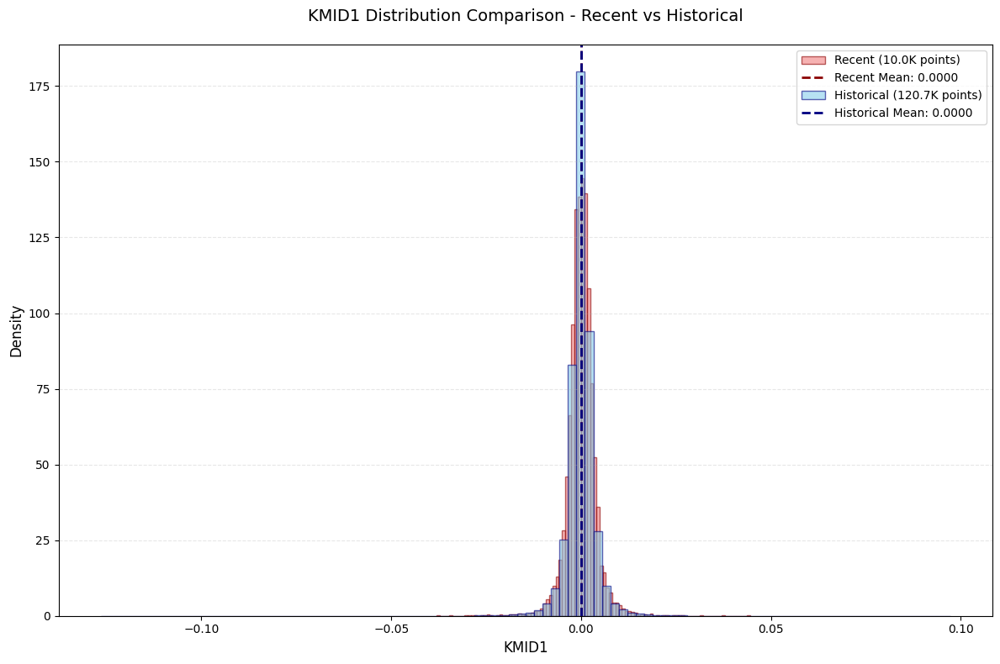

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:   3%|▎         | 5/143 [00:06<02:45,  1.20s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.004824
   Rank_IC (Spearman): -0.014645
📊 信息比率:
   IR: 0.022127
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130745
   因子列: KMID2
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


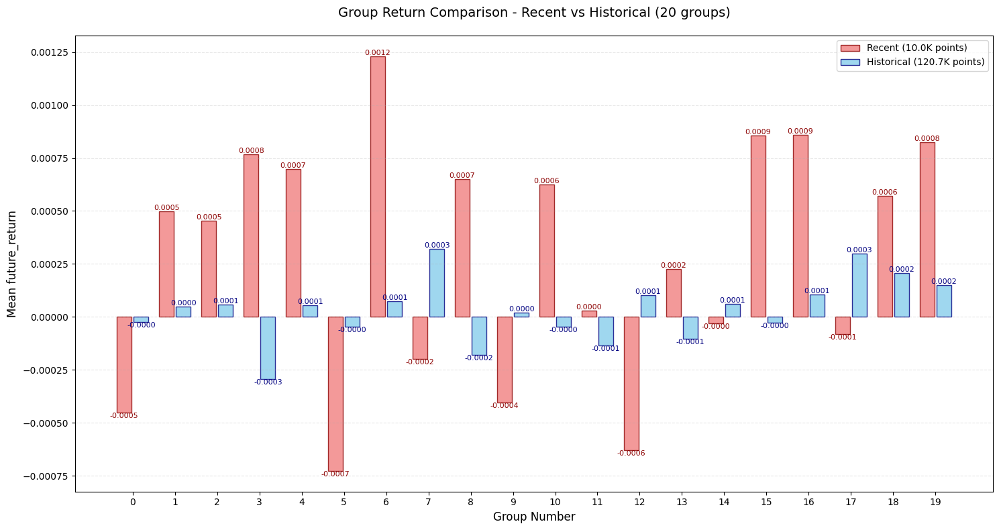

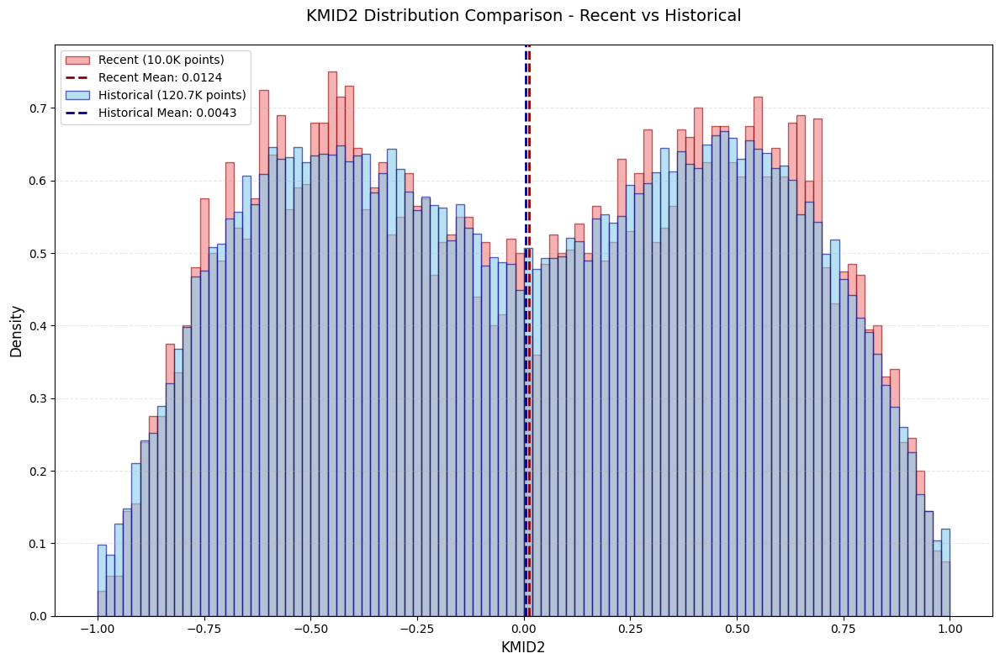

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:   4%|▍         | 6/143 [00:07<02:44,  1.20s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.007518
   Rank_IC (Spearman): -0.015739
📊 信息比率:
   IR: -0.494114
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130745
   因子列: KSFT1
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


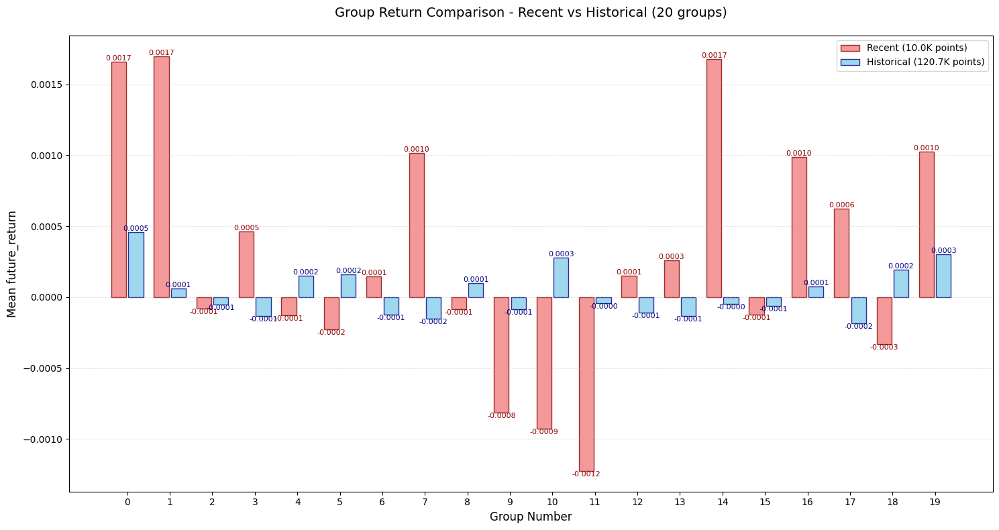

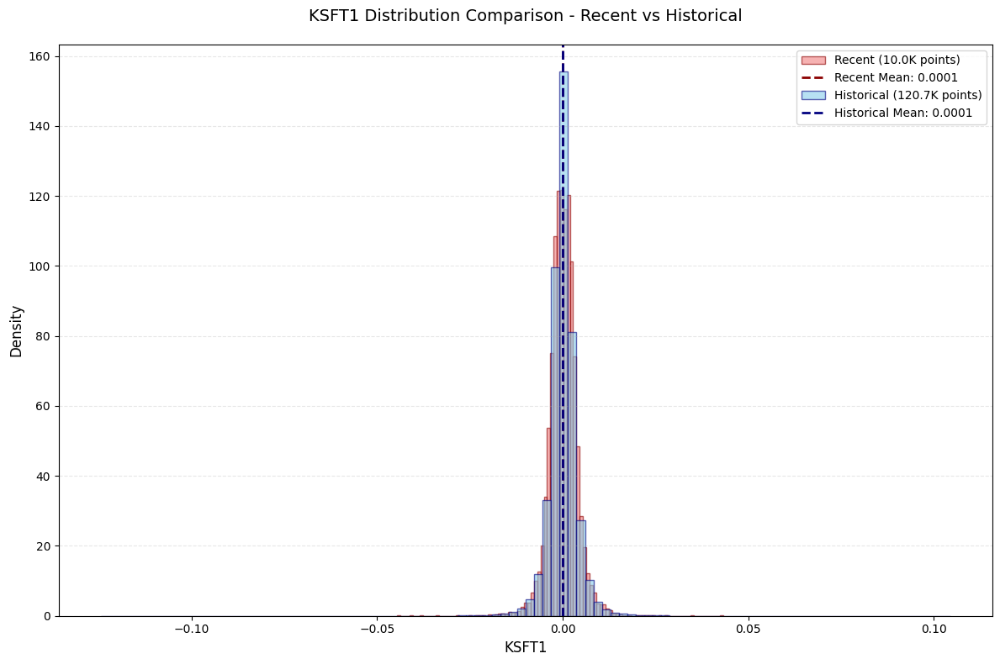

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:   5%|▍         | 7/143 [00:08<02:46,  1.23s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.001979
   Rank_IC (Spearman): -0.015511
📊 信息比率:
   IR: -0.160268
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130745
   因子列: KSFT2
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


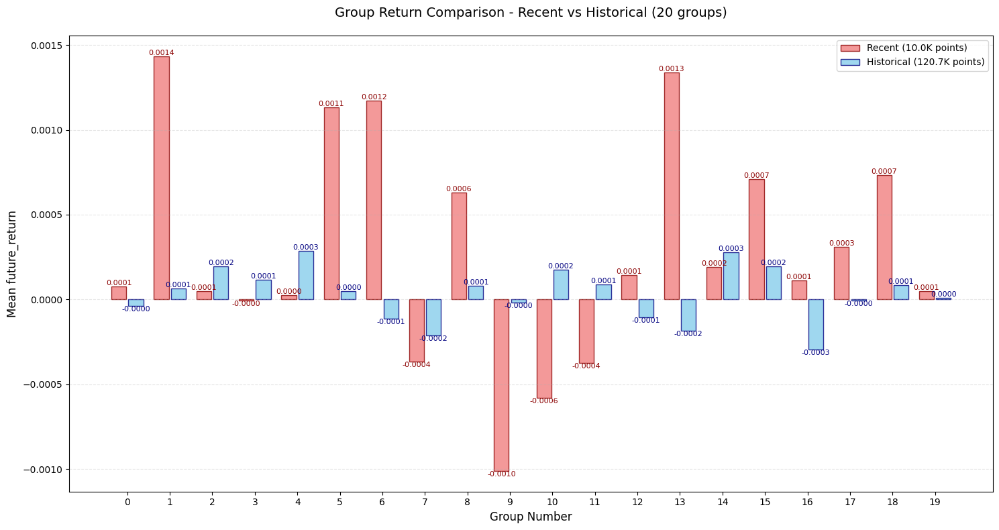

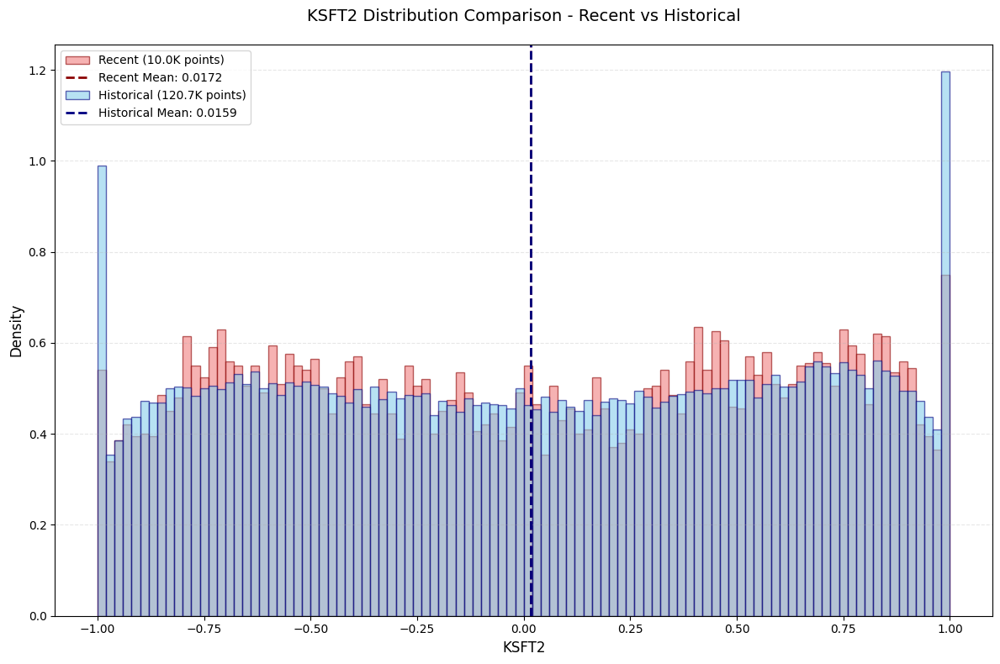

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:   6%|▌         | 8/143 [00:09<02:43,  1.21s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.018682
   Rank_IC (Spearman): 0.012644
📊 信息比率:
   IR: 0.152124
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130745
   因子列: KUP1
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


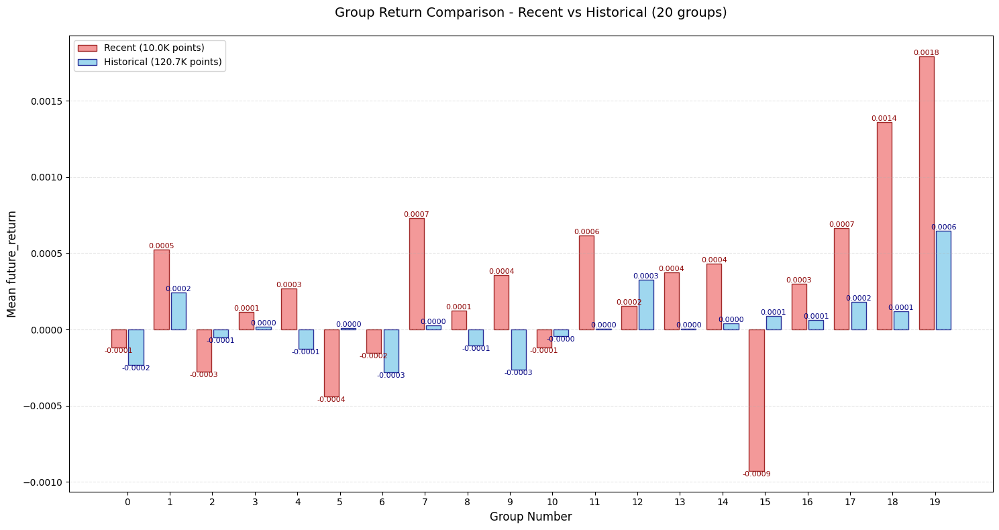

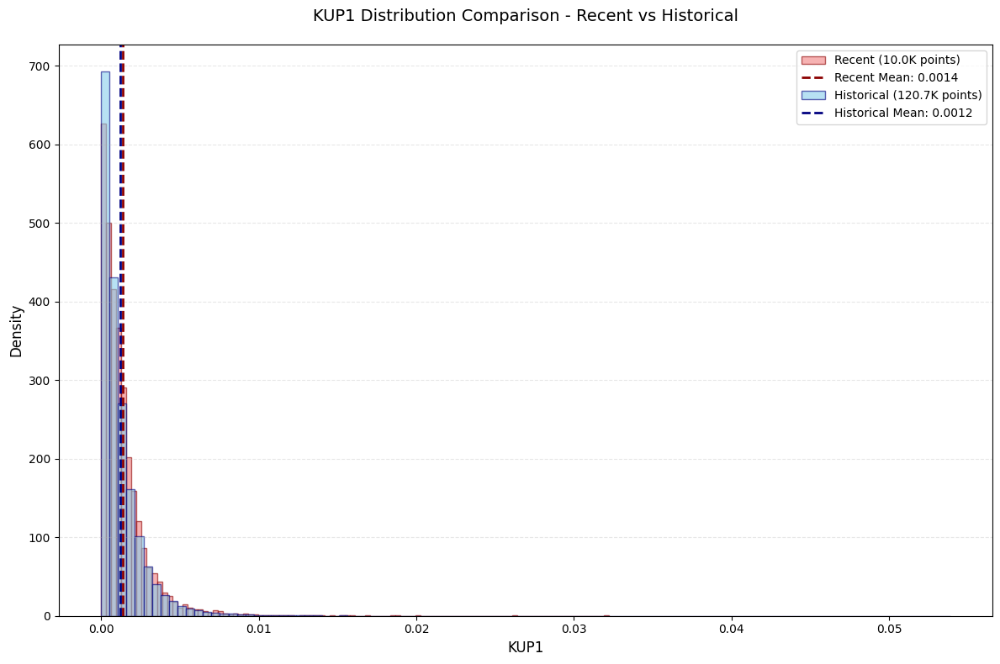

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:   6%|▋         | 9/143 [00:10<02:39,  1.19s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.006337
   Rank_IC (Spearman): 0.000770
📊 信息比率:
   IR: 0.218386
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130745
   因子列: KUP2
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


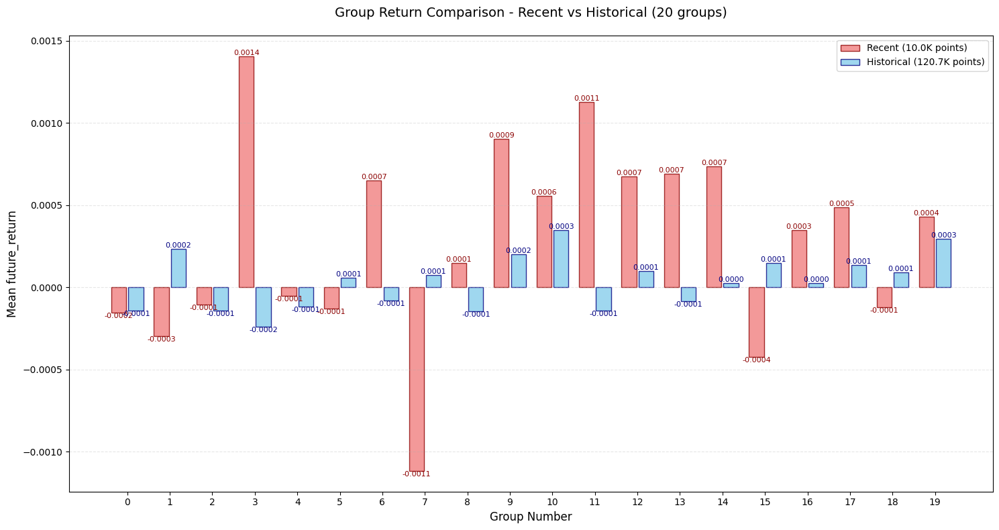

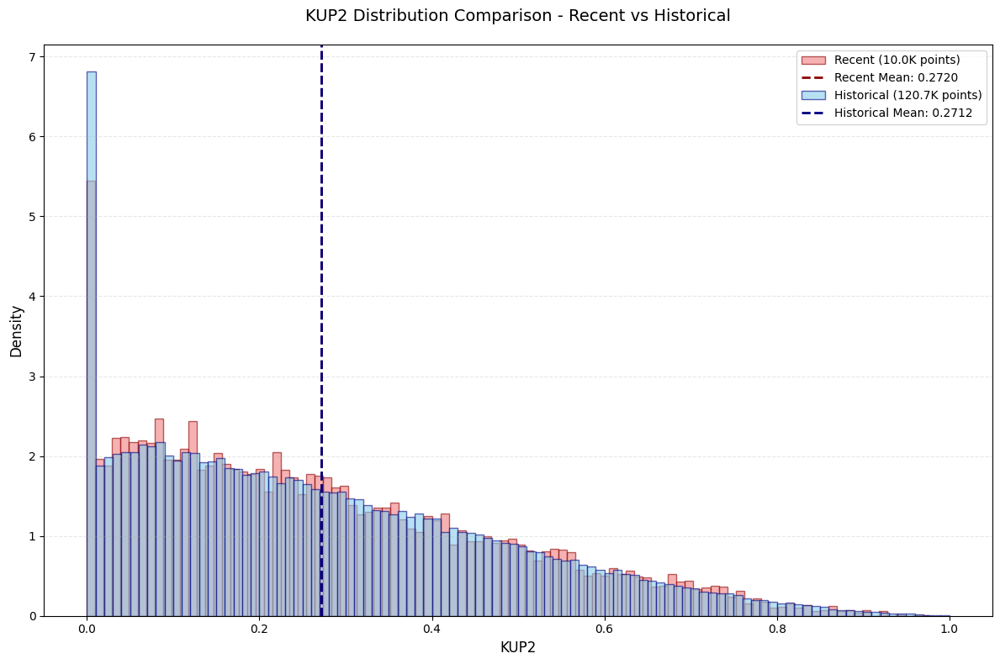

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:   7%|▋         | 10/143 [00:12<02:41,  1.22s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.010540
   Rank_IC (Spearman): -0.001767
📊 信息比率:
   IR: -0.526348
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130745
   因子列: LOW0
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


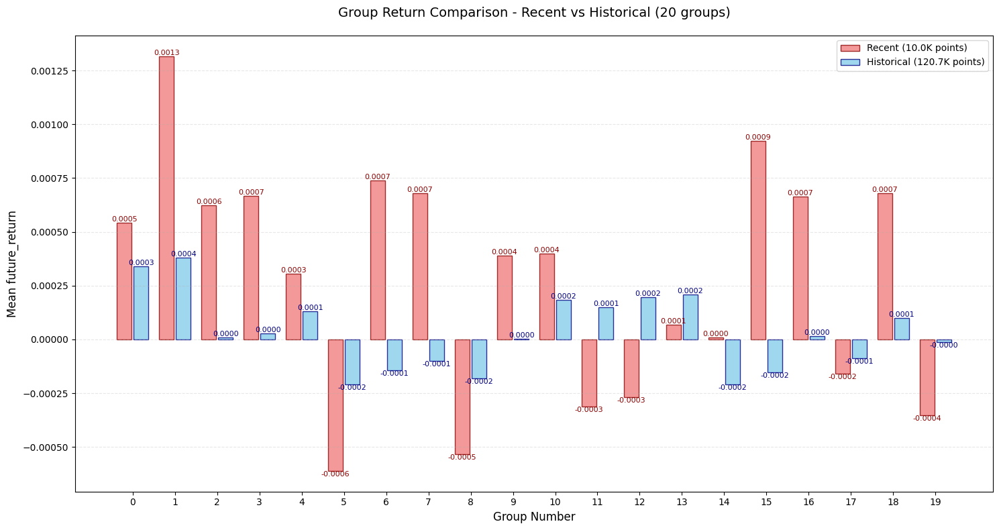

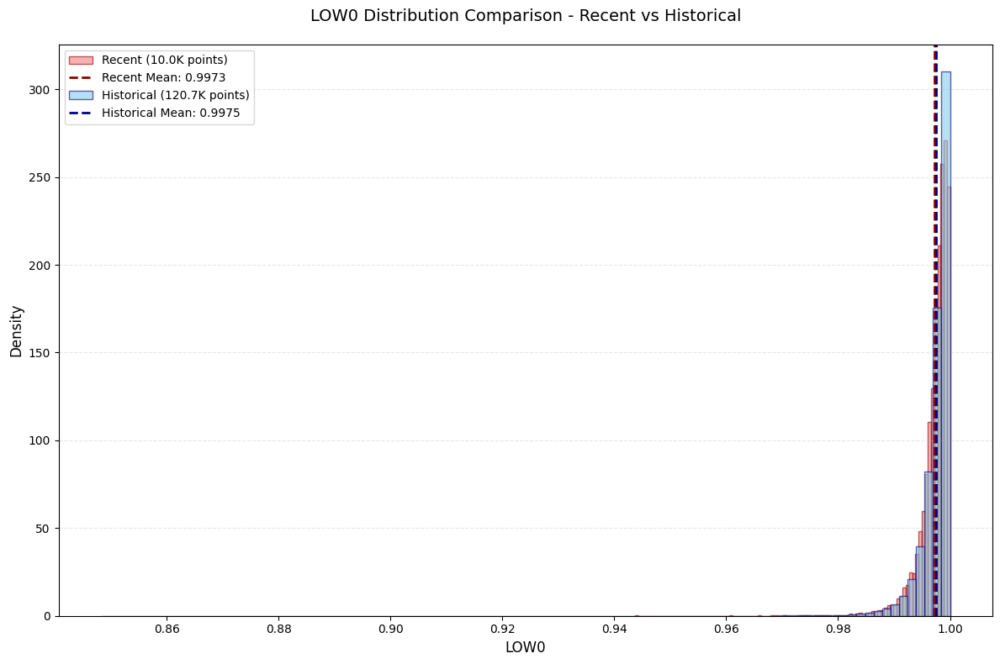

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:   8%|▊         | 11/143 [00:13<02:39,  1.21s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.001234
   Rank_IC (Spearman): 0.016899
📊 信息比率:
   IR: 0.103762
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130745
   因子列: OPEN0
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


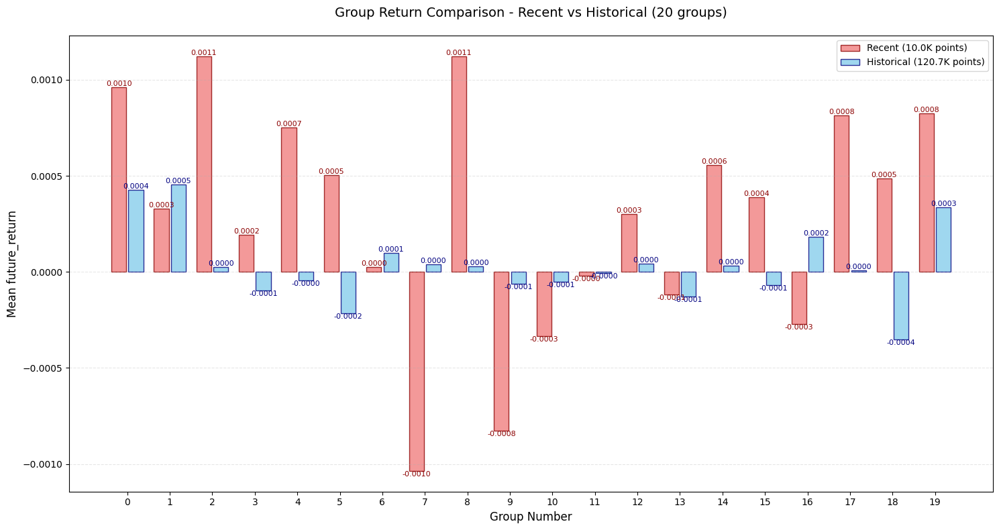

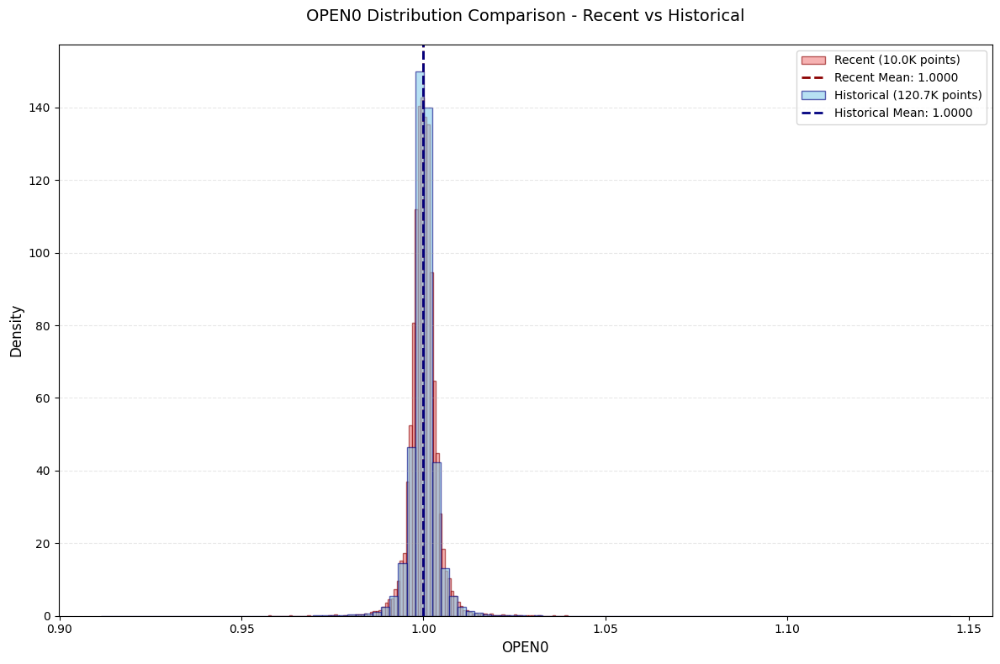

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:   8%|▊         | 12/143 [00:14<02:37,  1.20s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.009711
   Rank_IC (Spearman): 0.012715
📊 信息比率:
   IR: 0.409493
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130745
   因子列: VWAP0
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


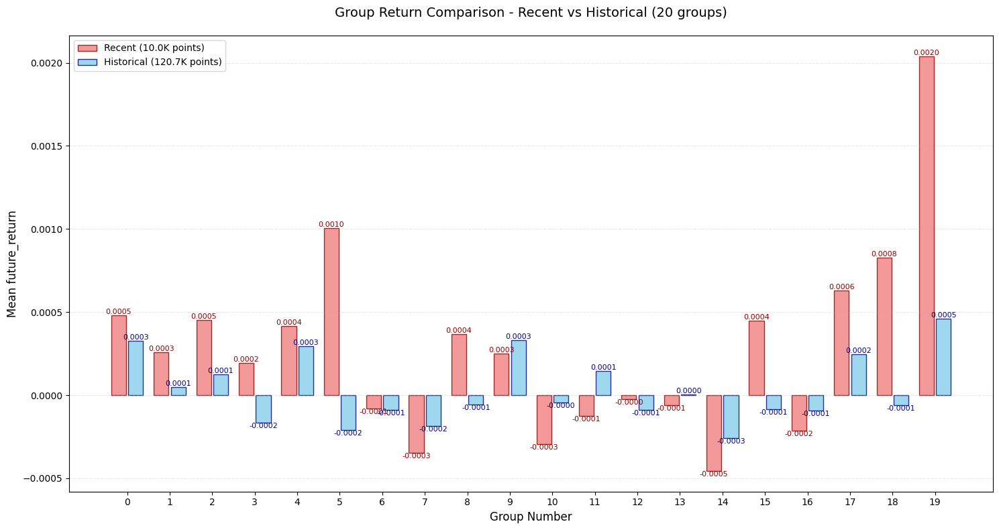

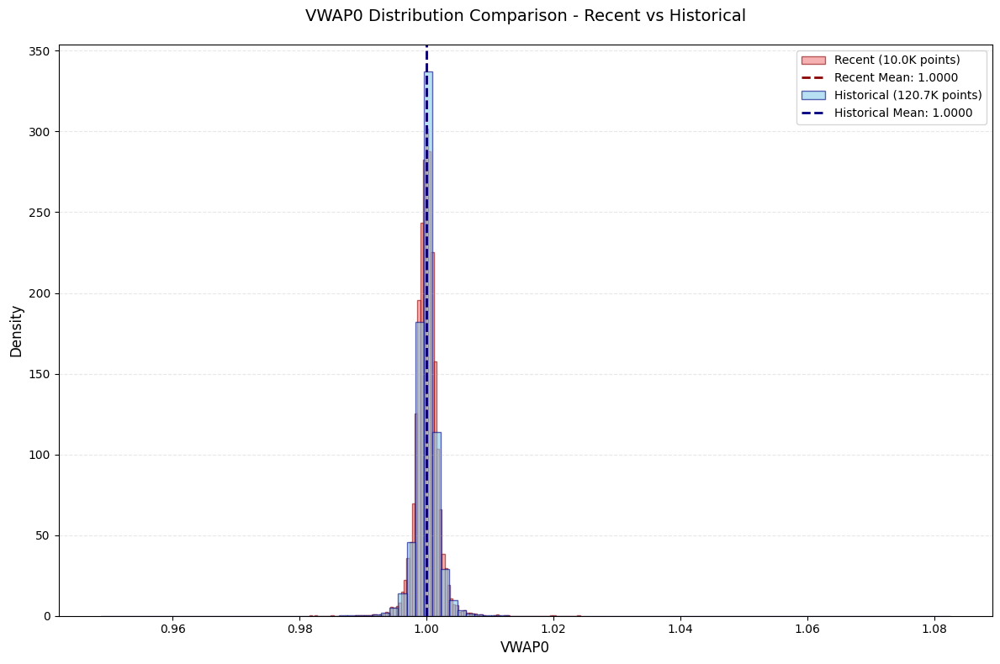

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:   9%|▉         | 13/143 [00:15<02:39,  1.22s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.020598
   Rank_IC (Spearman): 0.020489
📊 信息比率:
   IR: 0.150540
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130741
   因子列: STD_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


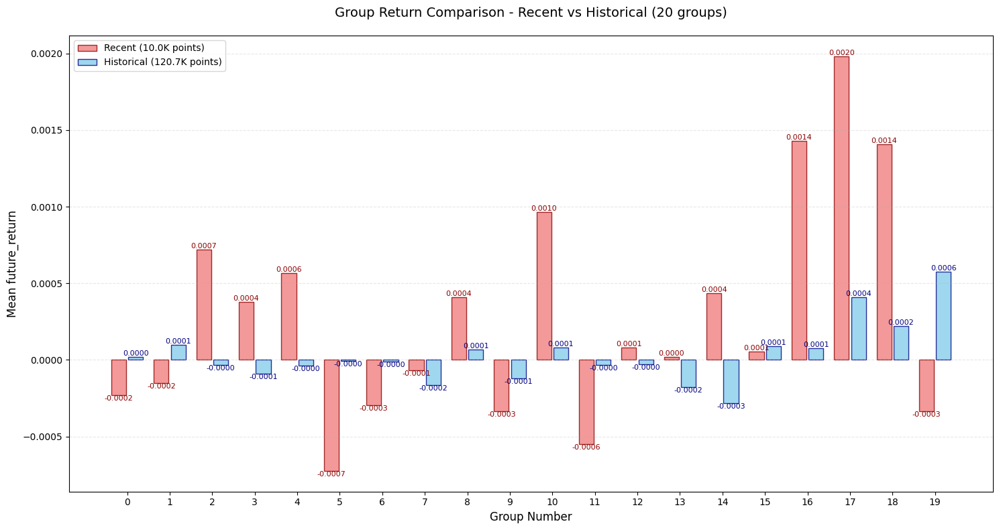

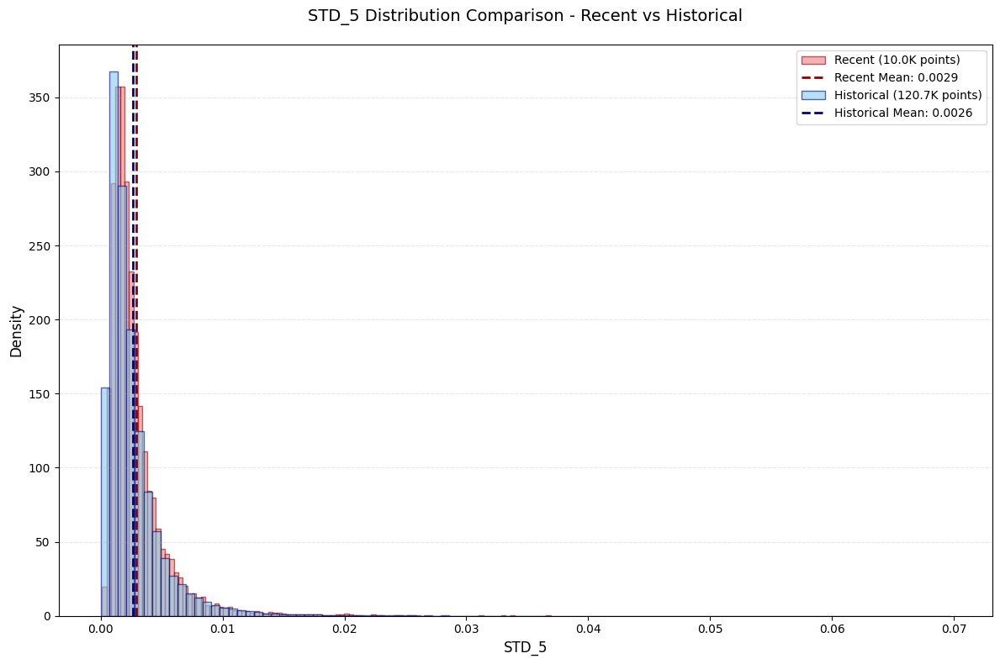

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  10%|▉         | 14/143 [00:16<02:36,  1.21s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.019062
   Rank_IC (Spearman): 0.022232
📊 信息比率:
   IR: 0.232206
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130736
   因子列: STD_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


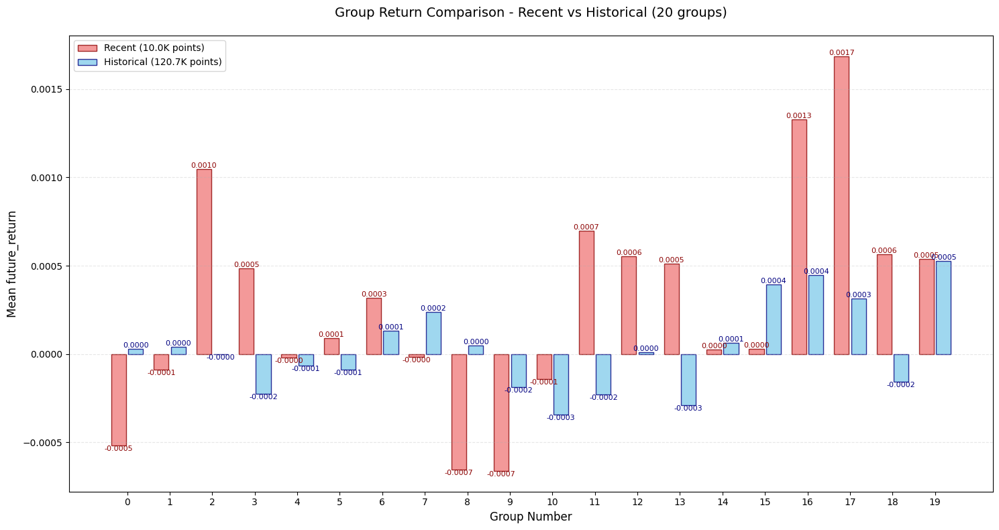

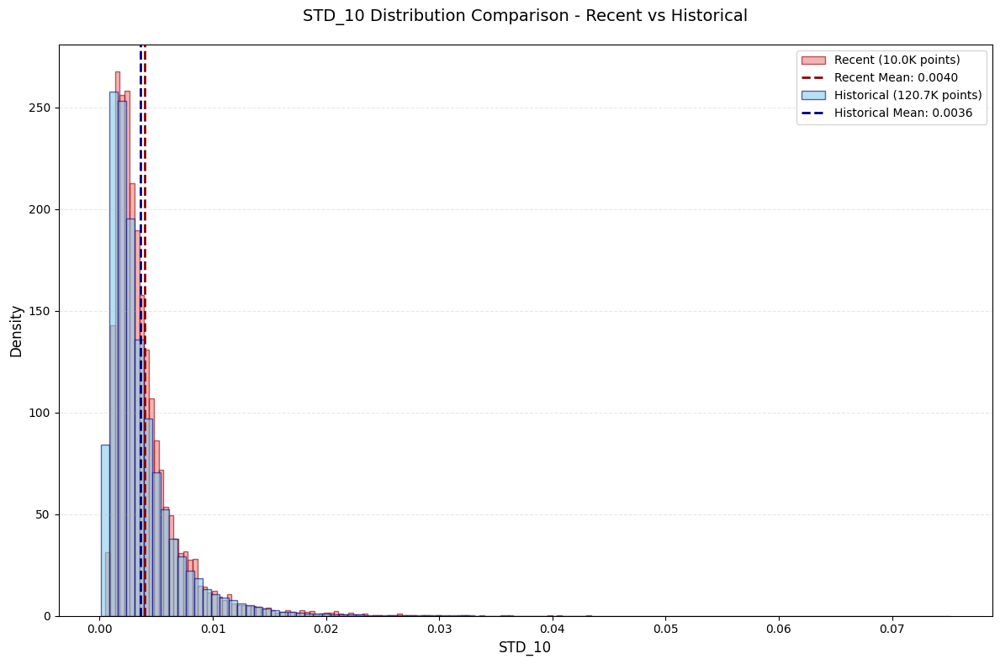

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  10%|█         | 15/143 [00:18<02:32,  1.19s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.014457
   Rank_IC (Spearman): 0.021879
📊 信息比率:
   IR: 0.045007
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130726
   因子列: STD_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


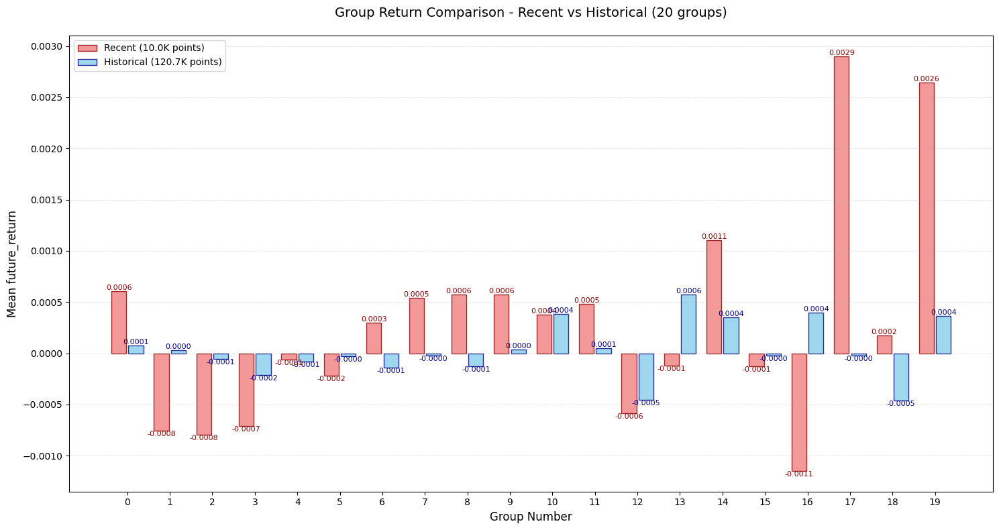

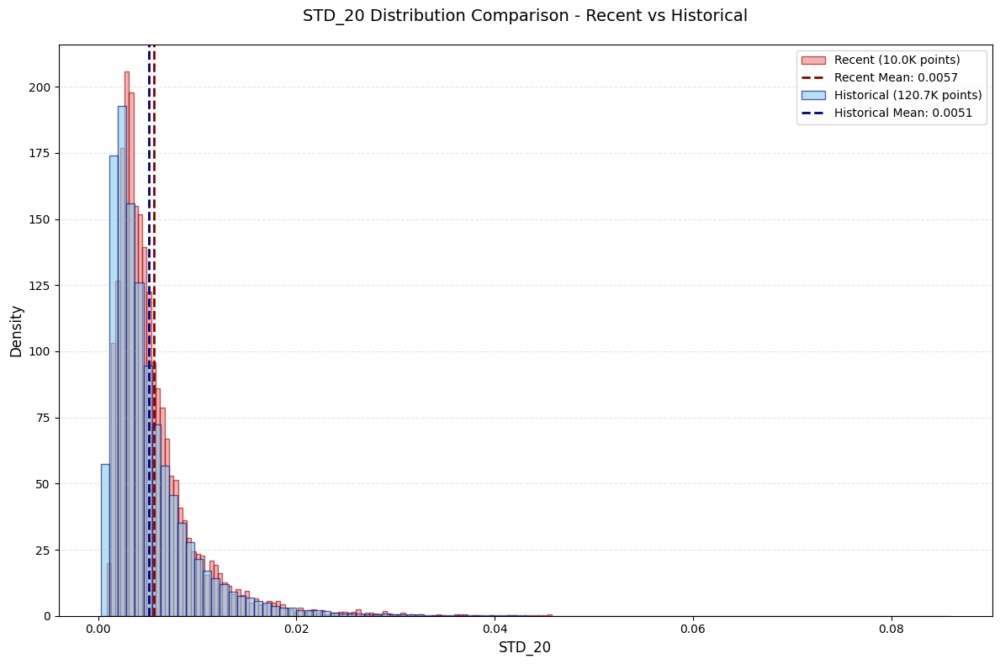

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  11%|█         | 16/143 [00:19<02:31,  1.19s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.014642
   Rank_IC (Spearman): 0.020964
📊 信息比率:
   IR: 0.198084
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130716
   因子列: STD_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


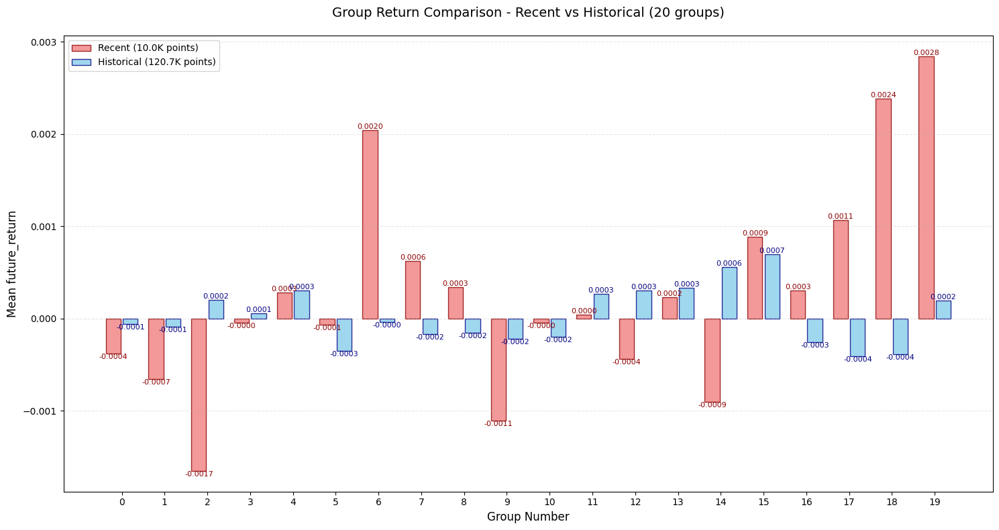

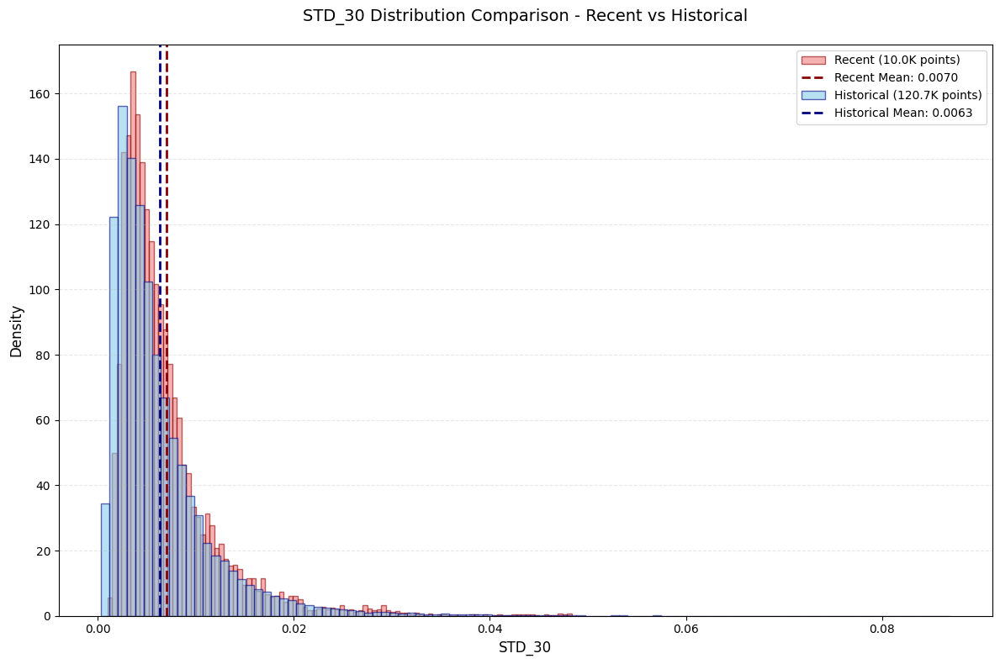

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  12%|█▏        | 17/143 [00:20<02:36,  1.24s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.012461
   Rank_IC (Spearman): 0.018239
📊 信息比率:
   IR: 0.112841
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: STD_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


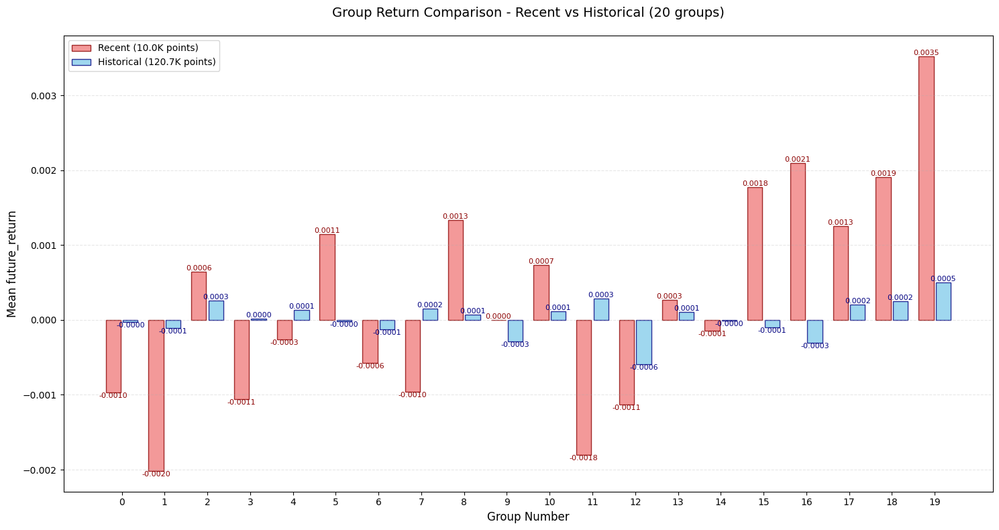

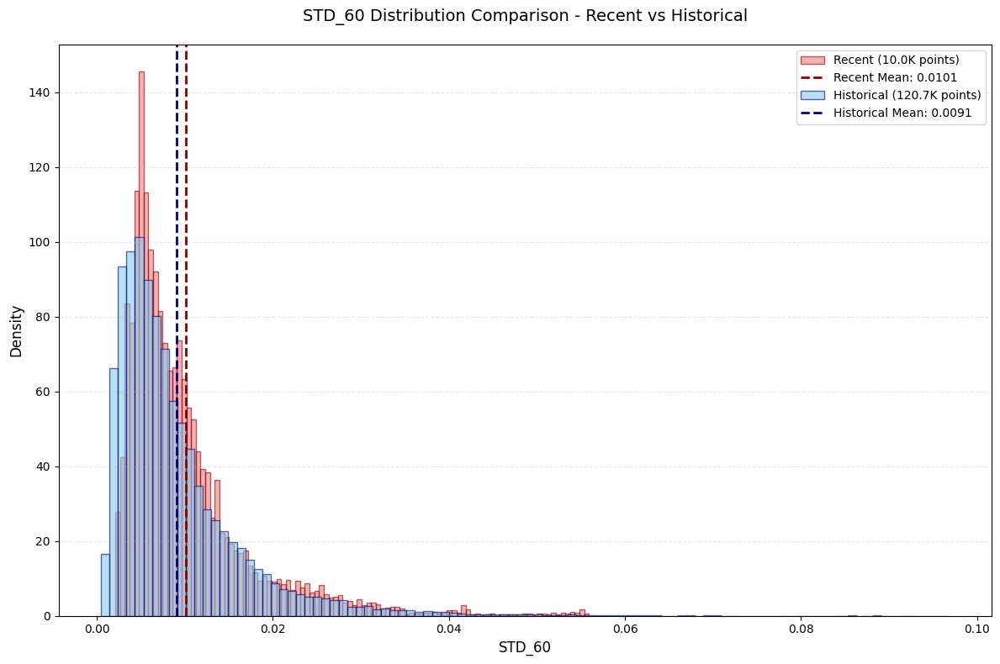

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  13%|█▎        | 18/143 [00:21<02:32,  1.22s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.002613
   Rank_IC (Spearman): -0.027325
📊 信息比率:
   IR: -0.364671
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: BETA_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


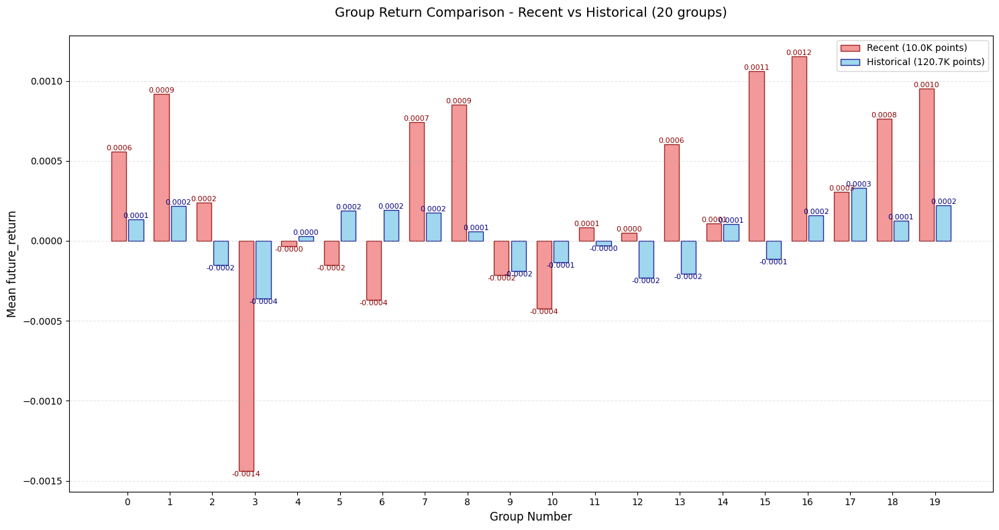

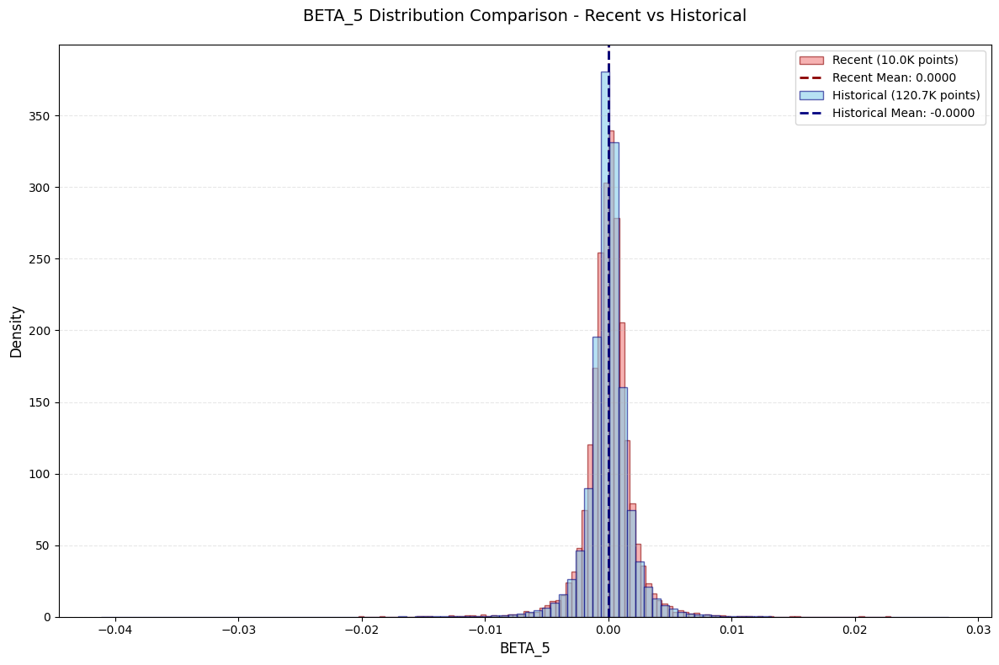

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  13%|█▎        | 19/143 [00:23<02:34,  1.25s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.006116
   Rank_IC (Spearman): -0.016517
📊 信息比率:
   IR: 0.563503
   有效分组数: 5
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTD_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


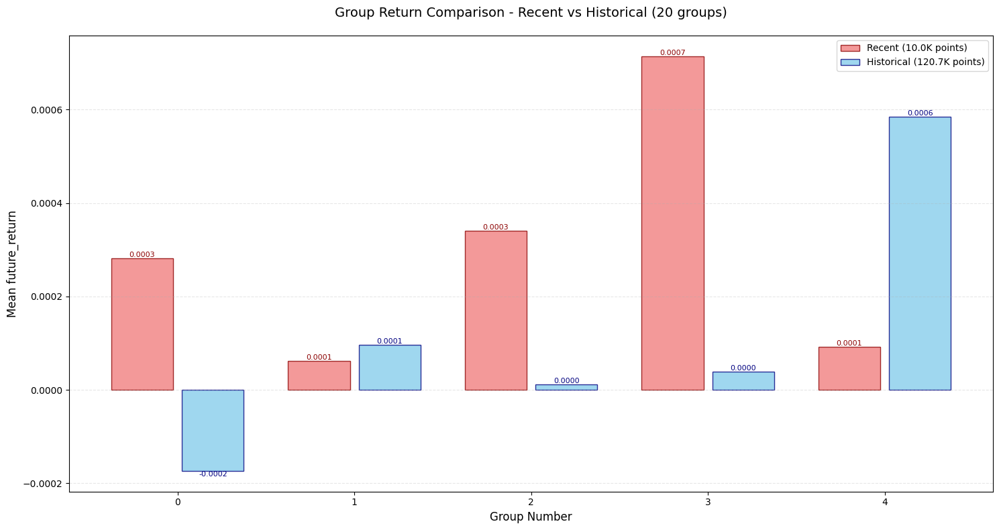

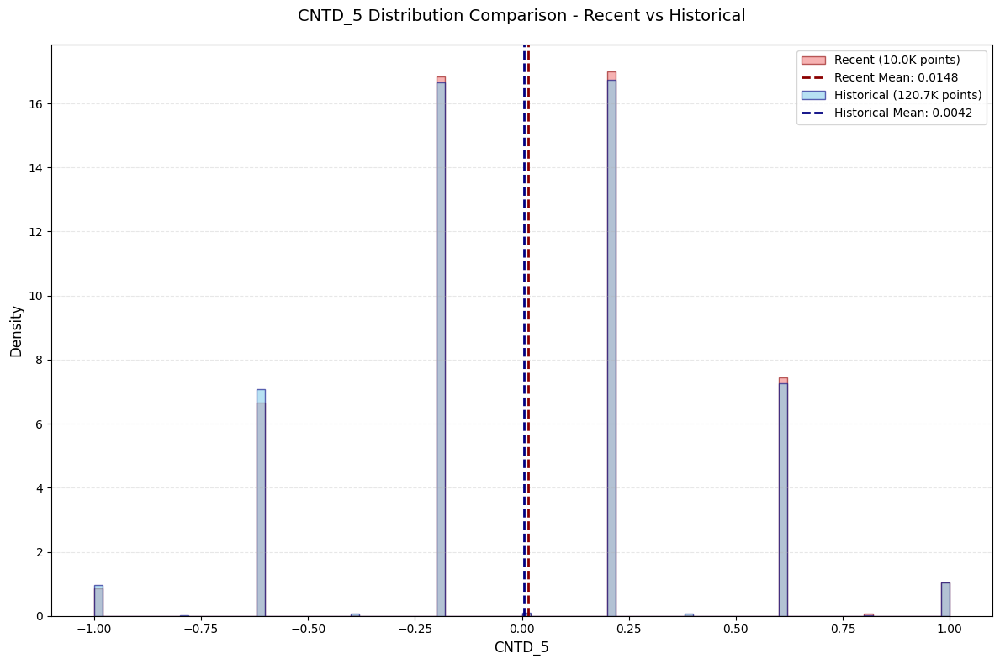

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  14%|█▍        | 20/143 [00:24<02:25,  1.18s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.006275
   Rank_IC (Spearman): -0.016497
📊 信息比率:
   IR: nan
   有效分组数: 5
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTP_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


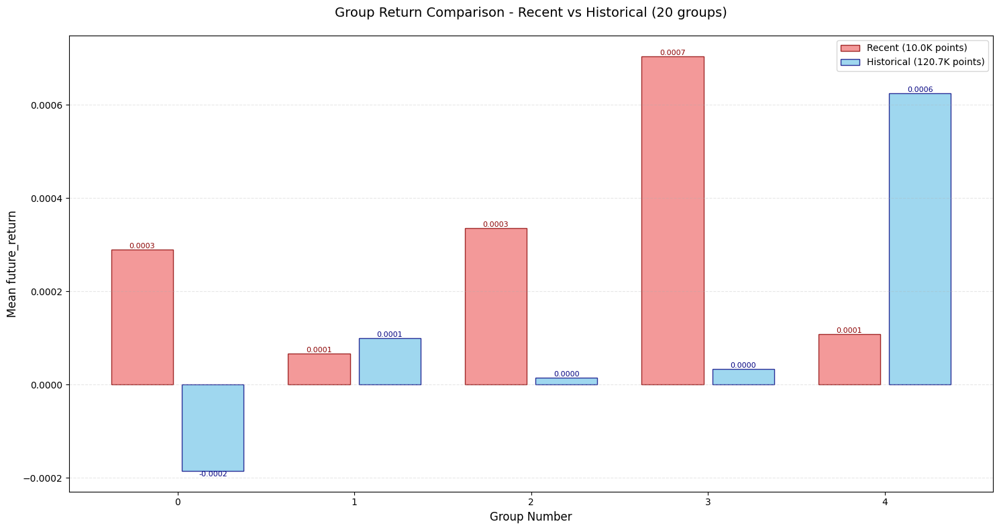

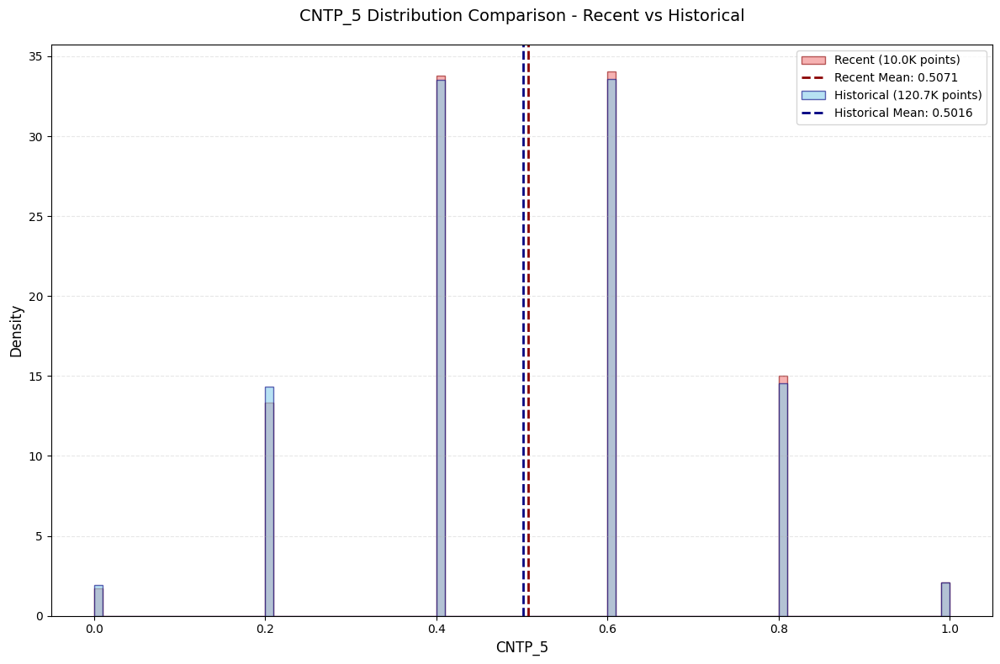

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  15%|█▍        | 21/143 [00:25<02:17,  1.12s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.005950
   Rank_IC (Spearman): 0.016630
📊 信息比率:
   IR: nan
   有效分组数: 5
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTN_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


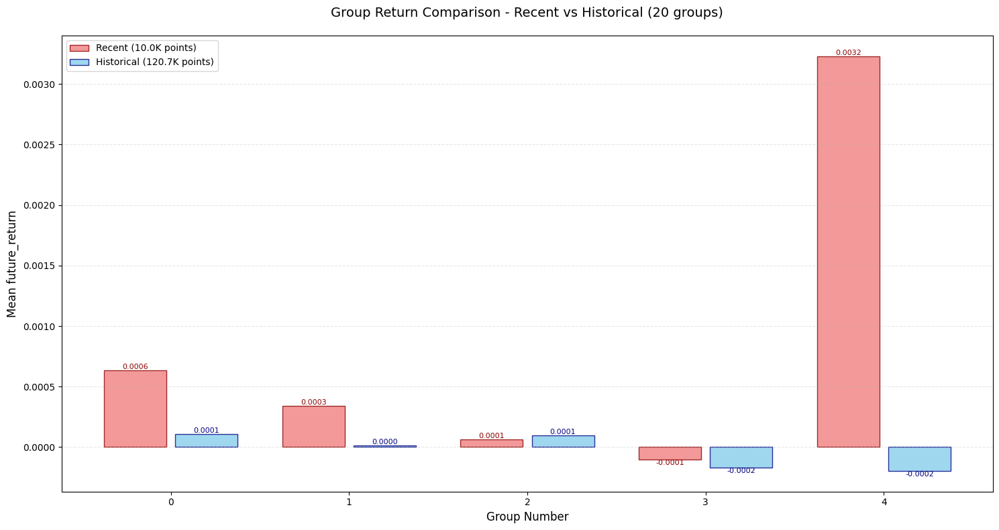

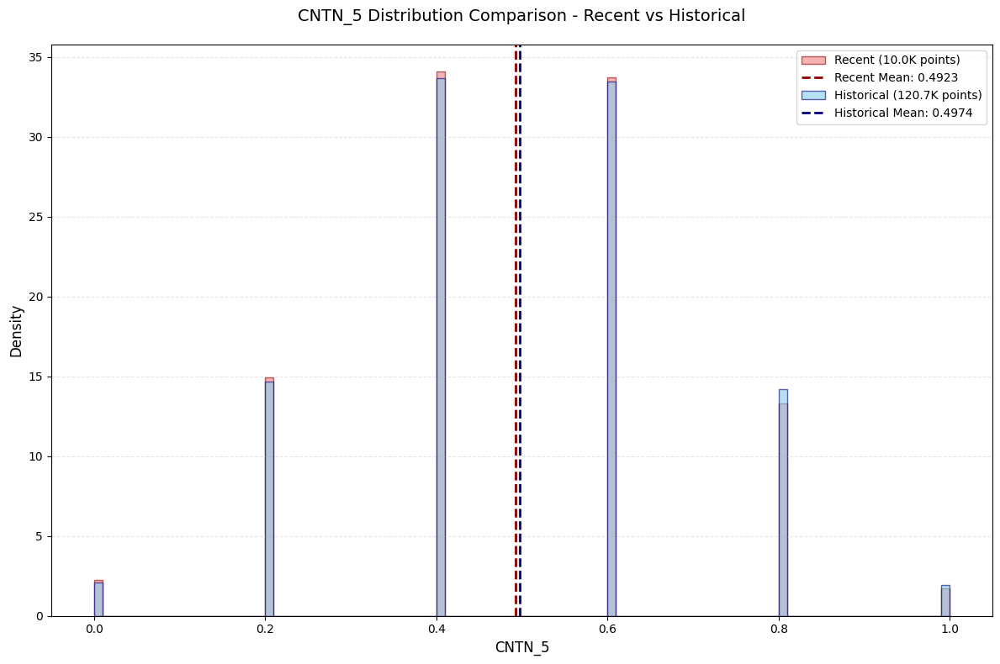

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  15%|█▌        | 22/143 [00:26<02:11,  1.09s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.015705
   Rank_IC (Spearman): 0.028027
📊 信息比率:
   IR: 0.069159
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MAX_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


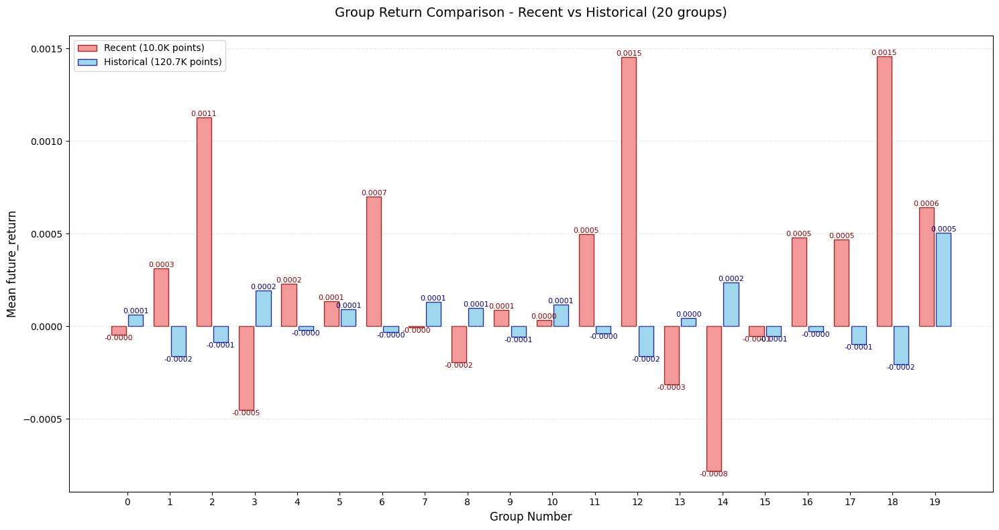

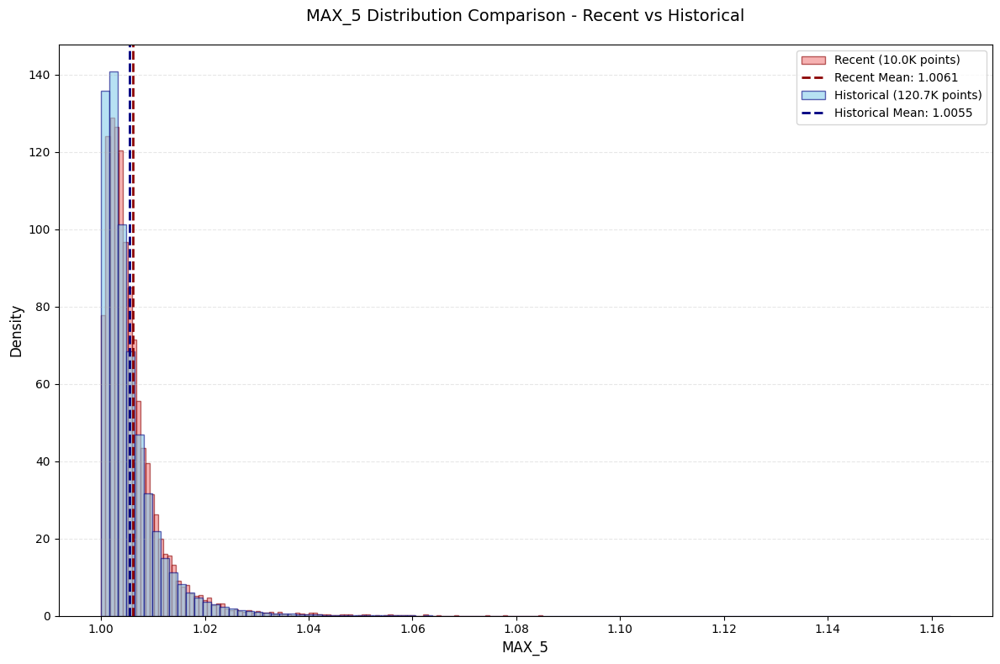

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  16%|█▌        | 23/143 [00:27<02:19,  1.16s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.014827
   Rank_IC (Spearman): -0.000017
📊 信息比率:
   IR: -0.286121
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MIN_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


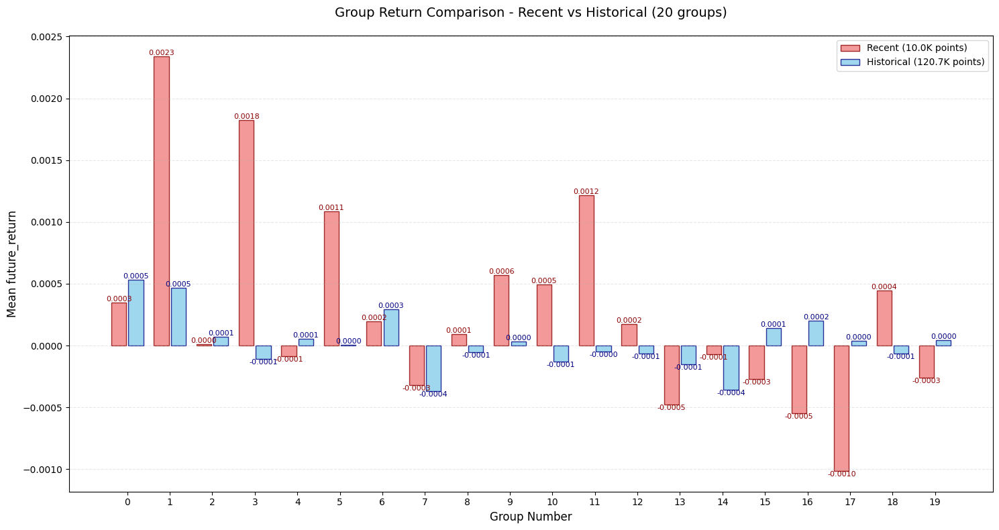

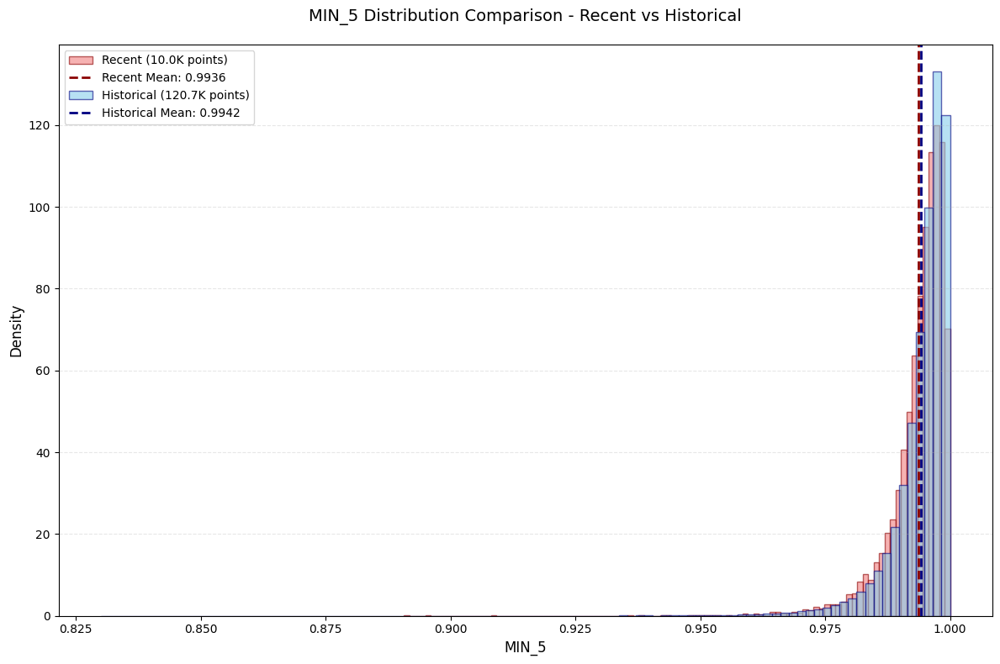

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  17%|█▋        | 24/143 [00:28<02:20,  1.18s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.003685
   Rank_IC (Spearman): 0.030027
📊 信息比率:
   IR: 0.085450
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: ROC_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


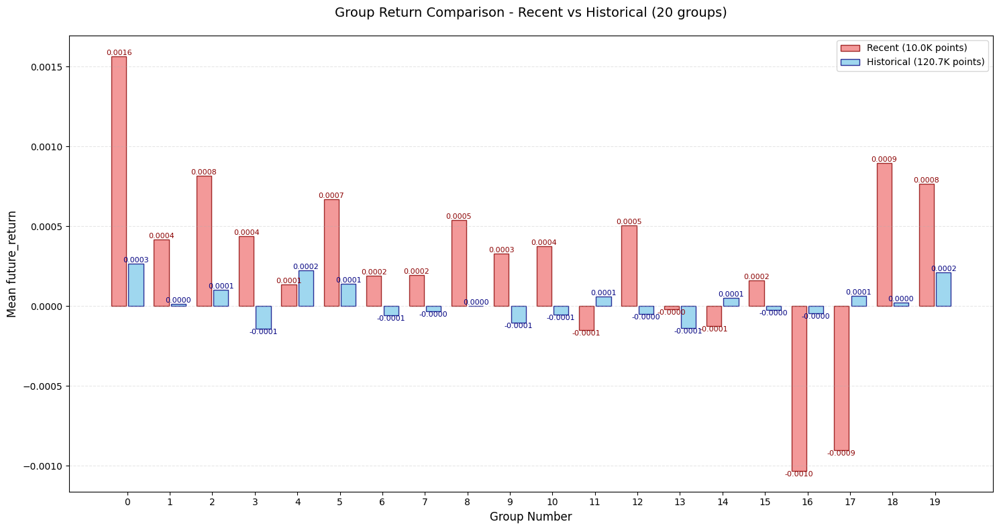

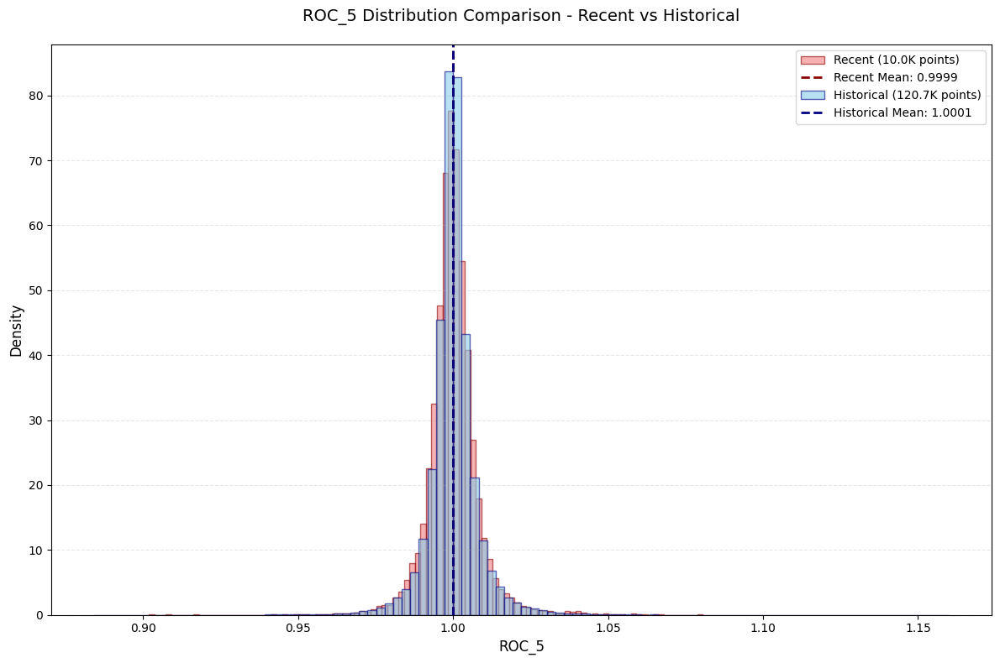

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  17%|█▋        | 25/143 [00:29<02:19,  1.18s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.003584
   Rank_IC (Spearman): -0.021085
📊 信息比率:
   IR: 0.108621
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RSV_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


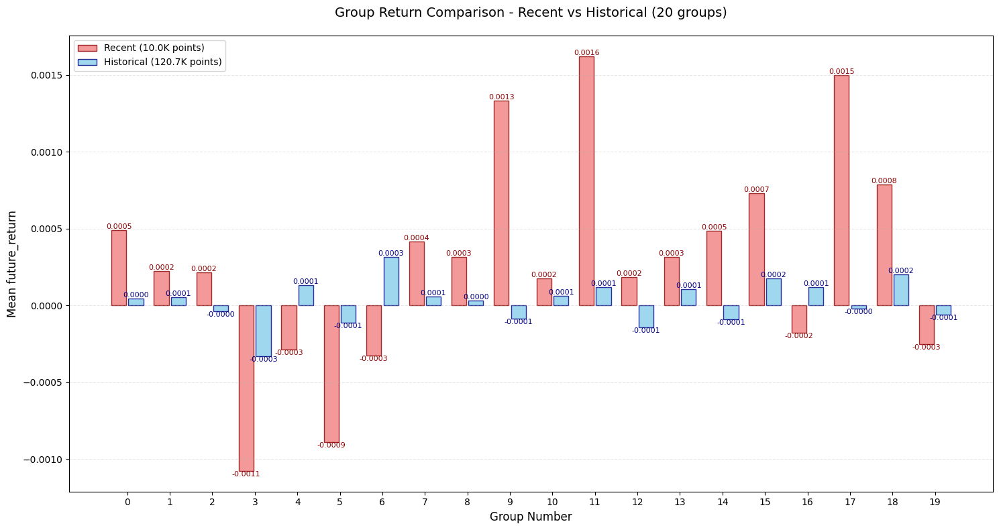

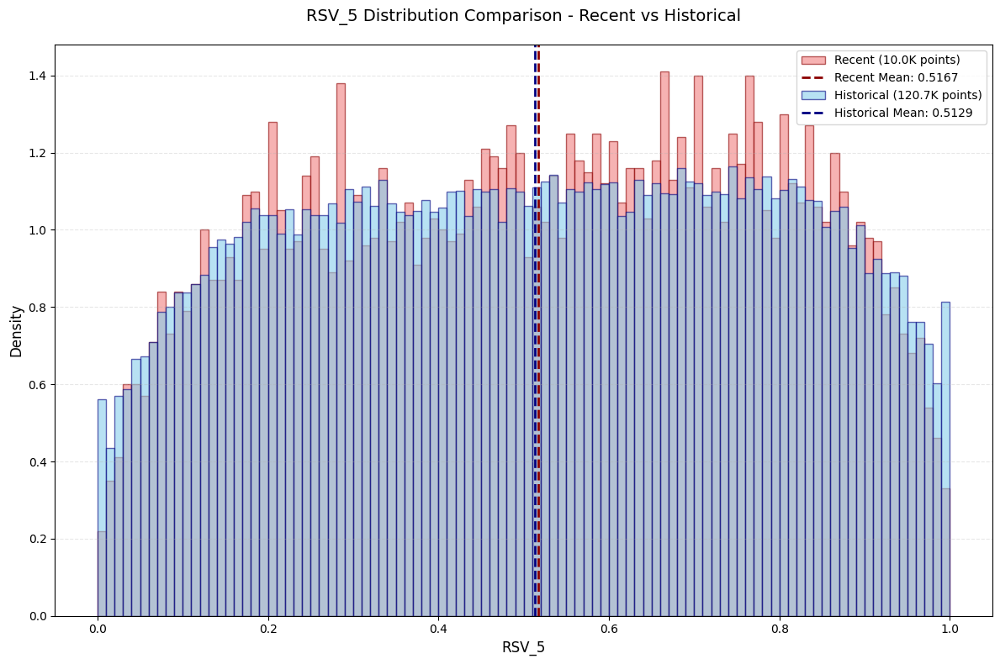

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  18%|█▊        | 26/143 [00:31<02:24,  1.23s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.006415
   Rank_IC (Spearman): -0.026888
📊 信息比率:
   IR: -0.135324
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: SUMP_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


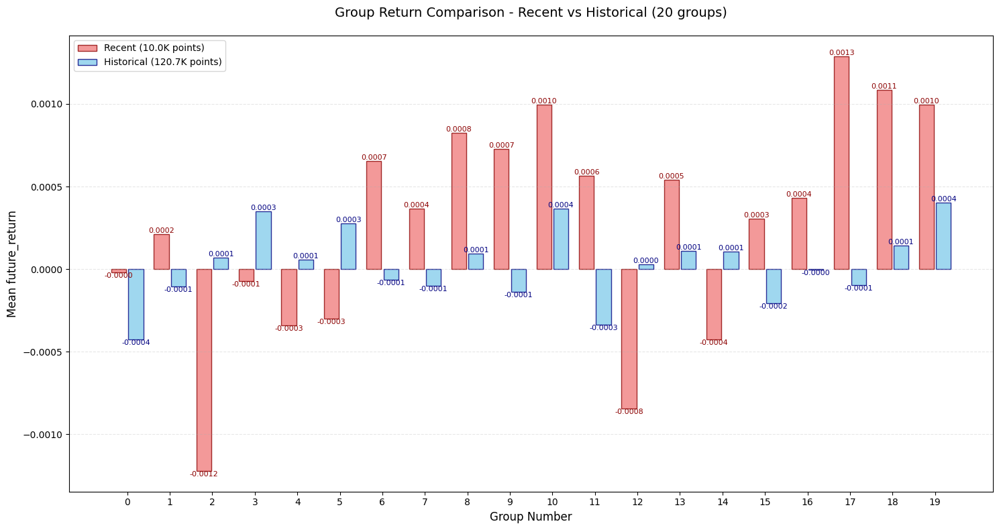

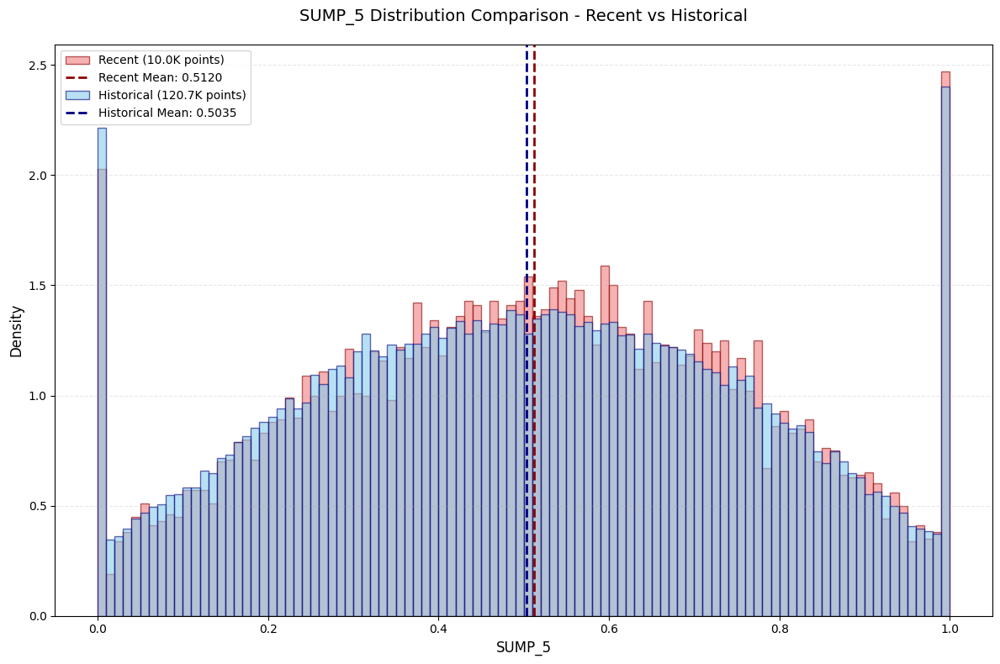

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  19%|█▉        | 27/143 [00:32<02:21,  1.22s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.006415
   Rank_IC (Spearman): 0.026895
📊 信息比率:
   IR: 0.142470
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: SUMN_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


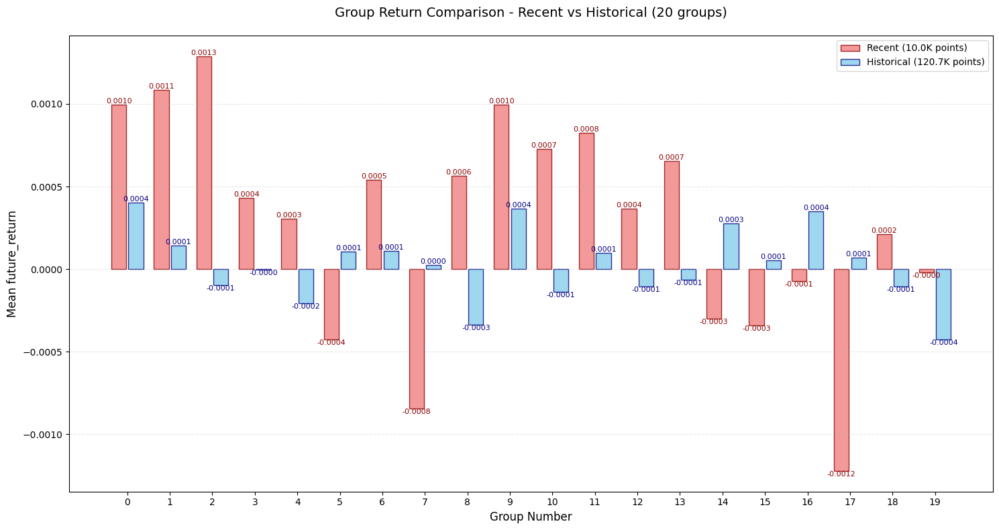

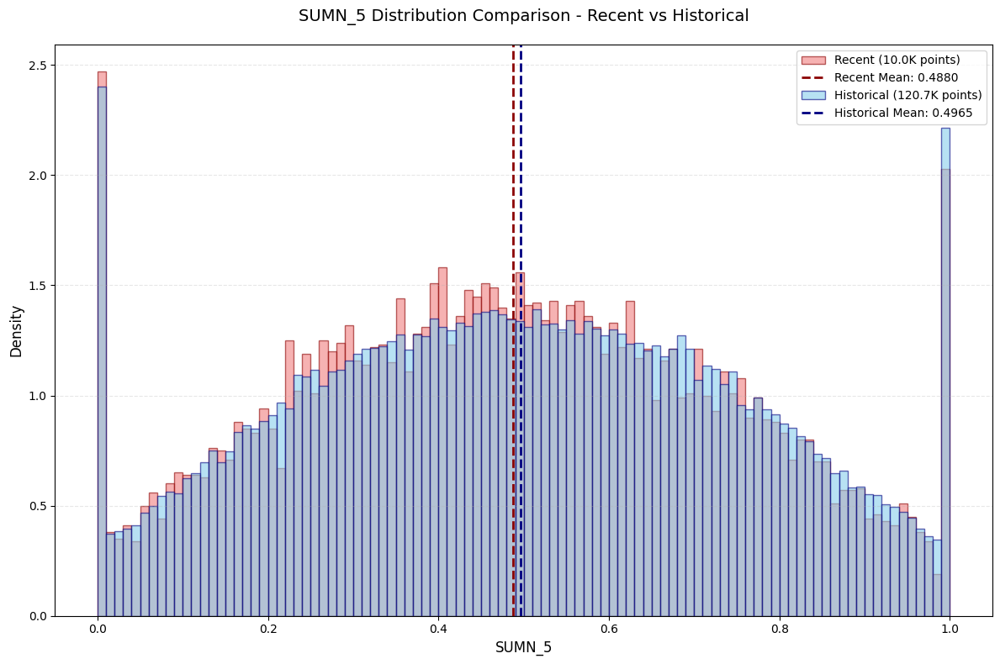

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  20%|█▉        | 28/143 [00:33<02:19,  1.21s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.006415
   Rank_IC (Spearman): -0.026896
📊 信息比率:
   IR: -0.134539
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: SUMD_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


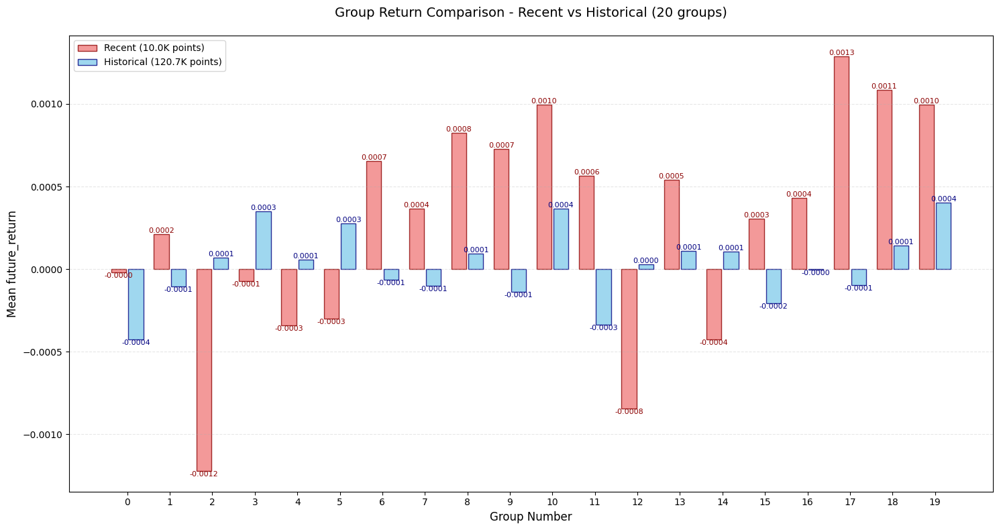

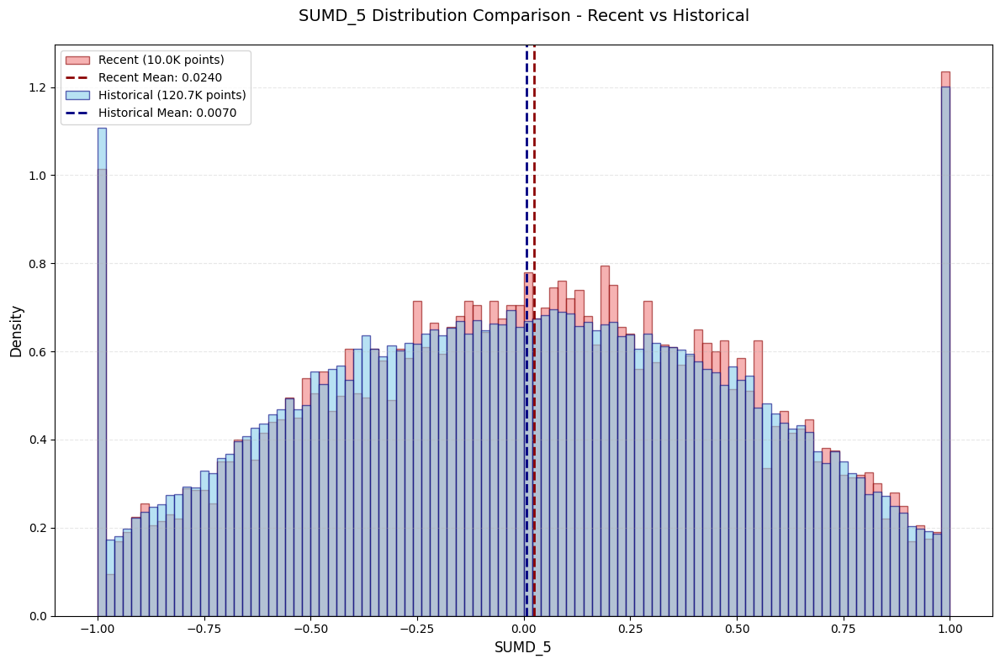

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  20%|██        | 29/143 [00:34<02:22,  1.25s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.002701
   Rank_IC (Spearman): 0.027786
📊 信息比率:
   IR: 0.384890
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MA_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


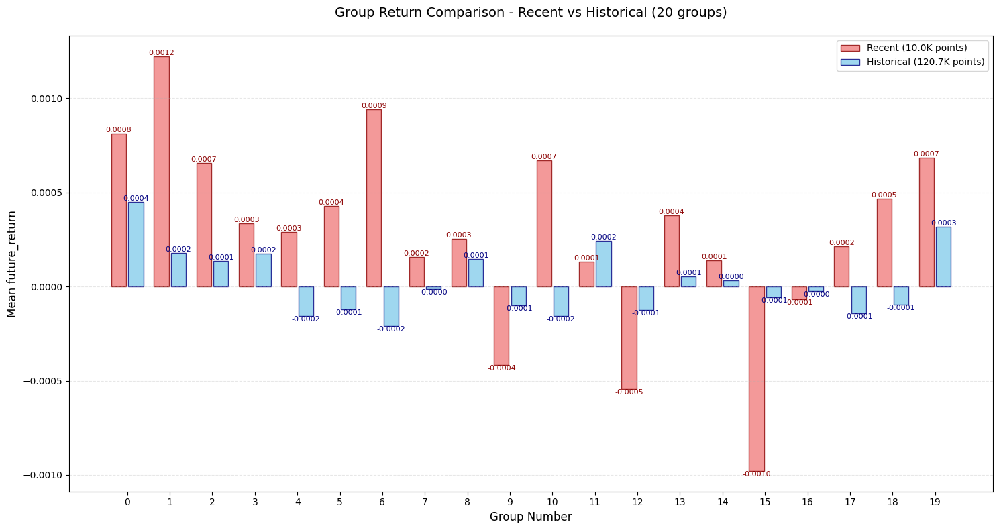

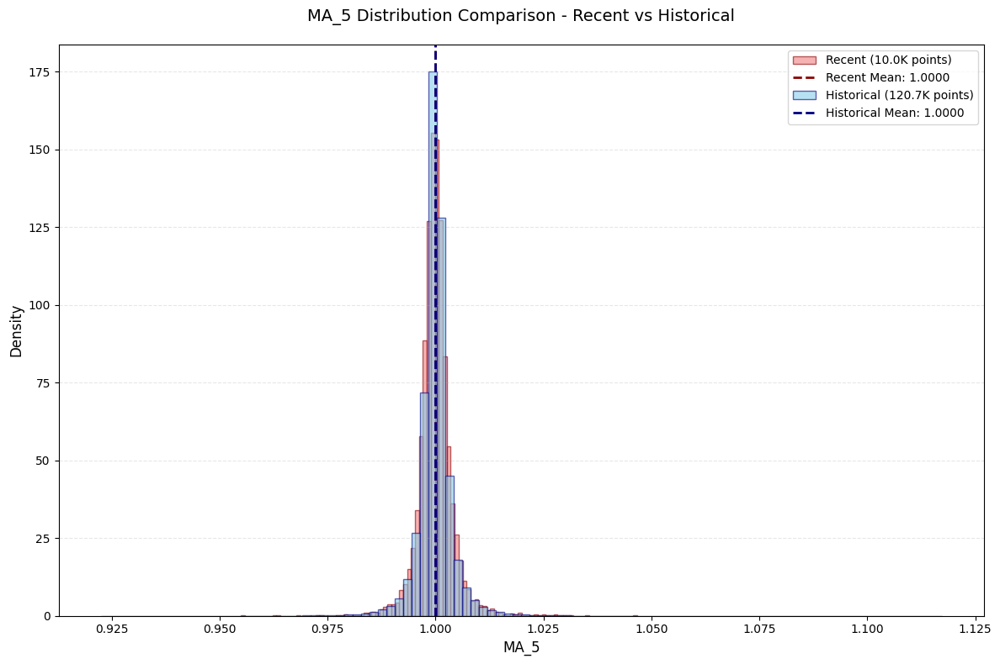

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  21%|██        | 30/143 [00:36<02:19,  1.23s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.002676
   Rank_IC (Spearman): -0.026254
📊 信息比率:
   IR: 0.169847
   有效分组数: 4
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RANK_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


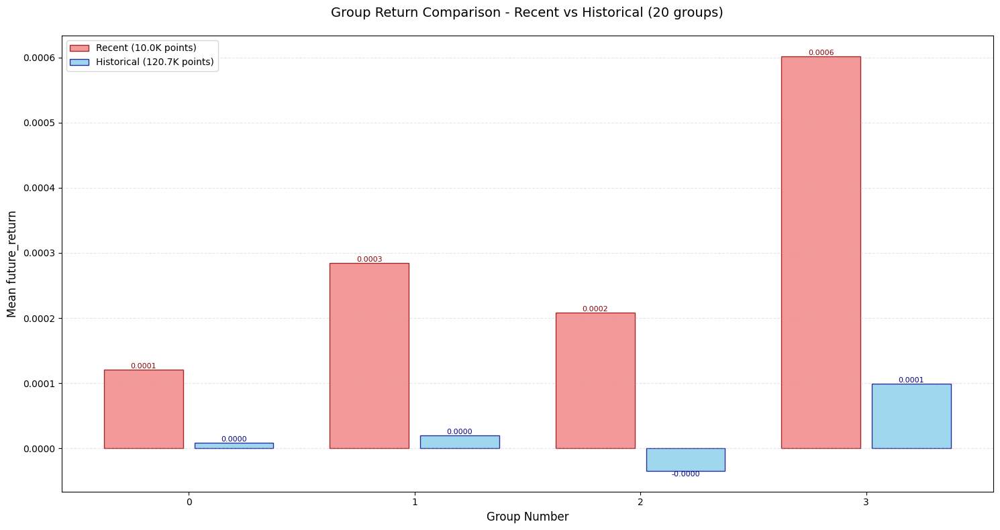

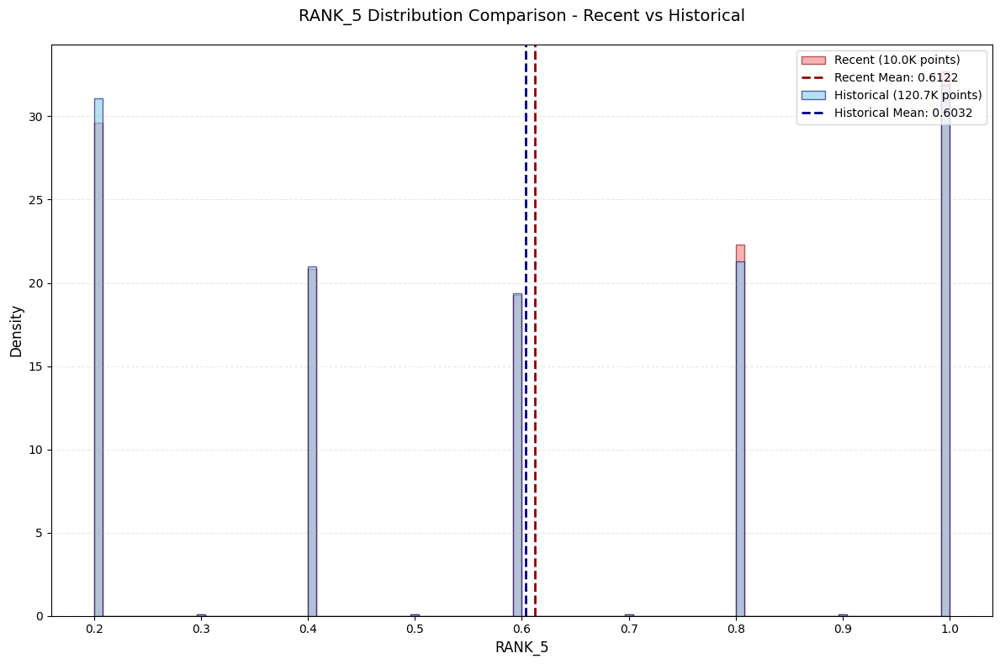

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  22%|██▏       | 31/143 [00:37<02:12,  1.18s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.000602
   Rank_IC (Spearman): -0.011764
📊 信息比率:
   IR: -0.071337
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RESI_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


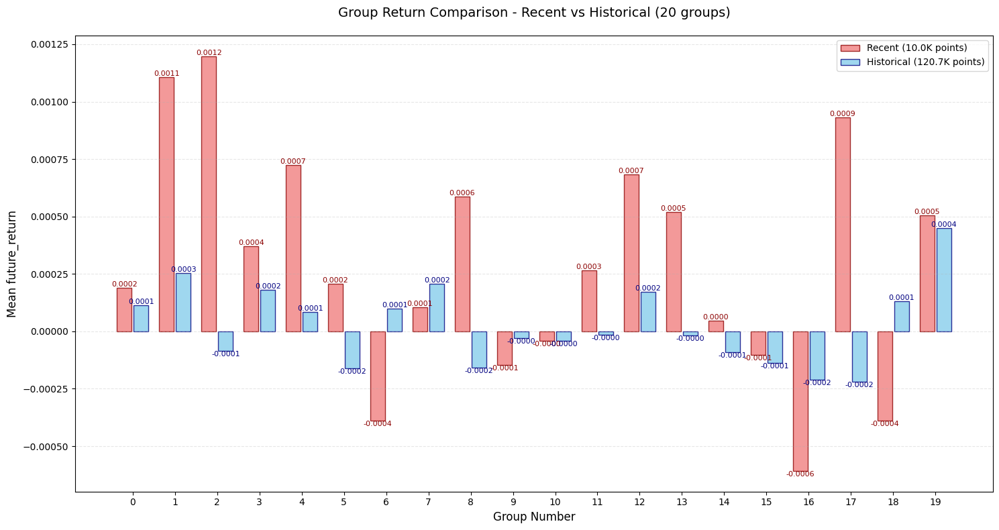

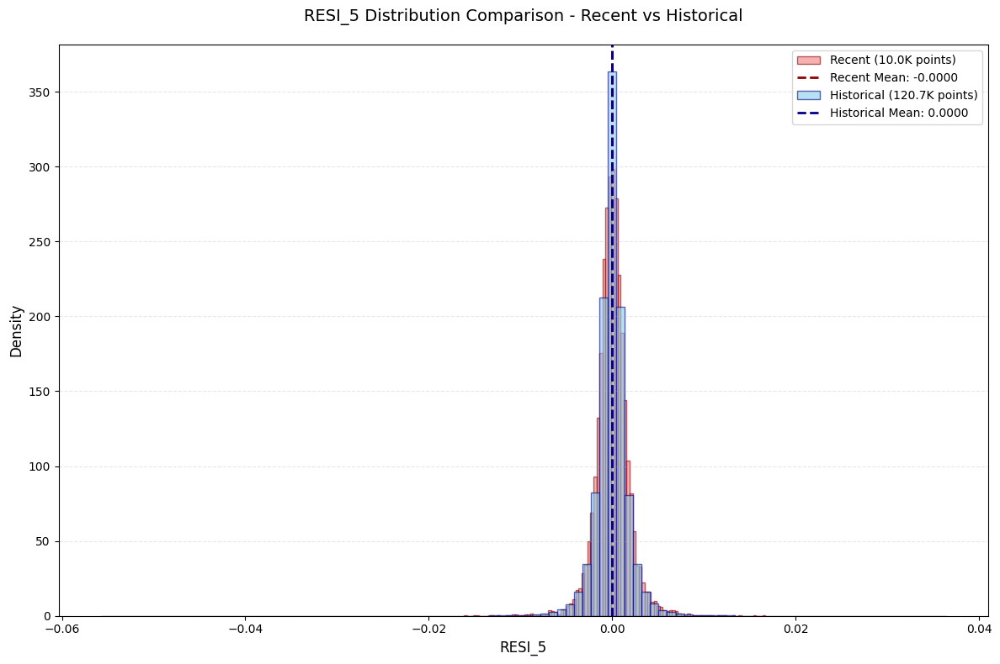

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  22%|██▏       | 32/143 [00:38<02:15,  1.22s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.001431
   Rank_IC (Spearman): 0.000819
📊 信息比率:
   IR: 0.183575
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RSQR_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


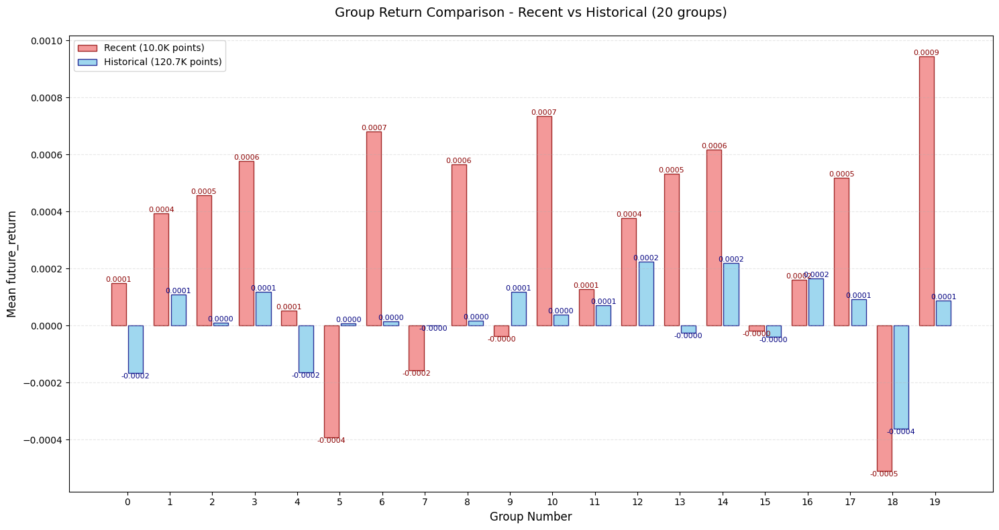

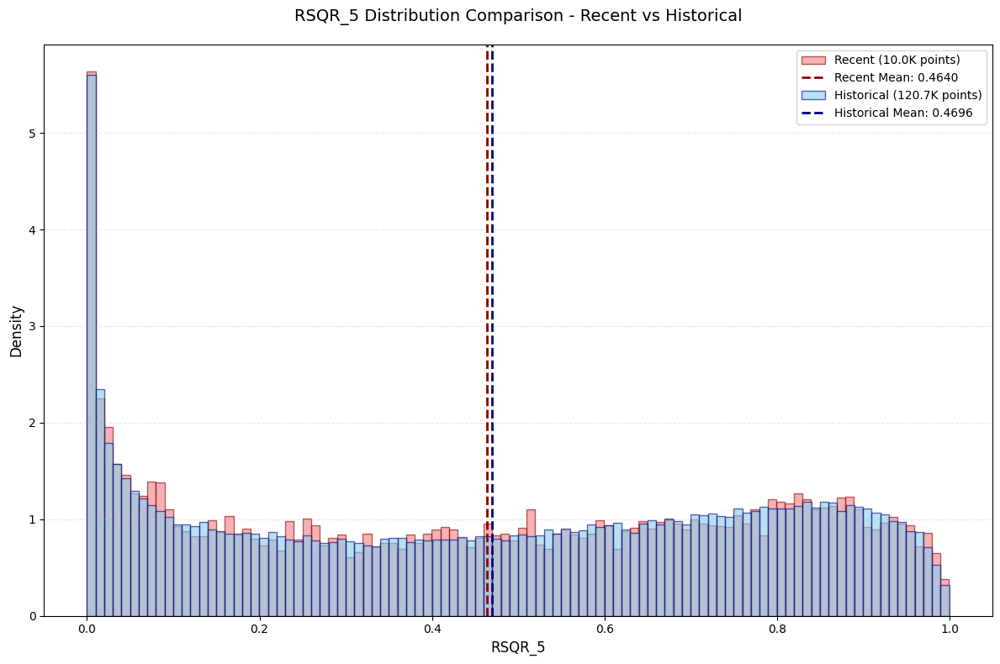

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  23%|██▎       | 33/143 [00:39<02:13,  1.21s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.002990
   Rank_IC (Spearman): -0.020311
📊 信息比率:
   IR: nan
   有效分组数: 4
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: IMAX_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


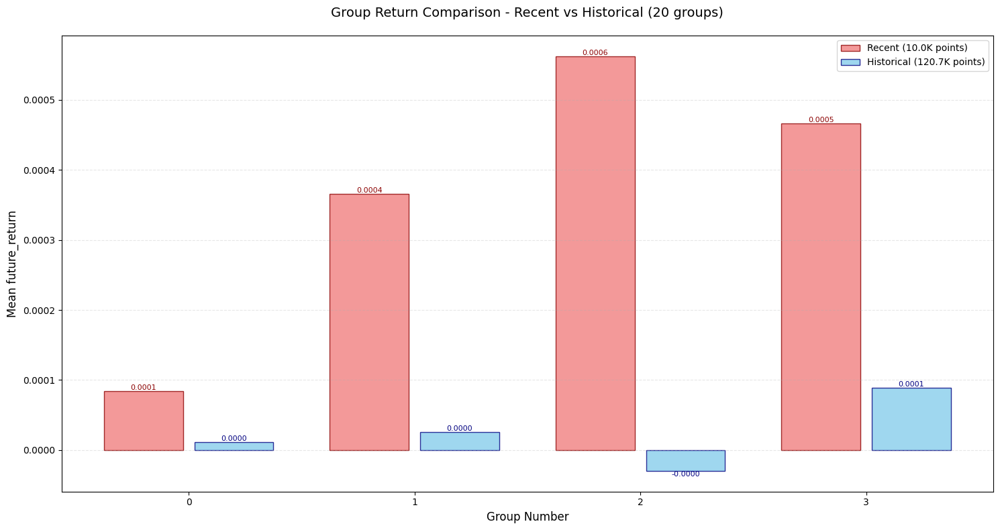

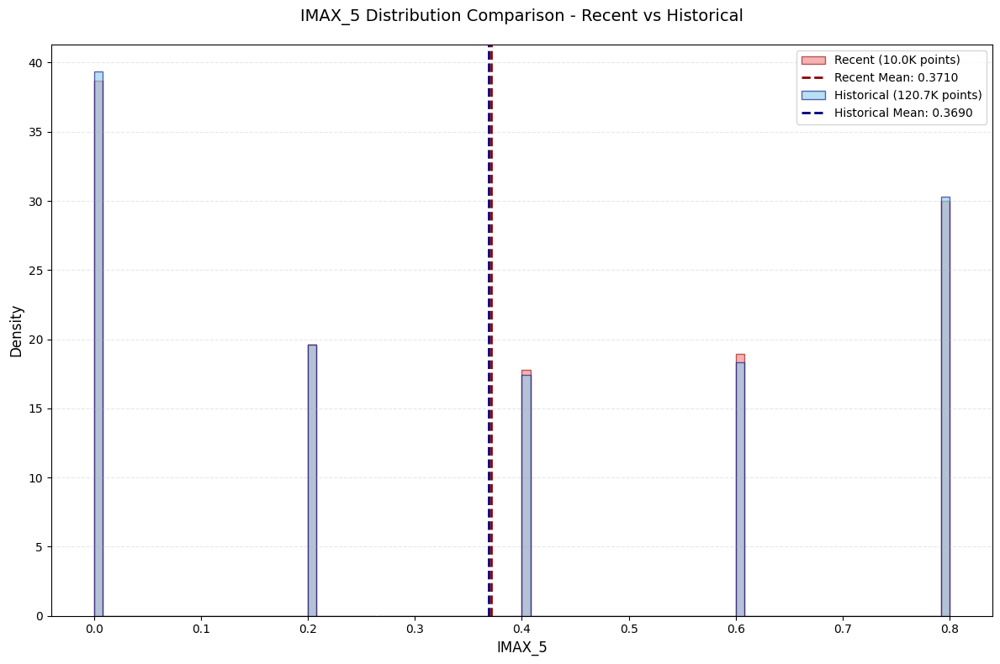

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  24%|██▍       | 34/143 [00:40<02:05,  1.15s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.003630
   Rank_IC (Spearman): 0.017183
📊 信息比率:
   IR: nan
   有效分组数: 4
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: IMIN_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


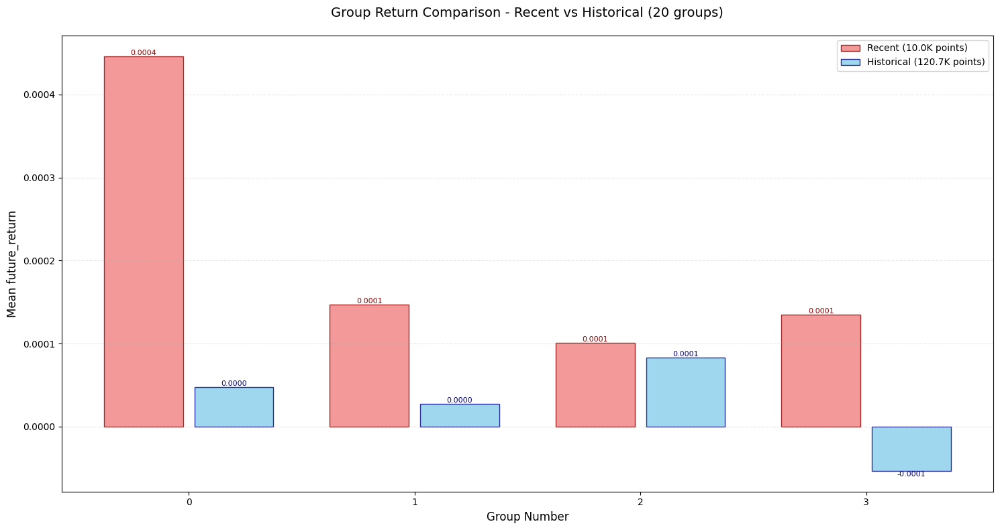

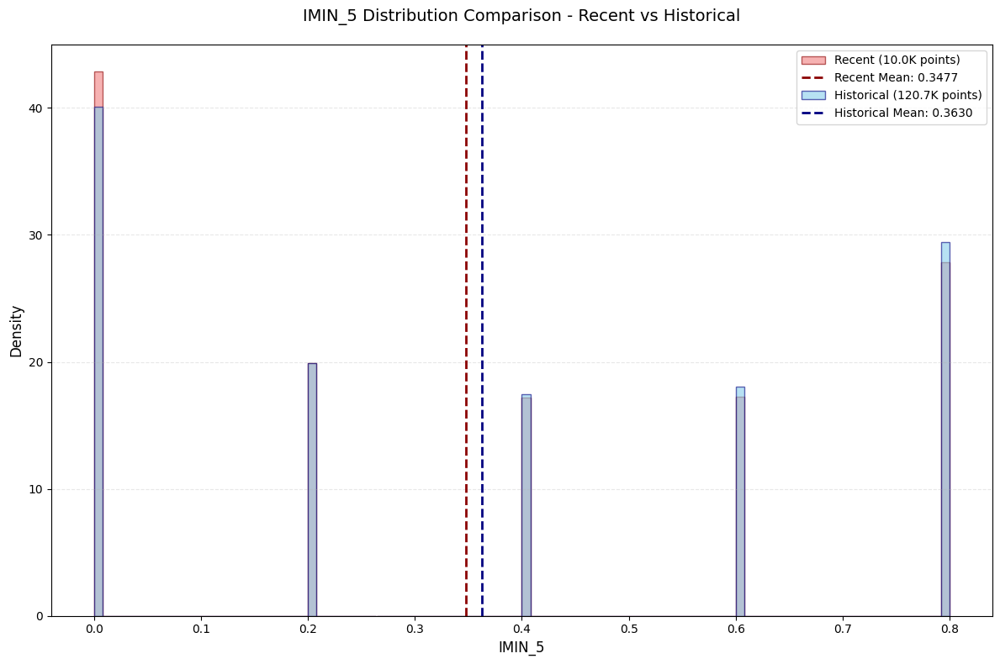

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  24%|██▍       | 35/143 [00:41<02:00,  1.12s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.003854
   Rank_IC (Spearman): -0.020873
📊 信息比率:
   IR: nan
   有效分组数: 8
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: IMXD_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


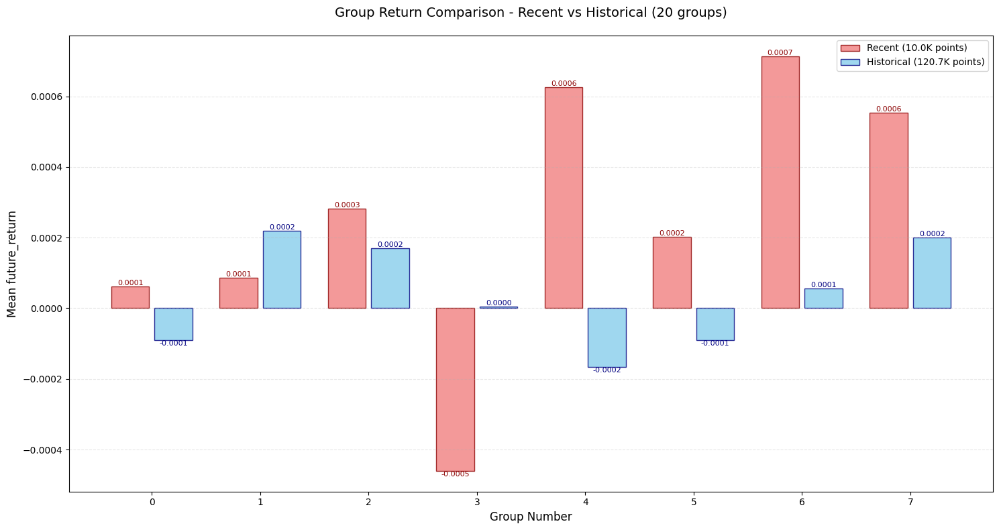

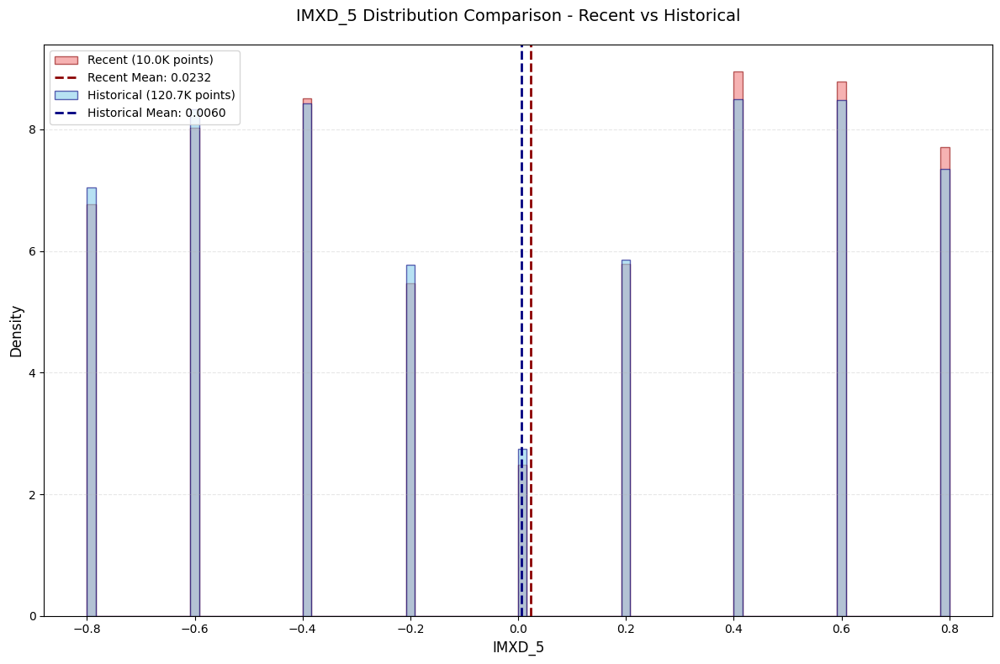

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  25%|██▌       | 36/143 [00:43<02:04,  1.16s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.004748
   Rank_IC (Spearman): 0.021147
📊 信息比率:
   IR: 0.502481
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: QTLD_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


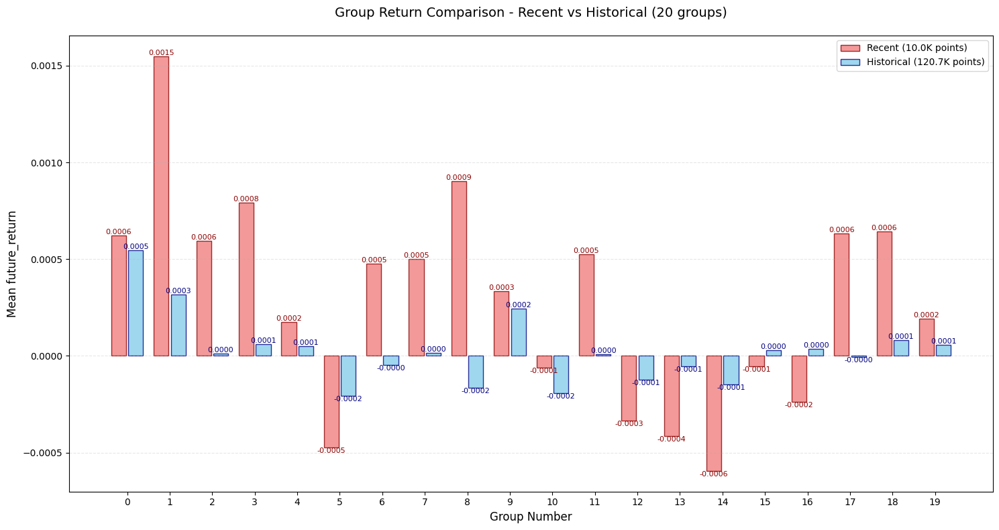

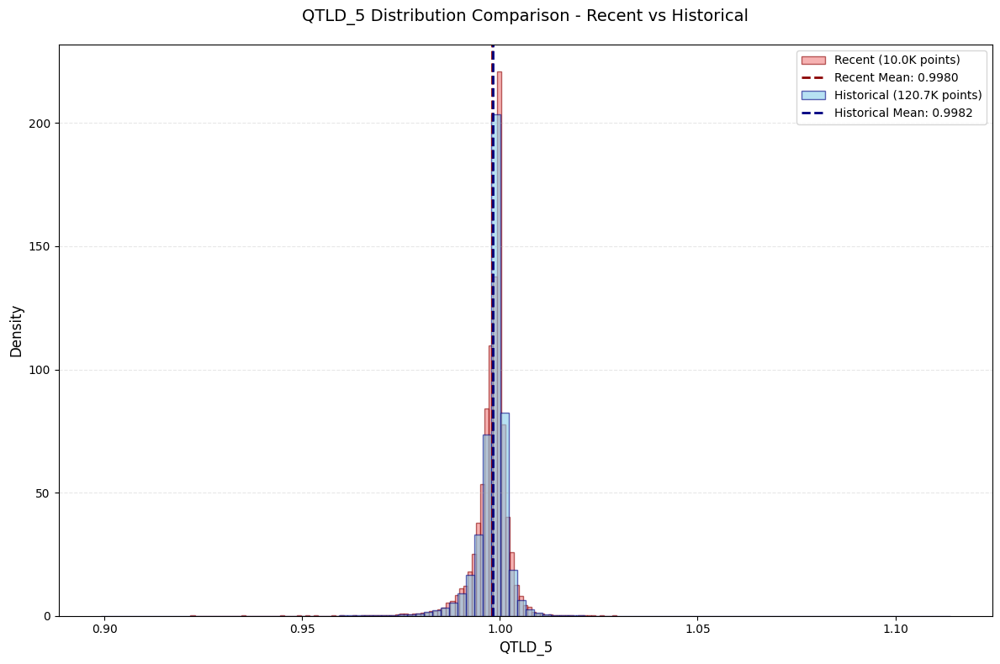

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  26%|██▌       | 37/143 [00:44<02:03,  1.17s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.010730
   Rank_IC (Spearman): 0.032155
📊 信息比率:
   IR: 0.267470
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: QTLU_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


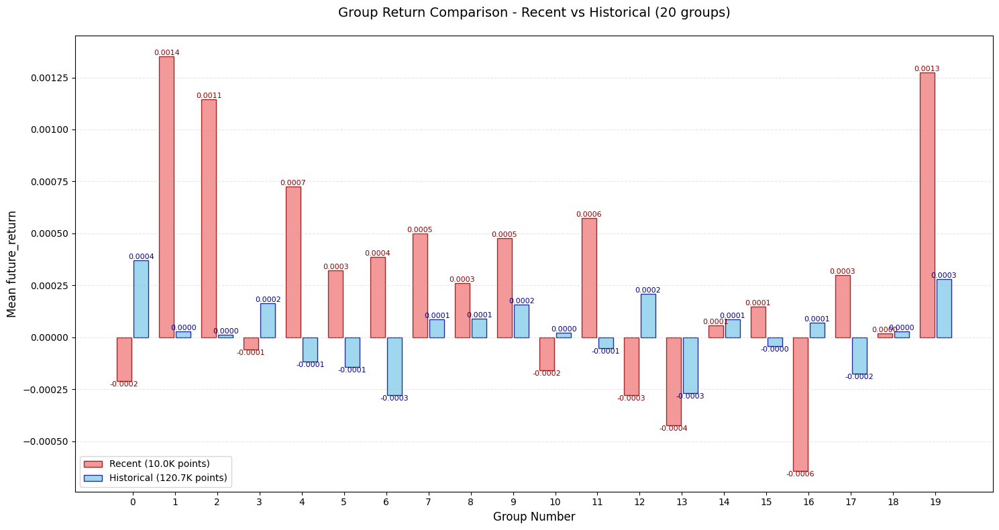

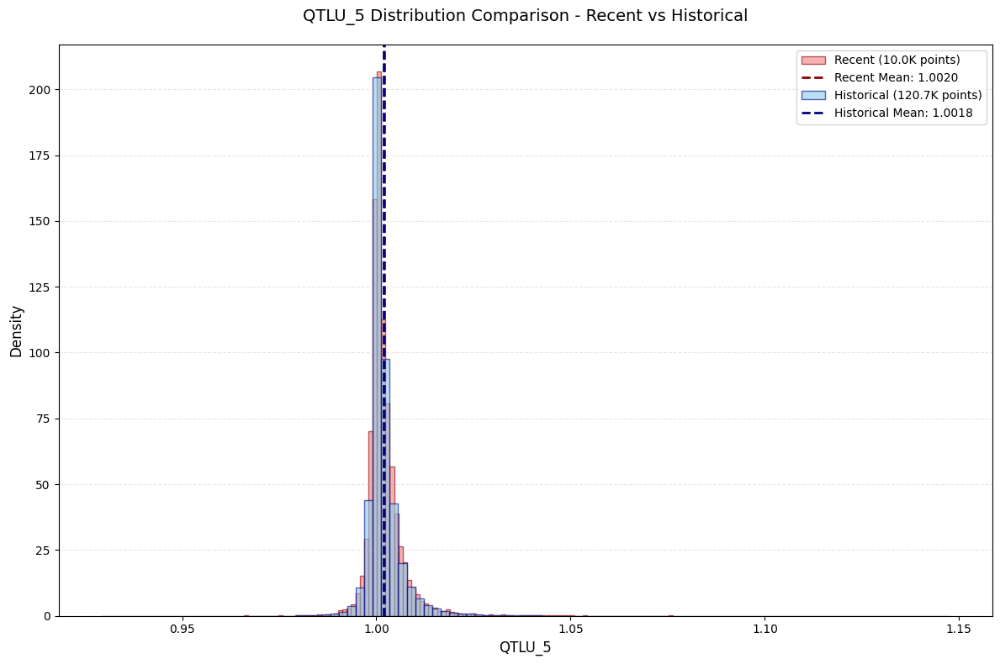

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  27%|██▋       | 38/143 [00:45<02:05,  1.20s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.006334
   Rank_IC (Spearman): -0.031140
📊 信息比率:
   IR: -0.603262
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: BETA_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


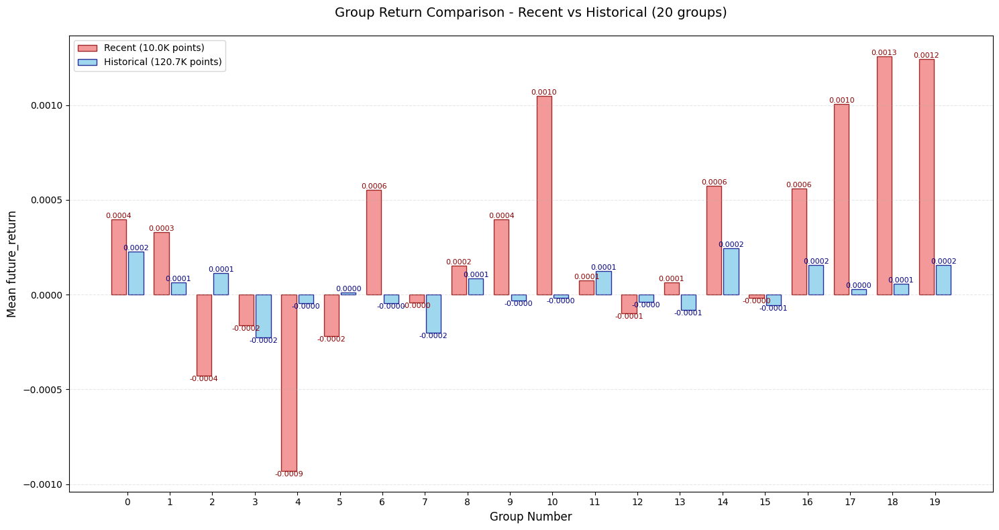

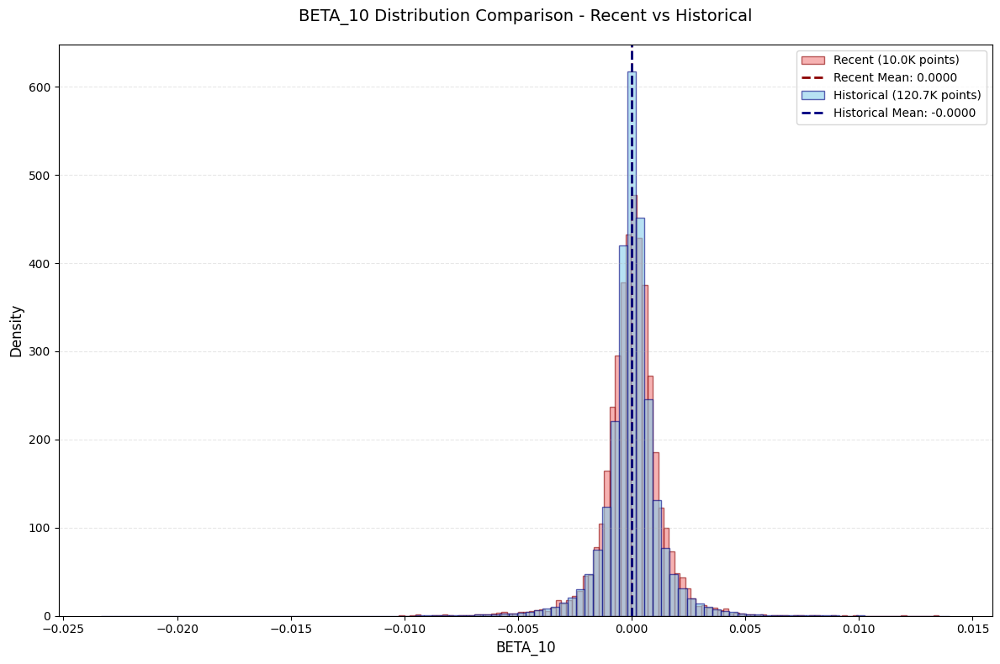

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  27%|██▋       | 39/143 [00:46<02:08,  1.24s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.009513
   Rank_IC (Spearman): -0.014116
📊 信息比率:
   IR: -0.080248
   有效分组数: 6
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTD_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


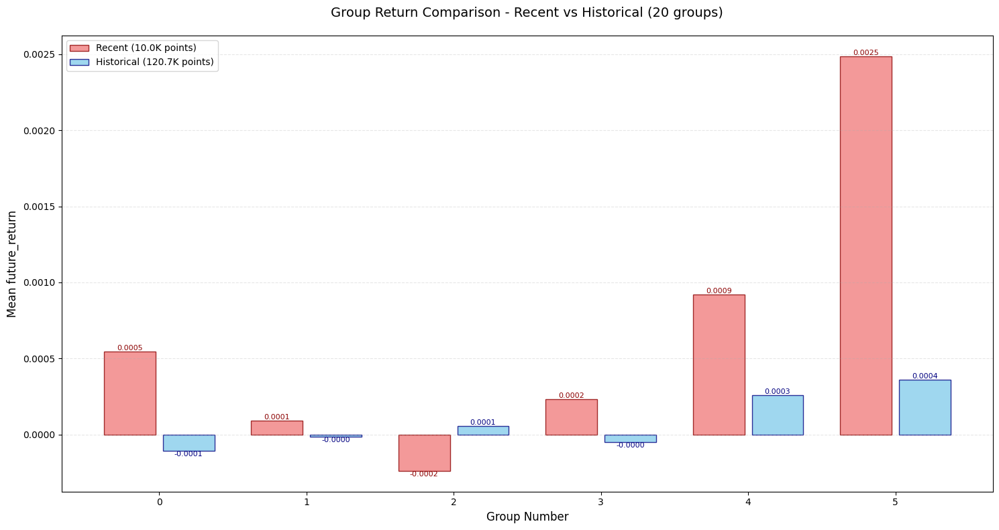

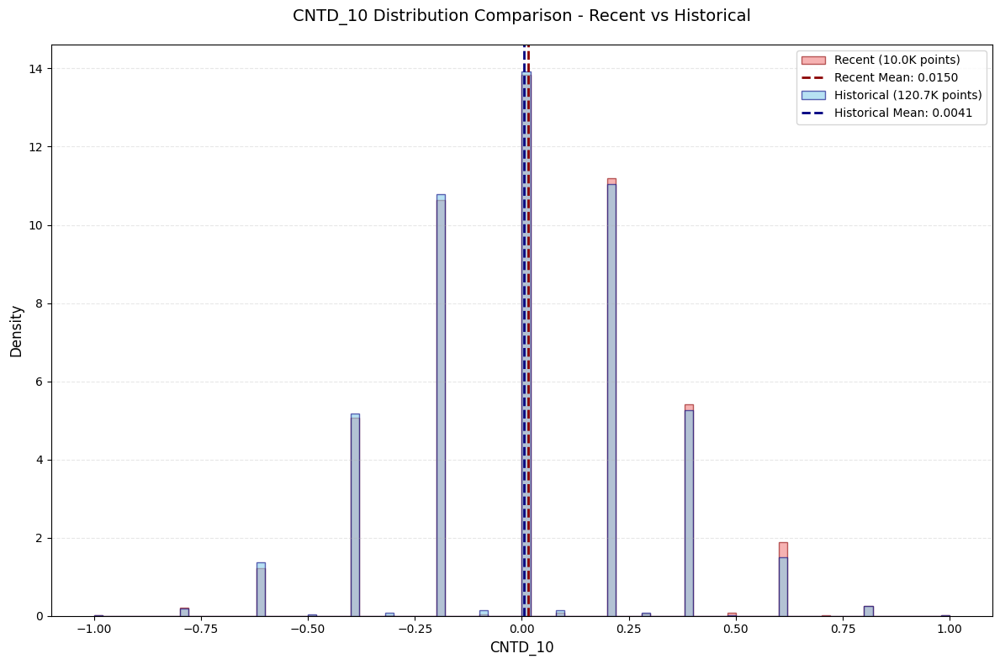

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  28%|██▊       | 40/143 [00:47<02:03,  1.19s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.009582
   Rank_IC (Spearman): -0.014157
📊 信息比率:
   IR: nan
   有效分组数: 6
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTP_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


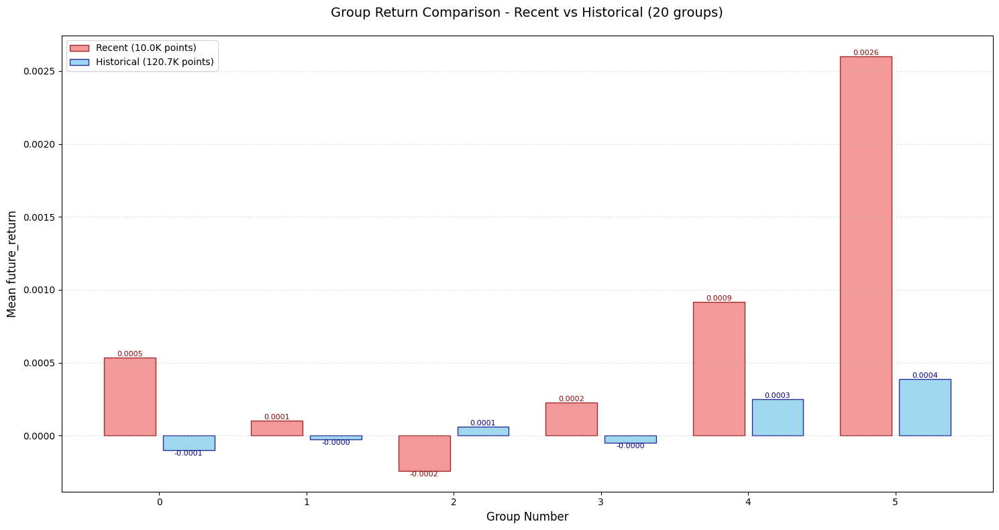

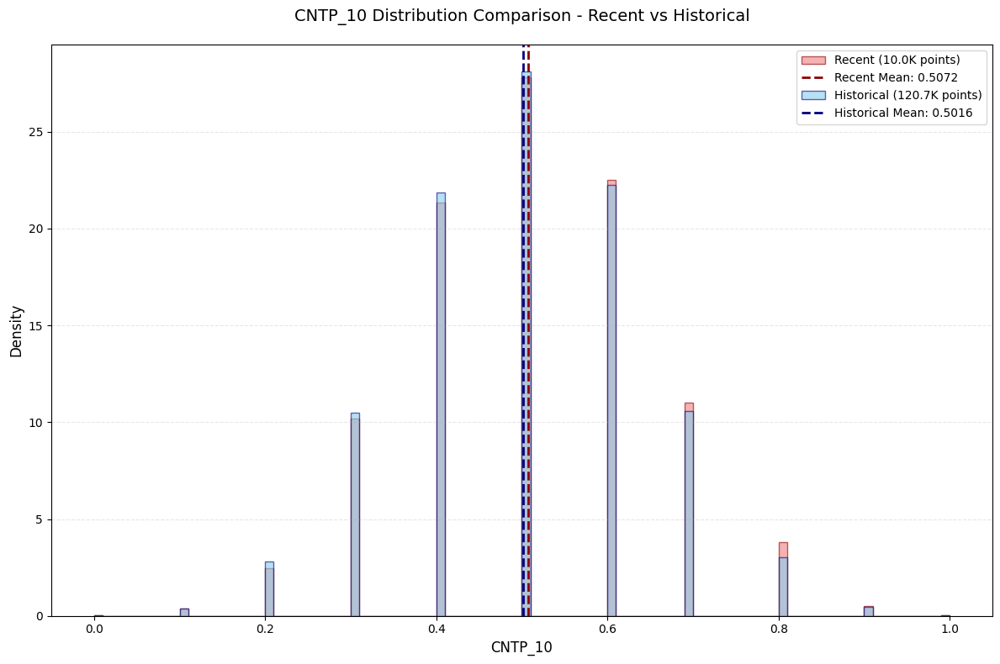

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  29%|██▊       | 41/143 [00:48<01:56,  1.15s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.009432
   Rank_IC (Spearman): 0.014152
📊 信息比率:
   IR: nan
   有效分组数: 6
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTN_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


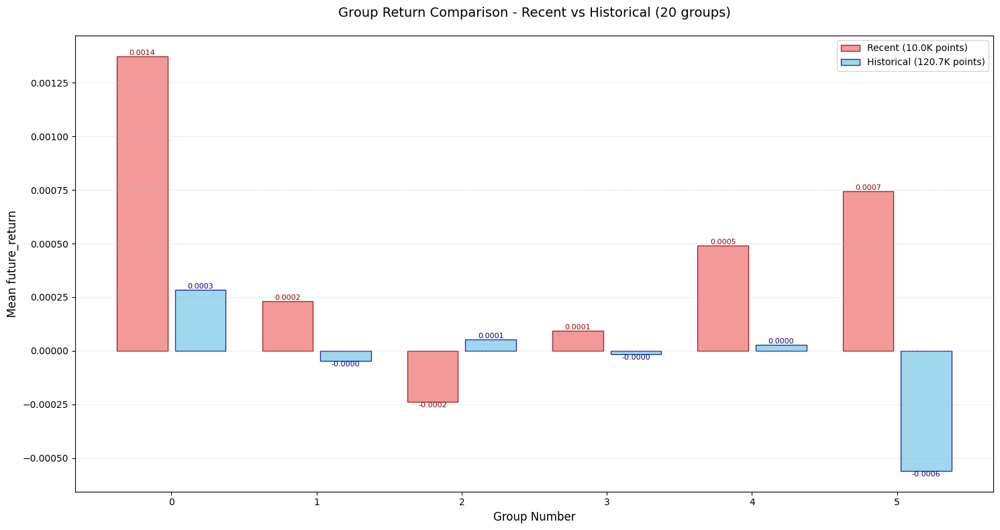

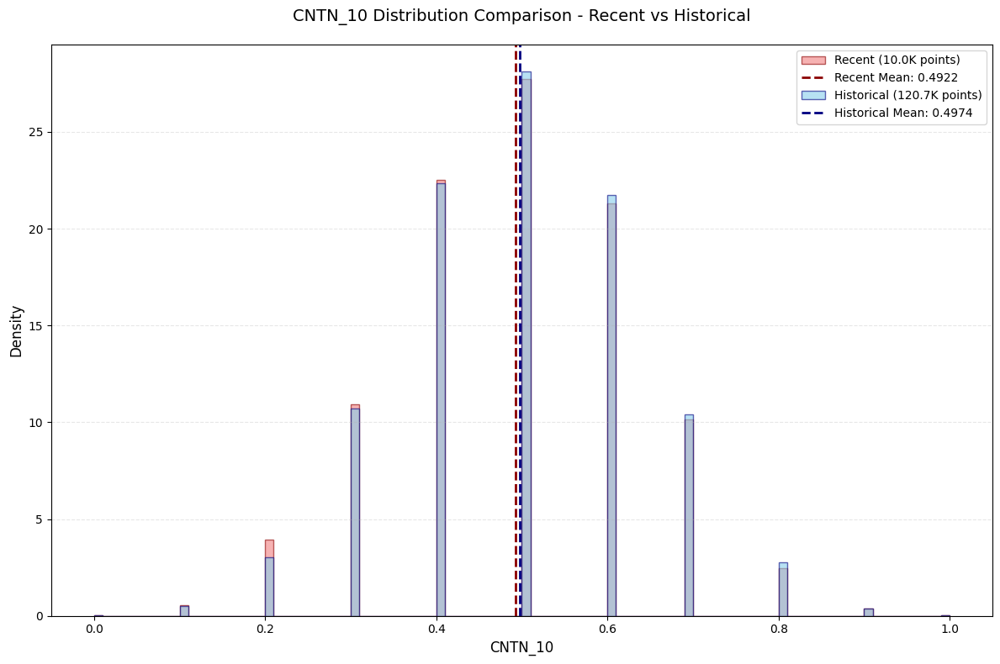

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  29%|██▉       | 42/143 [00:49<01:51,  1.11s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.015038
   Rank_IC (Spearman): 0.028911
📊 信息比率:
   IR: 0.596414
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MAX_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


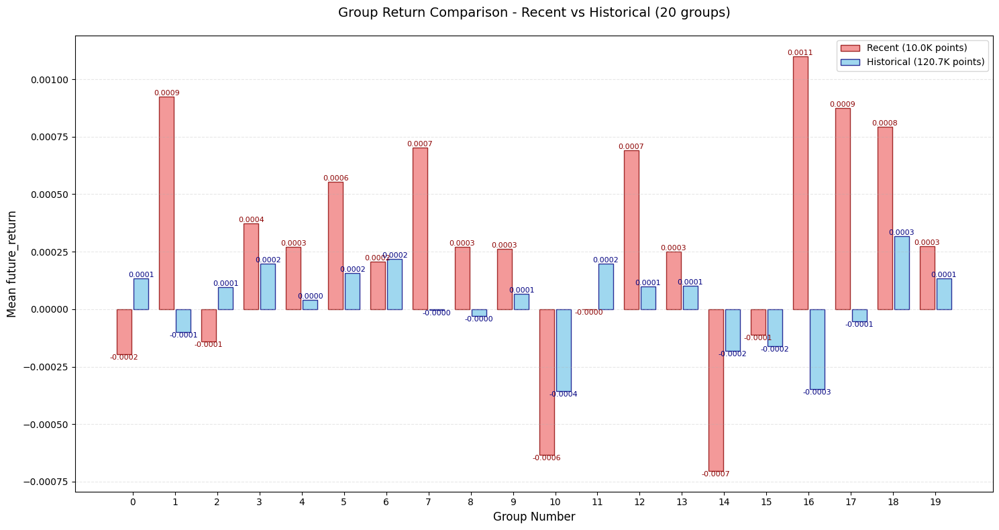

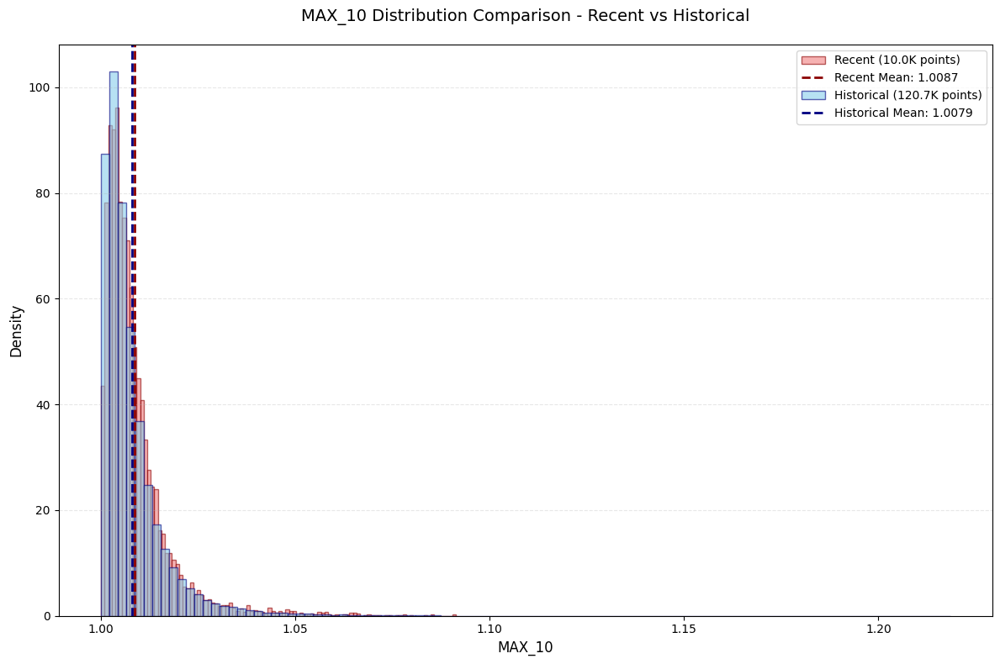

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  30%|███       | 43/143 [00:51<01:57,  1.17s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.015300
   Rank_IC (Spearman): -0.001282
📊 信息比率:
   IR: -0.650030
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MIN_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


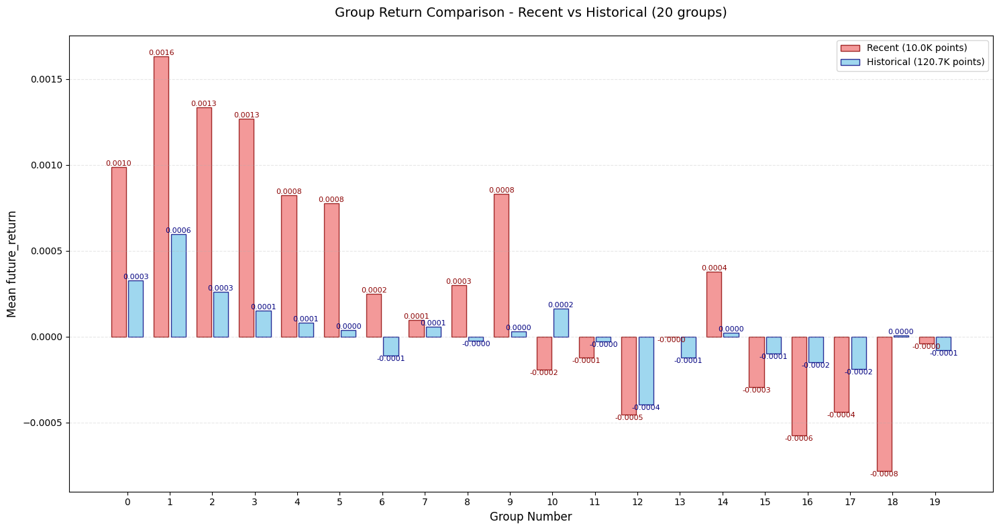

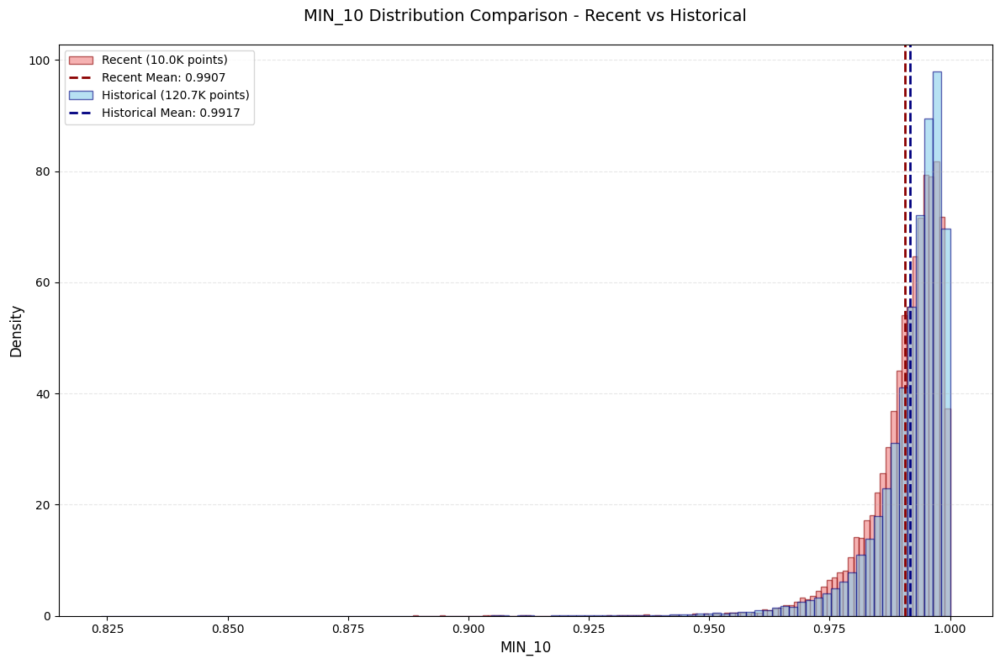

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  31%|███       | 44/143 [00:52<01:57,  1.18s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.008081
   Rank_IC (Spearman): 0.033137
📊 信息比率:
   IR: 0.408320
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: ROC_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


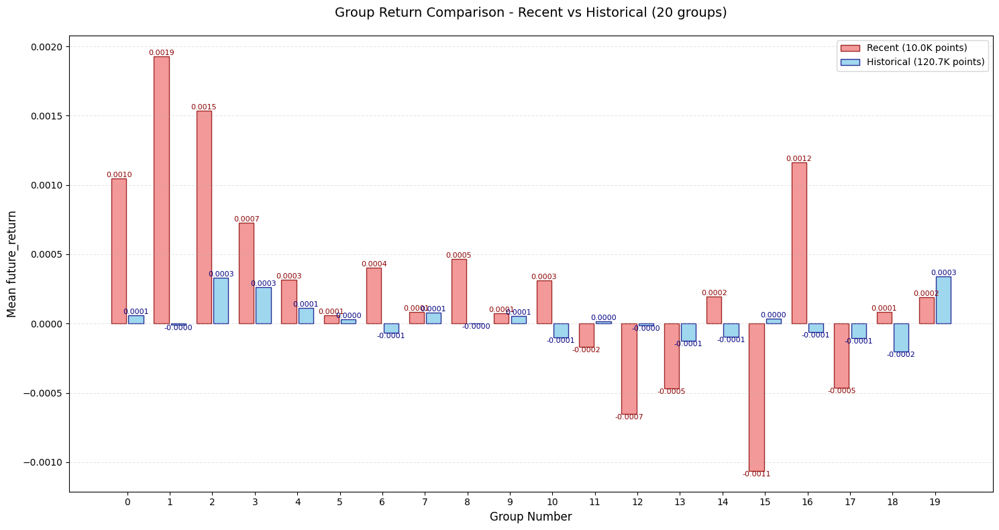

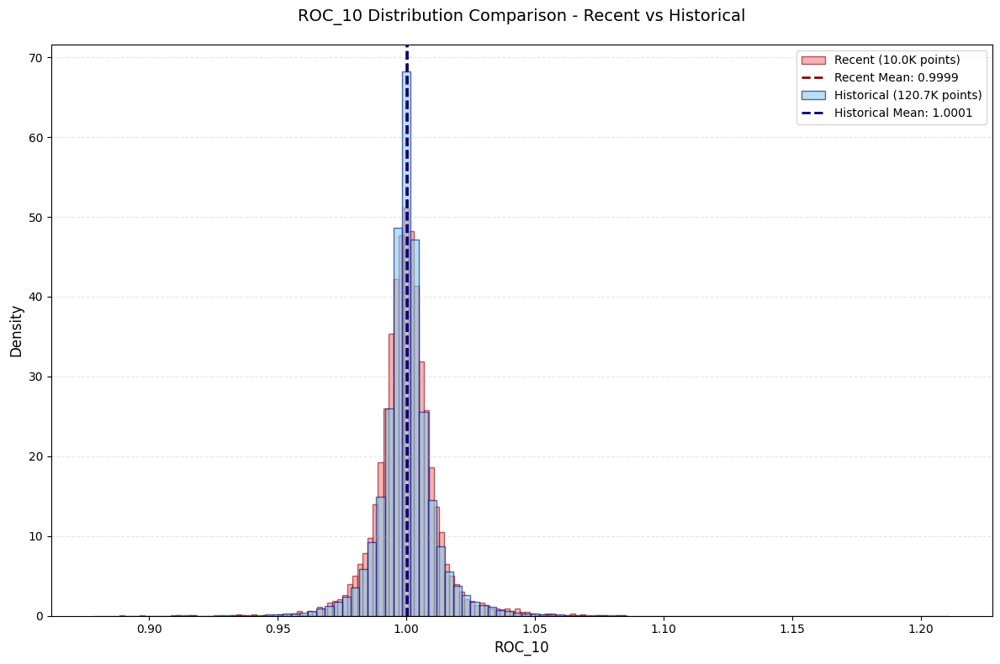

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  31%|███▏      | 45/143 [00:53<01:56,  1.19s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.009380
   Rank_IC (Spearman): -0.021467
📊 信息比率:
   IR: -0.388571
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RSV_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


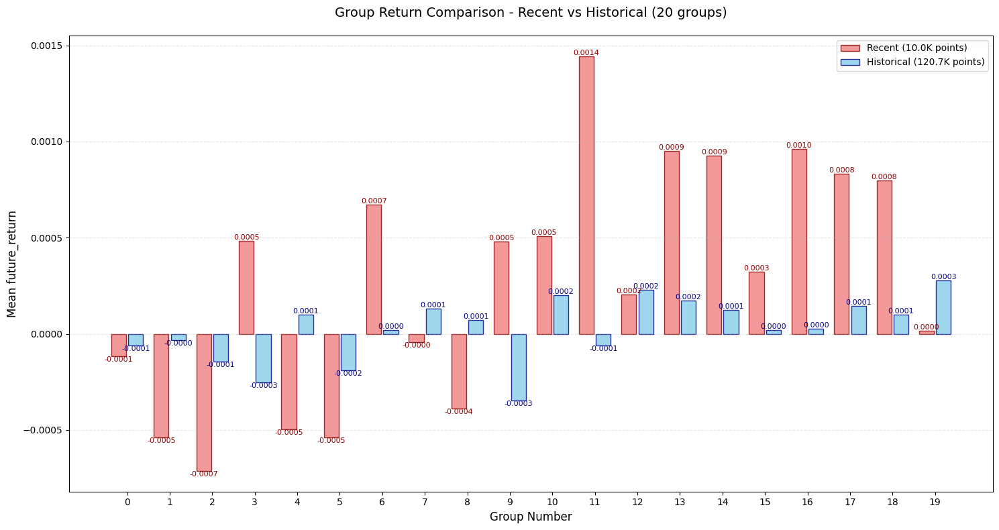

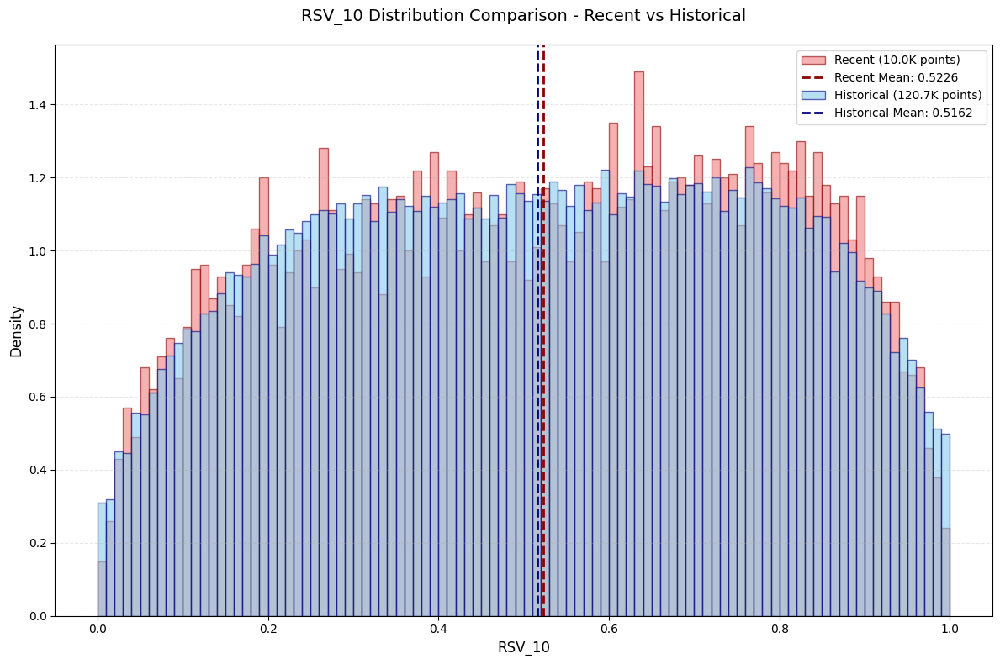

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  32%|███▏      | 46/143 [00:55<02:00,  1.24s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.010569
   Rank_IC (Spearman): -0.029905
📊 信息比率:
   IR: 0.322973
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: SUMP_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


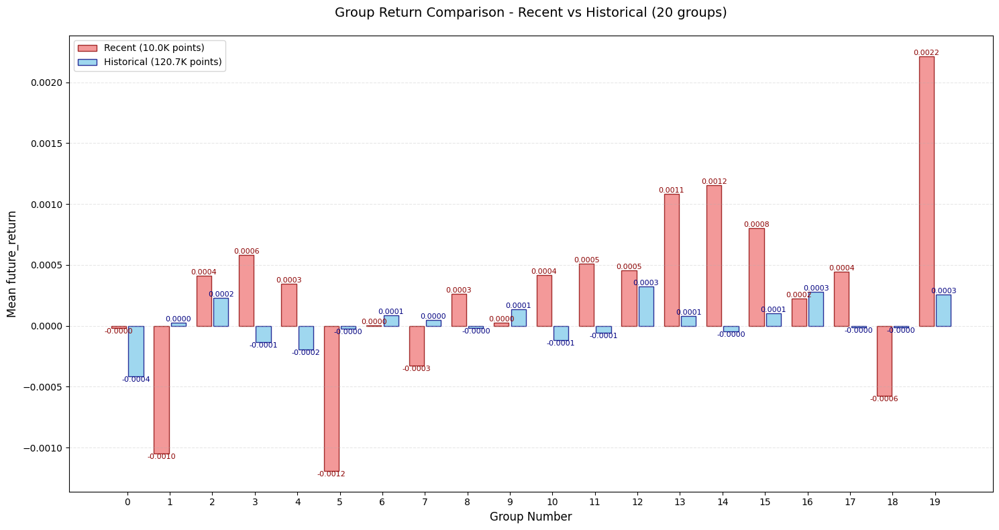

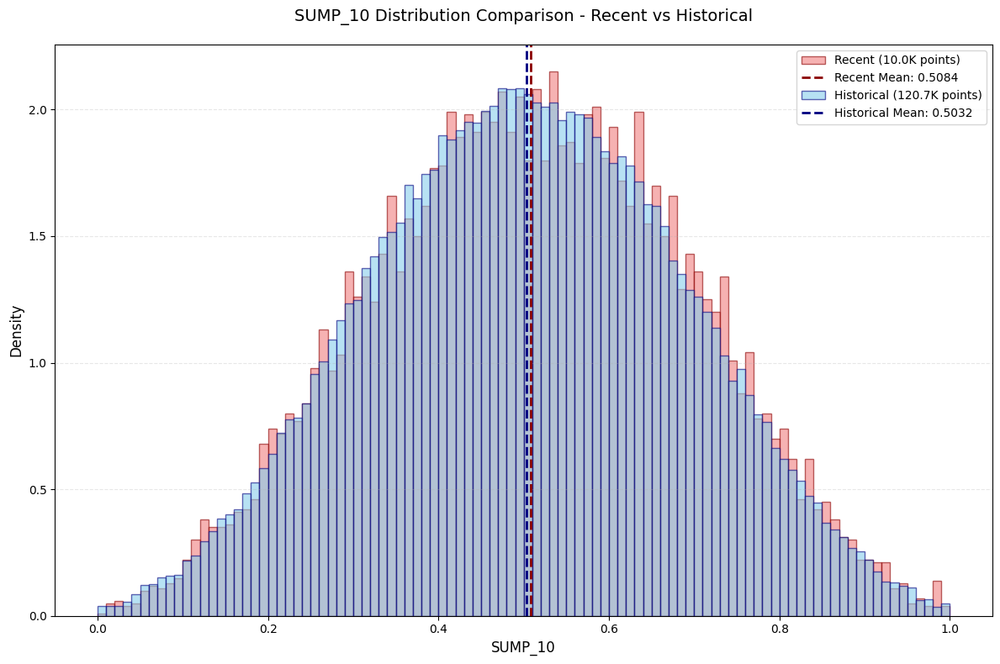

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  33%|███▎      | 47/143 [00:56<01:59,  1.24s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.010569
   Rank_IC (Spearman): 0.029905
📊 信息比率:
   IR: -0.320286
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: SUMN_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


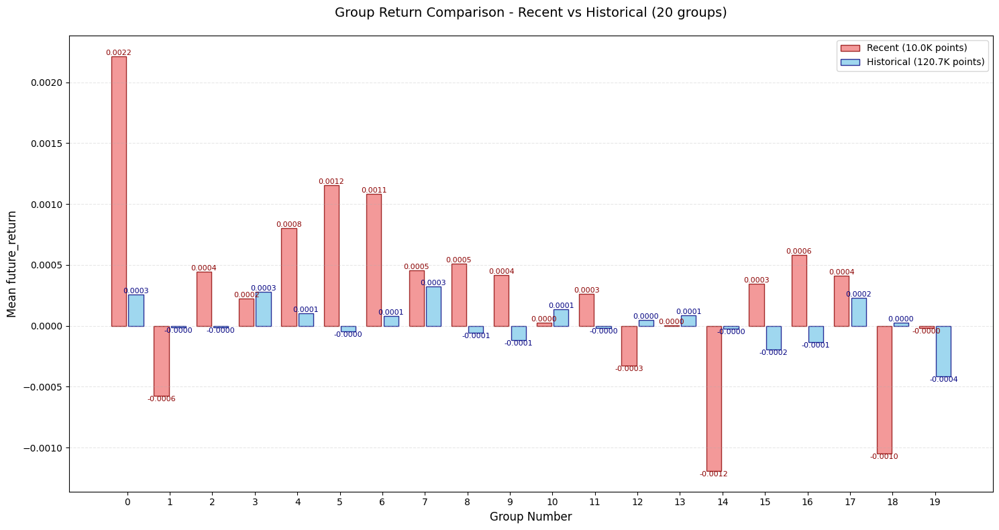

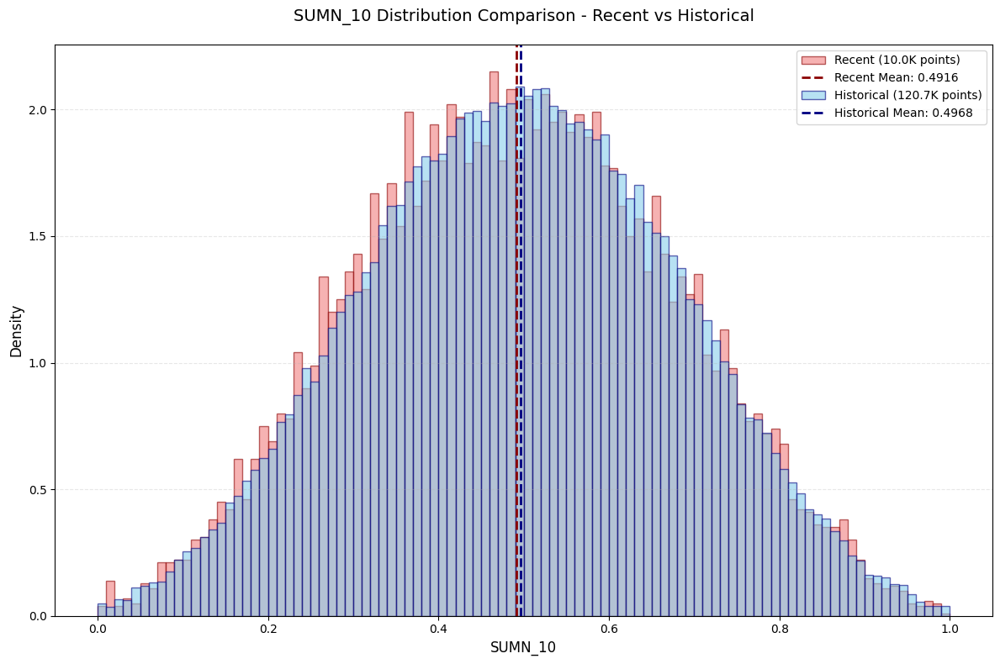

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  34%|███▎      | 48/143 [00:57<01:57,  1.23s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.010569
   Rank_IC (Spearman): -0.029905
📊 信息比率:
   IR: 0.322973
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: SUMD_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


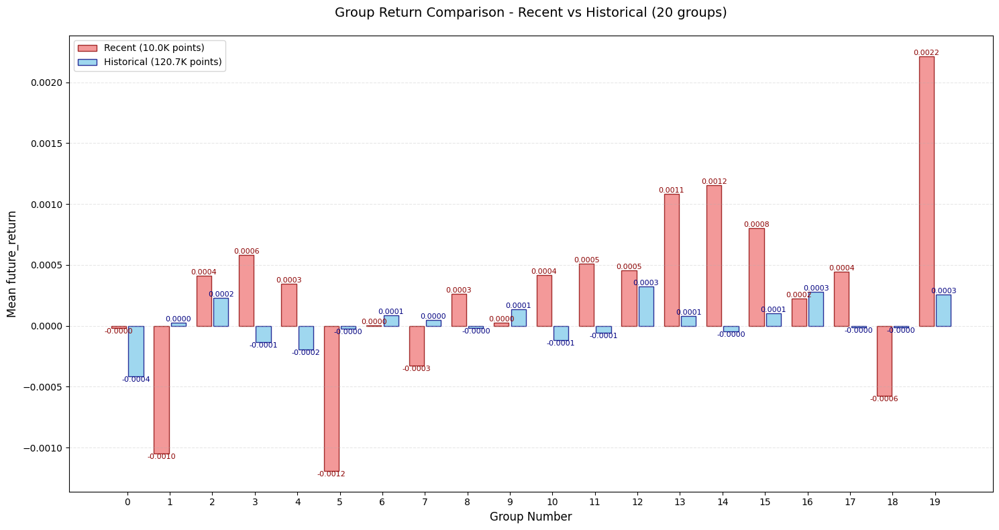

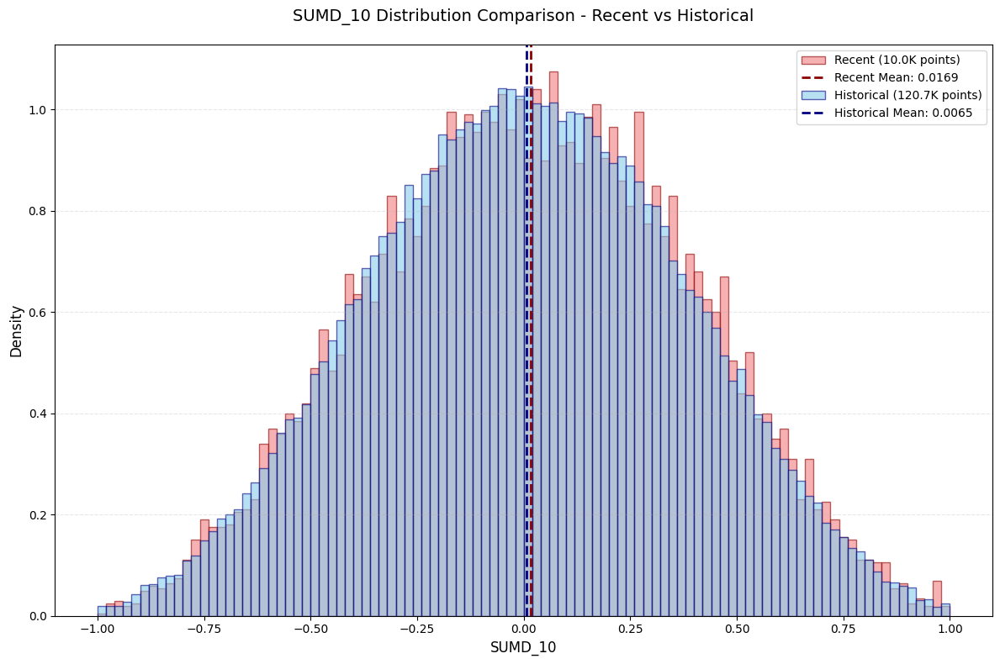

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  34%|███▍      | 49/143 [00:58<02:00,  1.28s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.005082
   Rank_IC (Spearman): 0.033551
📊 信息比率:
   IR: 0.072299
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MA_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


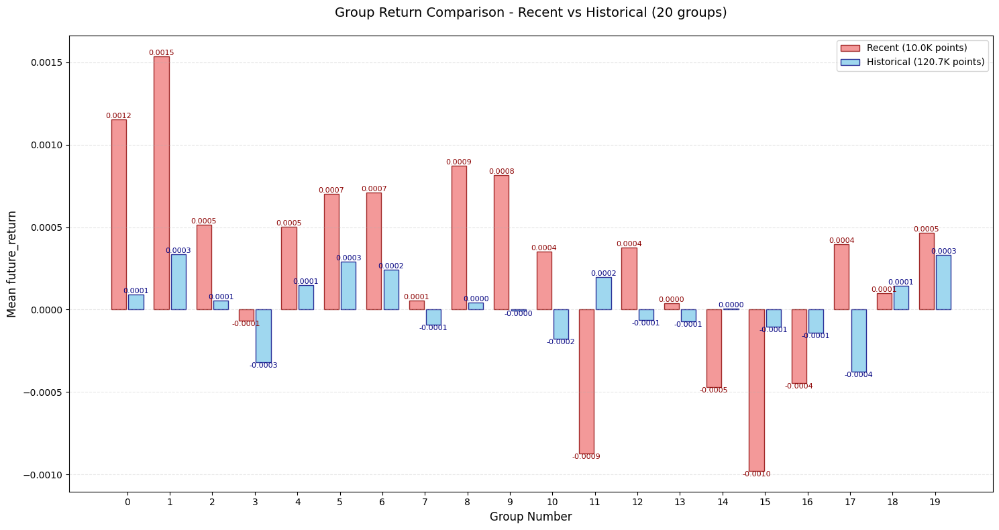

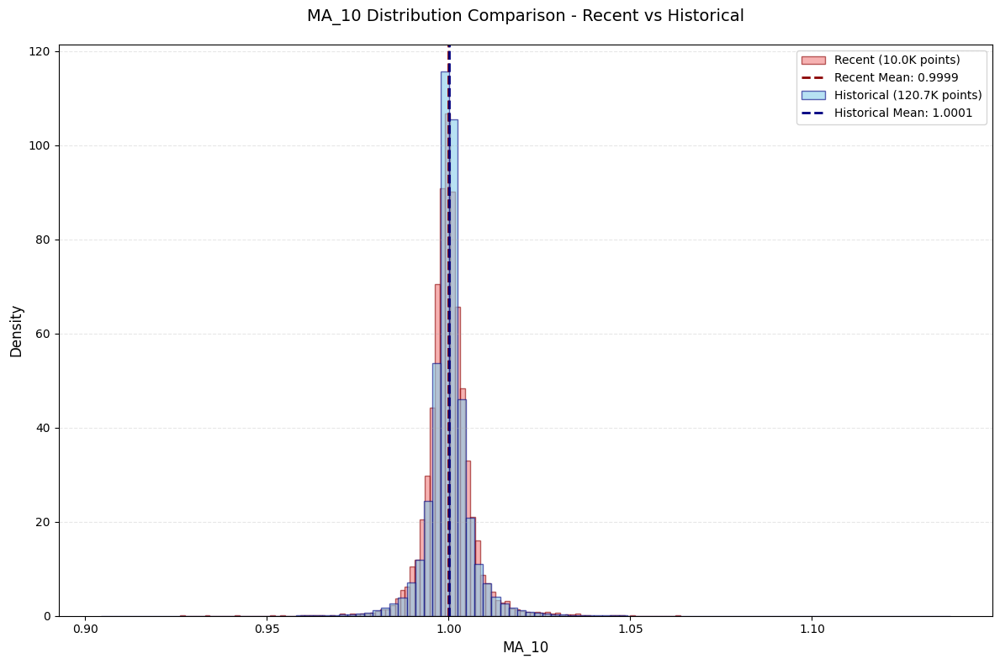

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  35%|███▍      | 50/143 [01:00<01:56,  1.25s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.005043
   Rank_IC (Spearman): -0.032465
📊 信息比率:
   IR: 0.567903
   有效分组数: 8
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RANK_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


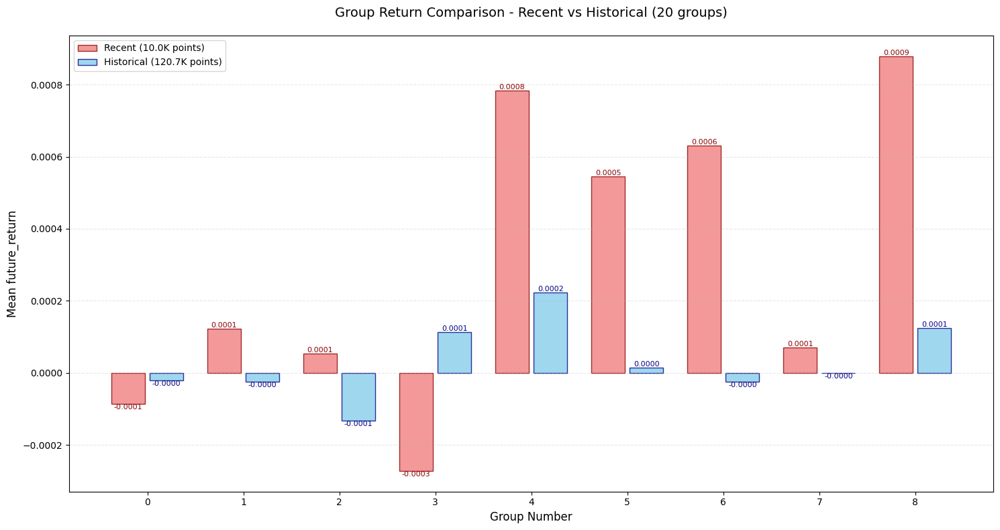

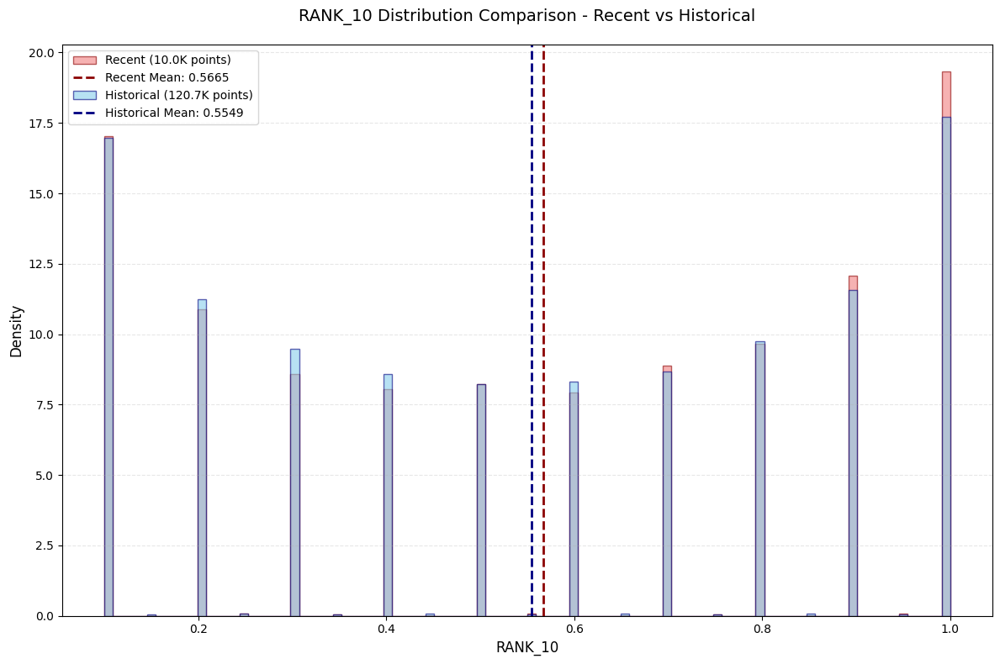

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  36%|███▌      | 51/143 [01:01<01:50,  1.20s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.001508
   Rank_IC (Spearman): -0.012224
📊 信息比率:
   IR: -0.098461
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RESI_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


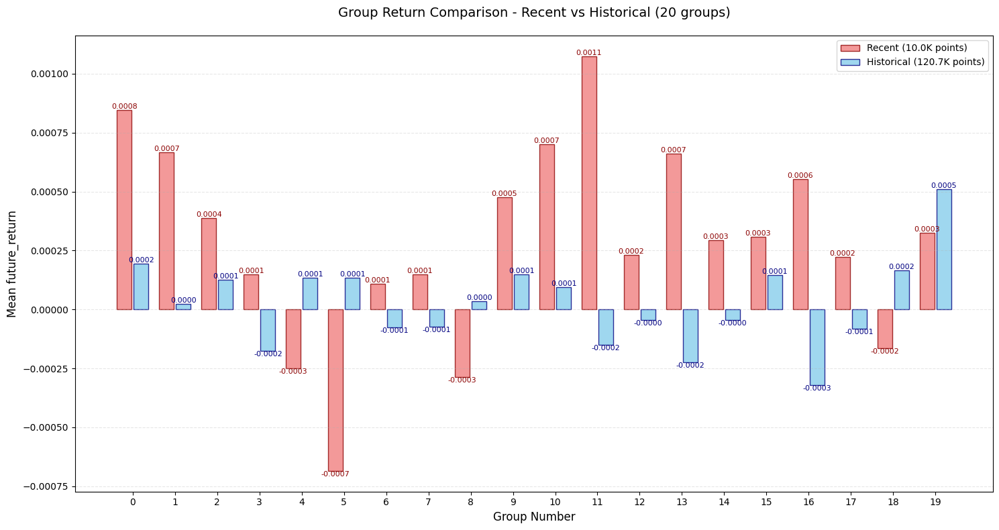

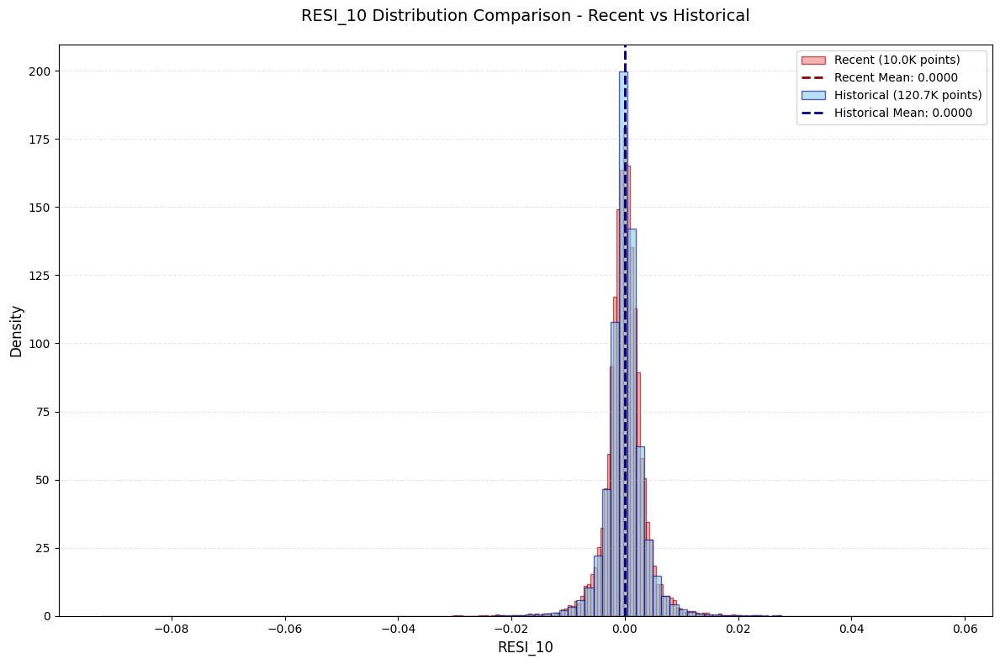

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  36%|███▋      | 52/143 [01:02<01:54,  1.26s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.002217
   Rank_IC (Spearman): -0.000803
📊 信息比率:
   IR: -0.353083
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RSQR_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


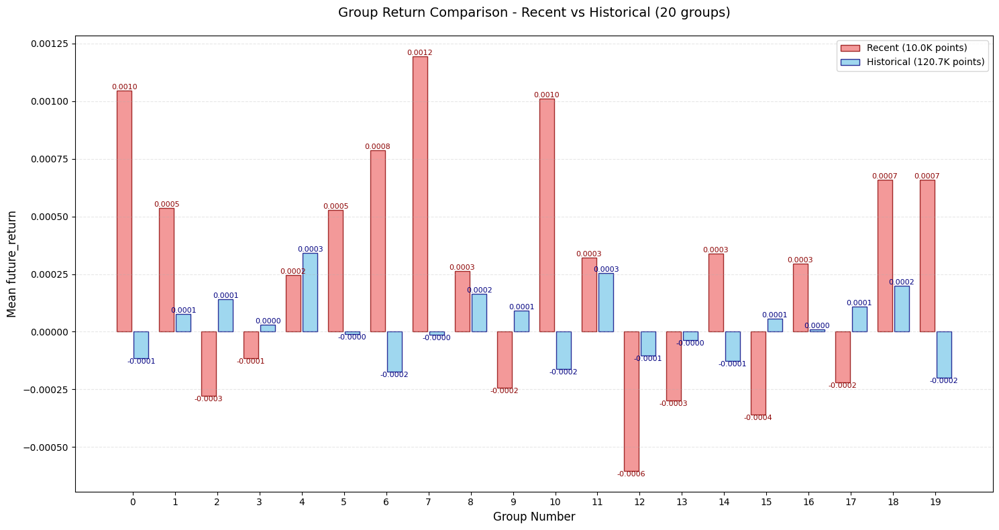

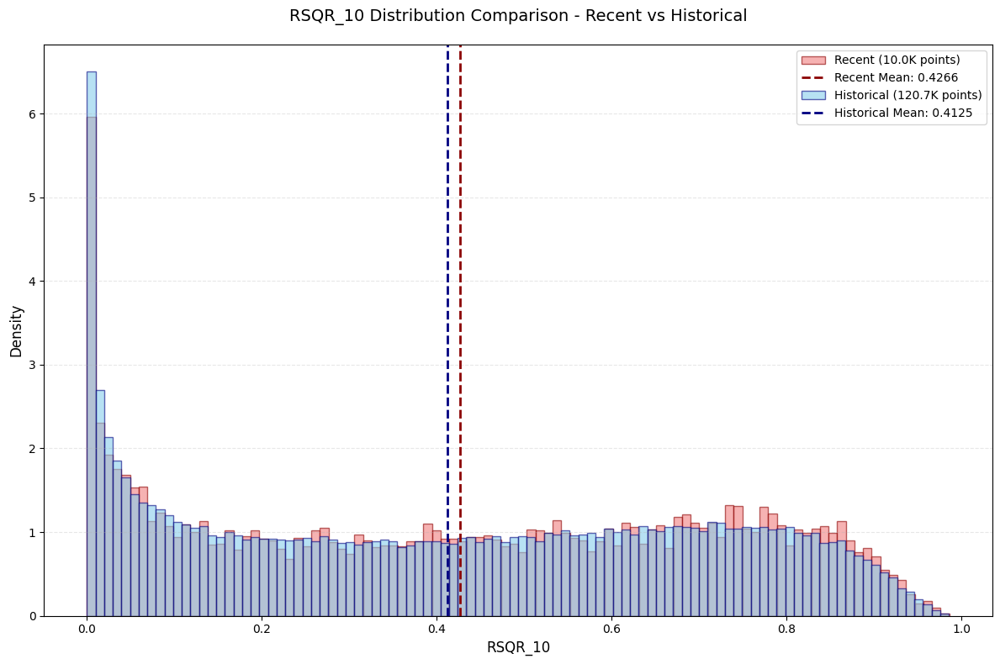

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  37%|███▋      | 53/143 [01:03<01:53,  1.26s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.008641
   Rank_IC (Spearman): -0.020806
📊 信息比率:
   IR: nan
   有效分组数: 7
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: IMAX_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


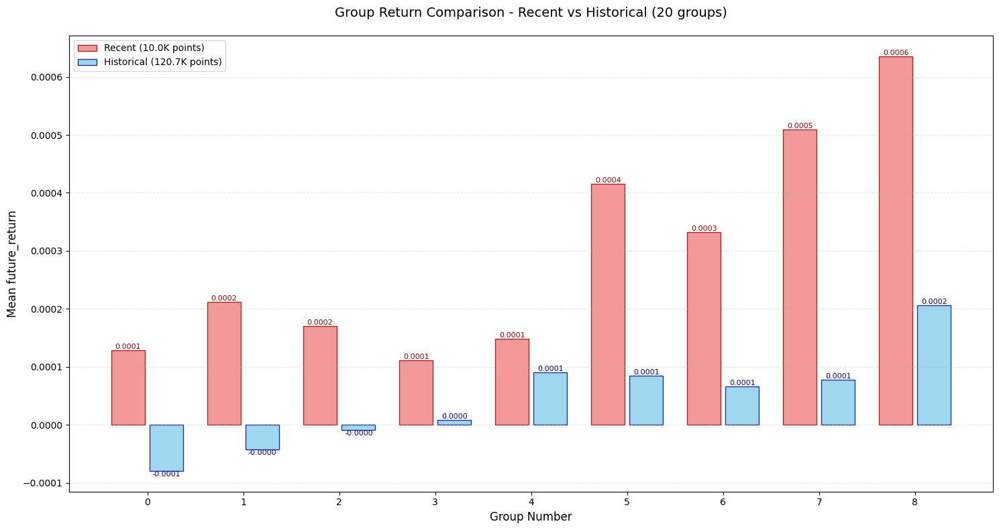

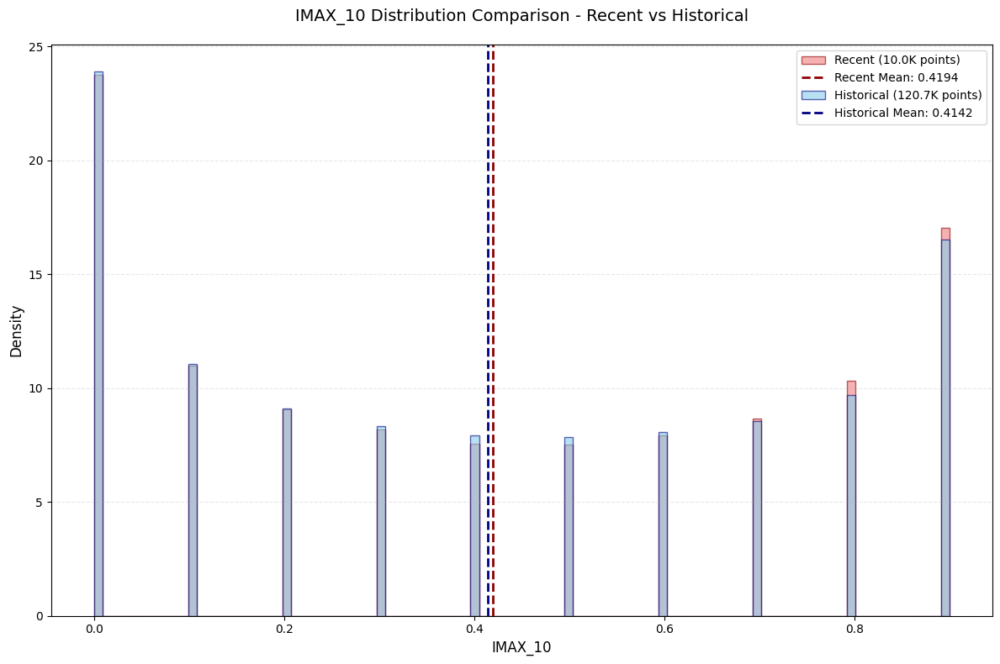

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  38%|███▊      | 54/143 [01:04<01:47,  1.21s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.000035
   Rank_IC (Spearman): 0.024968
📊 信息比率:
   IR: nan
   有效分组数: 7
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: IMIN_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


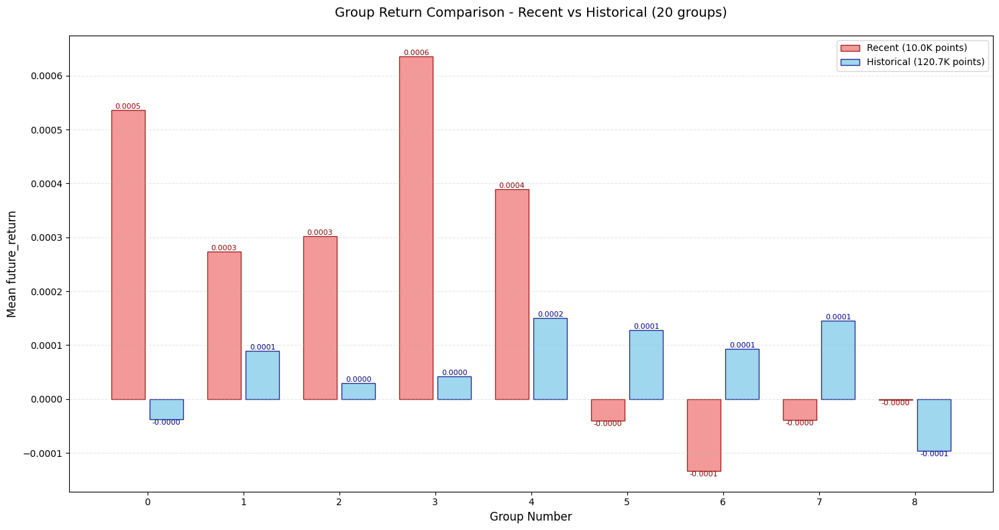

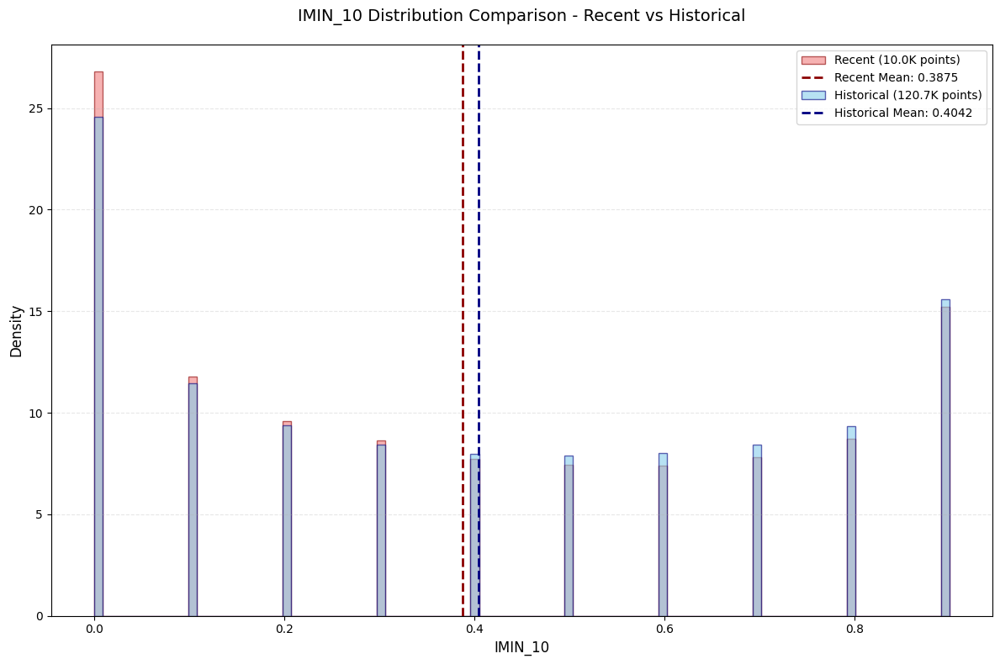

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  38%|███▊      | 55/143 [01:06<01:43,  1.18s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.005107
   Rank_IC (Spearman): -0.026513
📊 信息比率:
   IR: nan
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: IMXD_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


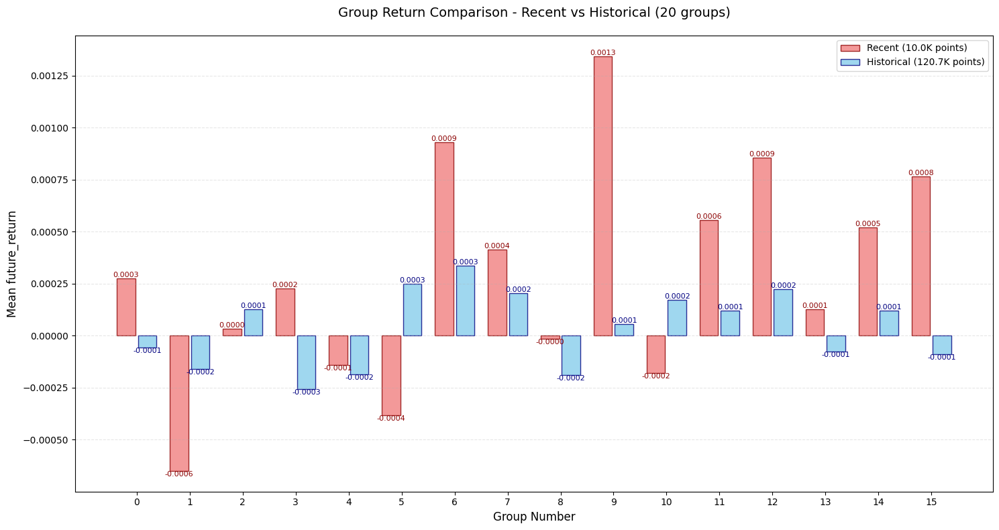

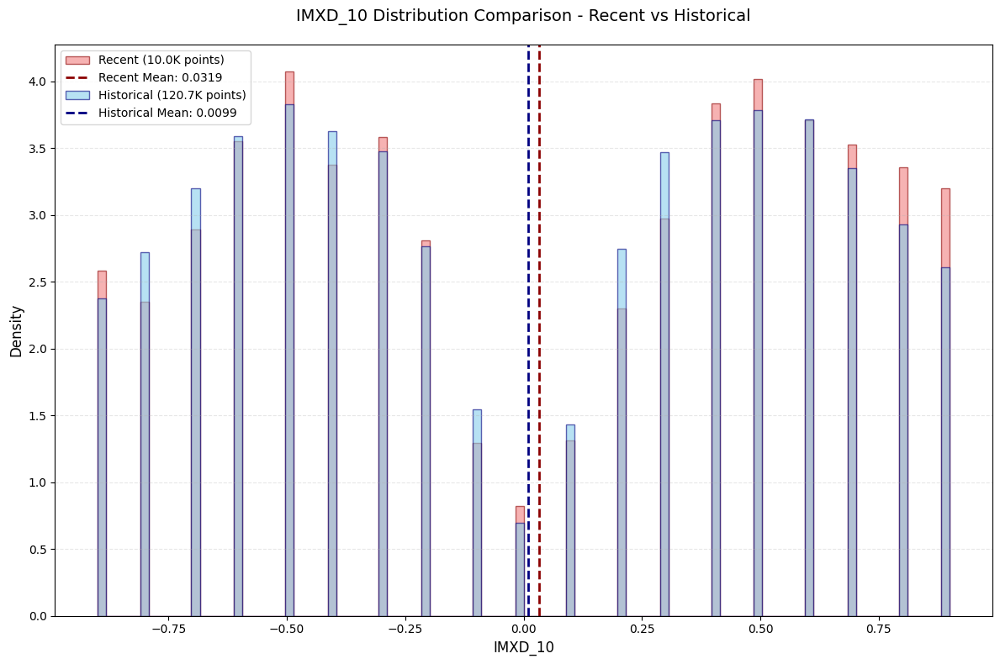

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  39%|███▉      | 56/143 [01:07<01:47,  1.24s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.001164
   Rank_IC (Spearman): 0.025234
📊 信息比率:
   IR: 0.404387
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: QTLD_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


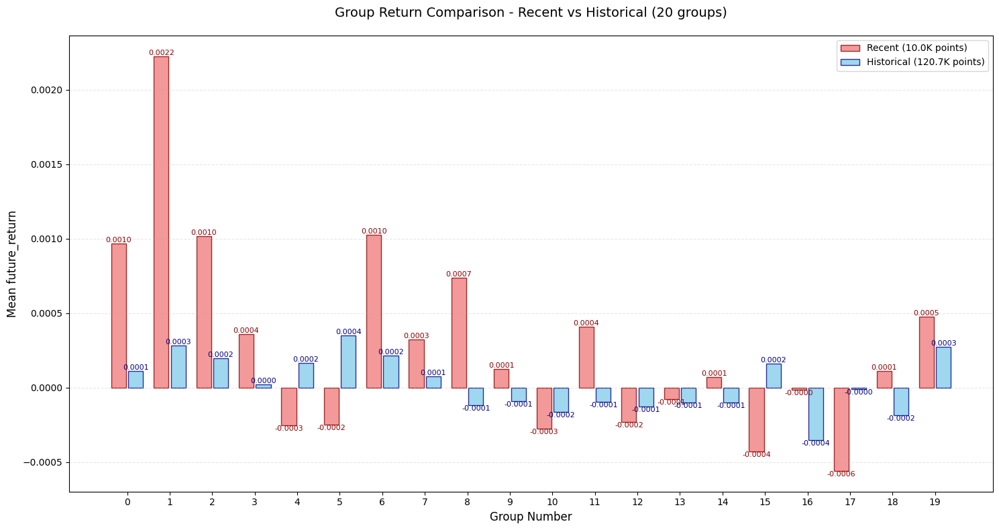

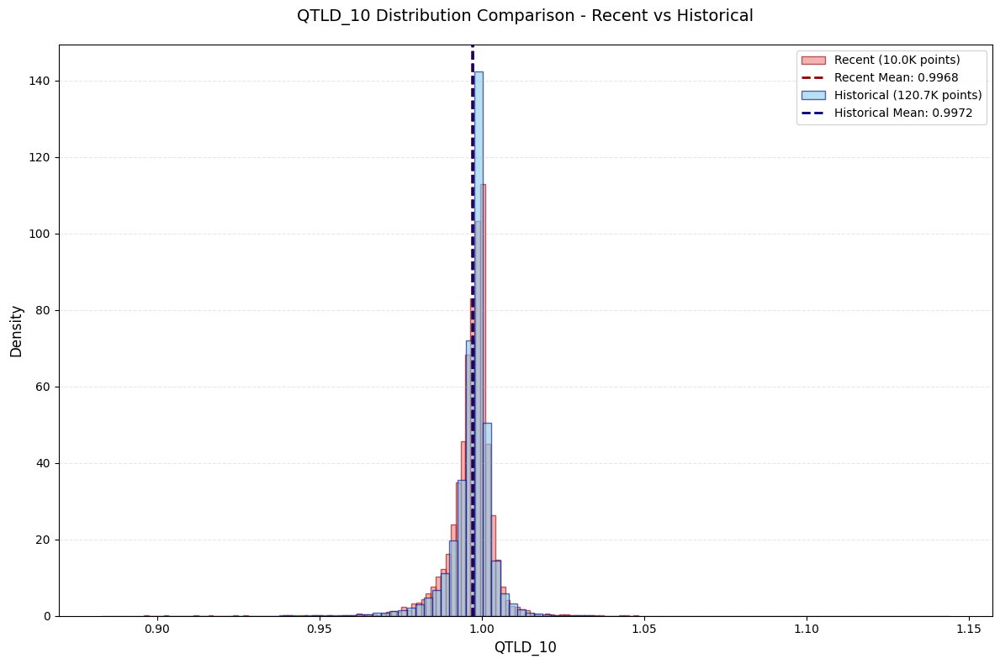

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  40%|███▉      | 57/143 [01:08<01:46,  1.24s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.011877
   Rank_IC (Spearman): 0.038396
📊 信息比率:
   IR: 0.337966
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: QTLU_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


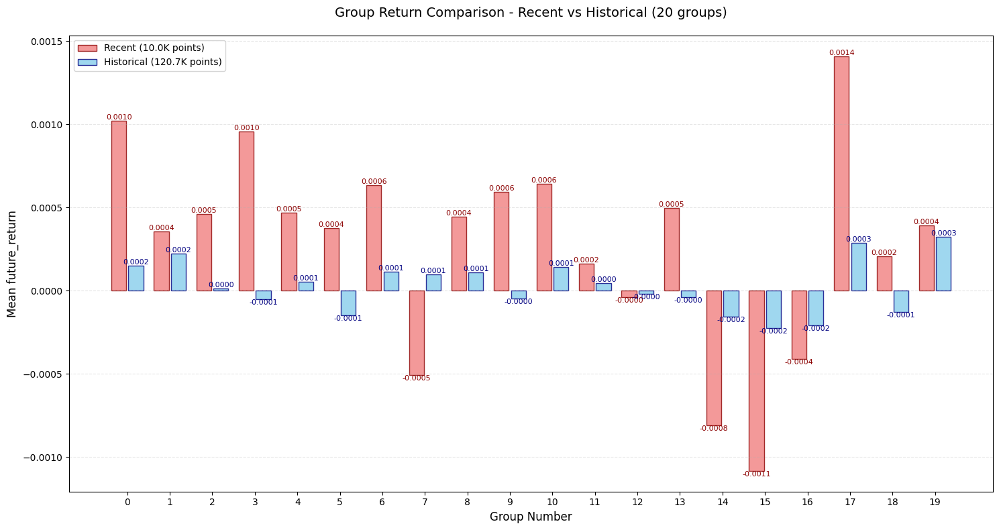

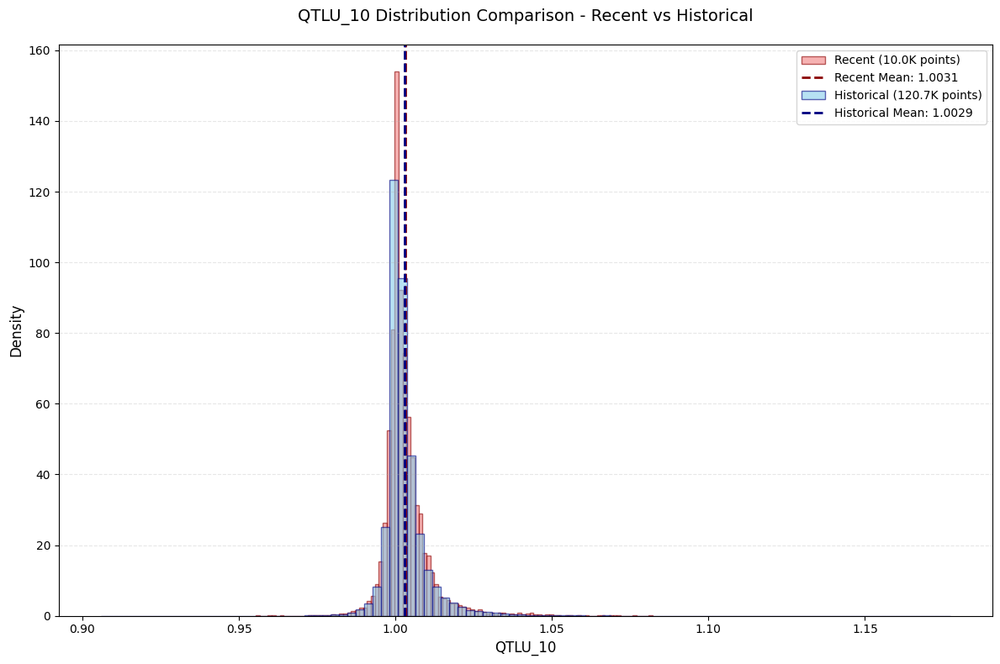

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  41%|████      | 58/143 [01:09<01:45,  1.24s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.008007
   Rank_IC (Spearman): -0.030788
📊 信息比率:
   IR: -0.584521
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: BETA_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


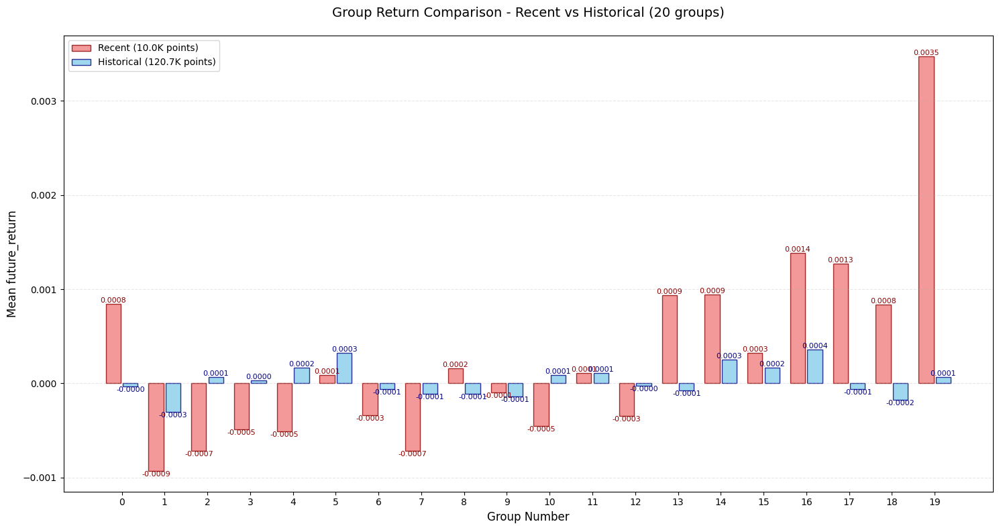

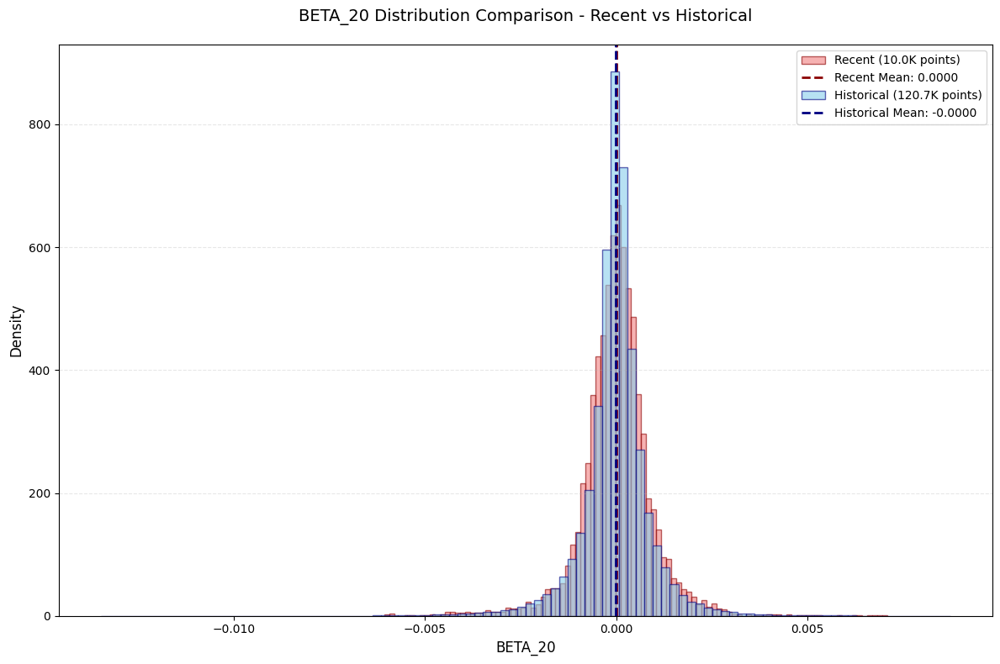

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  41%|████▏     | 59/143 [01:11<01:47,  1.27s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.010884
   Rank_IC (Spearman): -0.018235
📊 信息比率:
   IR: 0.896174
   有效分组数: 6
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTD_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


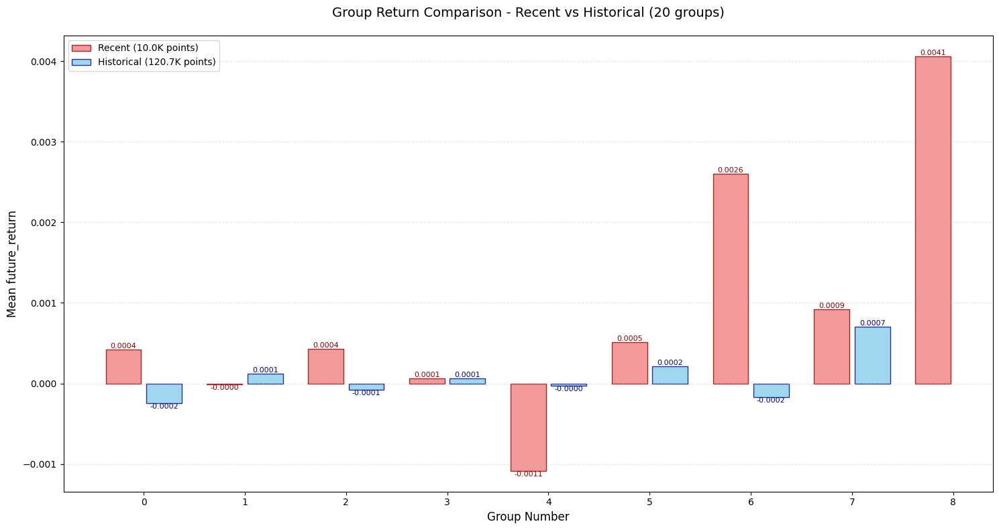

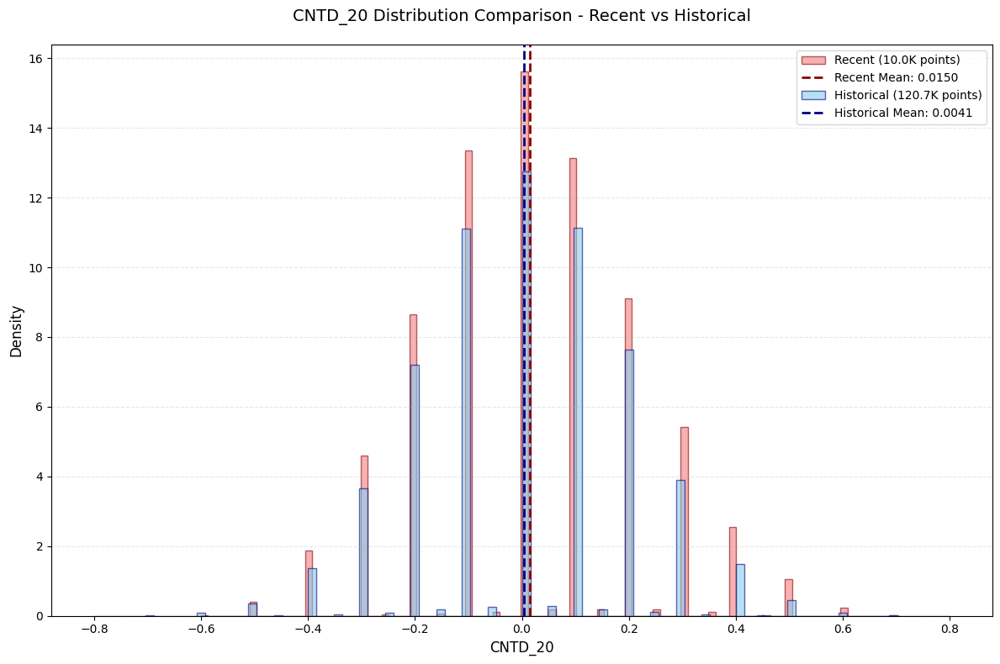

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  42%|████▏     | 60/143 [01:12<01:42,  1.23s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.011029
   Rank_IC (Spearman): -0.017919
📊 信息比率:
   IR: nan
   有效分组数: 6
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTP_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


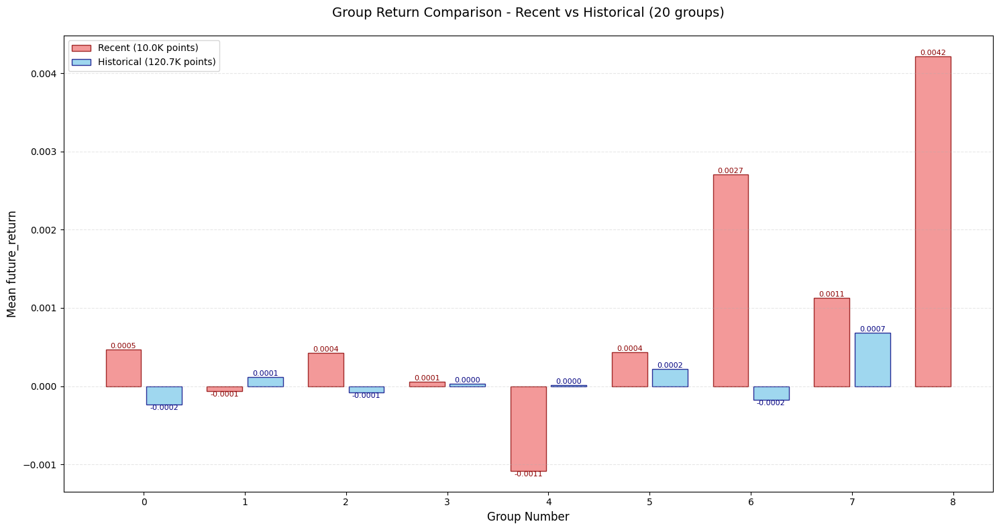

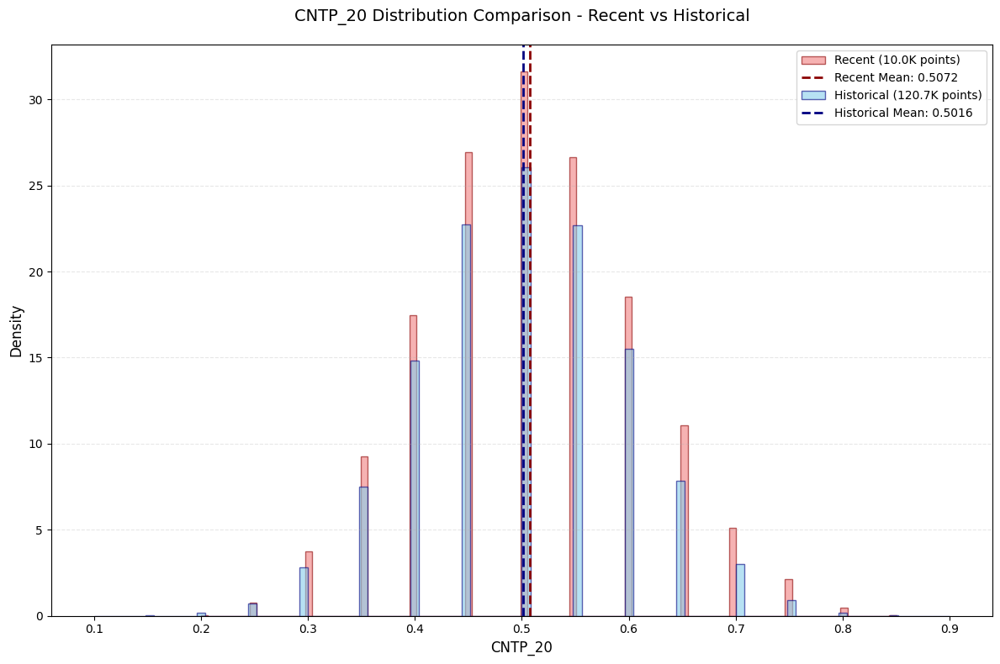

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  43%|████▎     | 61/143 [01:13<01:38,  1.21s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.010725
   Rank_IC (Spearman): 0.018532
📊 信息比率:
   IR: nan
   有效分组数: 6
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTN_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


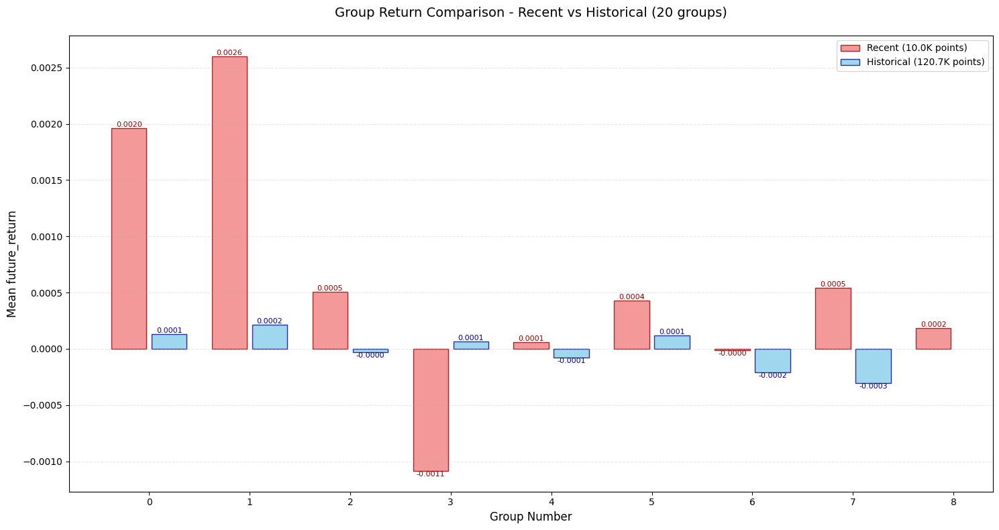

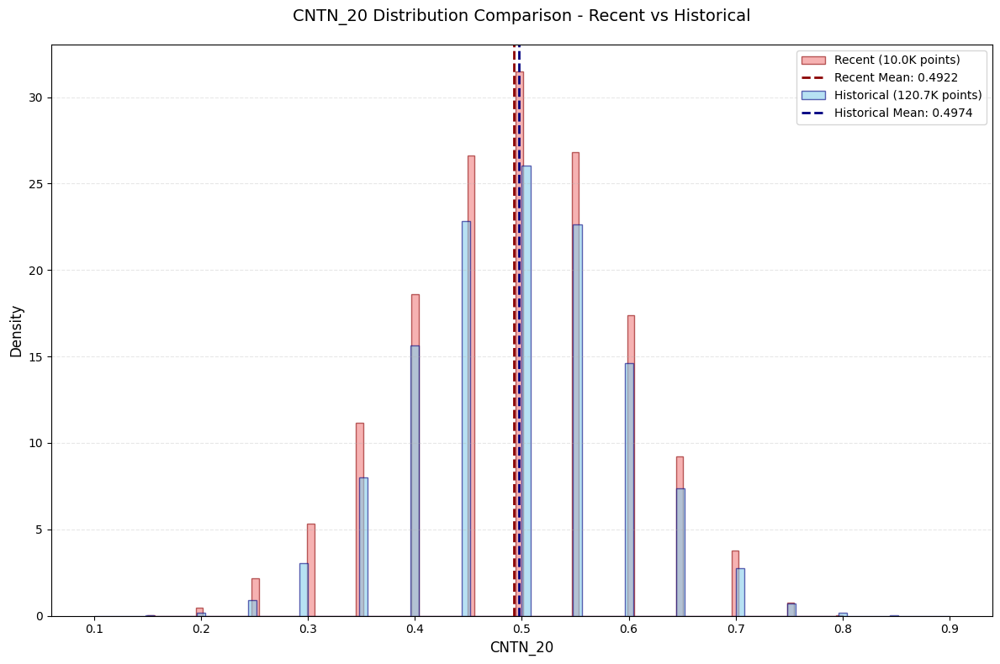

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  43%|████▎     | 62/143 [01:14<01:39,  1.22s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.012063
   Rank_IC (Spearman): 0.035379
📊 信息比率:
   IR: 0.234678
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MAX_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


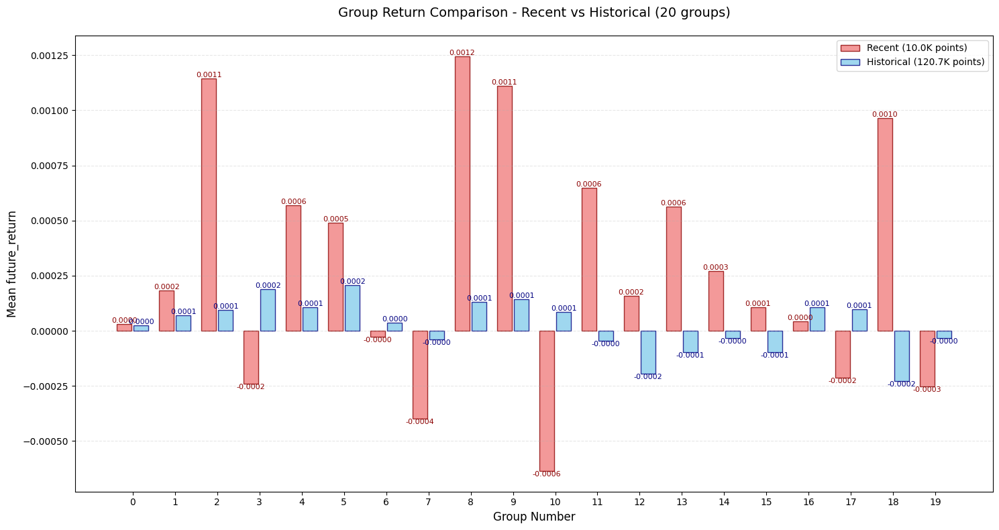

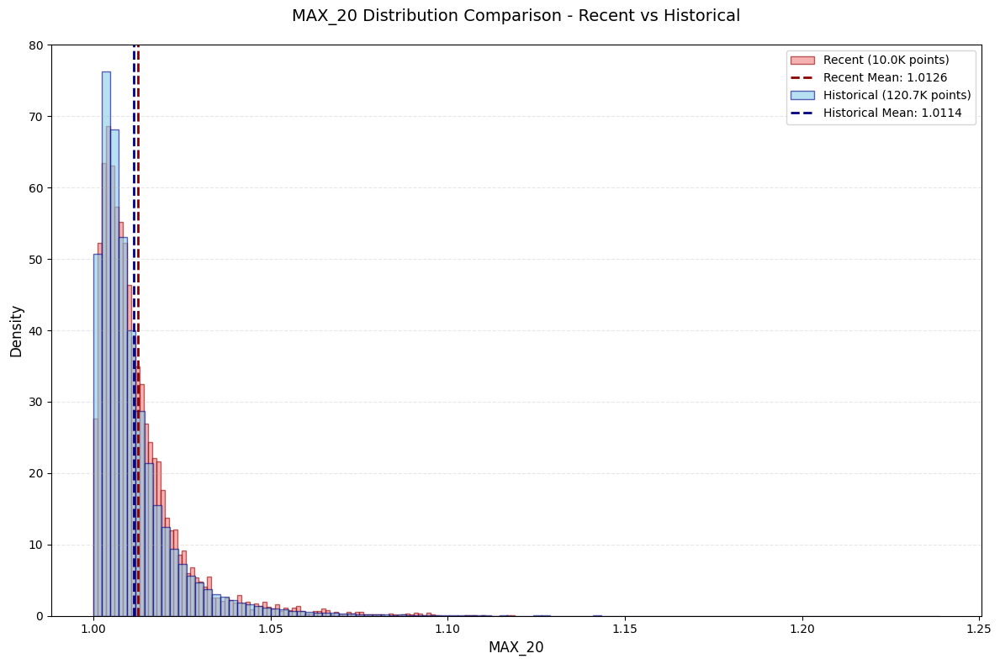

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  44%|████▍     | 63/143 [01:16<01:39,  1.24s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.010088
   Rank_IC (Spearman): 0.000133
📊 信息比率:
   IR: -0.141958
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MIN_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


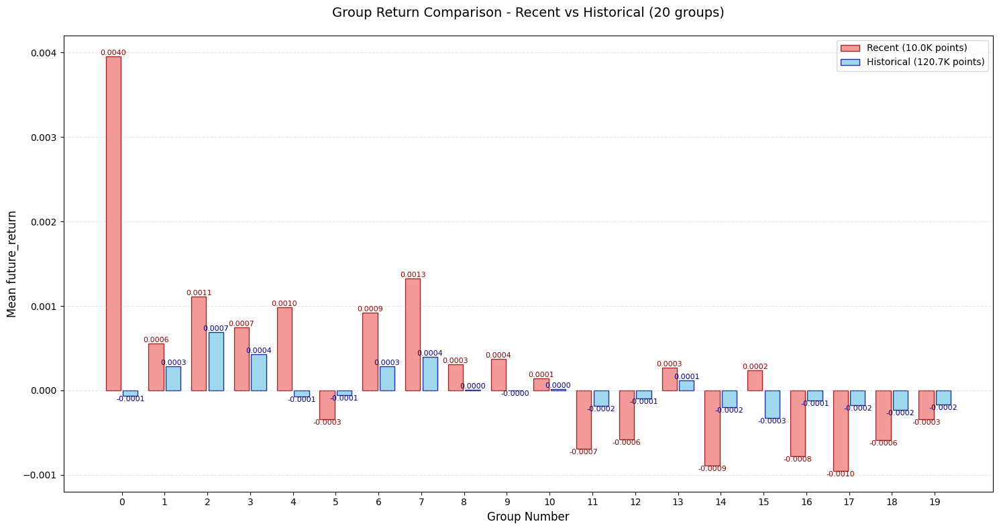

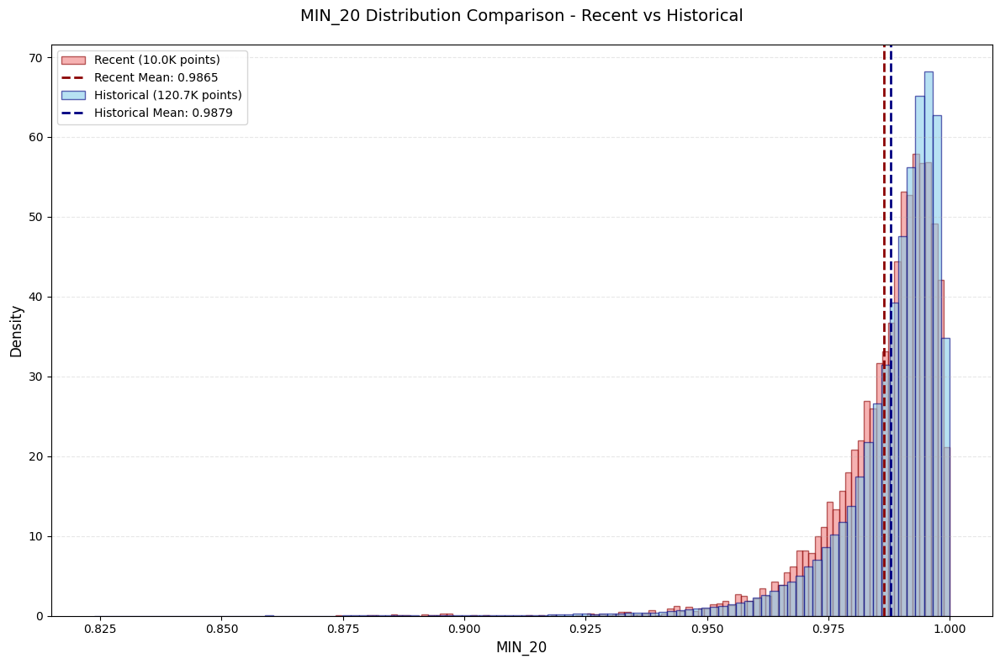

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  45%|████▍     | 64/143 [01:17<01:39,  1.25s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.006472
   Rank_IC (Spearman): 0.034154
📊 信息比率:
   IR: 0.310231
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: ROC_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


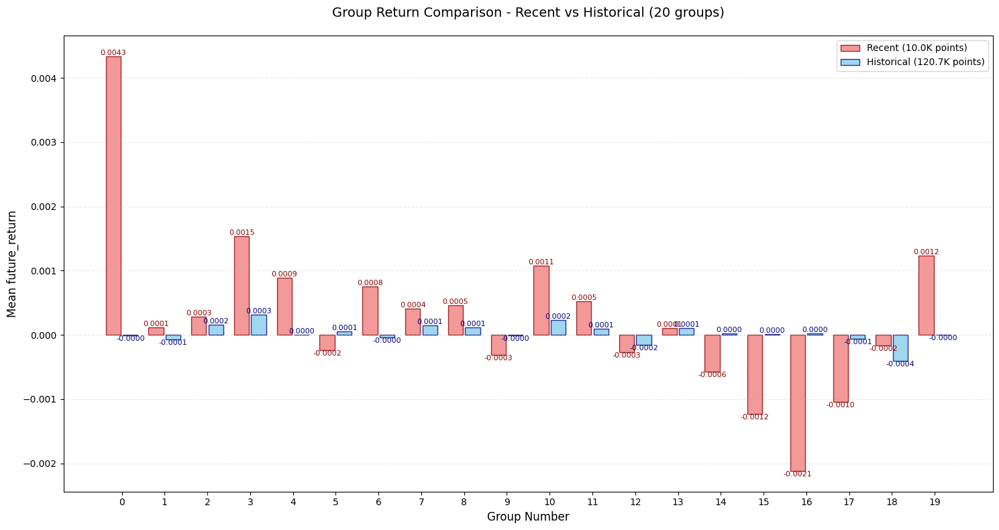

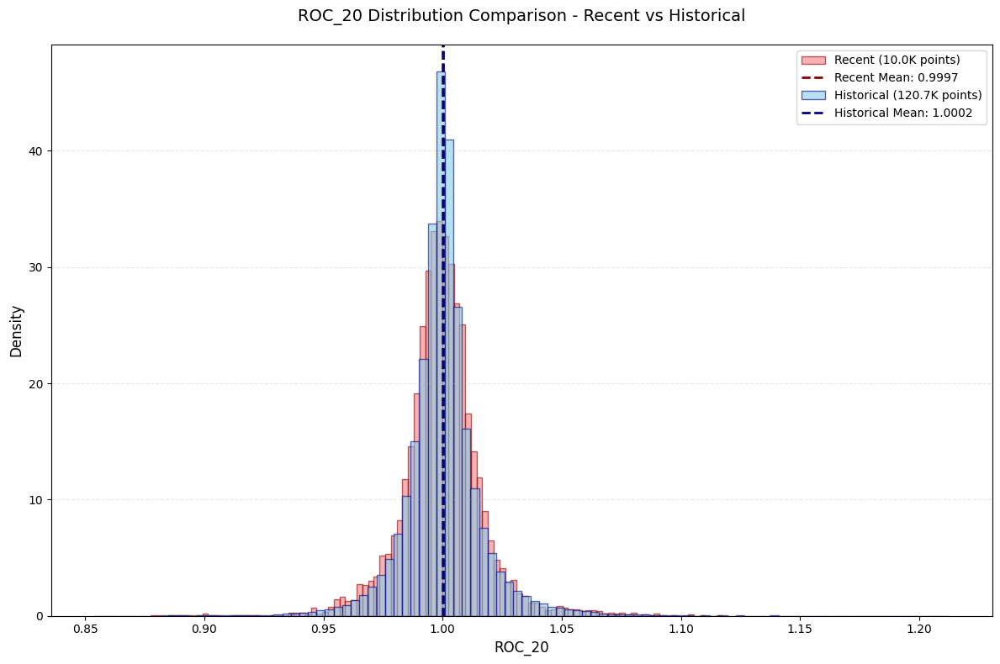

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  45%|████▌     | 65/143 [01:18<01:40,  1.29s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.012805
   Rank_IC (Spearman): -0.027999
📊 信息比率:
   IR: -0.577552
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RSV_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


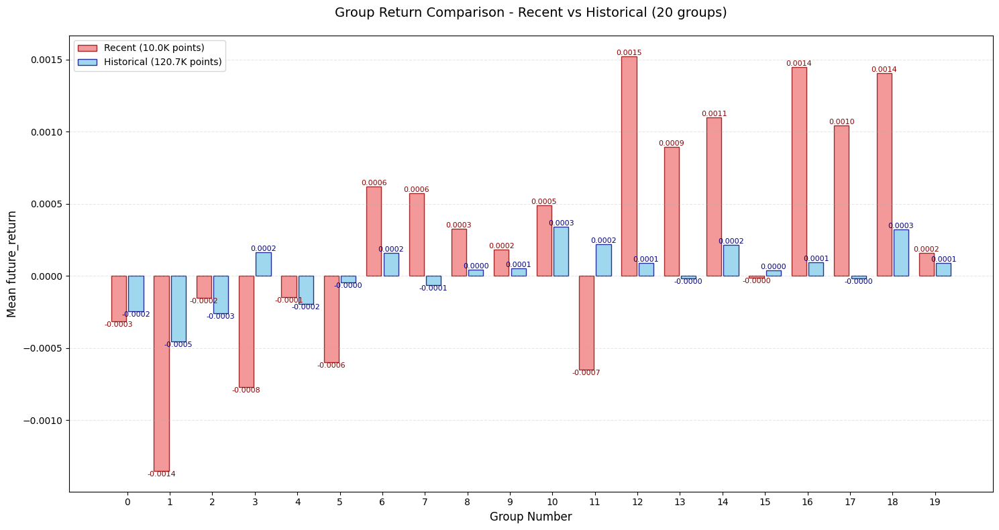

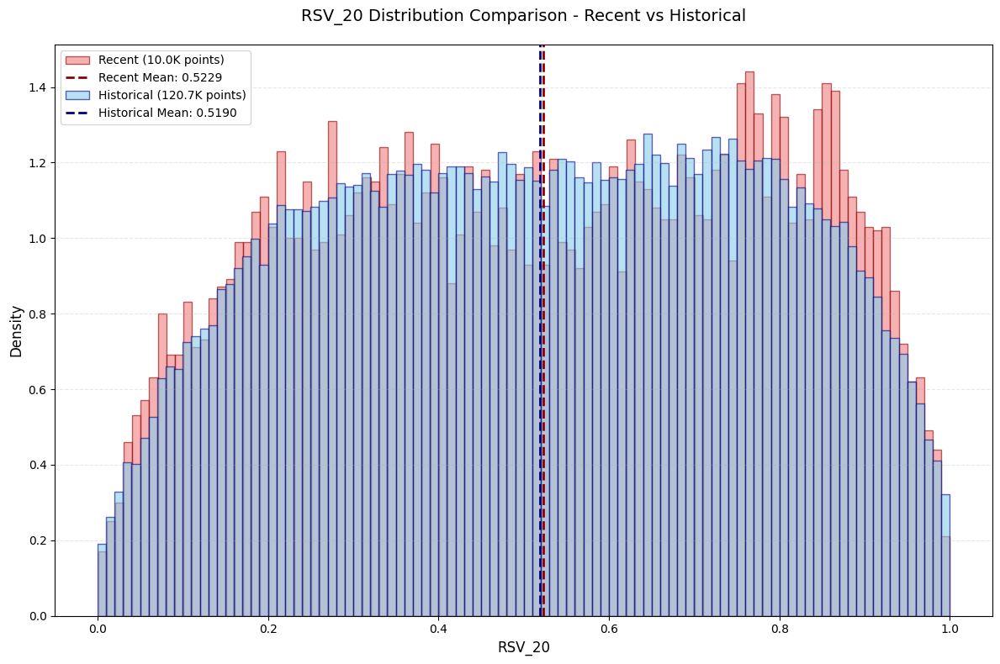

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  46%|████▌     | 66/143 [01:20<01:39,  1.29s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.012198
   Rank_IC (Spearman): -0.033894
📊 信息比率:
   IR: 0.546800
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: SUMP_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


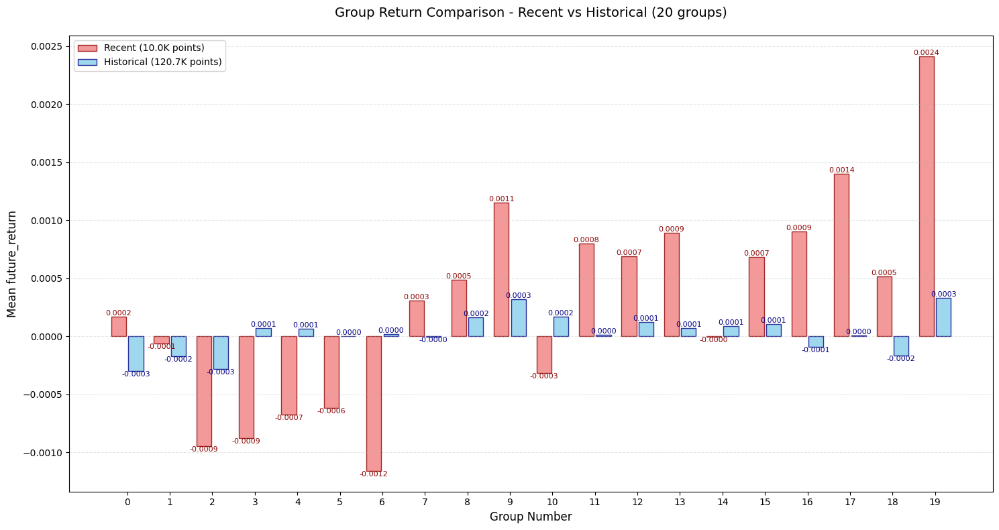

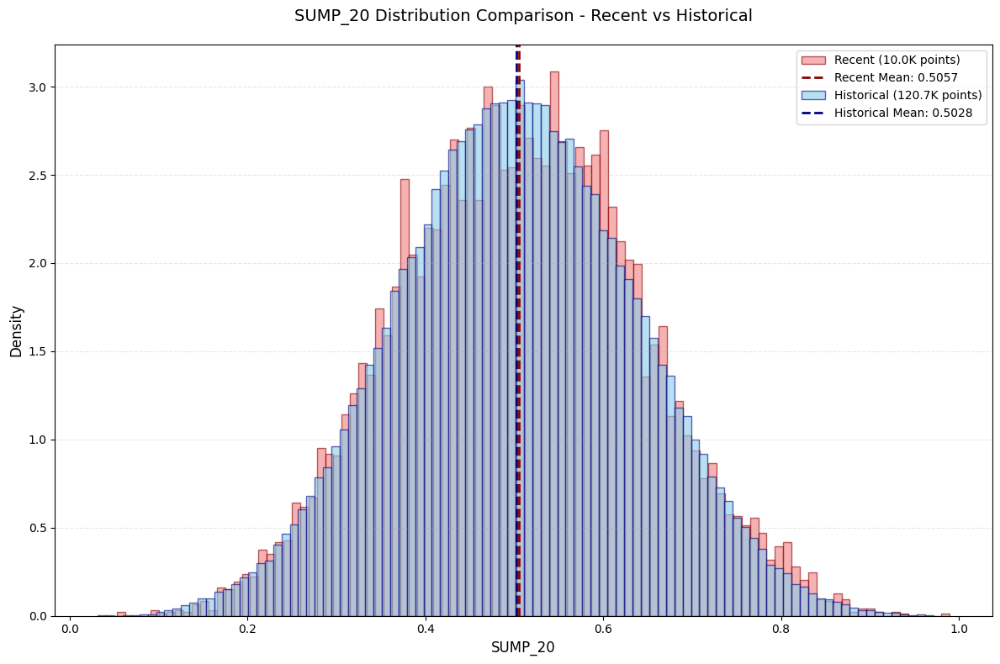

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  47%|████▋     | 67/143 [01:21<01:37,  1.28s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.012198
   Rank_IC (Spearman): 0.033894
📊 信息比率:
   IR: -0.548300
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: SUMN_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


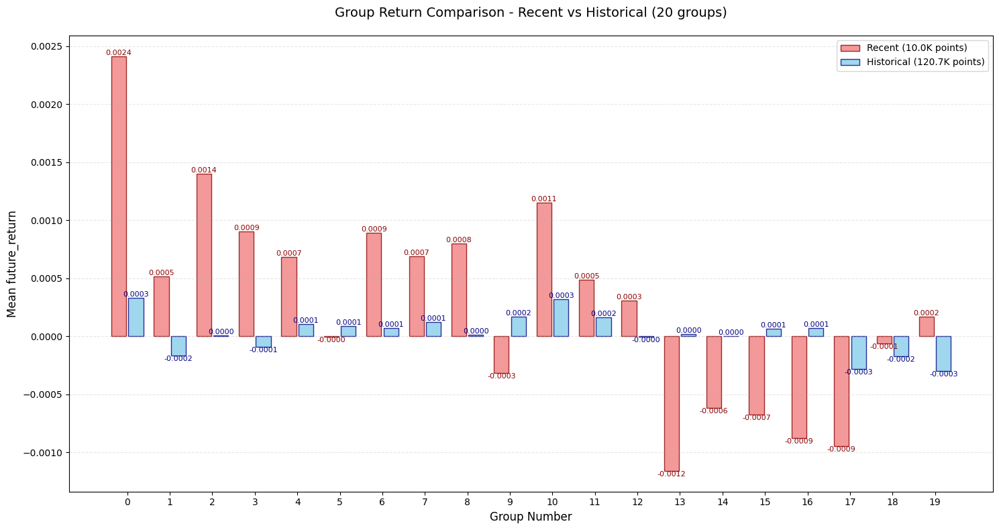

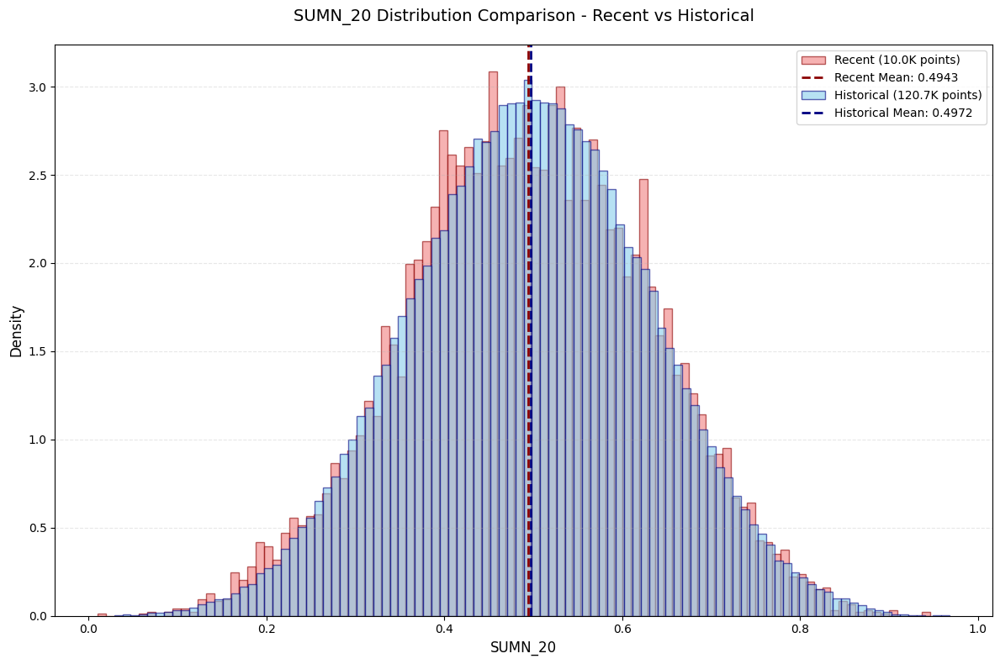

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  48%|████▊     | 68/143 [01:22<01:36,  1.28s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.012198
   Rank_IC (Spearman): -0.033894
📊 信息比率:
   IR: 0.546800
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: SUMD_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


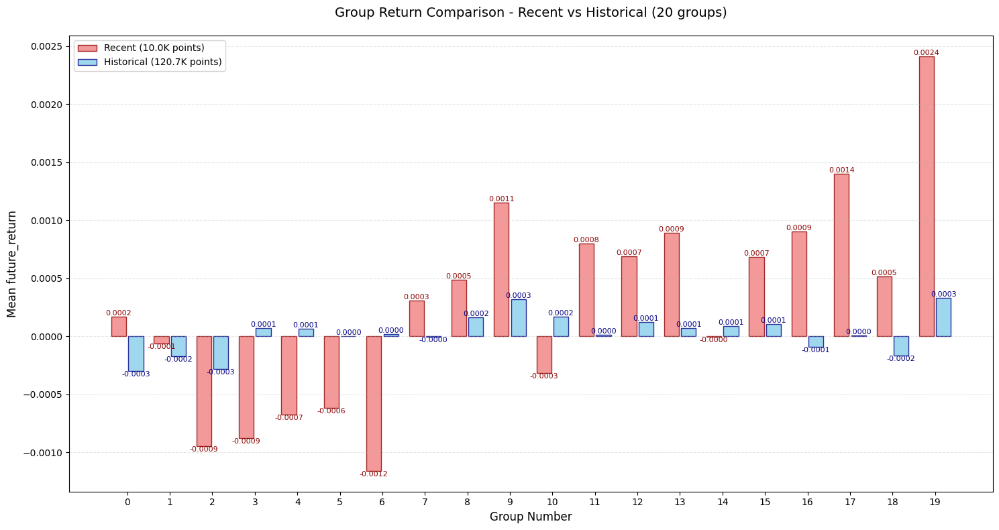

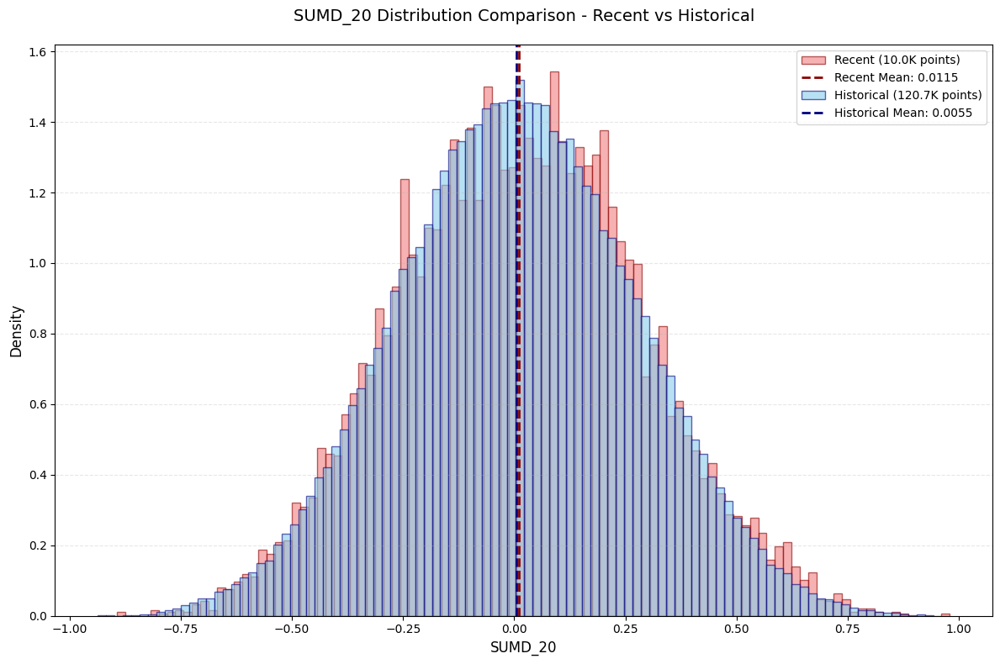

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  48%|████▊     | 69/143 [01:24<01:37,  1.32s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.008115
   Rank_IC (Spearman): 0.038384
📊 信息比率:
   IR: 0.330522
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MA_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


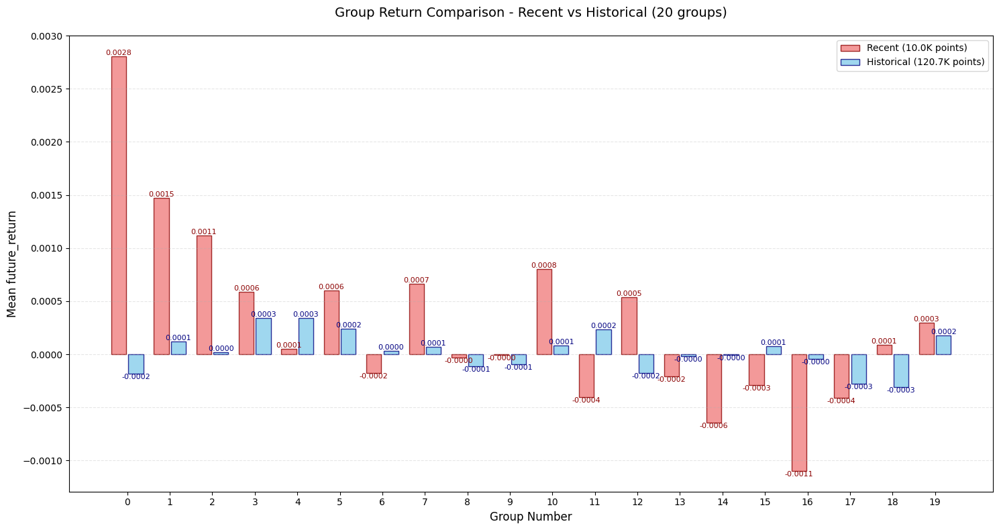

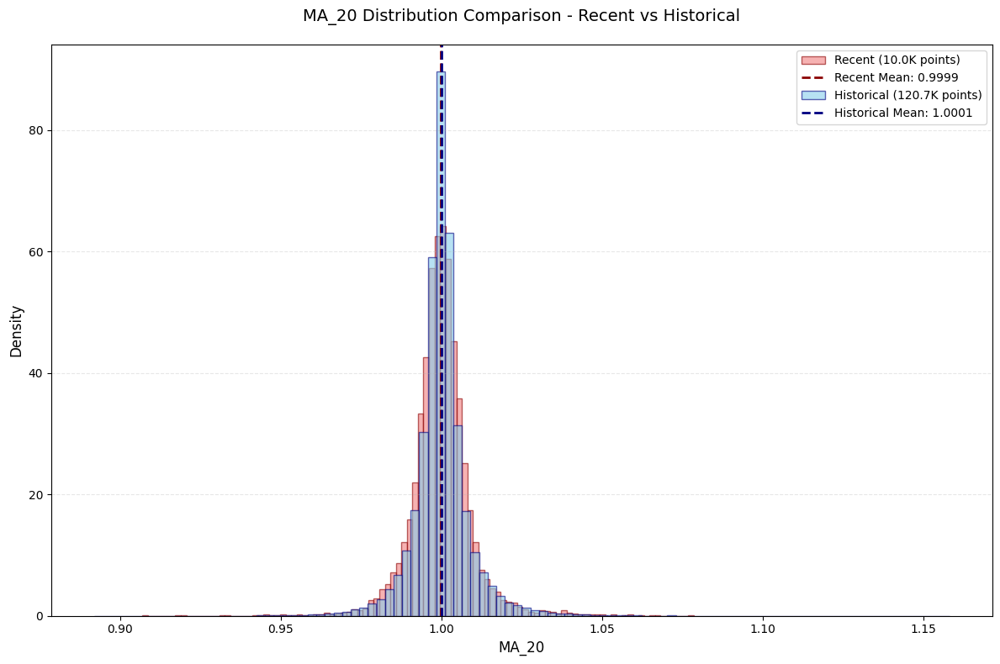

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  49%|████▉     | 70/143 [01:25<01:35,  1.31s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.008544
   Rank_IC (Spearman): -0.036354
📊 信息比率:
   IR: 0.199845
   有效分组数: 9
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RANK_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


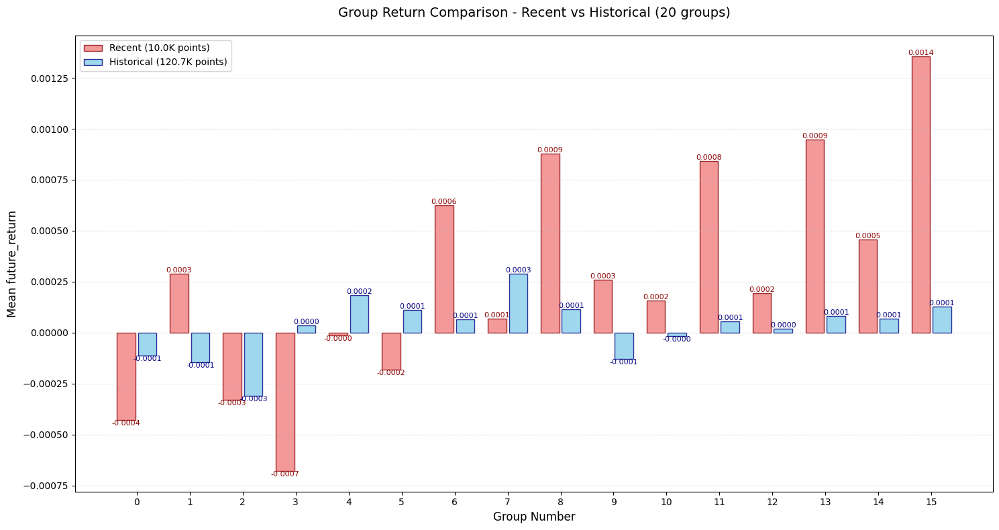

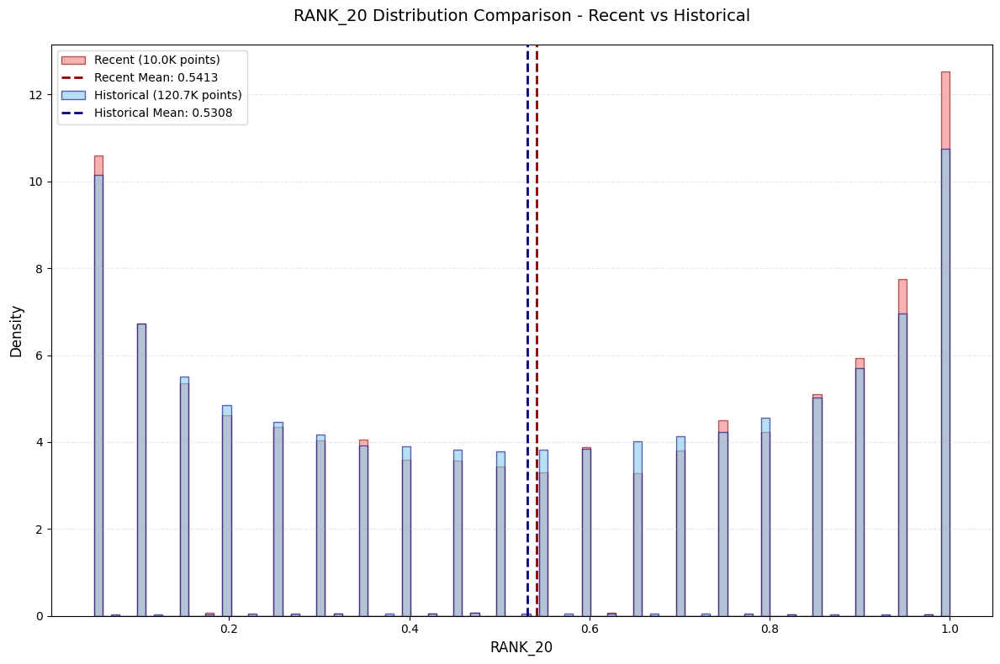

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  50%|████▉     | 71/143 [01:26<01:34,  1.32s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.001032
   Rank_IC (Spearman): -0.013249
📊 信息比率:
   IR: 0.074783
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RESI_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


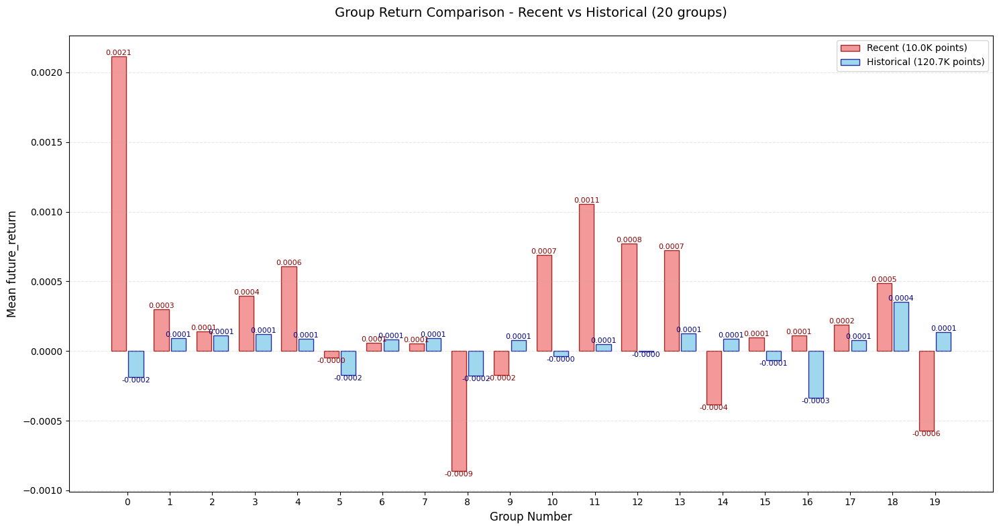

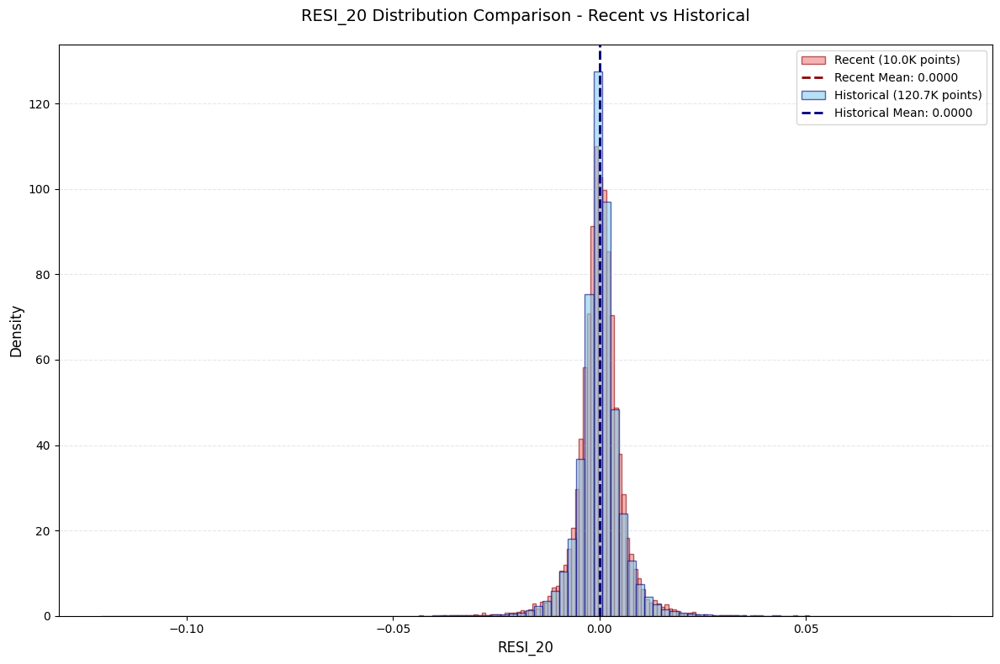

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  50%|█████     | 72/143 [01:27<01:32,  1.30s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.002830
   Rank_IC (Spearman): 0.001397
📊 信息比率:
   IR: 0.199470
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RSQR_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


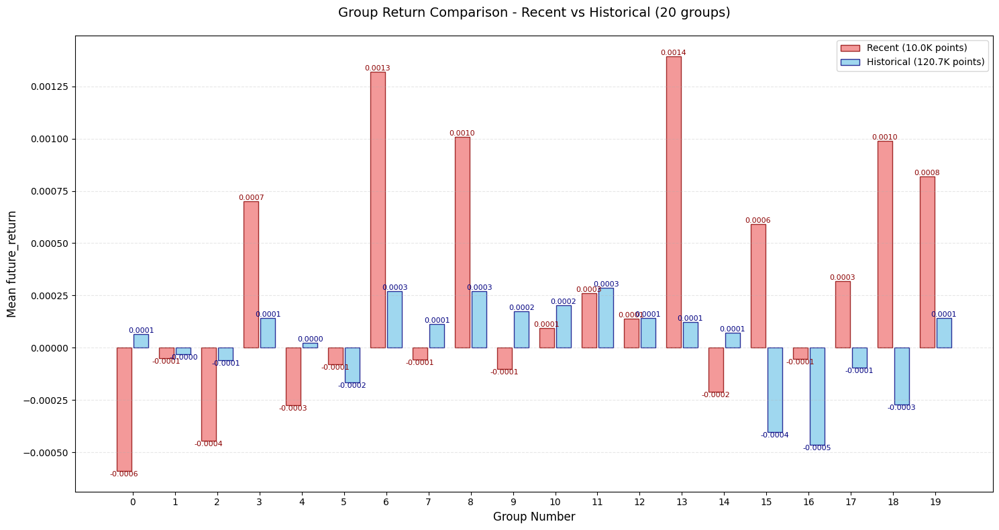

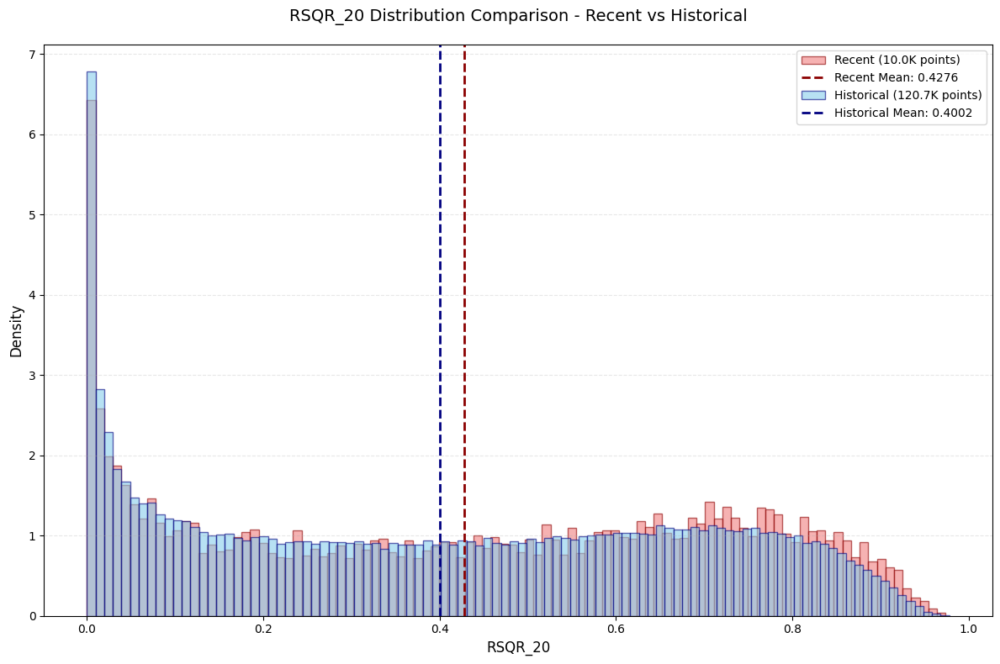

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  51%|█████     | 73/143 [01:29<01:30,  1.29s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.003127
   Rank_IC (Spearman): -0.028655
📊 信息比率:
   IR: nan
   有效分组数: 9
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: IMAX_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


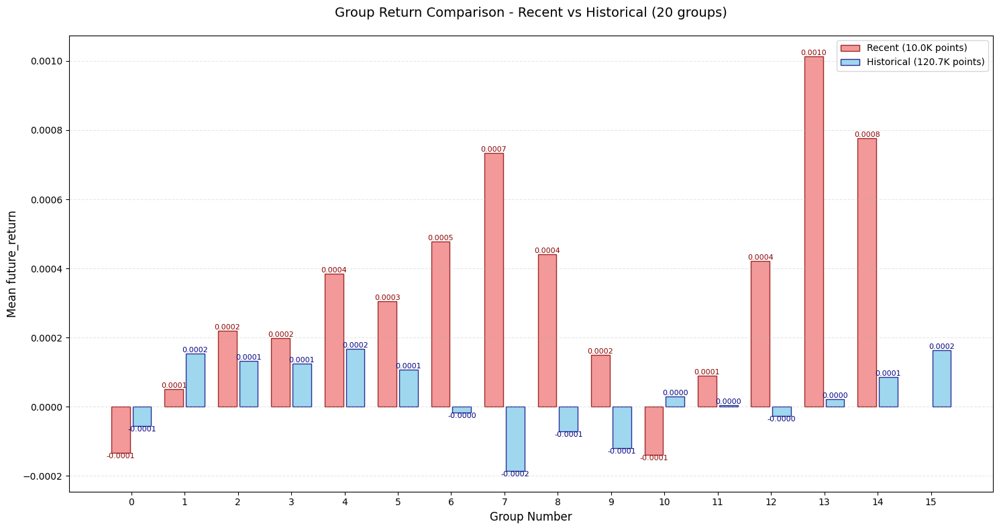

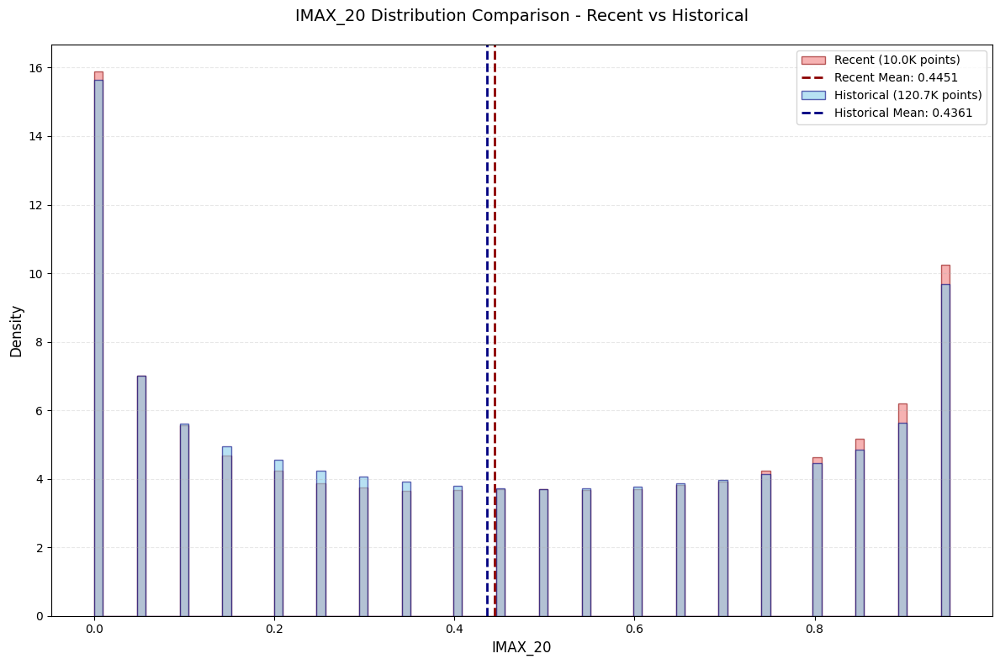

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  52%|█████▏    | 74/143 [01:30<01:27,  1.27s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.003493
   Rank_IC (Spearman): 0.024863
📊 信息比率:
   IR: nan
   有效分组数: 9
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: IMIN_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


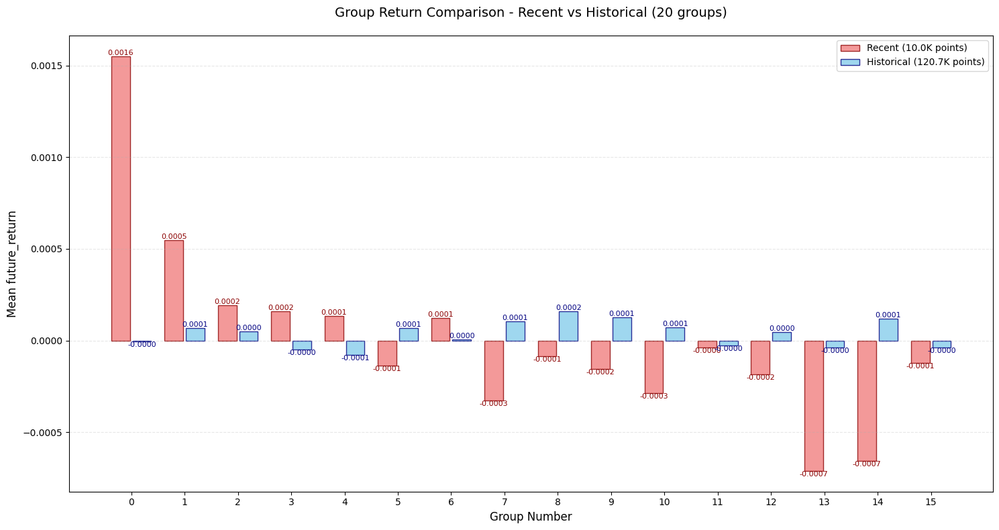

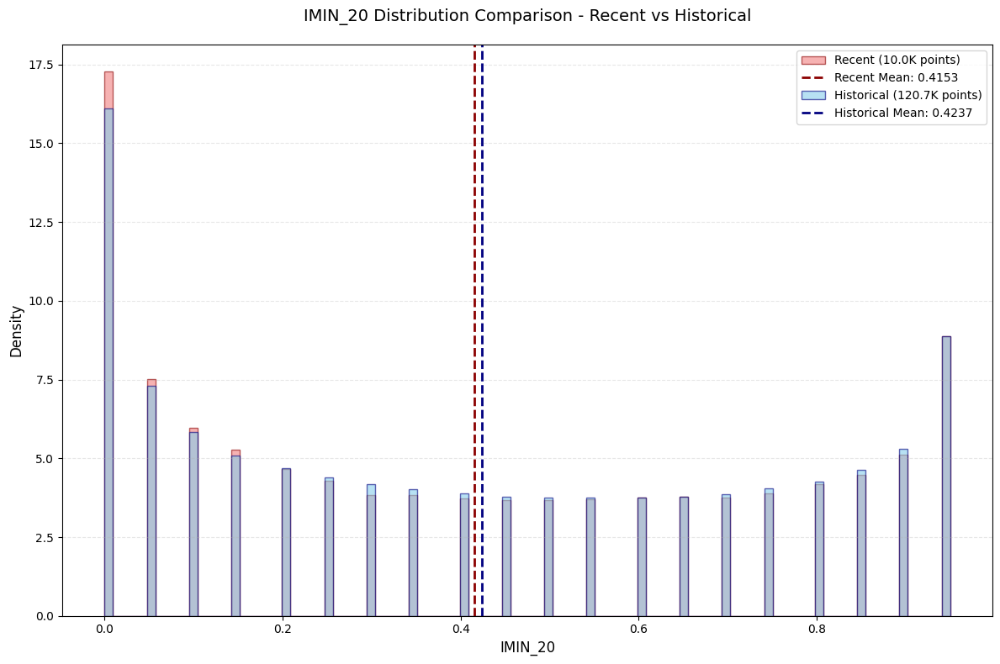

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  52%|█████▏    | 75/143 [01:31<01:27,  1.28s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.003925
   Rank_IC (Spearman): -0.033004
📊 信息比率:
   IR: 0.722650
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: IMXD_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


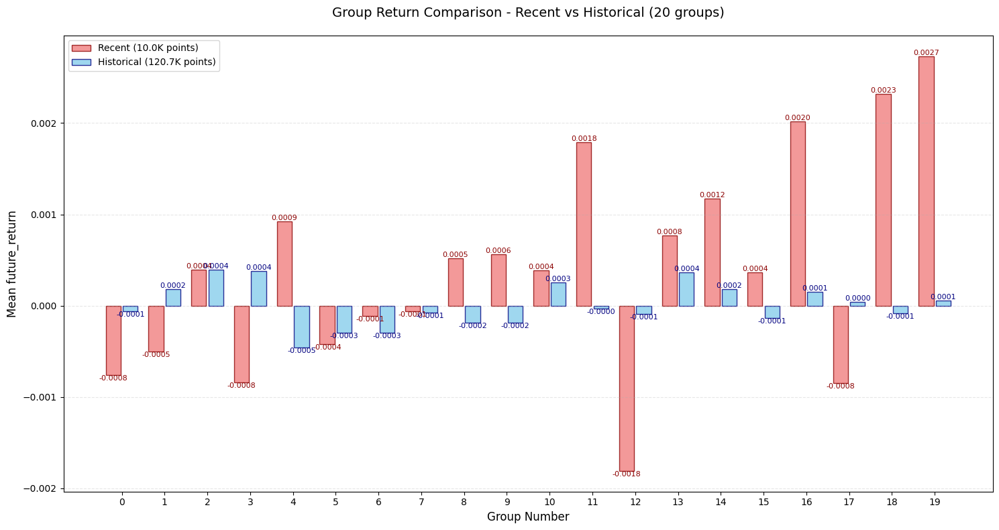

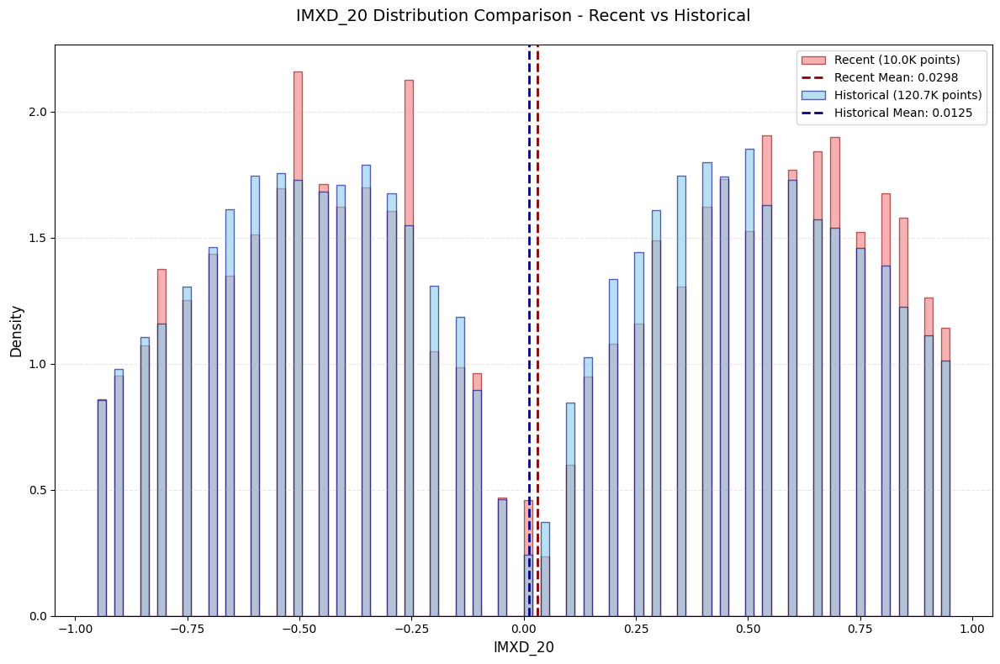

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  53%|█████▎    | 76/143 [01:32<01:25,  1.28s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.001689
   Rank_IC (Spearman): 0.029758
📊 信息比率:
   IR: 0.576858
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: QTLD_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


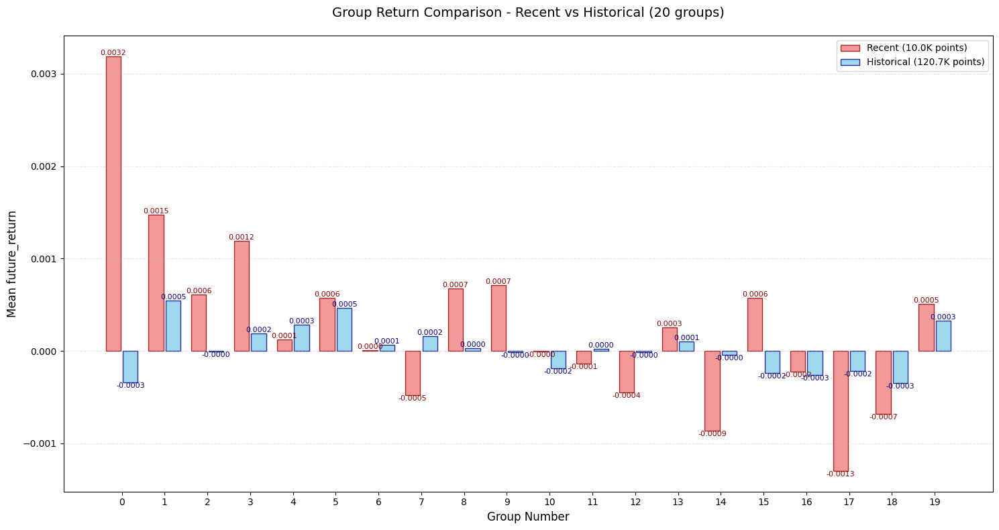

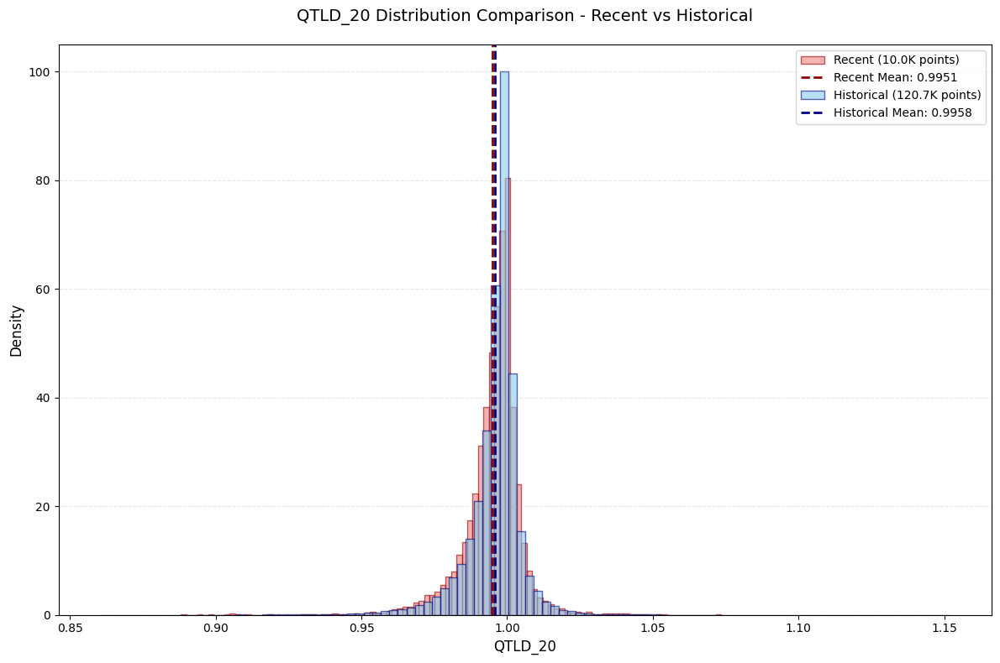

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  54%|█████▍    | 77/143 [01:34<01:24,  1.28s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.013317
   Rank_IC (Spearman): 0.043744
📊 信息比率:
   IR: 0.173497
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: QTLU_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


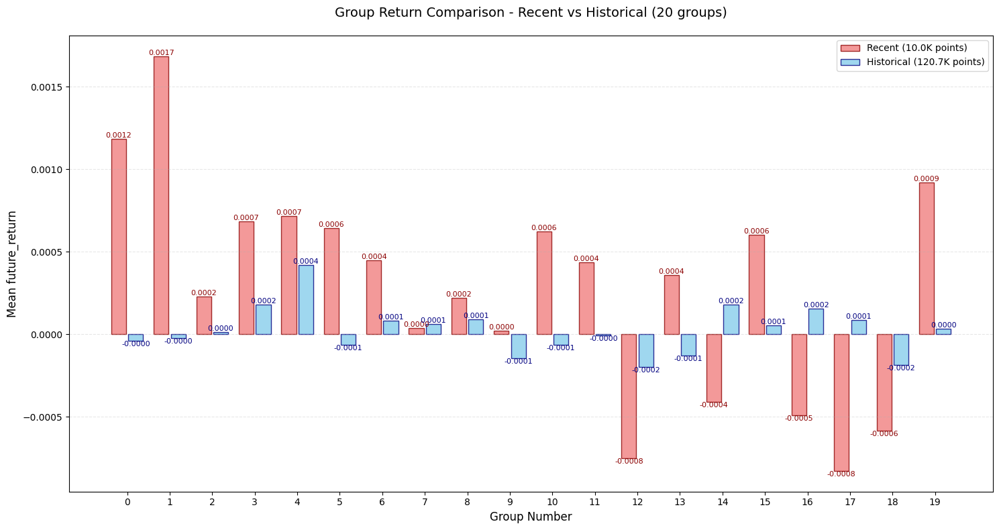

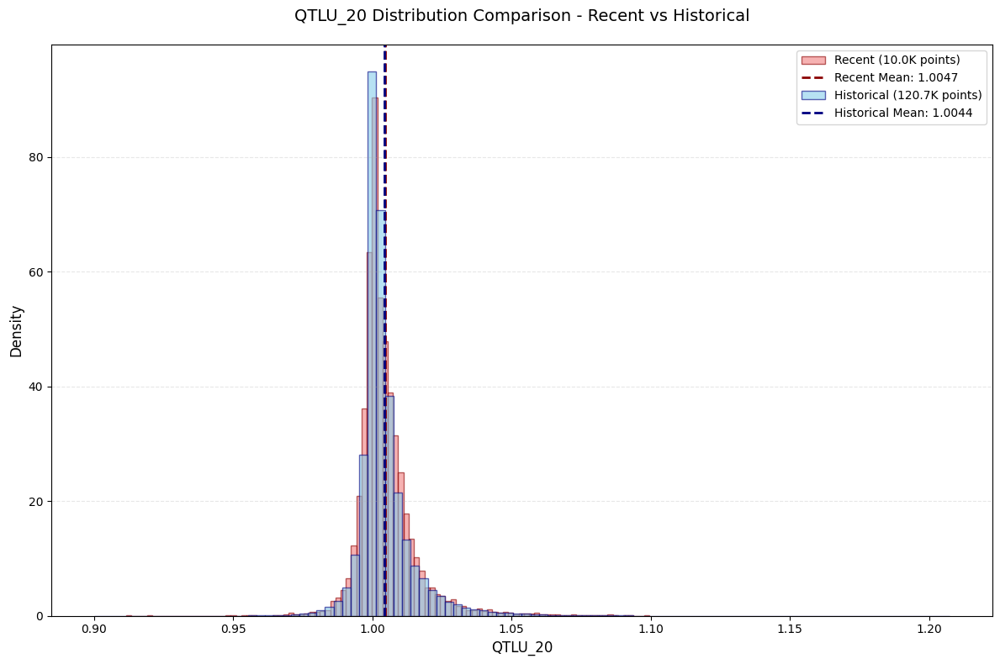

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  55%|█████▍    | 78/143 [01:35<01:25,  1.31s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.003485
   Rank_IC (Spearman): -0.029458
📊 信息比率:
   IR: -0.171089
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: BETA_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


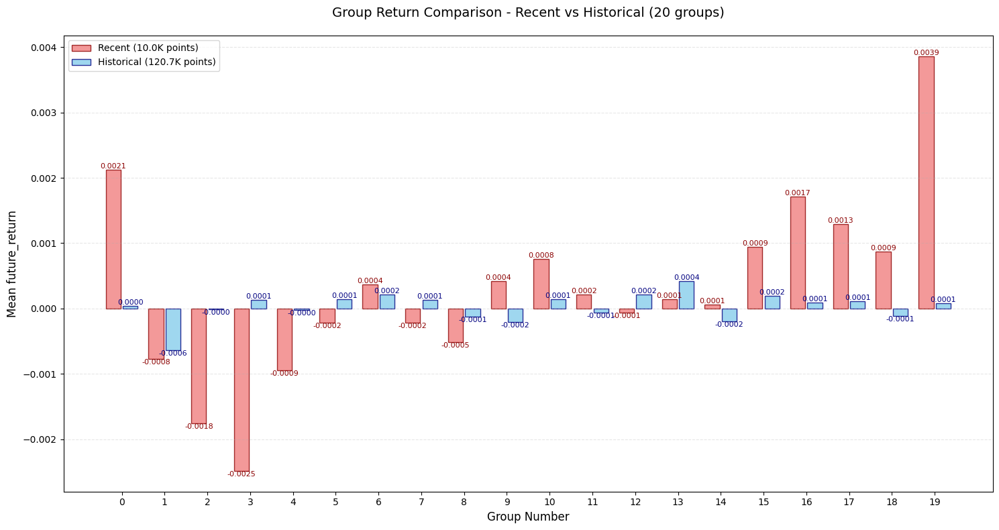

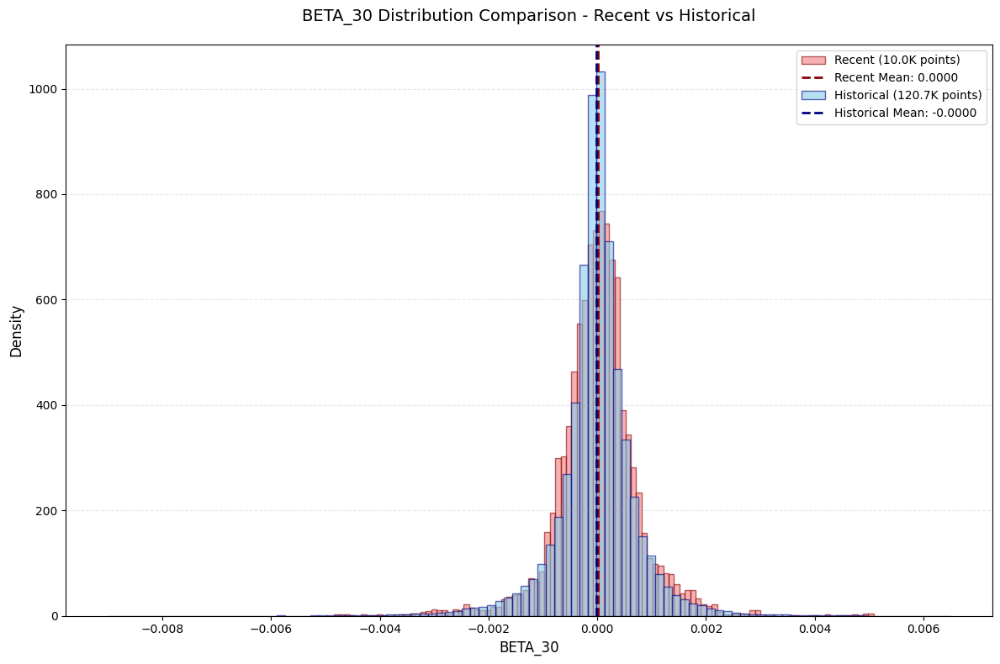

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  55%|█████▌    | 79/143 [01:36<01:23,  1.30s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.010185
   Rank_IC (Spearman): -0.017318
📊 信息比率:
   IR: nan
   有效分组数: 9
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTD_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


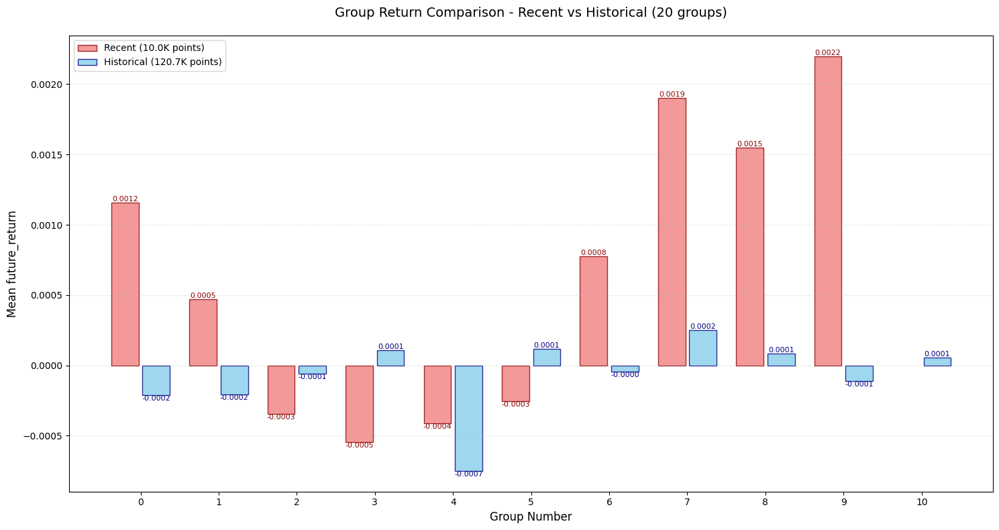

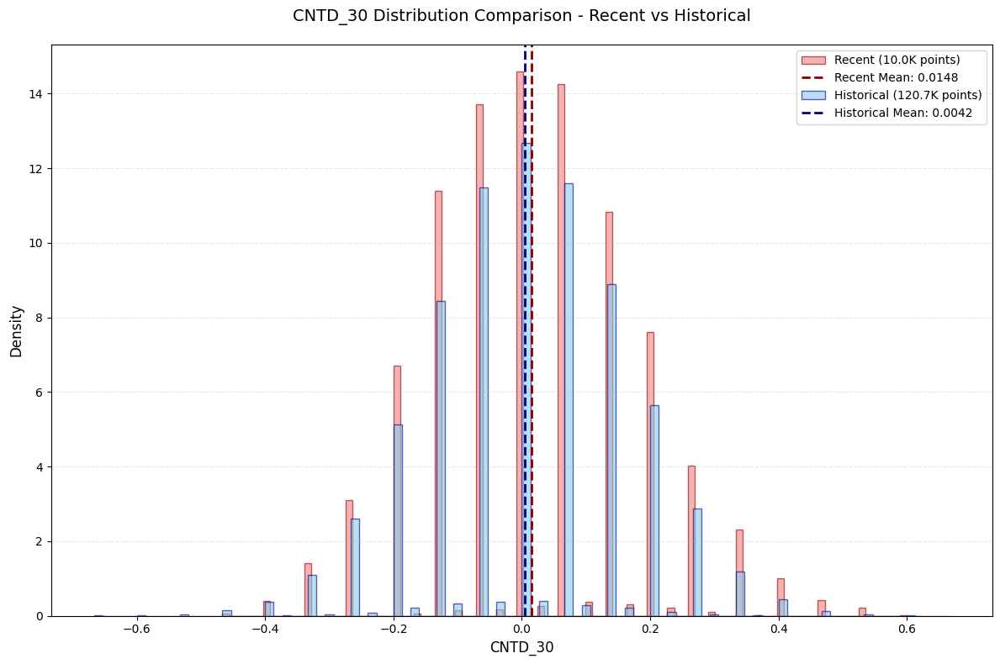

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  56%|█████▌    | 80/143 [01:38<01:19,  1.26s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.010642
   Rank_IC (Spearman): -0.016854
📊 信息比率:
   IR: nan
   有效分组数: 8
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTP_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


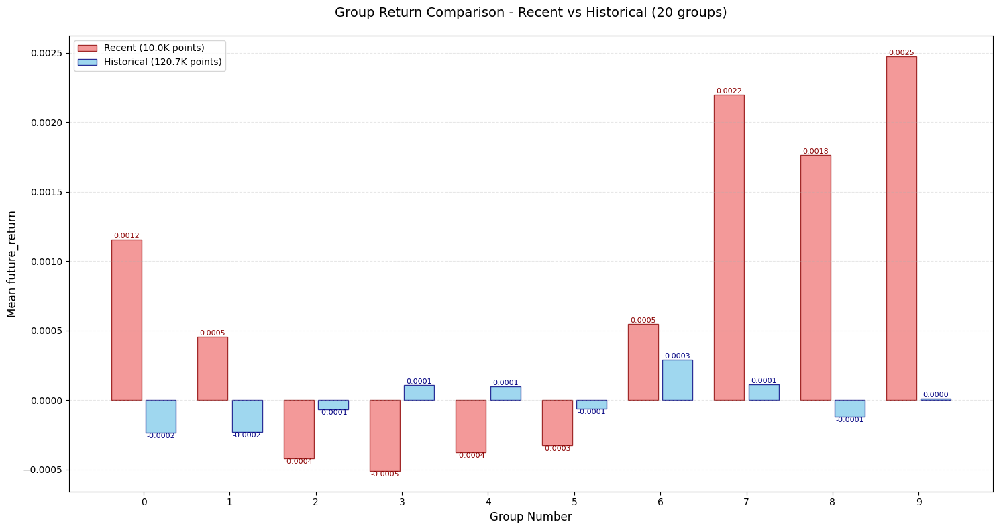

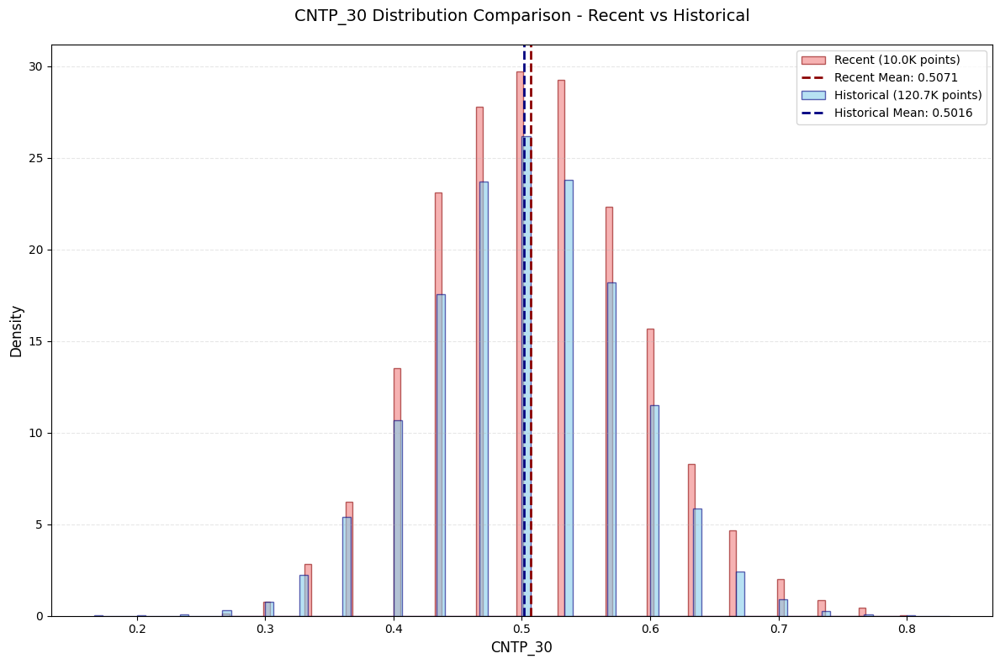

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  57%|█████▋    | 81/143 [01:39<01:18,  1.27s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.009714
   Rank_IC (Spearman): 0.017810
📊 信息比率:
   IR: nan
   有效分组数: 8
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTN_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


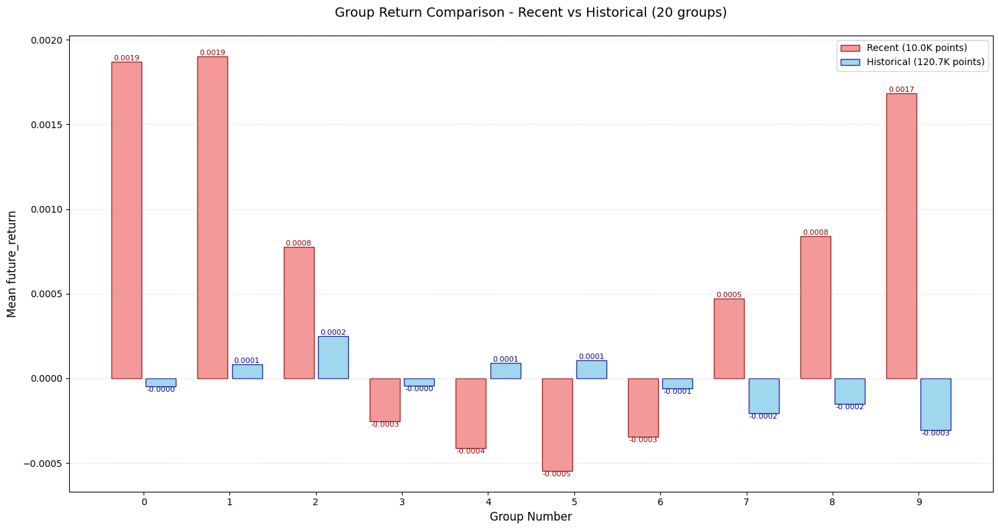

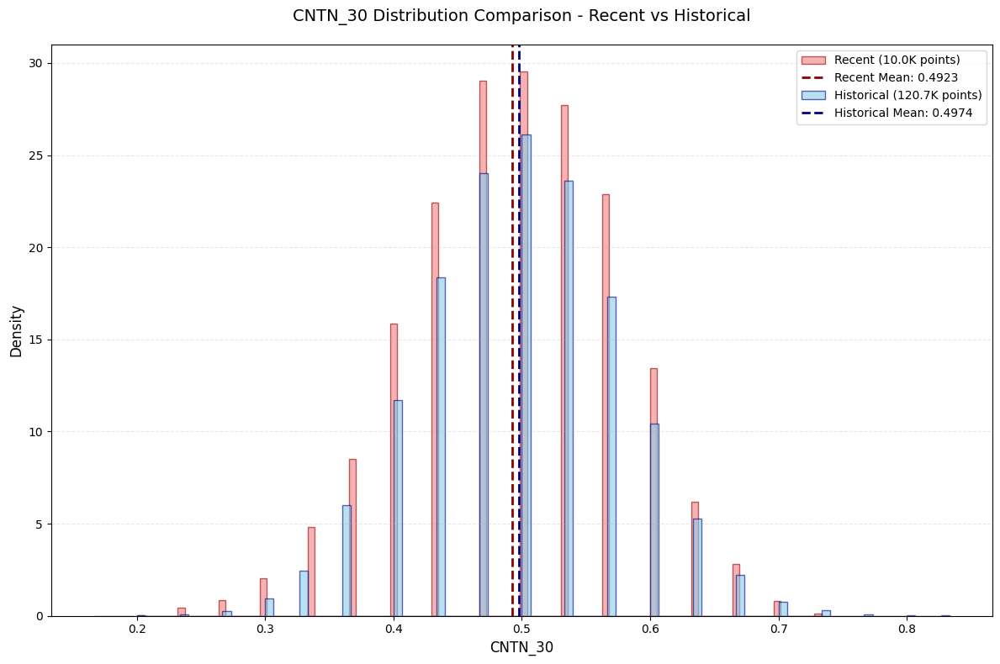

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  57%|█████▋    | 82/143 [01:40<01:15,  1.24s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.012772
   Rank_IC (Spearman): 0.036967
📊 信息比率:
   IR: 0.270175
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MAX_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


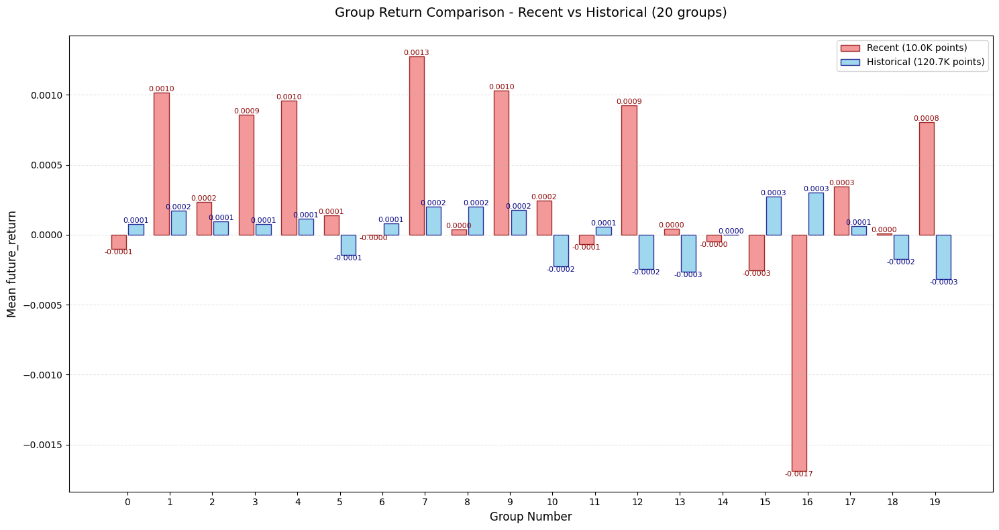

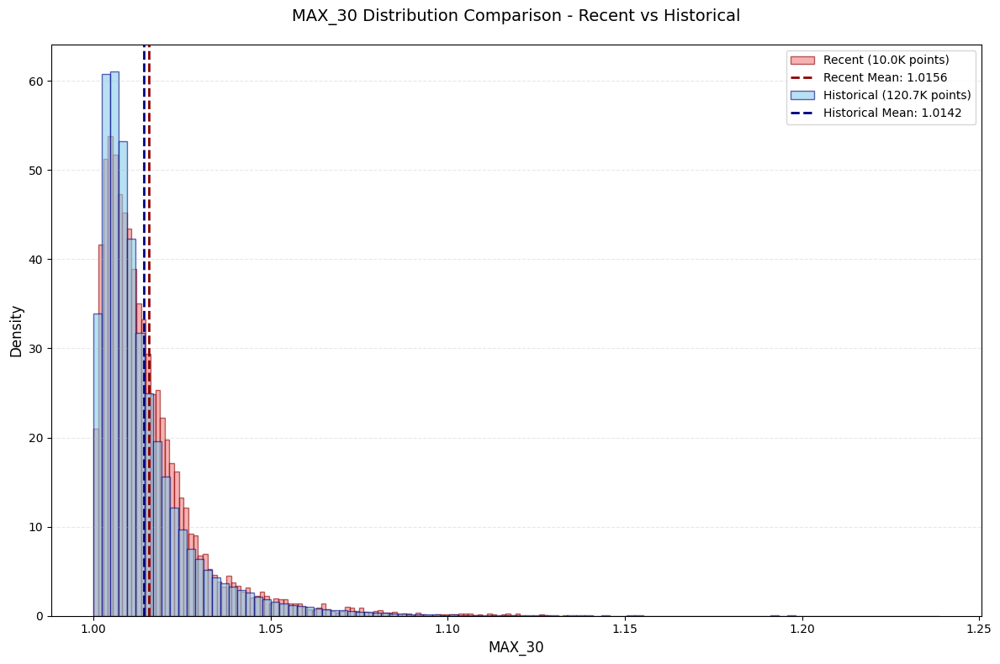

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  58%|█████▊    | 83/143 [01:41<01:14,  1.24s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.012113
   Rank_IC (Spearman): 0.003180
📊 信息比率:
   IR: 0.034611
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MIN_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


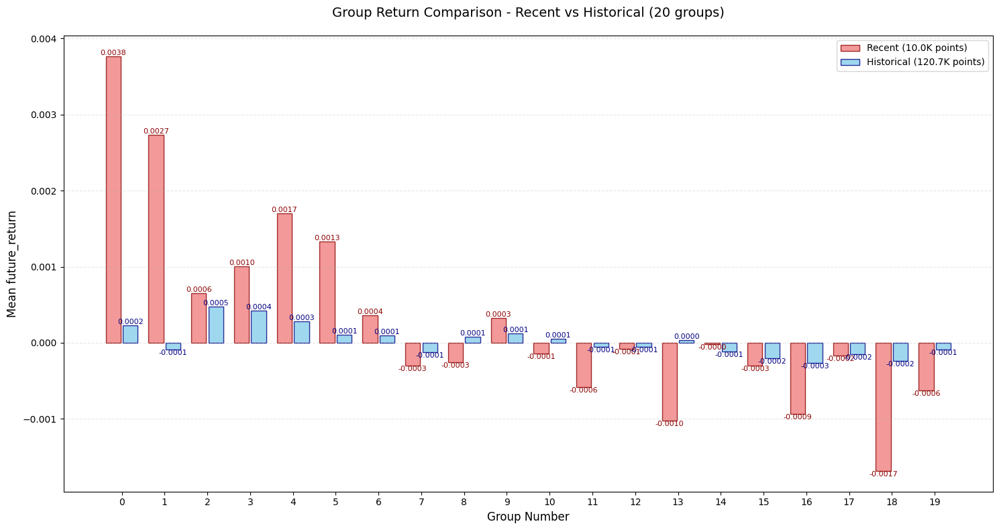

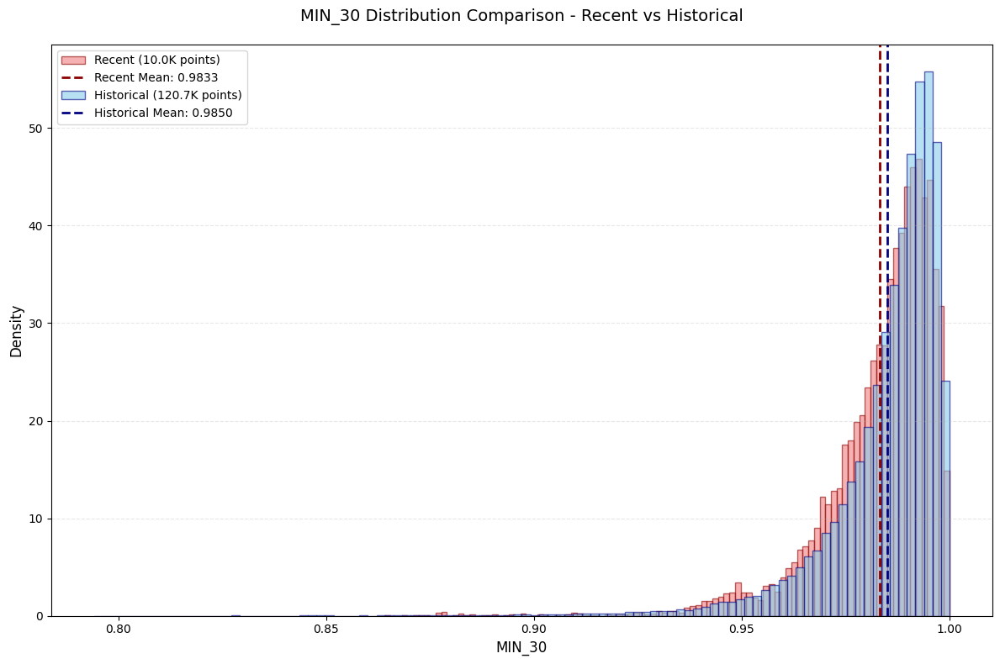

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  59%|█████▊    | 84/143 [01:43<01:16,  1.29s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.001640
   Rank_IC (Spearman): 0.030118
📊 信息比率:
   IR: 0.446110
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: ROC_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


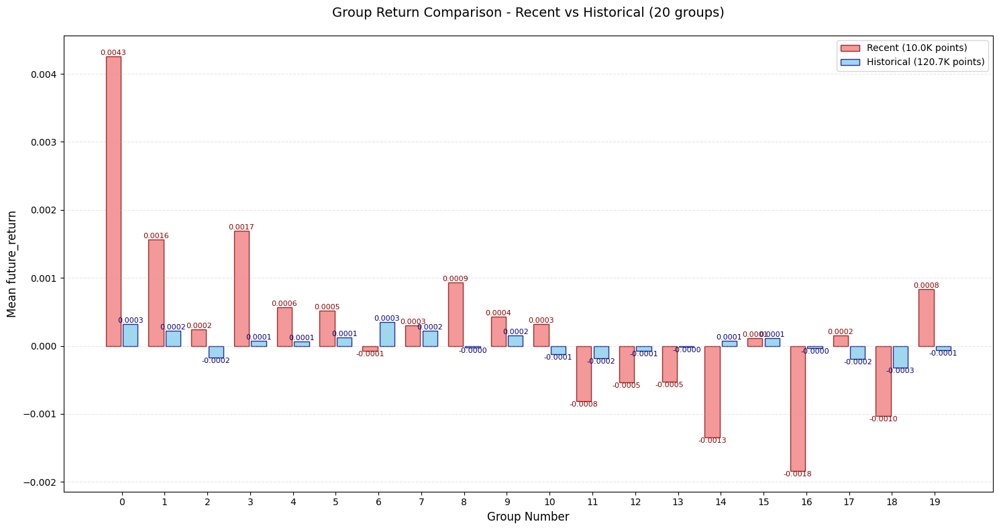

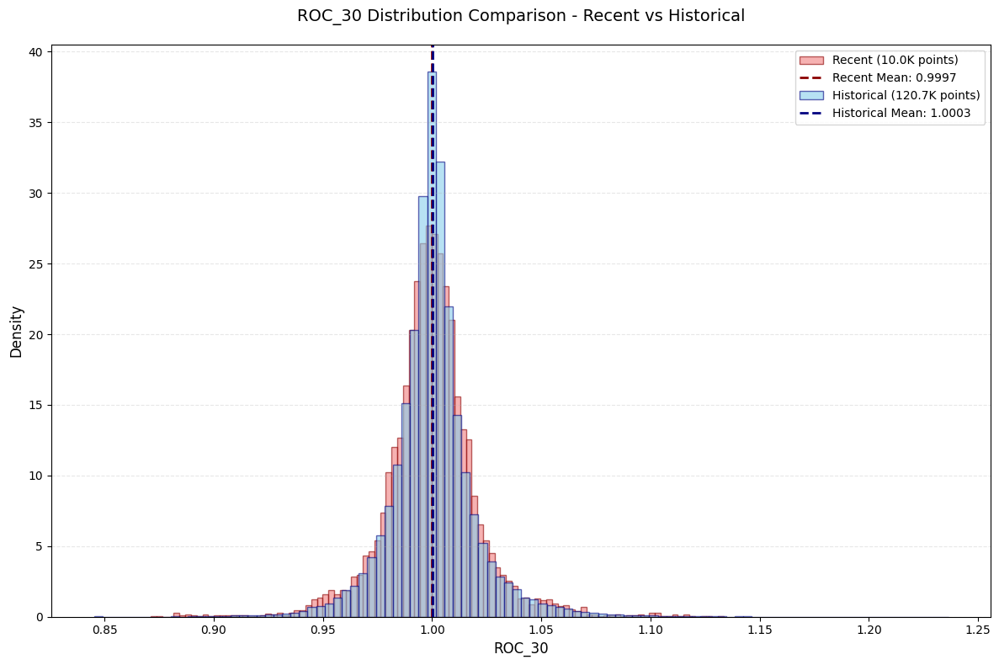

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  59%|█████▉    | 85/143 [01:44<01:16,  1.31s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.014299
   Rank_IC (Spearman): -0.029326
📊 信息比率:
   IR: -0.328072
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RSV_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


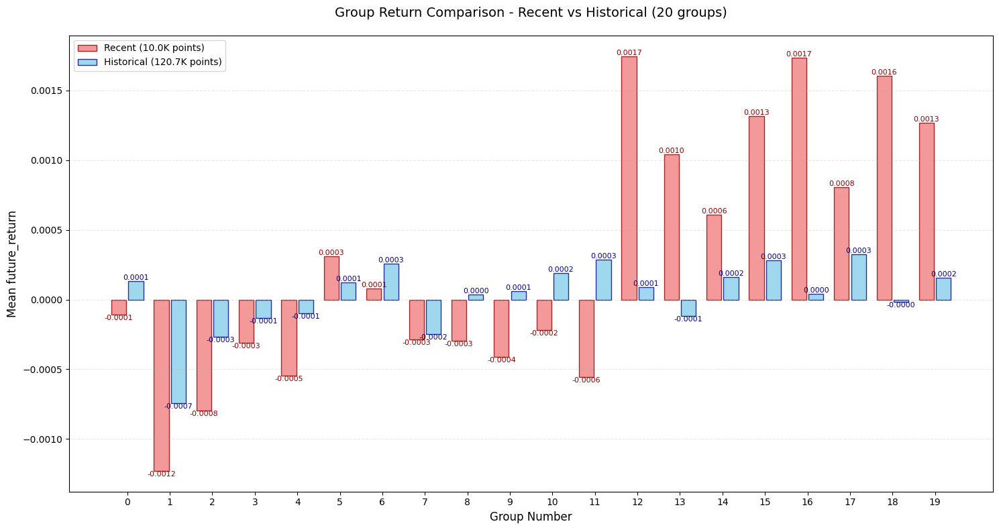

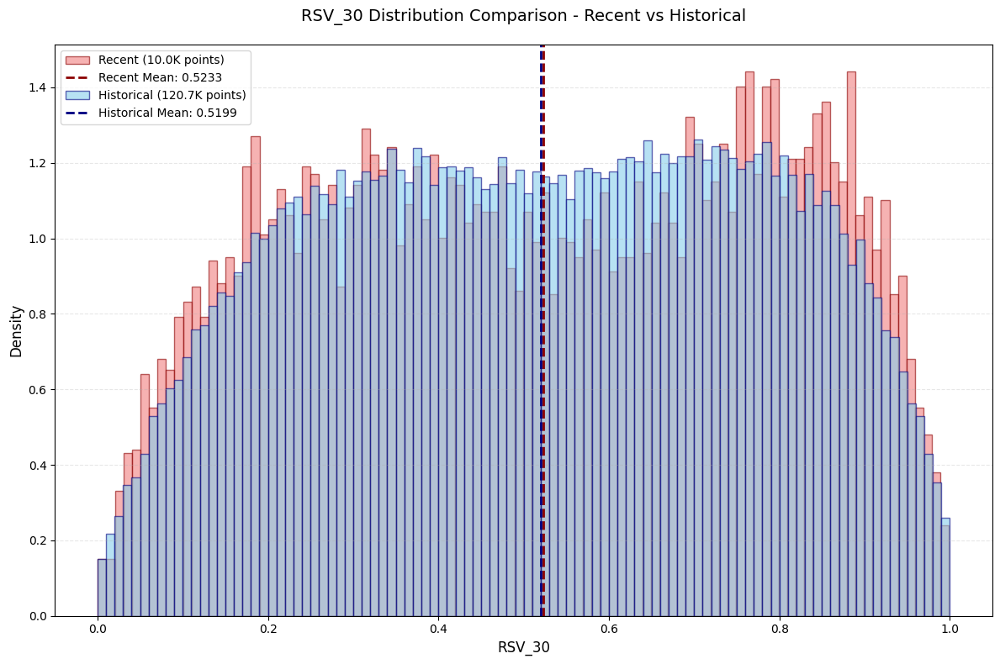

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  60%|██████    | 86/143 [01:45<01:14,  1.32s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.014163
   Rank_IC (Spearman): -0.029748
📊 信息比率:
   IR: 0.153137
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: SUMP_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


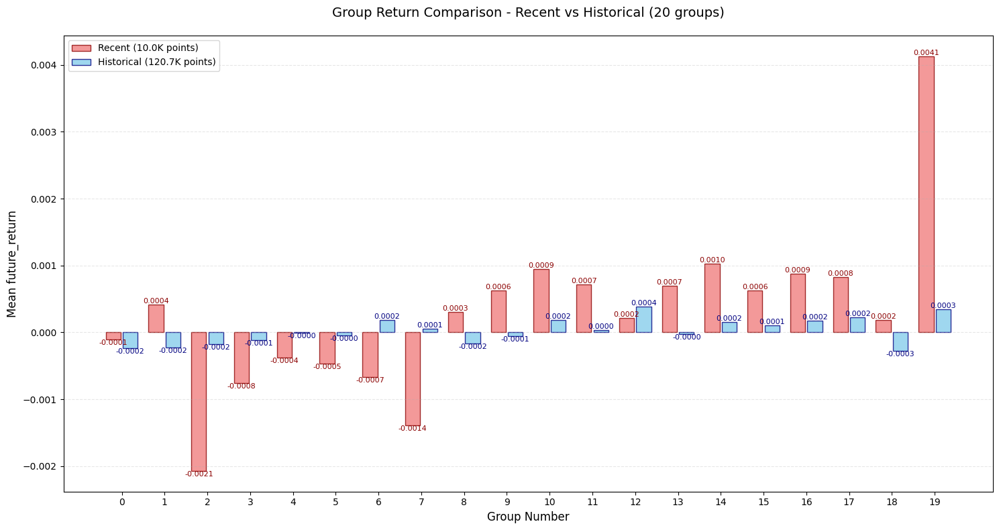

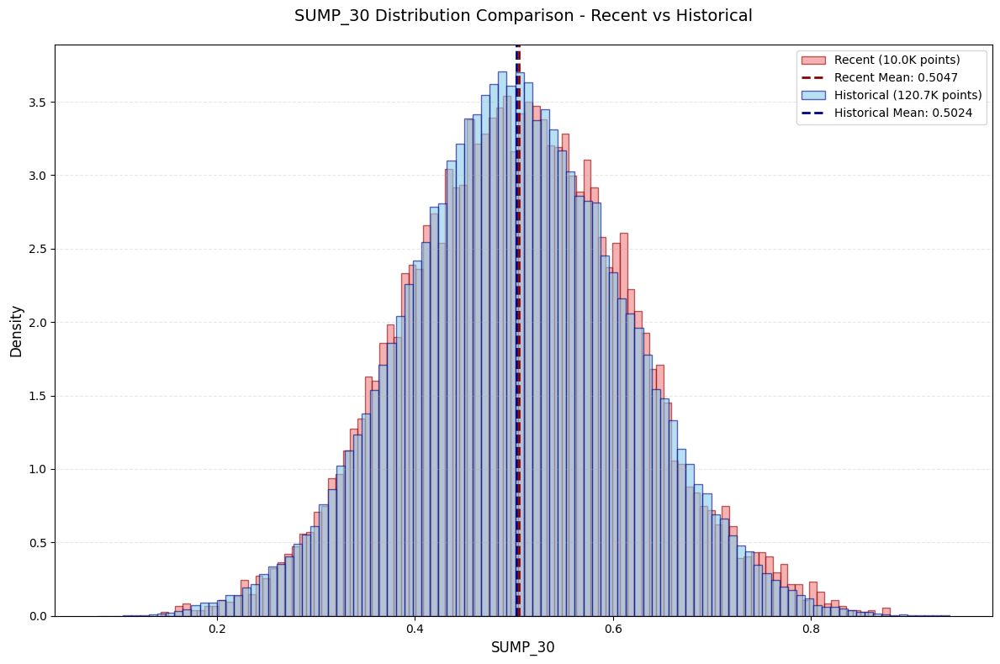

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  61%|██████    | 87/143 [01:47<01:13,  1.31s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.014163
   Rank_IC (Spearman): 0.029748
📊 信息比率:
   IR: -0.153831
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: SUMN_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


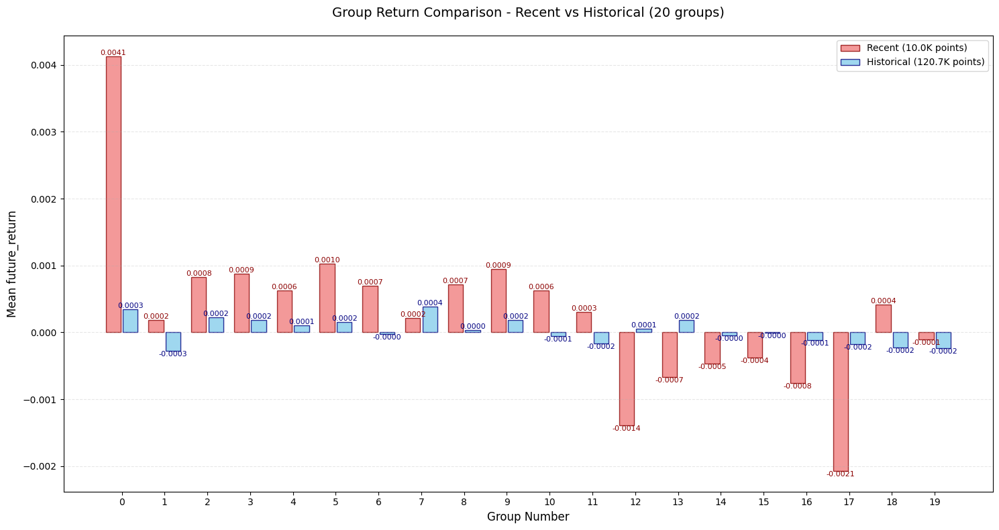

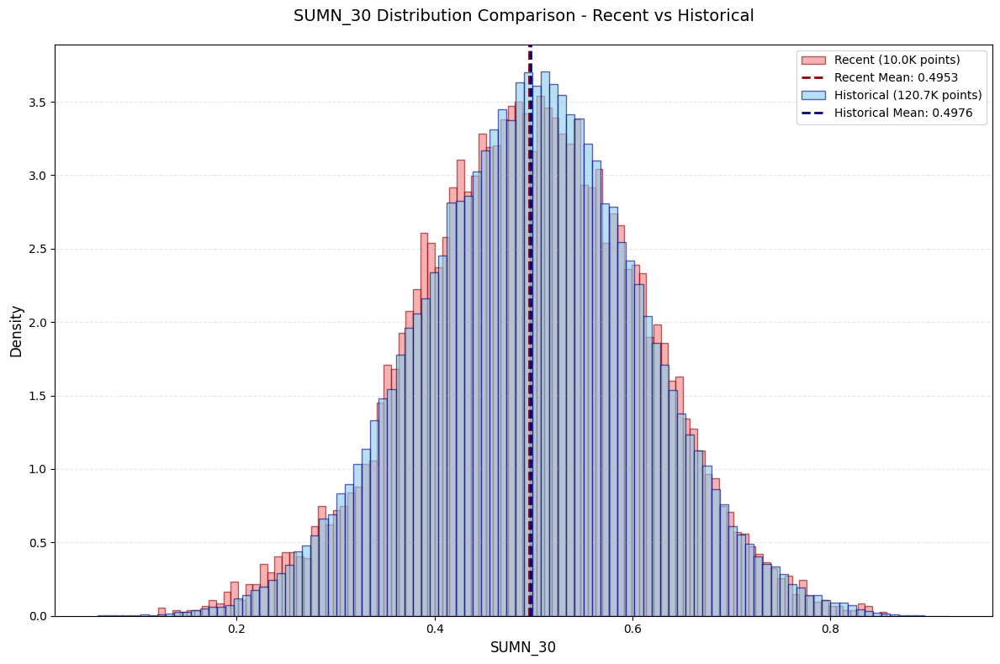

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  62%|██████▏   | 88/143 [01:48<01:14,  1.35s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.014163
   Rank_IC (Spearman): -0.029748
📊 信息比率:
   IR: 0.153137
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: SUMD_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


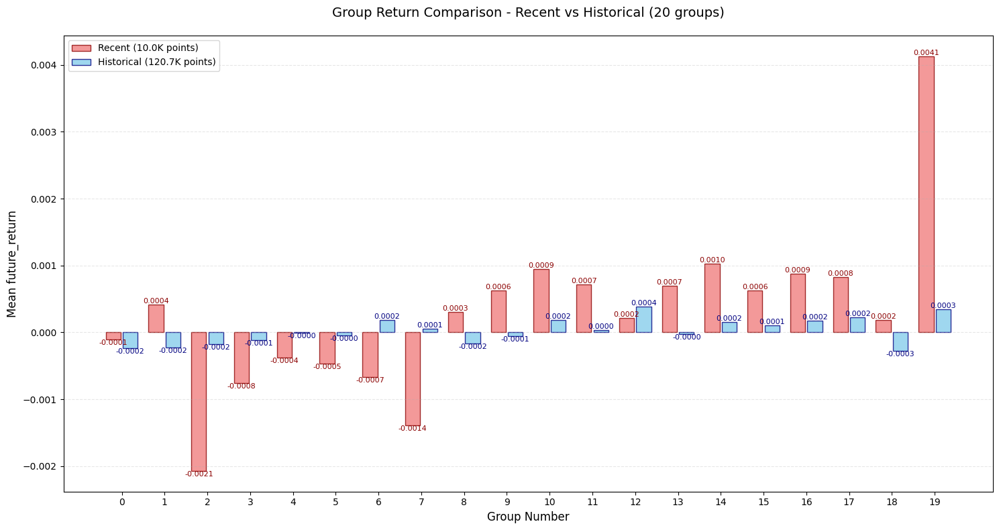

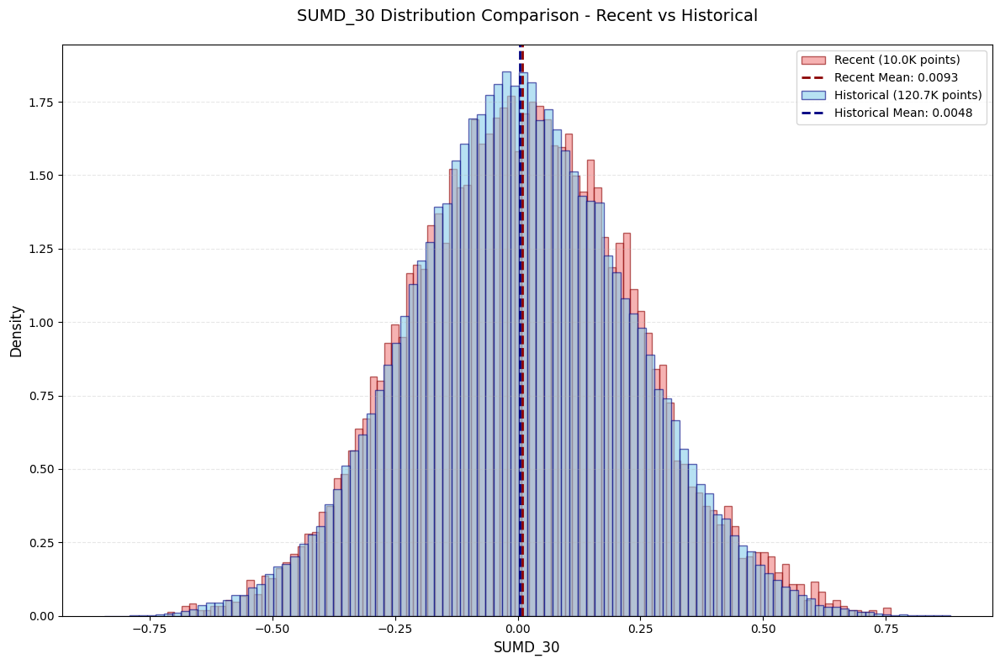

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  62%|██████▏   | 89/143 [01:49<01:12,  1.34s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.006988
   Rank_IC (Spearman): 0.037285
📊 信息比率:
   IR: 0.265402
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MA_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


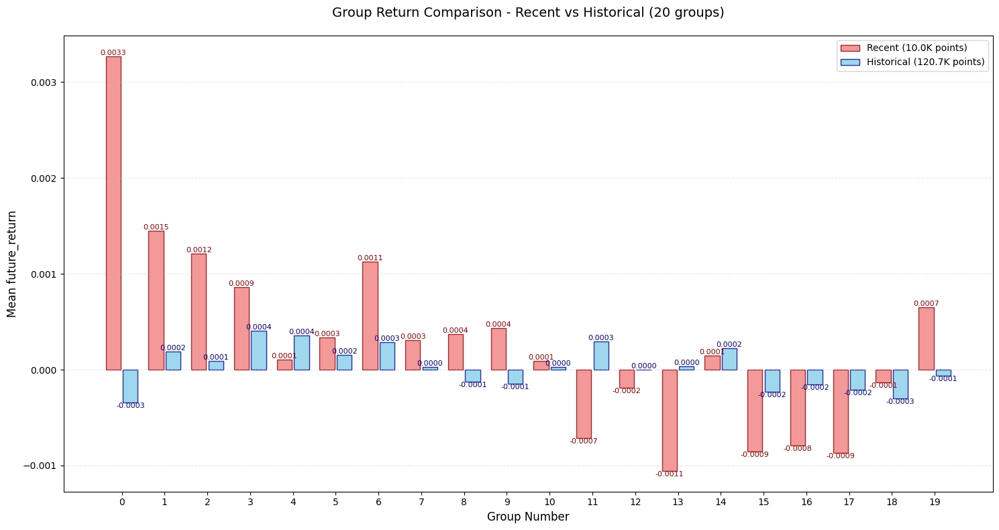

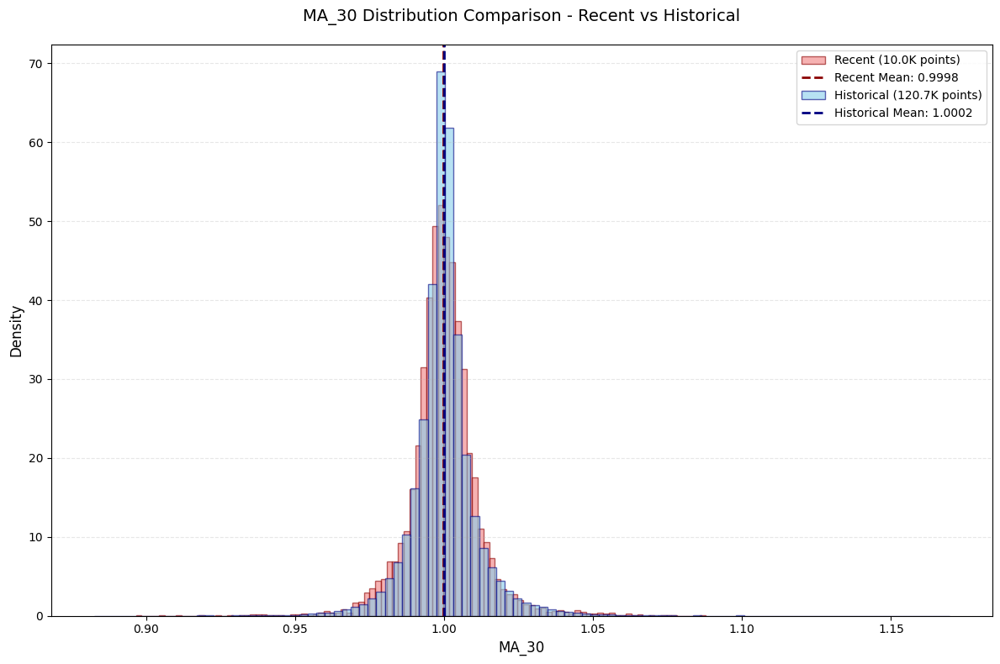

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  63%|██████▎   | 90/143 [01:51<01:10,  1.33s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.009811
   Rank_IC (Spearman): -0.039277
📊 信息比率:
   IR: 0.362087
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RANK_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


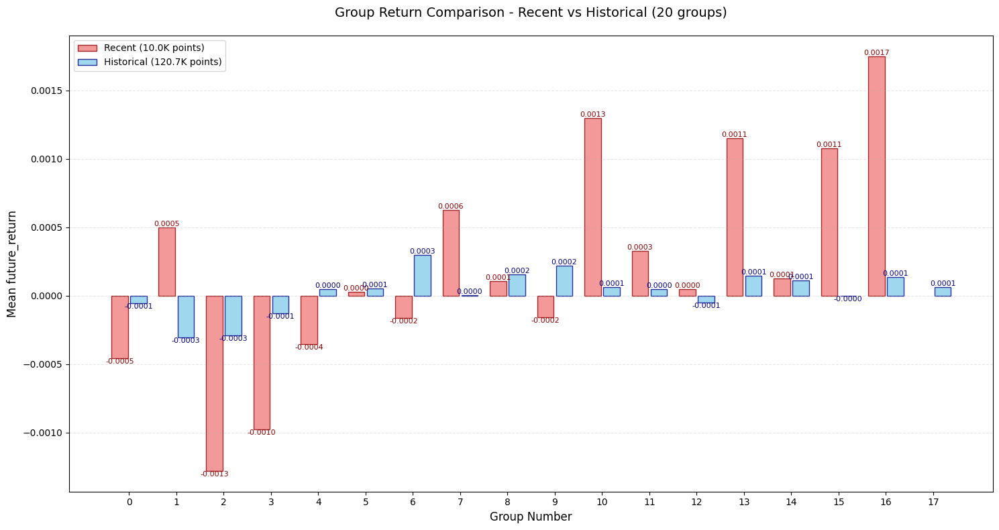

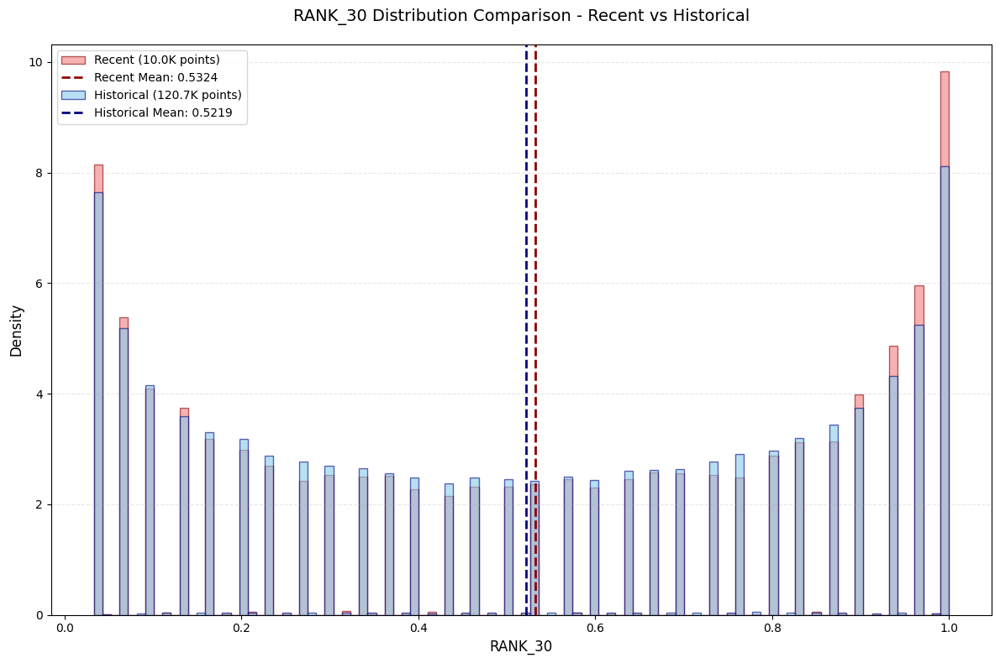

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  64%|██████▎   | 91/143 [01:52<01:10,  1.35s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.006162
   Rank_IC (Spearman): -0.016756
📊 信息比率:
   IR: -0.410981
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RESI_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


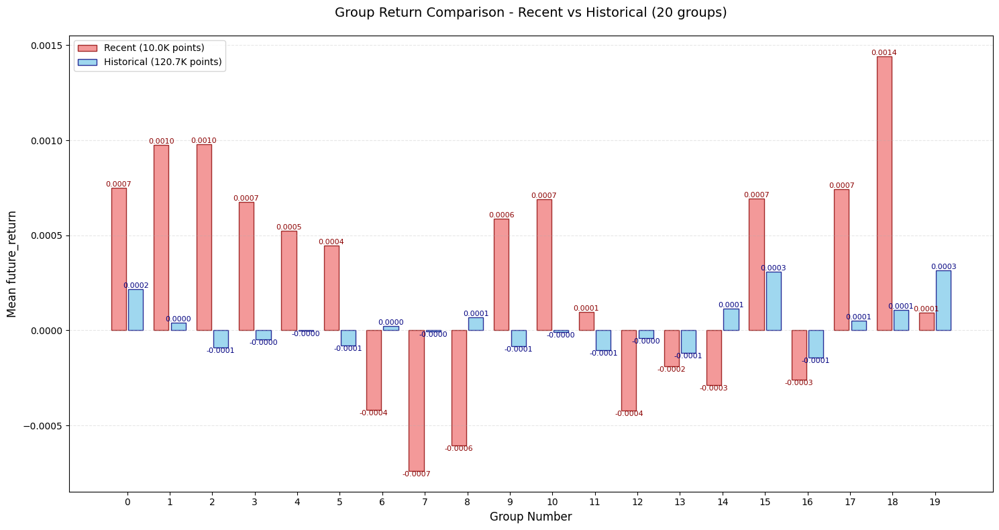

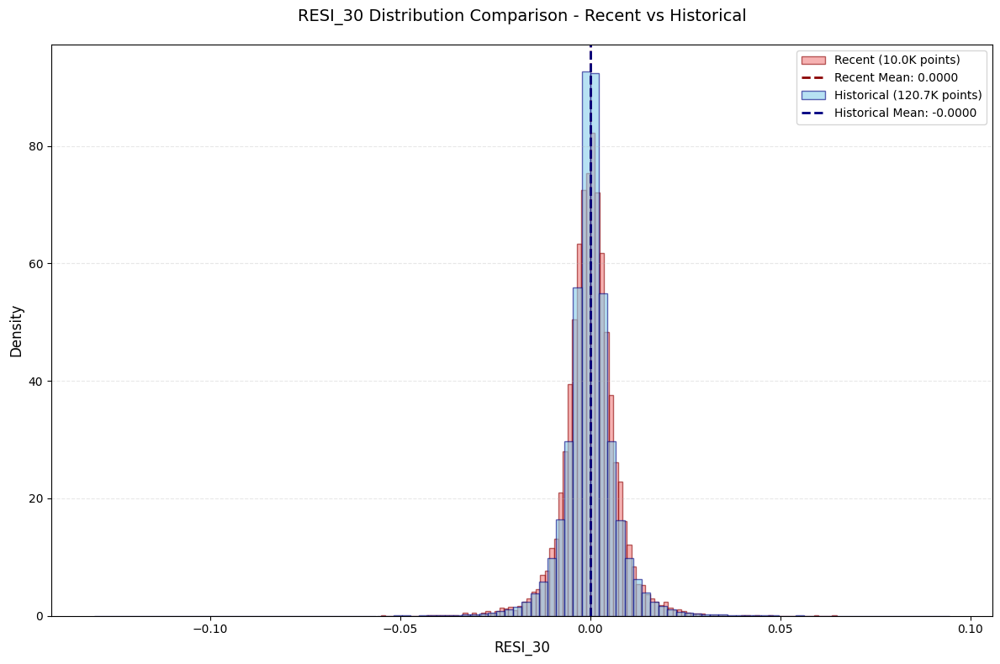

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  64%|██████▍   | 92/143 [01:53<01:07,  1.33s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.003375
   Rank_IC (Spearman): 0.000727
📊 信息比率:
   IR: 1.023023
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: RSQR_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


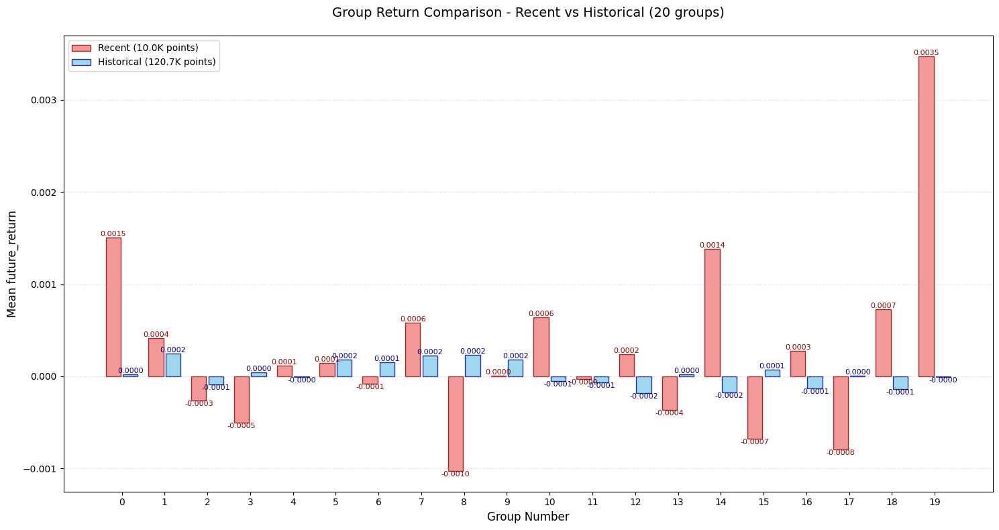

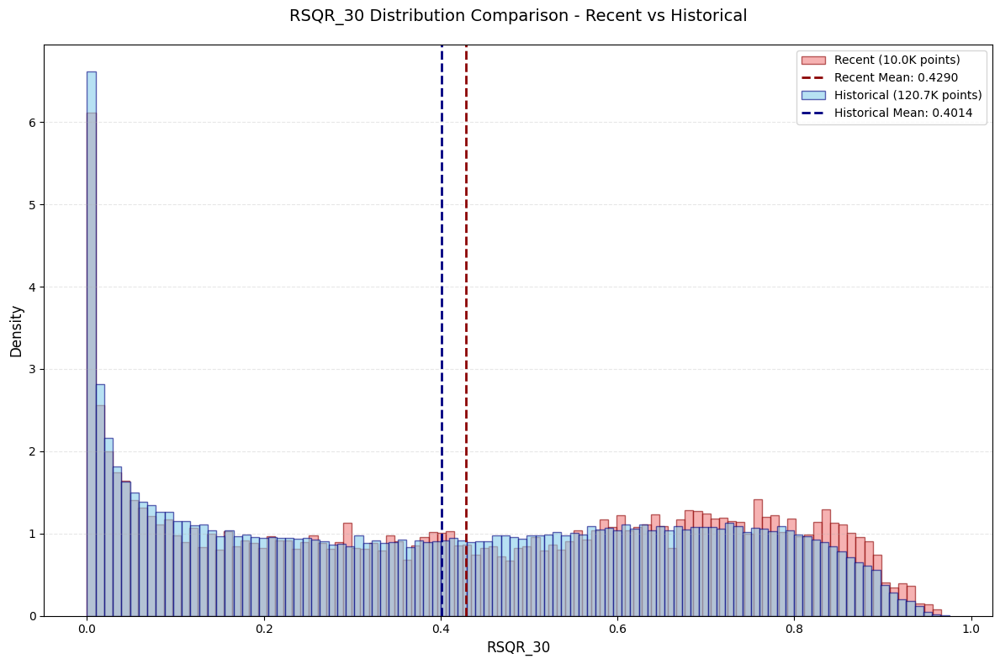

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  65%|██████▌   | 93/143 [01:55<01:05,  1.31s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.000318
   Rank_IC (Spearman): -0.028924
📊 信息比率:
   IR: nan
   有效分组数: 9
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: IMAX_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


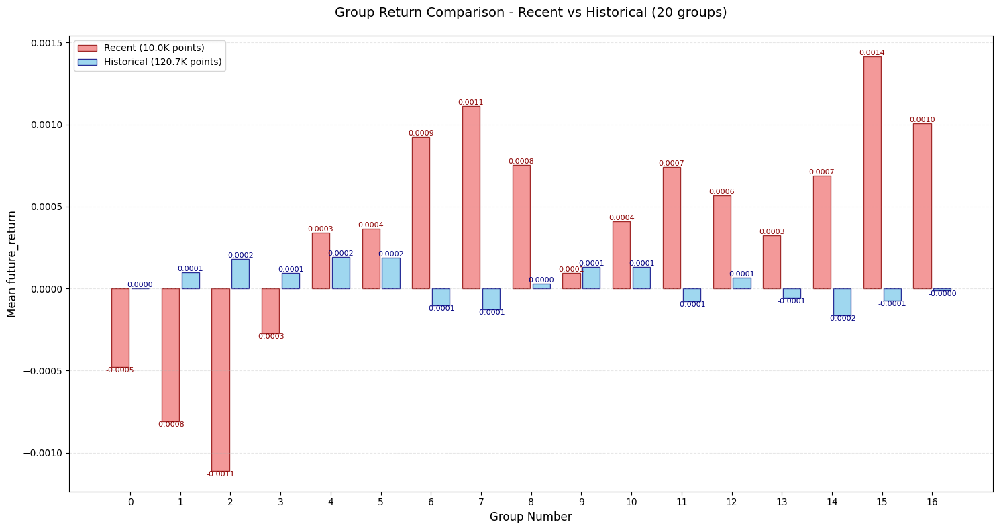

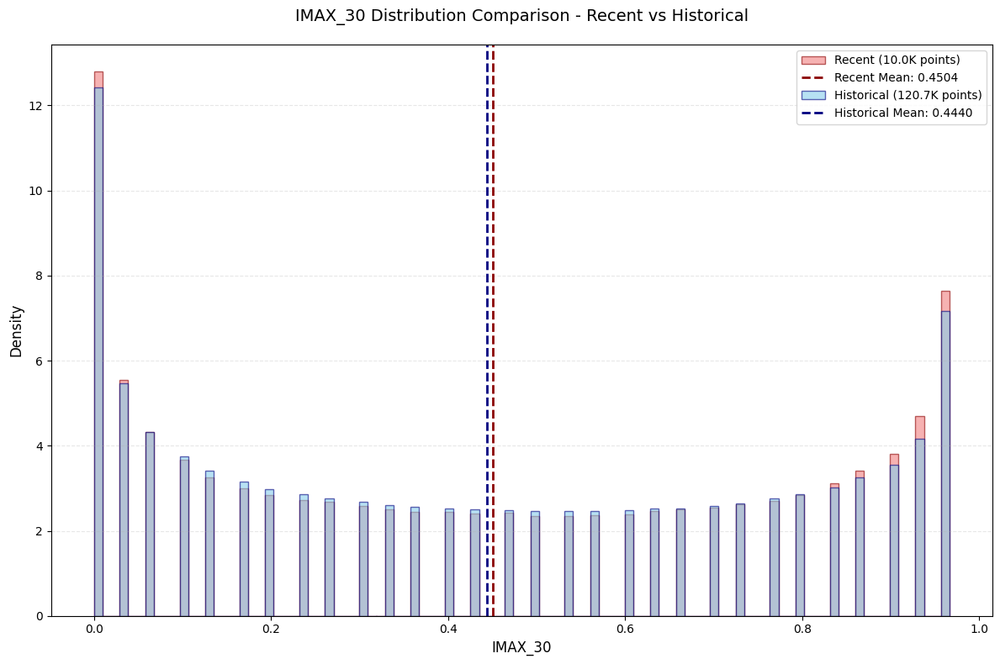

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  66%|██████▌   | 94/143 [01:56<01:05,  1.33s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.002168
   Rank_IC (Spearman): 0.033090
📊 信息比率:
   IR: nan
   有效分组数: 9
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: IMIN_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


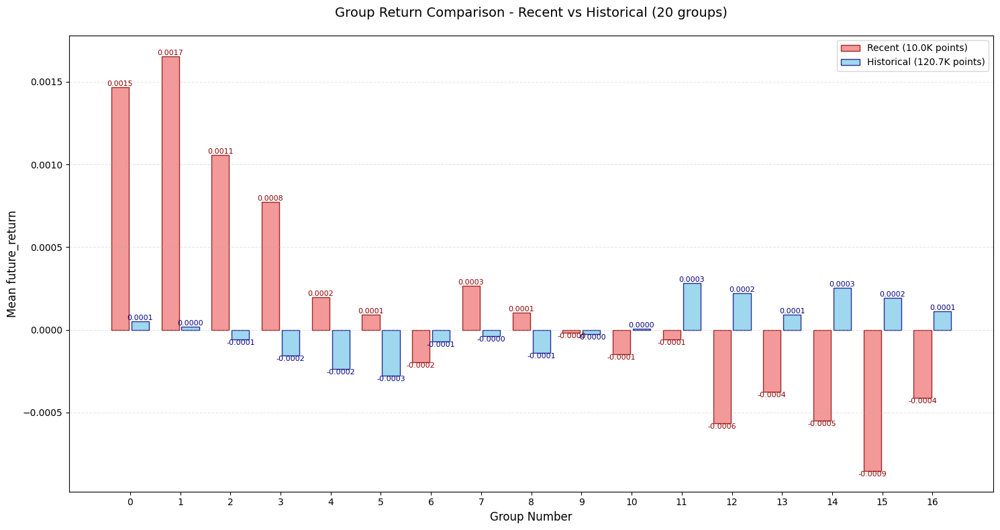

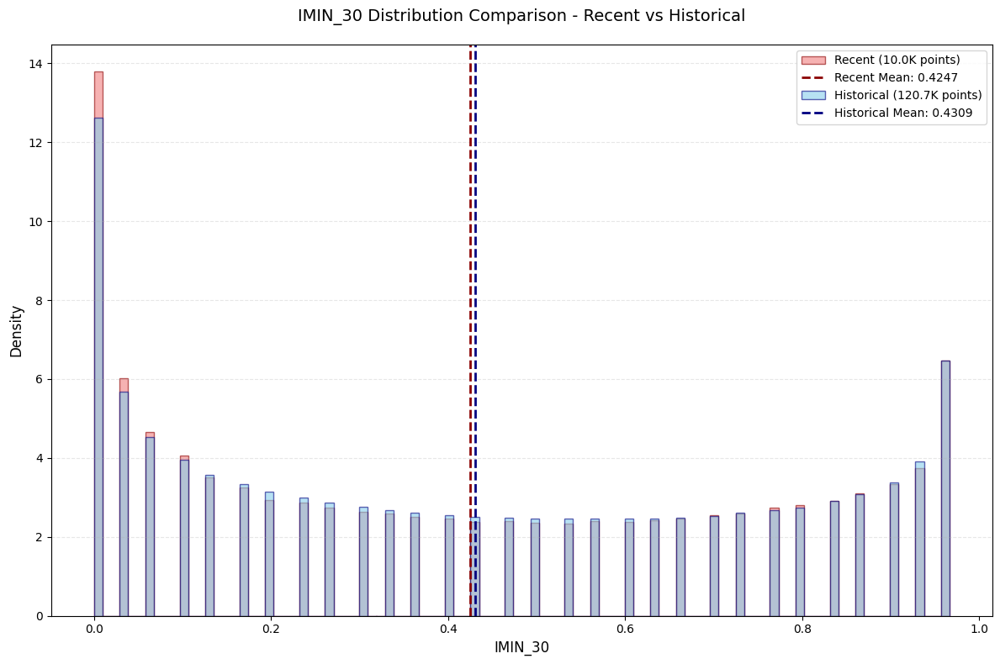

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  66%|██████▋   | 95/143 [01:57<01:02,  1.31s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.001095
   Rank_IC (Spearman): -0.038387
📊 信息比率:
   IR: 0.219813
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: IMXD_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


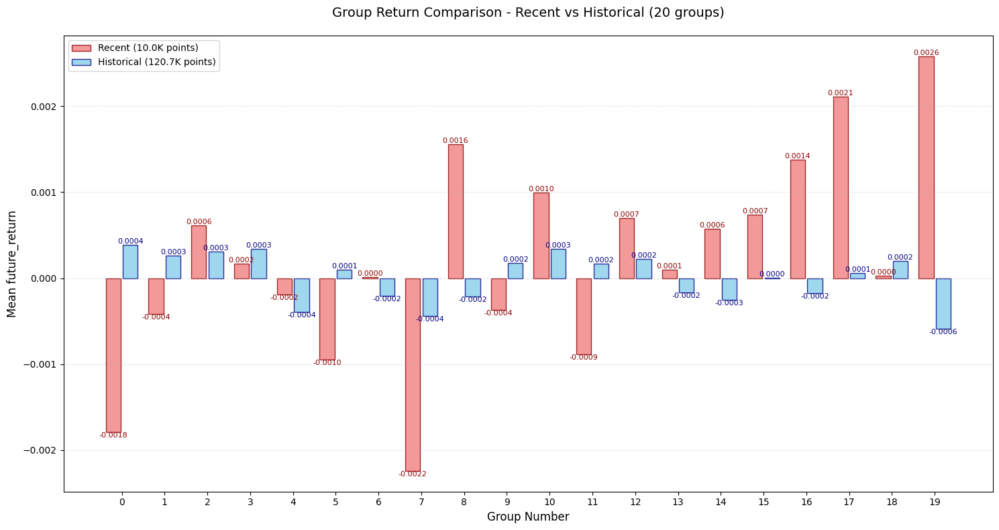

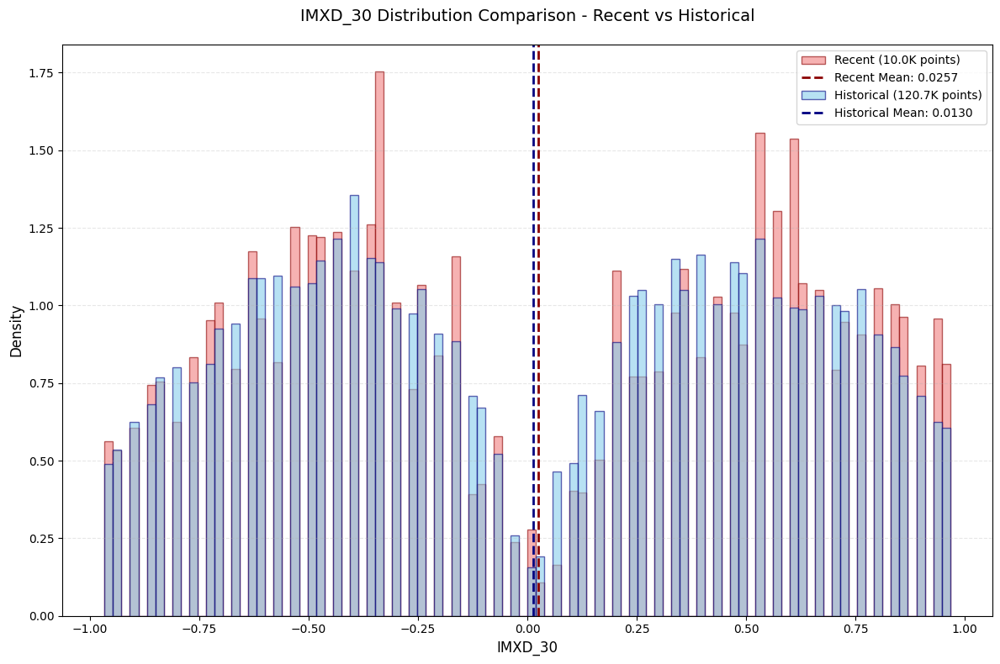

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  67%|██████▋   | 96/143 [01:59<01:02,  1.33s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.000052
   Rank_IC (Spearman): 0.032453
📊 信息比率:
   IR: 0.314686
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: QTLD_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


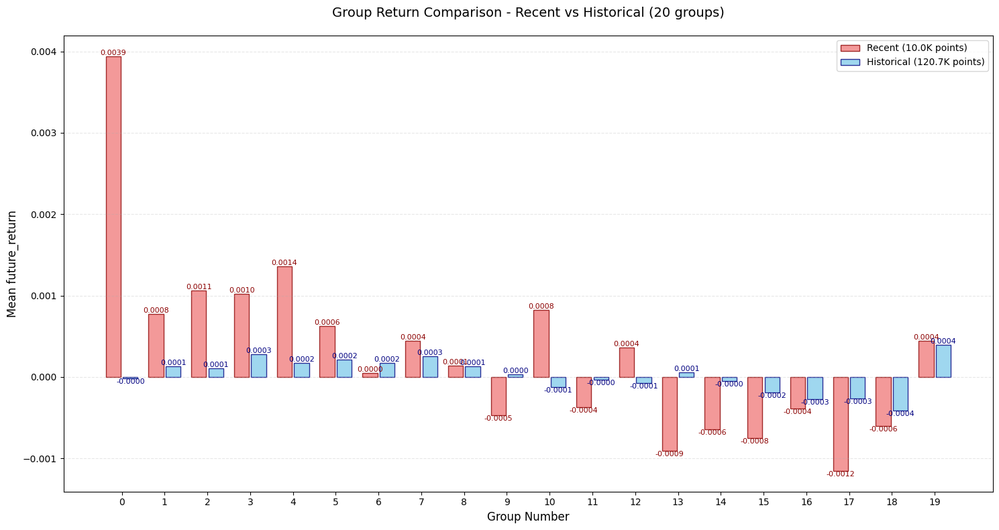

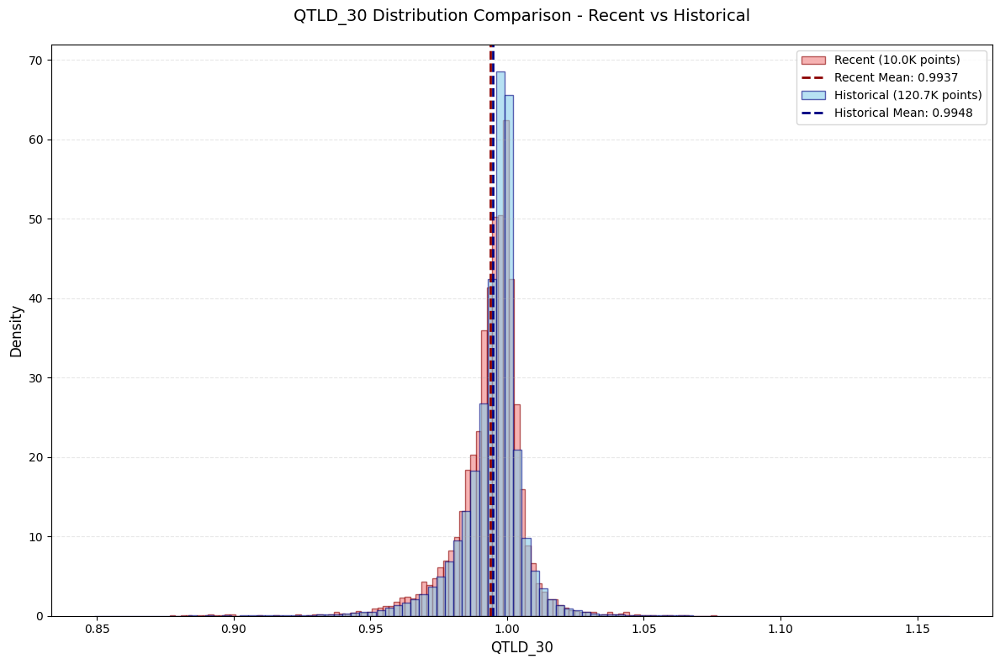

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  68%|██████▊   | 97/143 [02:00<01:02,  1.36s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.011247
   Rank_IC (Spearman): 0.044809
📊 信息比率:
   IR: 0.051106
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: QTLU_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


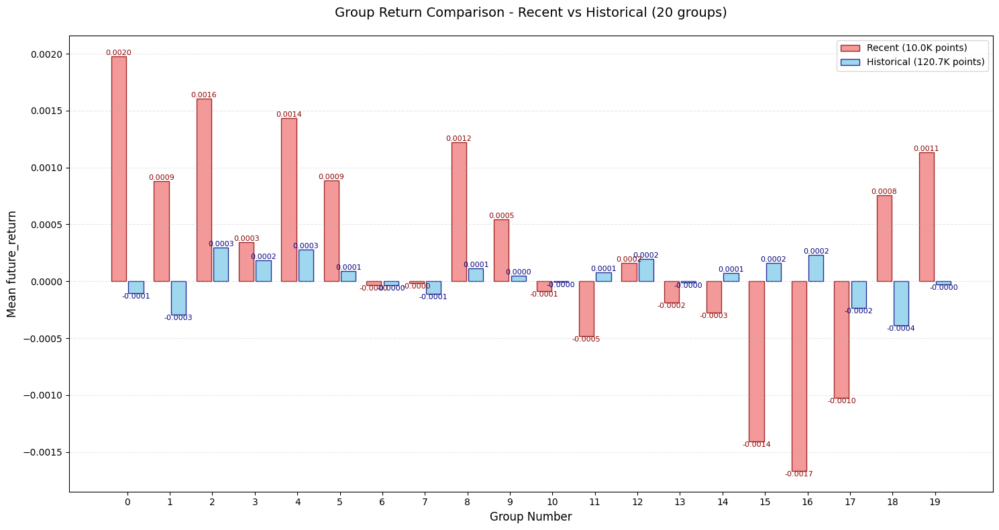

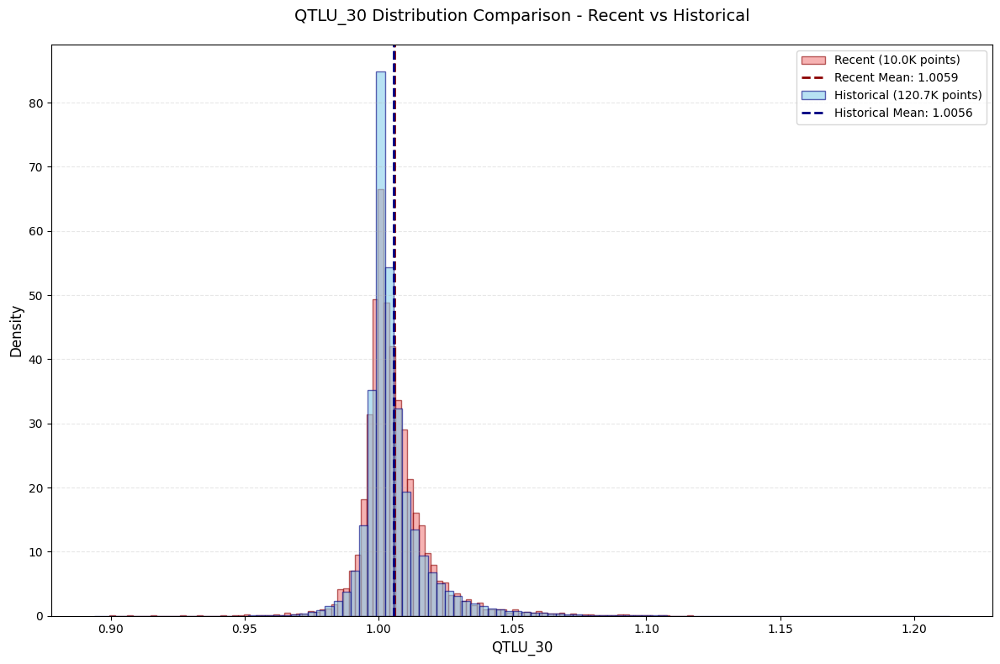

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  69%|██████▊   | 98/143 [02:01<01:00,  1.34s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.007825
   Rank_IC (Spearman): -0.024298
📊 信息比率:
   IR: 0.119162
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: BETA_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


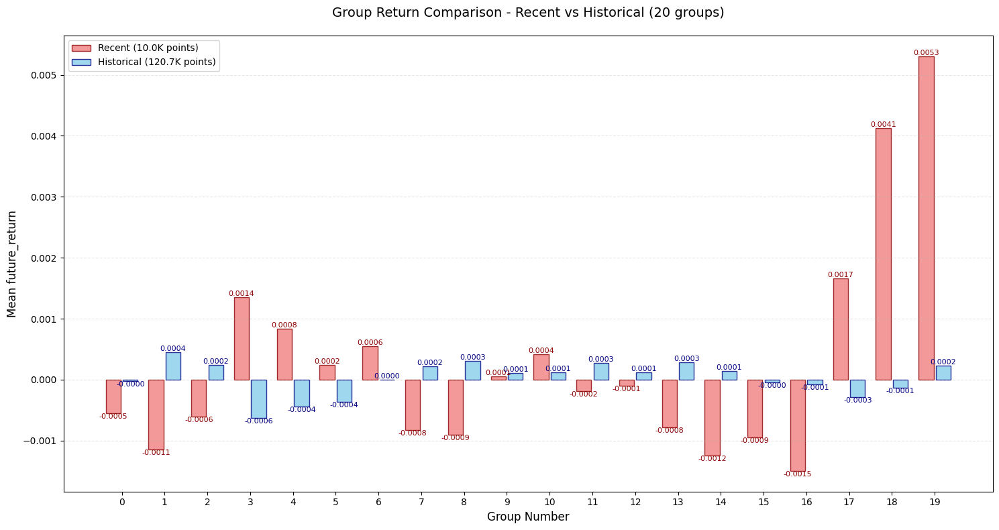

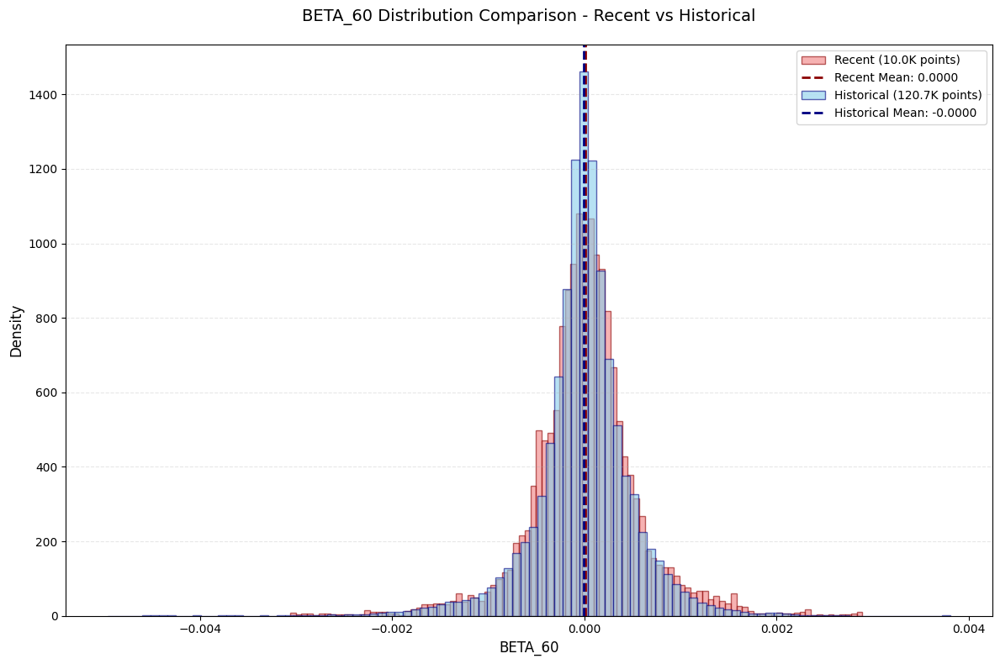

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  69%|██████▉   | 99/143 [02:03<00:58,  1.33s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.009194
   Rank_IC (Spearman): -0.015530
📊 信息比率:
   IR: nan
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTD_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


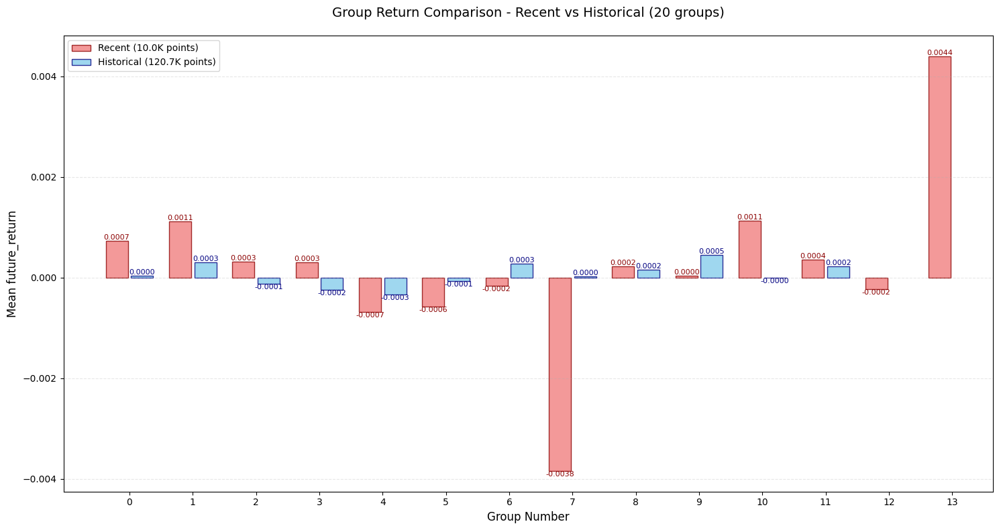

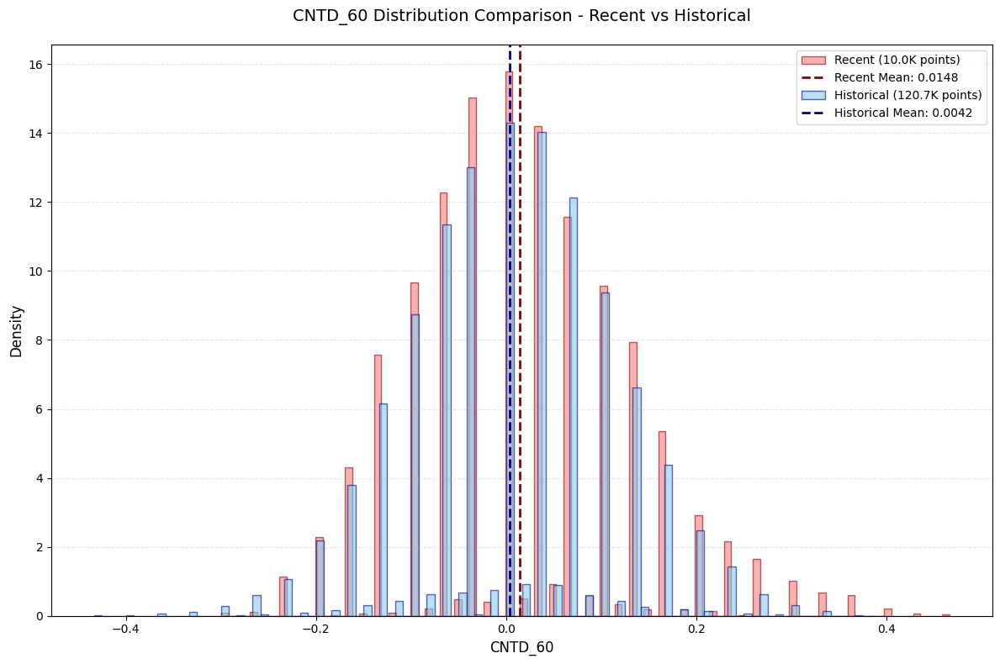

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  70%|██████▉   | 100/143 [02:04<00:57,  1.34s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.009761
   Rank_IC (Spearman): -0.015024
📊 信息比率:
   IR: nan
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTP_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


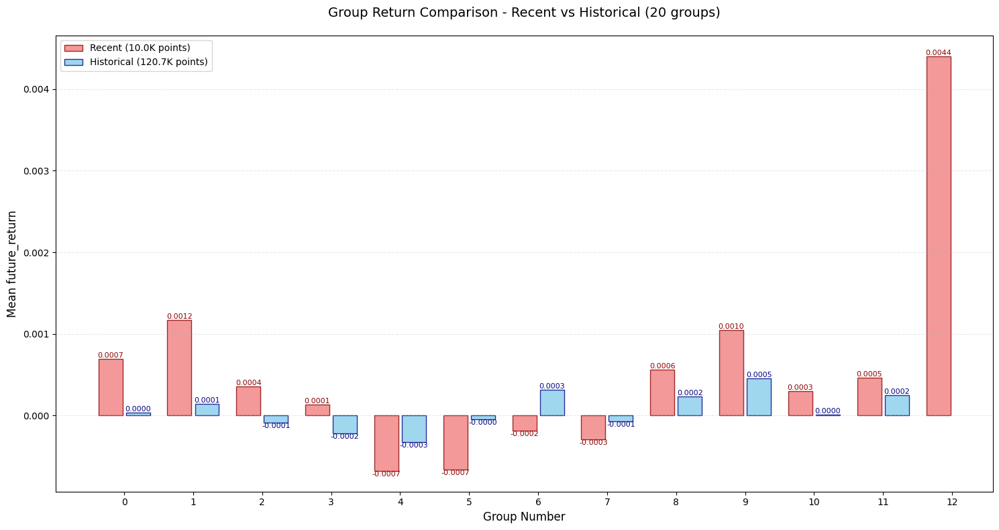

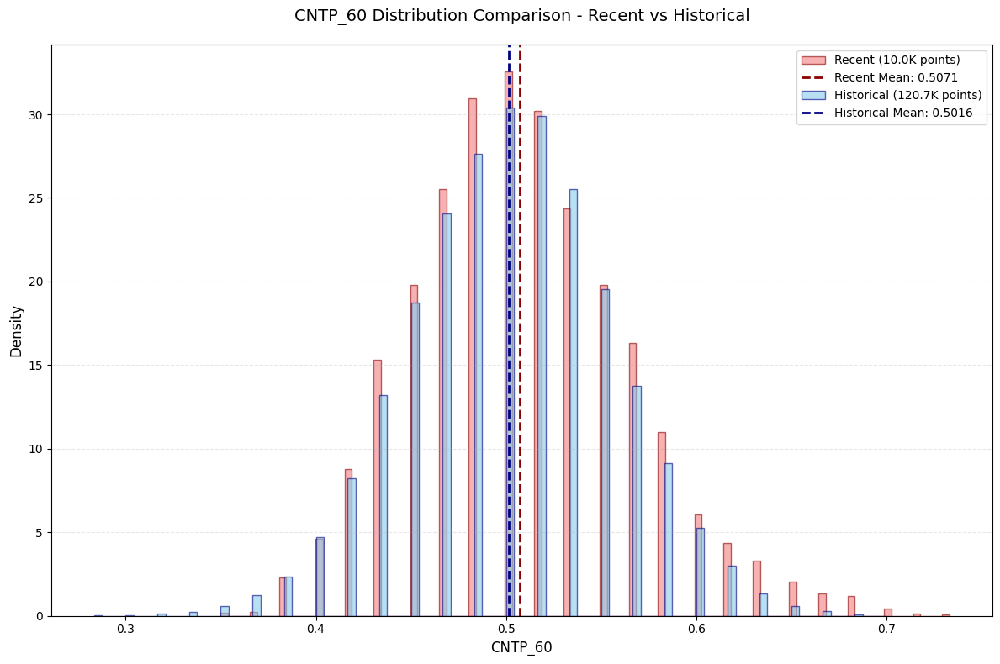

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  71%|███████   | 101/143 [02:05<00:54,  1.29s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.008615
   Rank_IC (Spearman): 0.016125
📊 信息比率:
   IR: nan
   有效分组数: 9
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: CNTN_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


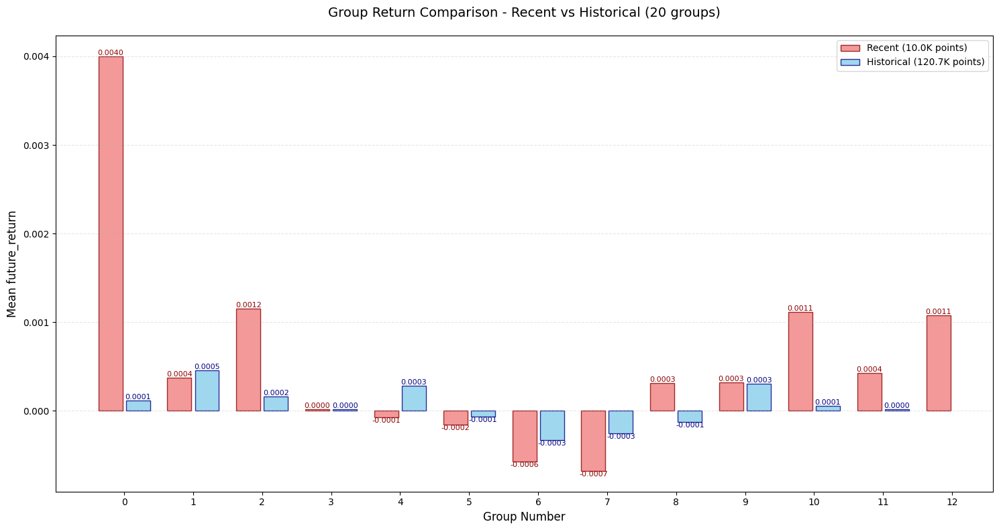

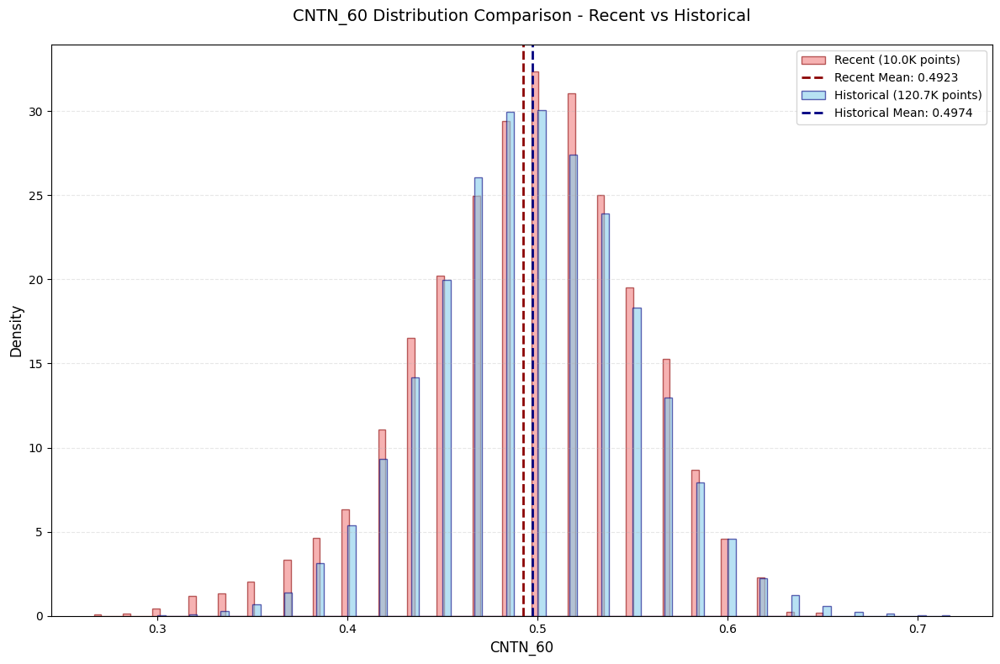

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  71%|███████▏  | 102/143 [02:06<00:52,  1.27s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.011156
   Rank_IC (Spearman): 0.039485
📊 信息比率:
   IR: 0.252517
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MAX_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


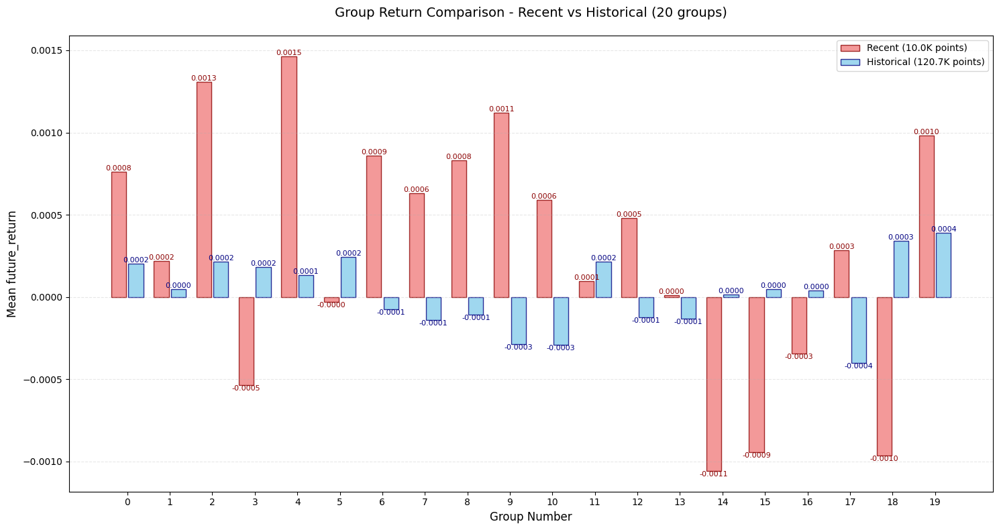

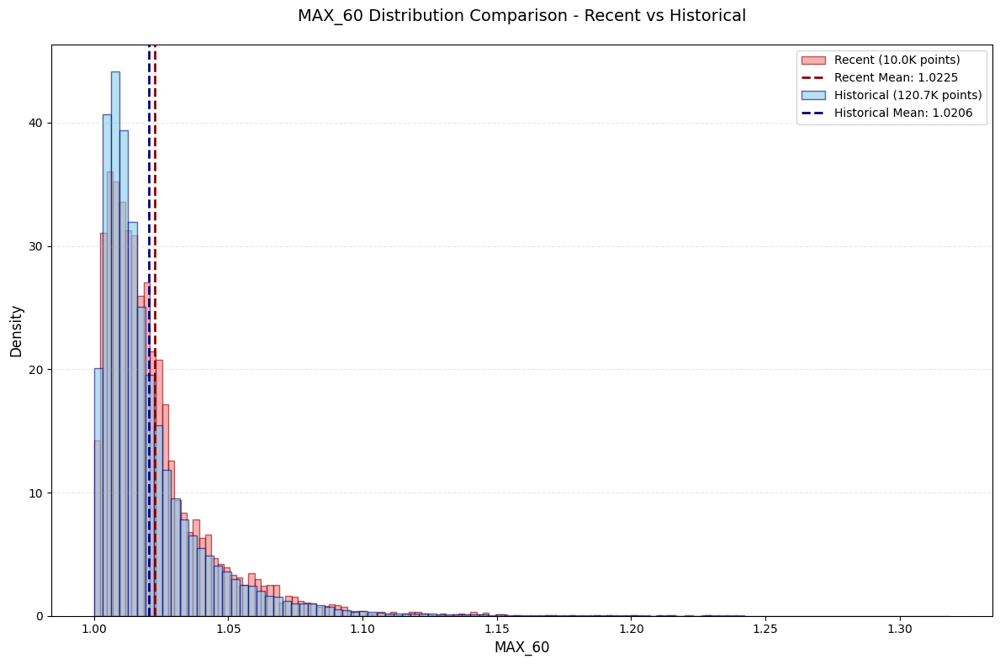

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  72%|███████▏  | 103/143 [02:08<00:51,  1.29s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.019729
   Rank_IC (Spearman): 0.008877
📊 信息比率:
   IR: -0.378251
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130686
   因子列: MIN_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


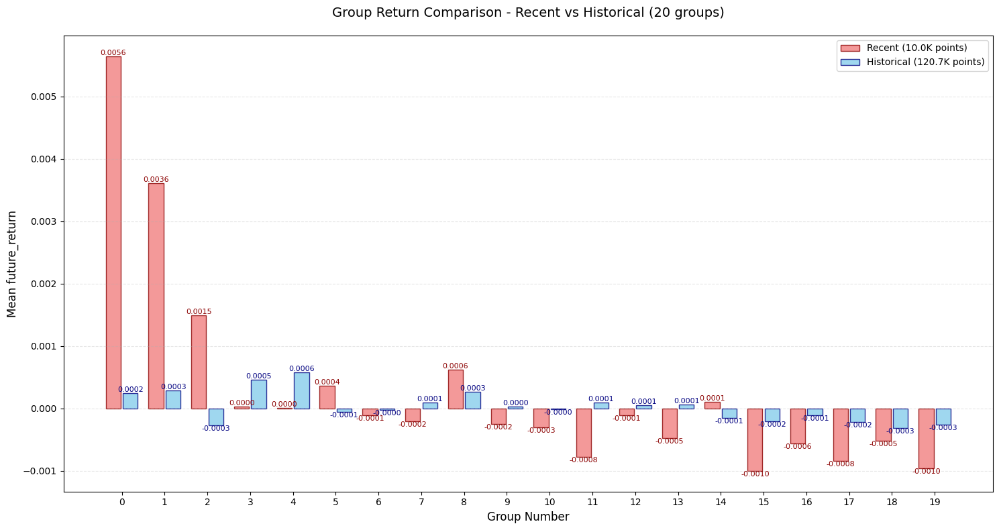

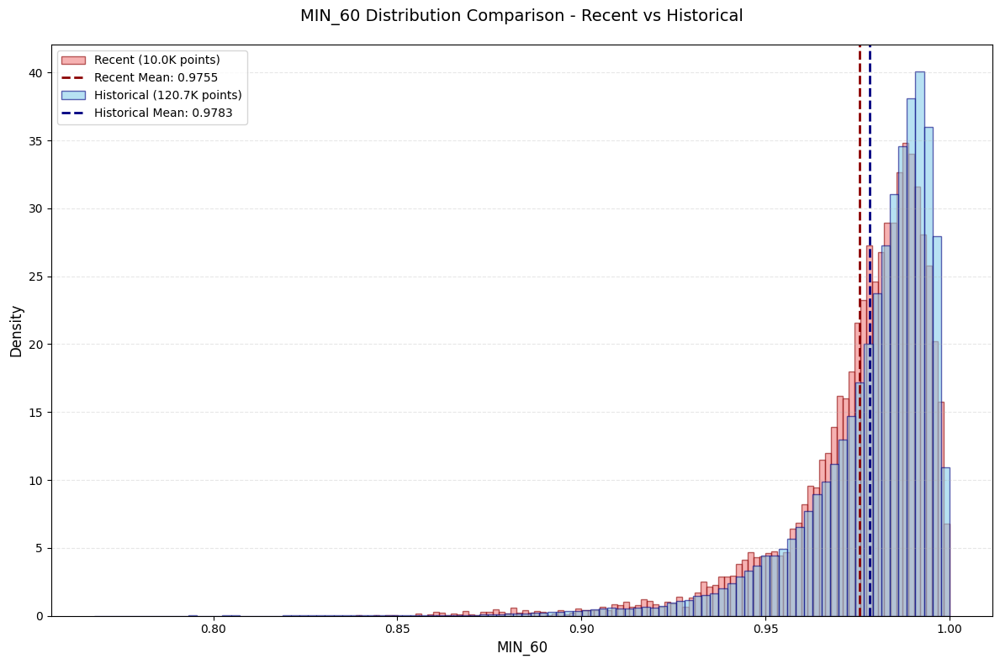

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  73%|███████▎  | 104/143 [02:09<00:52,  1.35s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.003358
   Rank_IC (Spearman): 0.024829
📊 信息比率:
   IR: 0.314709
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: ROC_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


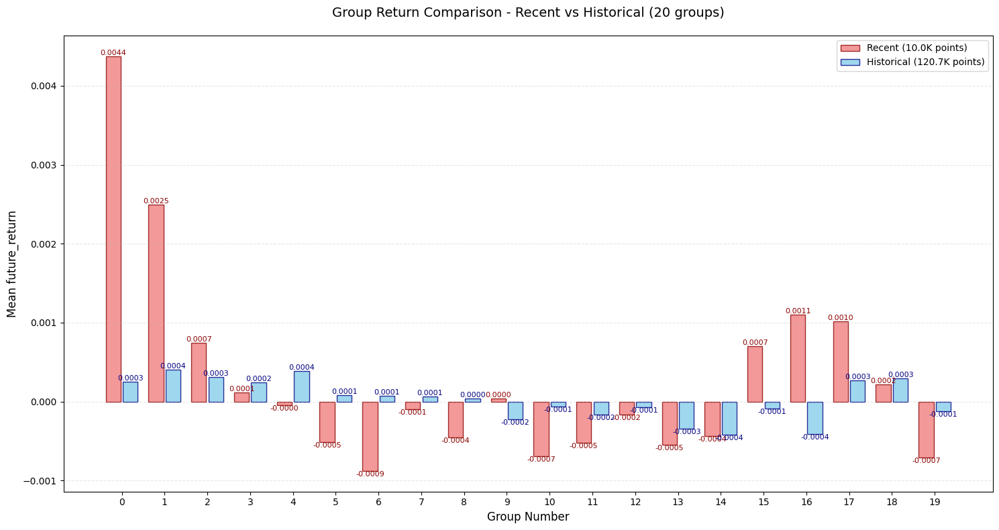

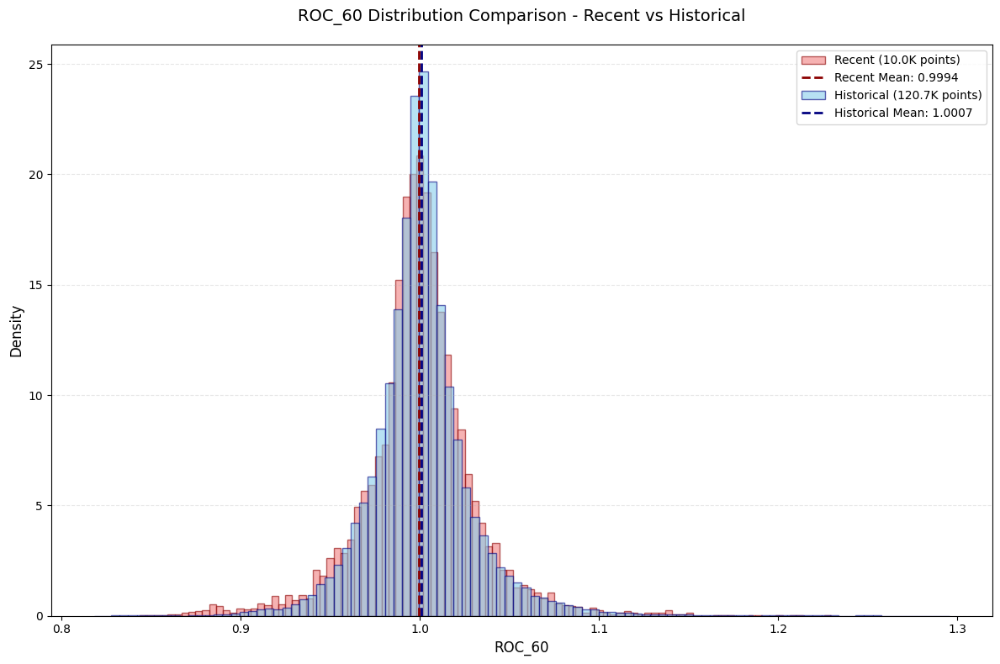

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  73%|███████▎  | 105/143 [02:11<00:50,  1.33s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.015720
   Rank_IC (Spearman): -0.030972
📊 信息比率:
   IR: -0.723030
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: RSV_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


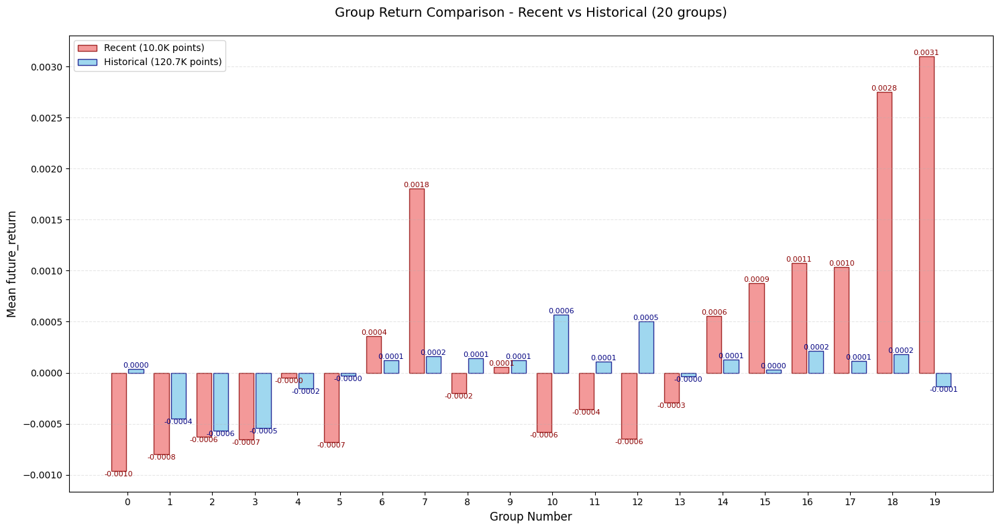

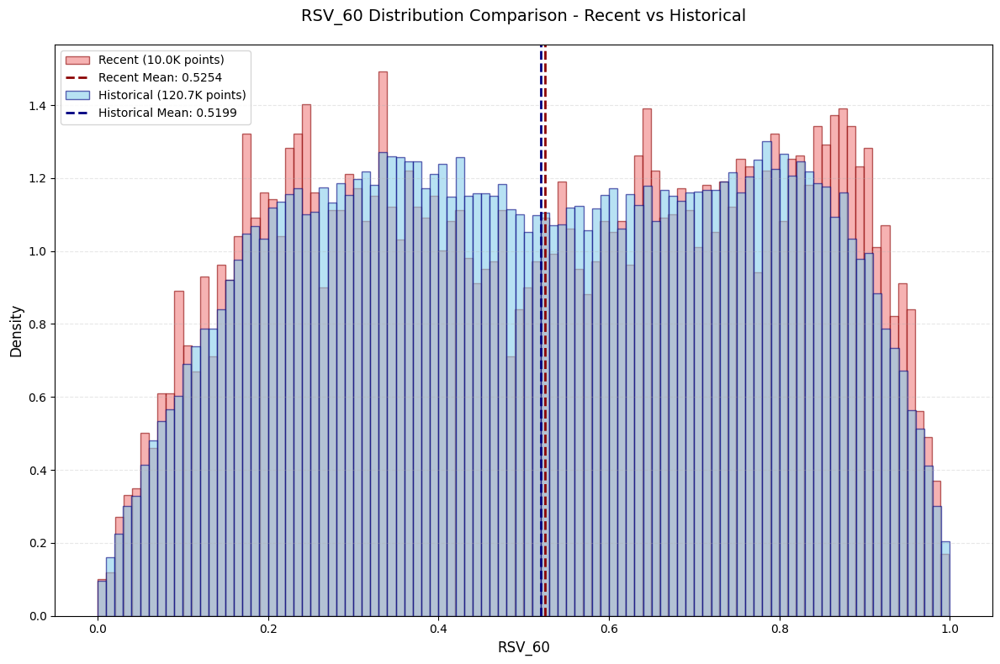

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  74%|███████▍  | 106/143 [02:12<00:49,  1.34s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.019760
   Rank_IC (Spearman): -0.023745
📊 信息比率:
   IR: 0.324699
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: SUMP_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


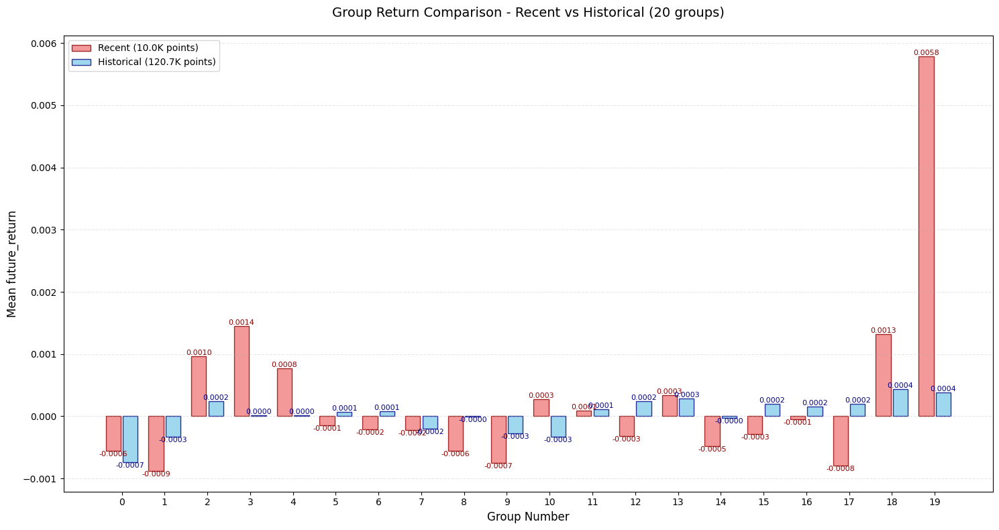

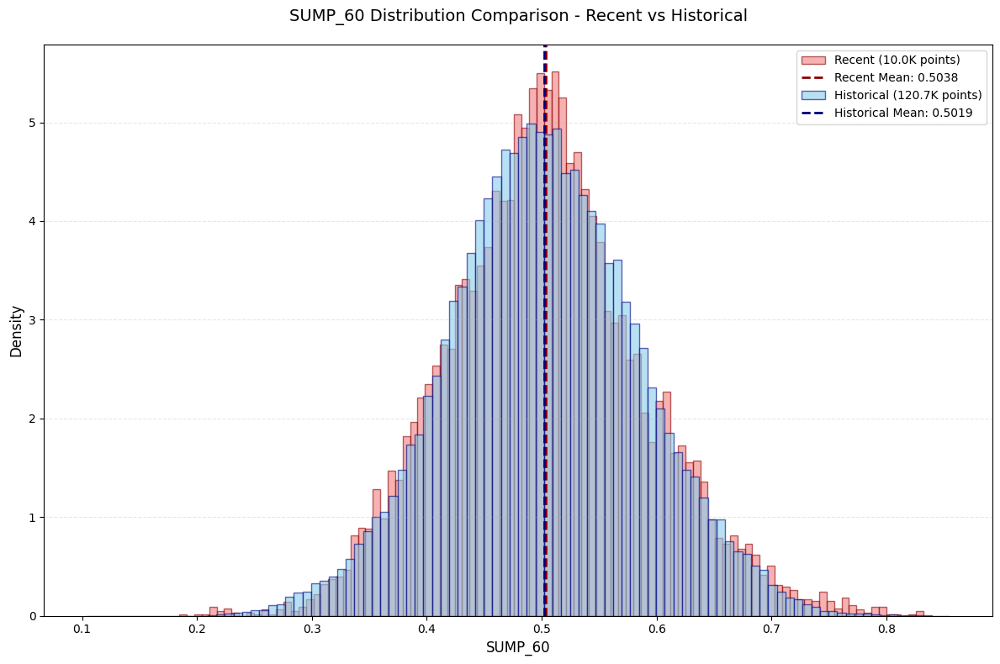

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  75%|███████▍  | 107/143 [02:13<00:49,  1.37s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.019760
   Rank_IC (Spearman): 0.023745
📊 信息比率:
   IR: -0.324978
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: SUMN_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


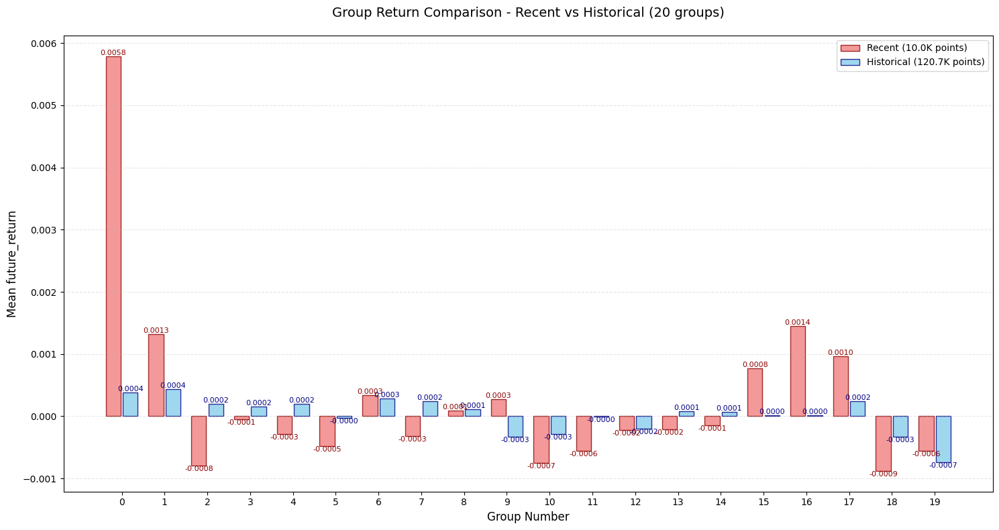

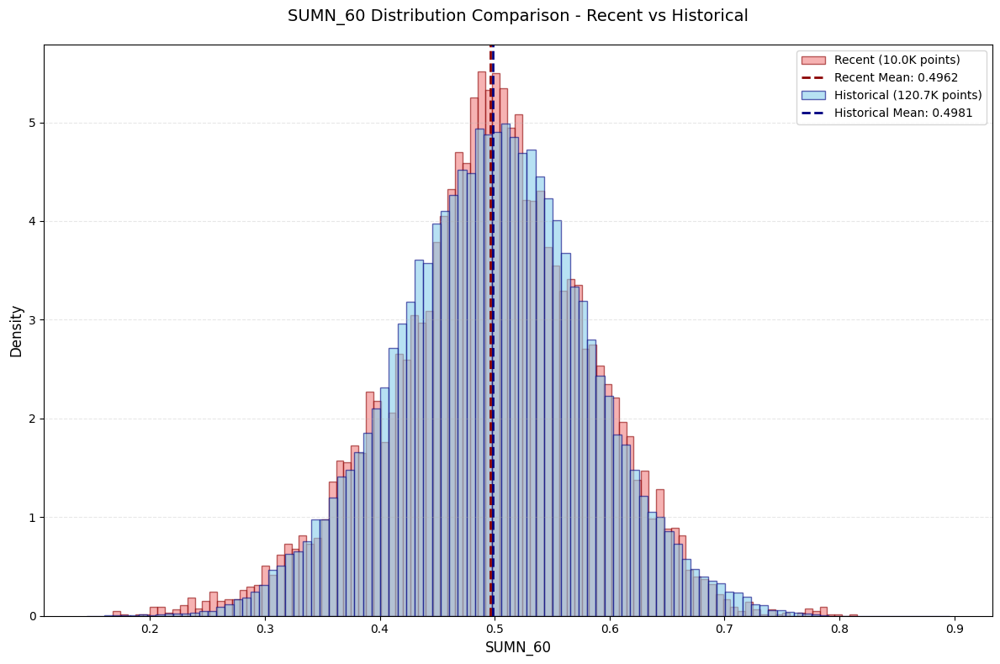

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  76%|███████▌  | 108/143 [02:15<00:47,  1.37s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.019760
   Rank_IC (Spearman): -0.023745
📊 信息比率:
   IR: 0.324699
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: SUMD_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


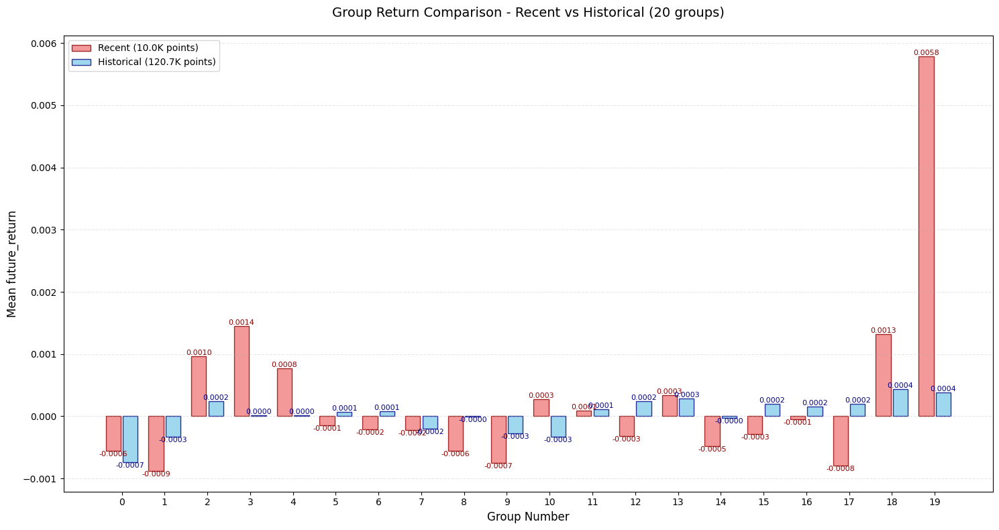

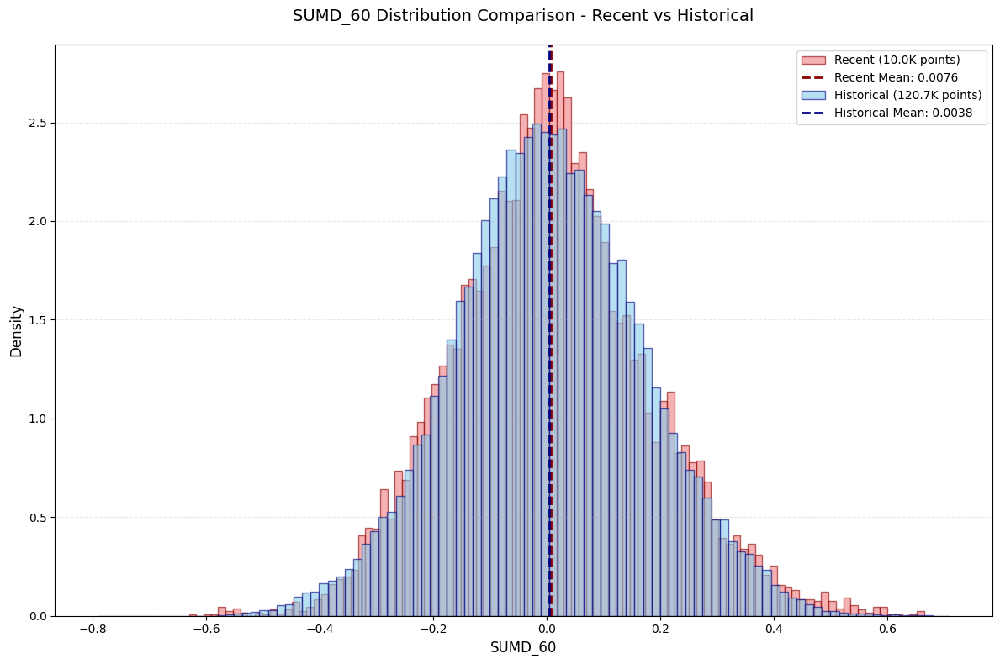

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  76%|███████▌  | 109/143 [02:16<00:46,  1.36s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.000062
   Rank_IC (Spearman): 0.032815
📊 信息比率:
   IR: 0.363269
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: MA_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


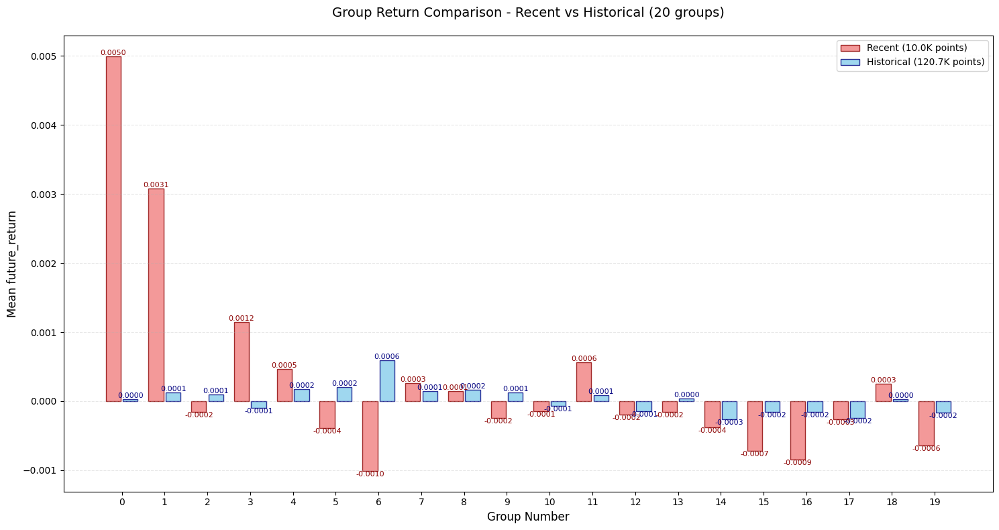

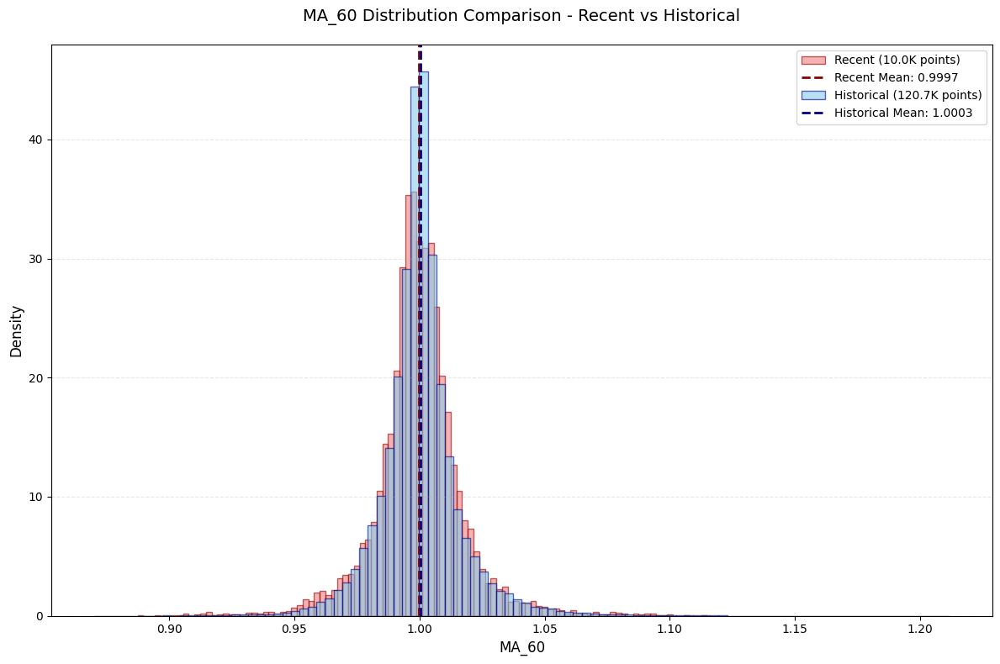

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  77%|███████▋  | 110/143 [02:18<00:45,  1.39s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.014798
   Rank_IC (Spearman): -0.036771
📊 信息比率:
   IR: -0.047772
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: RANK_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


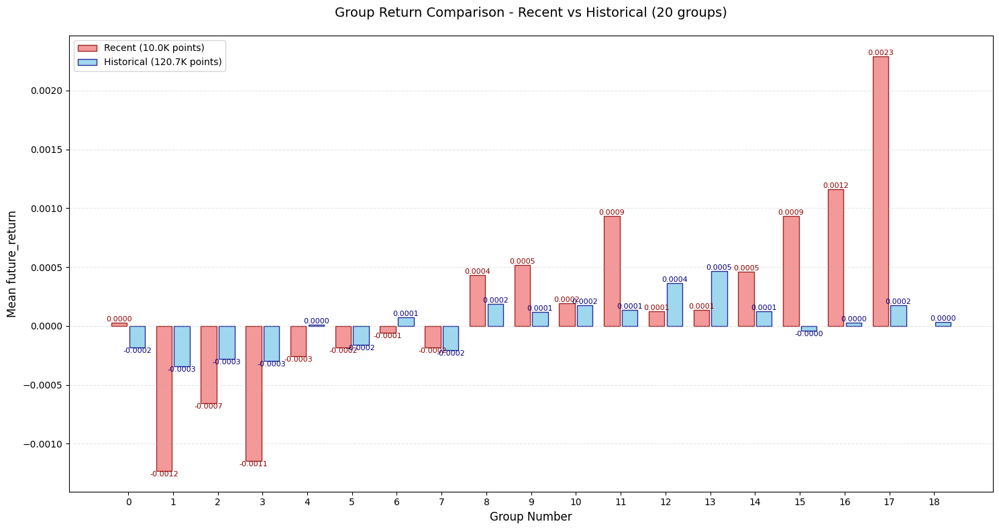

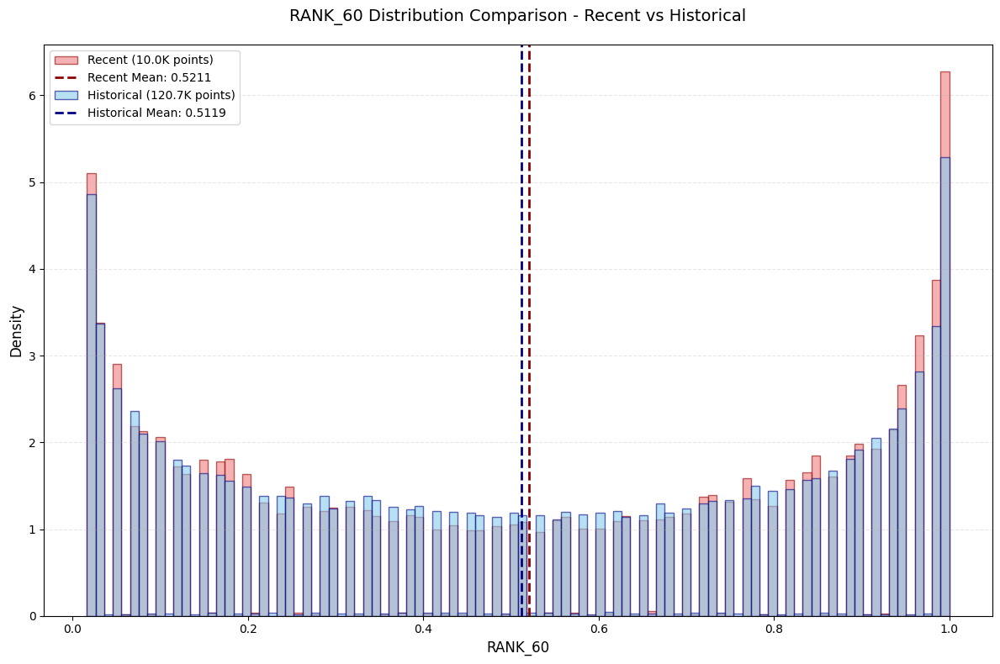

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  78%|███████▊  | 111/143 [02:19<00:44,  1.39s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.011985
   Rank_IC (Spearman): -0.024849
📊 信息比率:
   IR: -0.303876
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: RESI_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


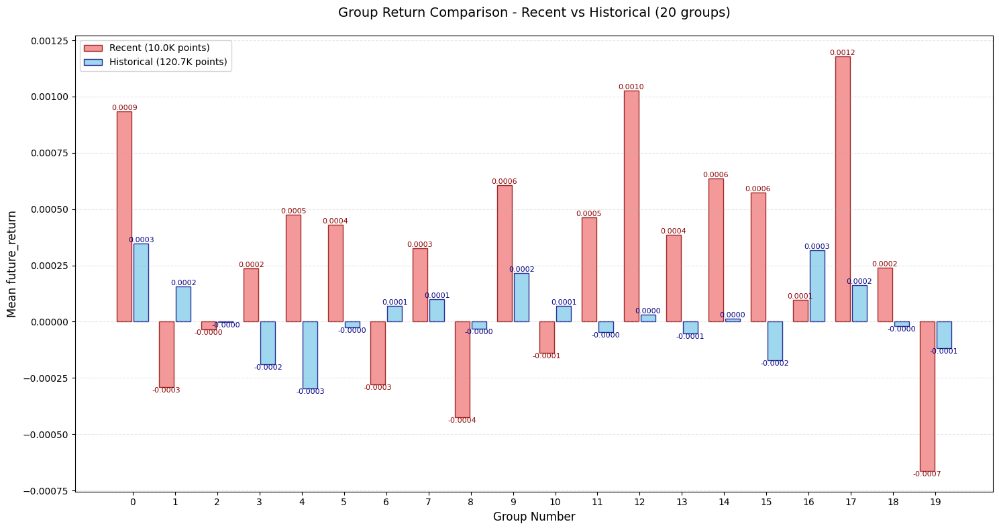

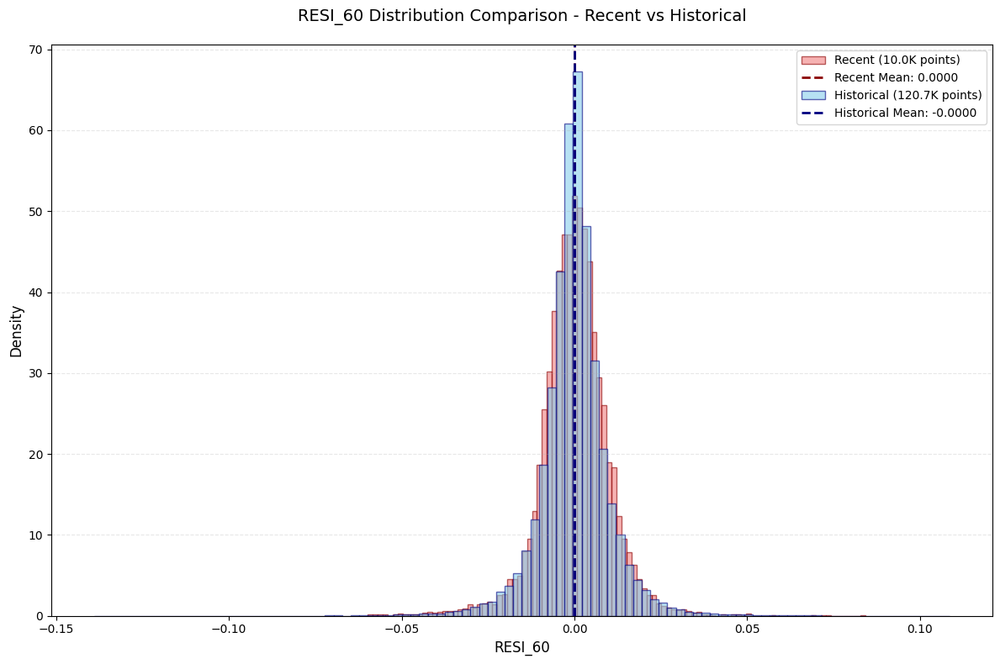

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  78%|███████▊  | 112/143 [02:20<00:42,  1.37s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.009663
   Rank_IC (Spearman): -0.009807
📊 信息比率:
   IR: -0.219011
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: RSQR_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


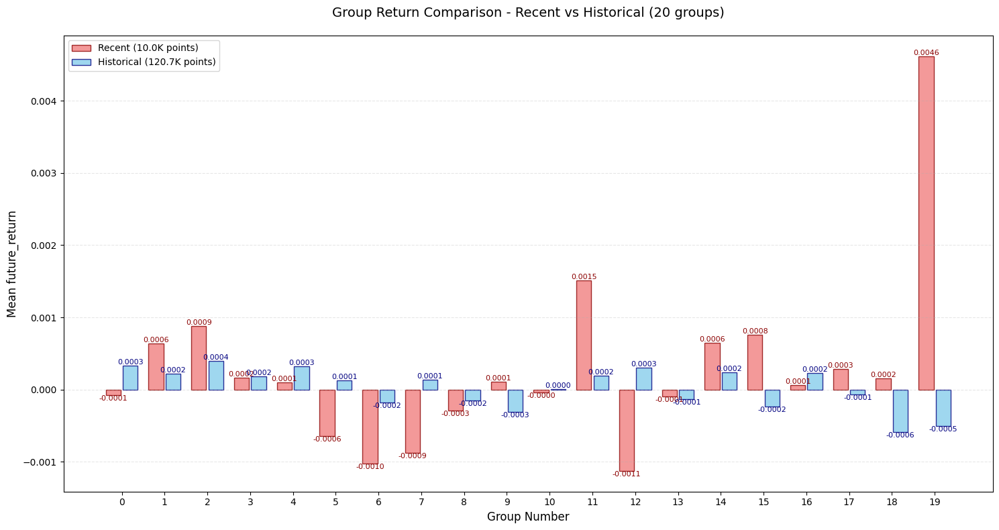

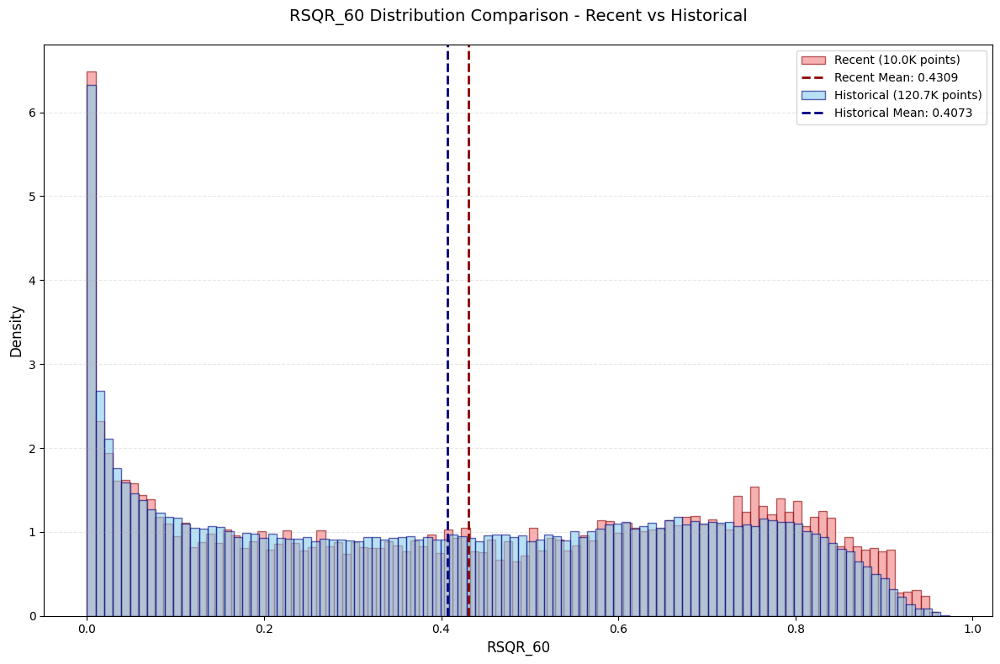

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  79%|███████▉  | 113/143 [02:22<00:41,  1.40s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.006909
   Rank_IC (Spearman): -0.030968
📊 信息比率:
   IR: -0.091808
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: IMAX_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


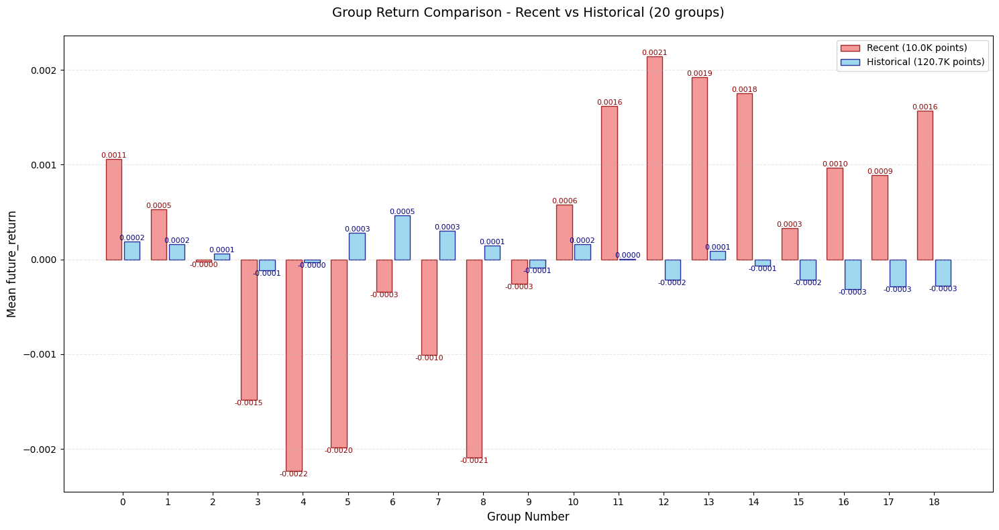

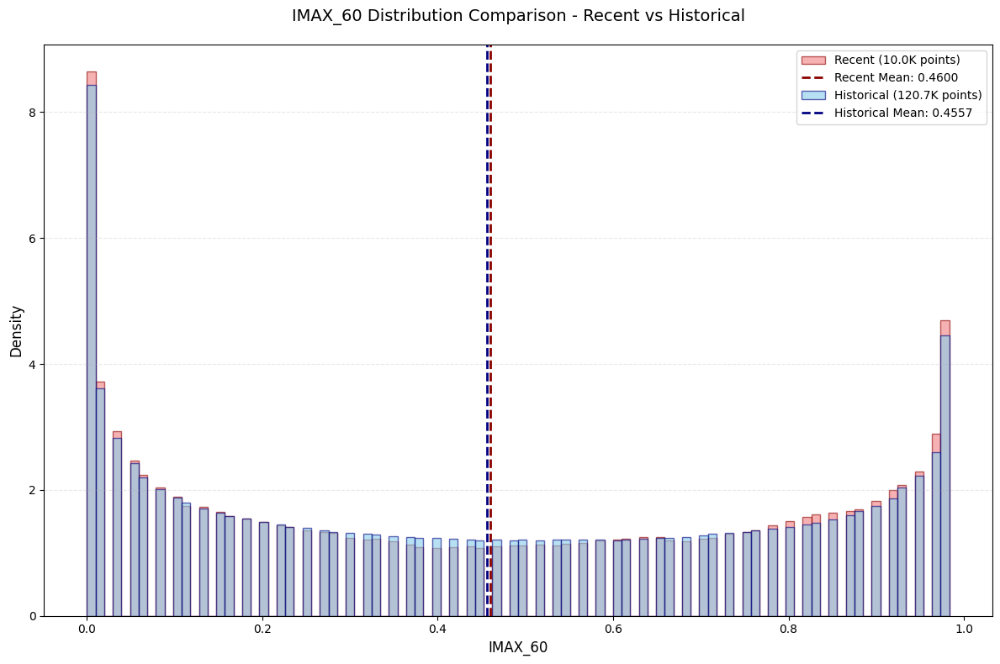

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  80%|███████▉  | 114/143 [02:23<00:39,  1.37s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.002240
   Rank_IC (Spearman): 0.023666
📊 信息比率:
   IR: 0.118782
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: IMIN_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


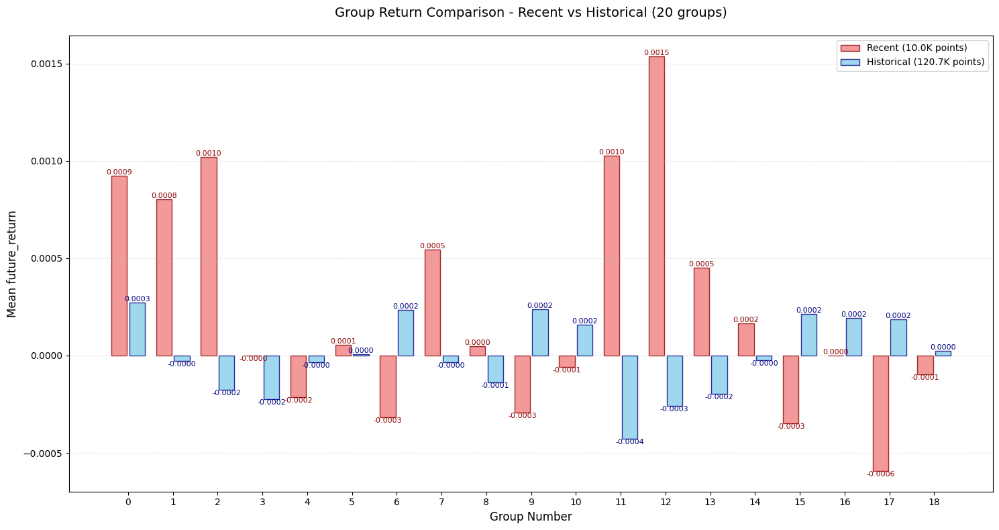

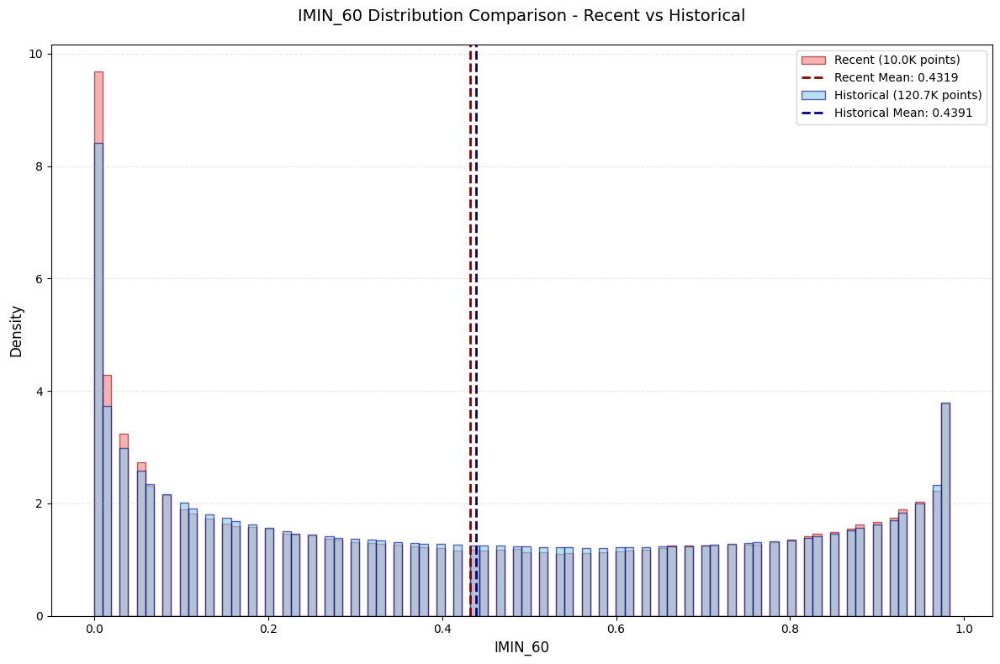

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  80%|████████  | 115/143 [02:24<00:37,  1.35s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.002840
   Rank_IC (Spearman): -0.033322
📊 信息比率:
   IR: 0.076758
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: IMXD_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


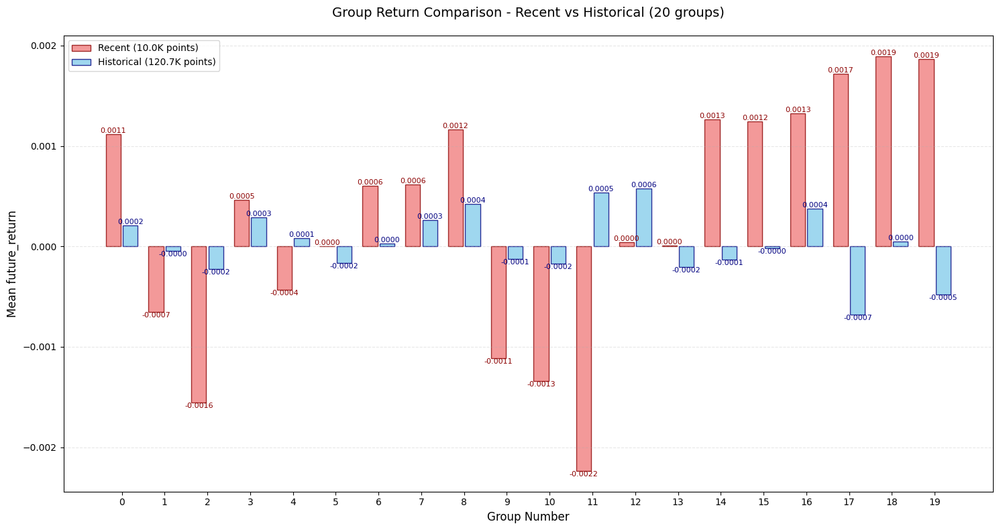

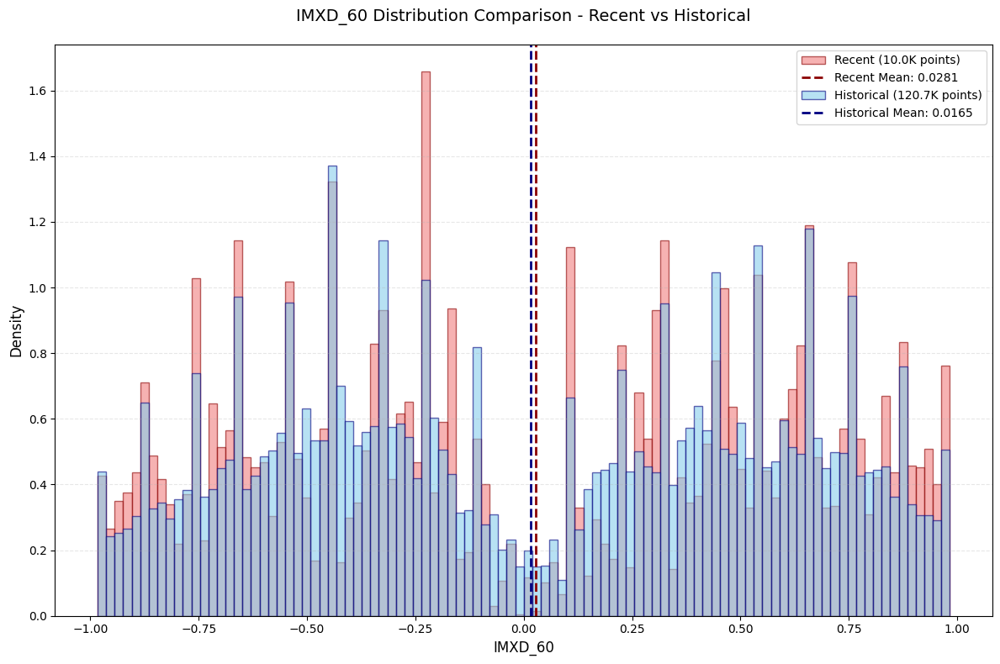

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  81%|████████  | 116/143 [02:26<00:36,  1.34s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.003367
   Rank_IC (Spearman): 0.029075
📊 信息比率:
   IR: 0.098752
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: QTLD_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


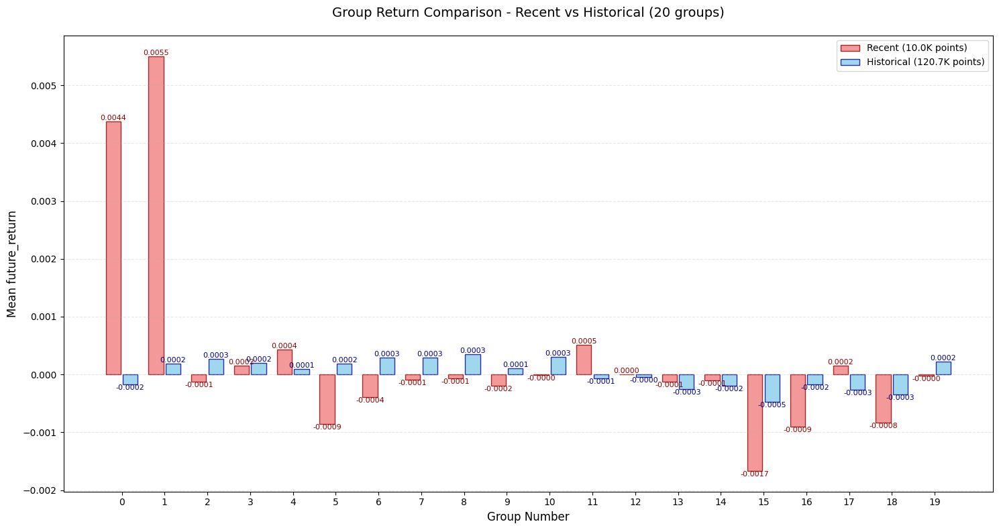

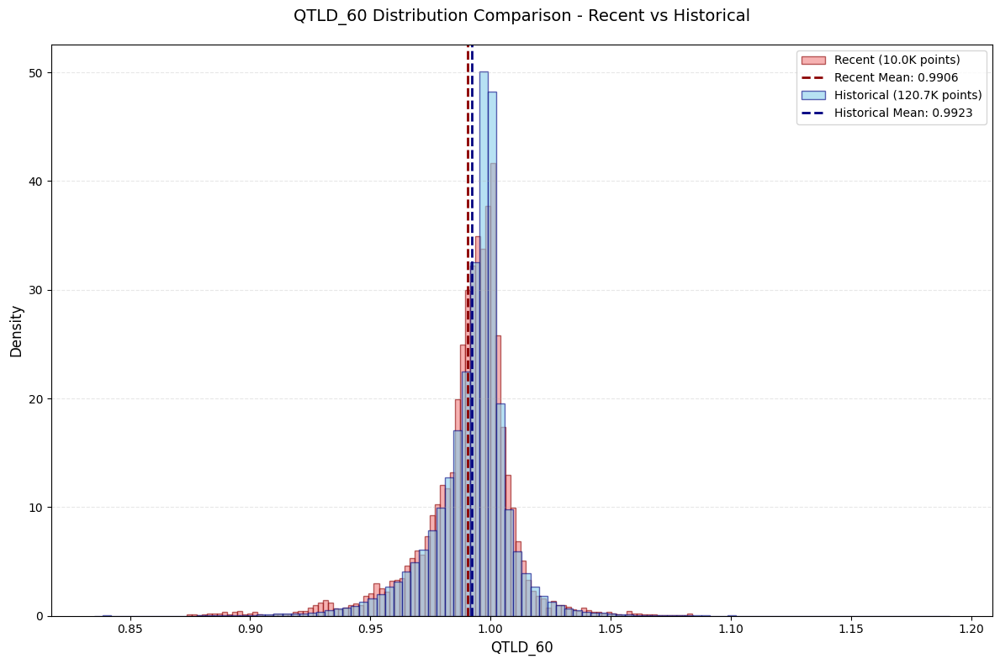

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  82%|████████▏ | 117/143 [02:27<00:36,  1.38s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.001543
   Rank_IC (Spearman): 0.039940
📊 信息比率:
   IR: -0.099469
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: QTLU_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


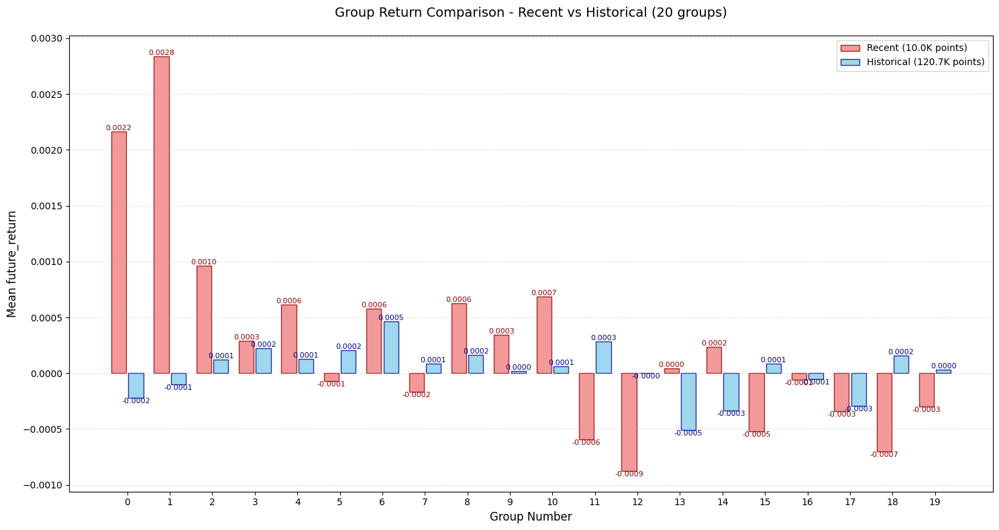

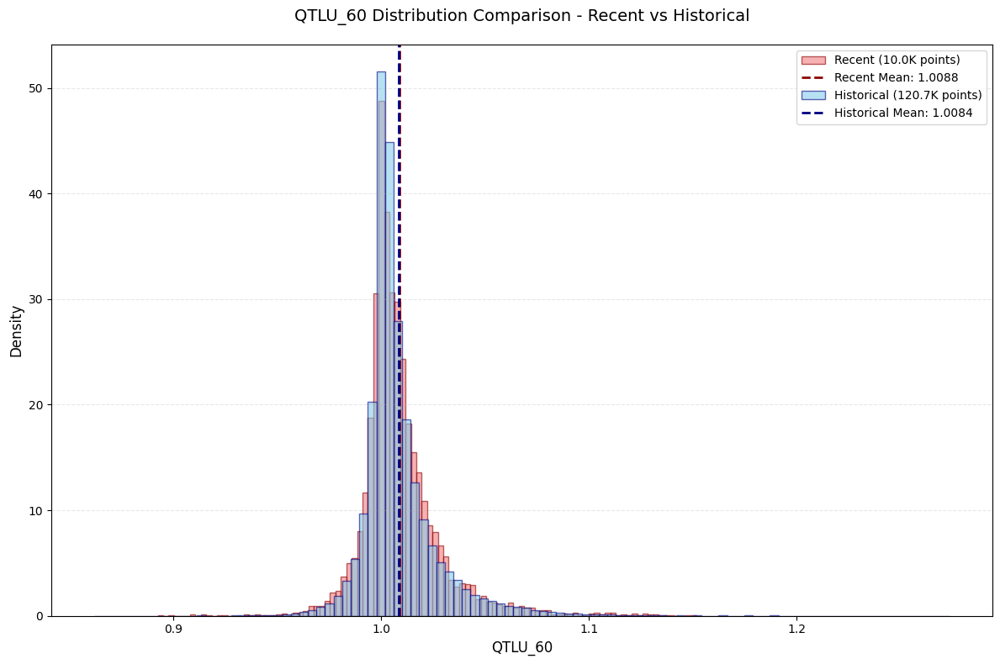

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  83%|████████▎ | 118/143 [02:29<00:34,  1.37s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.000664
   Rank_IC (Spearman): 0.001588
📊 信息比率:
   IR: -0.282976
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VMA_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


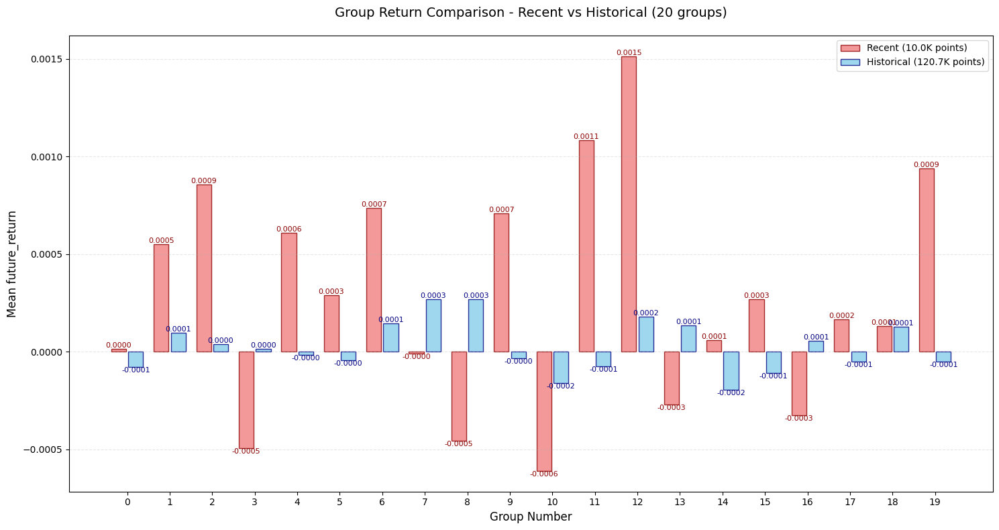

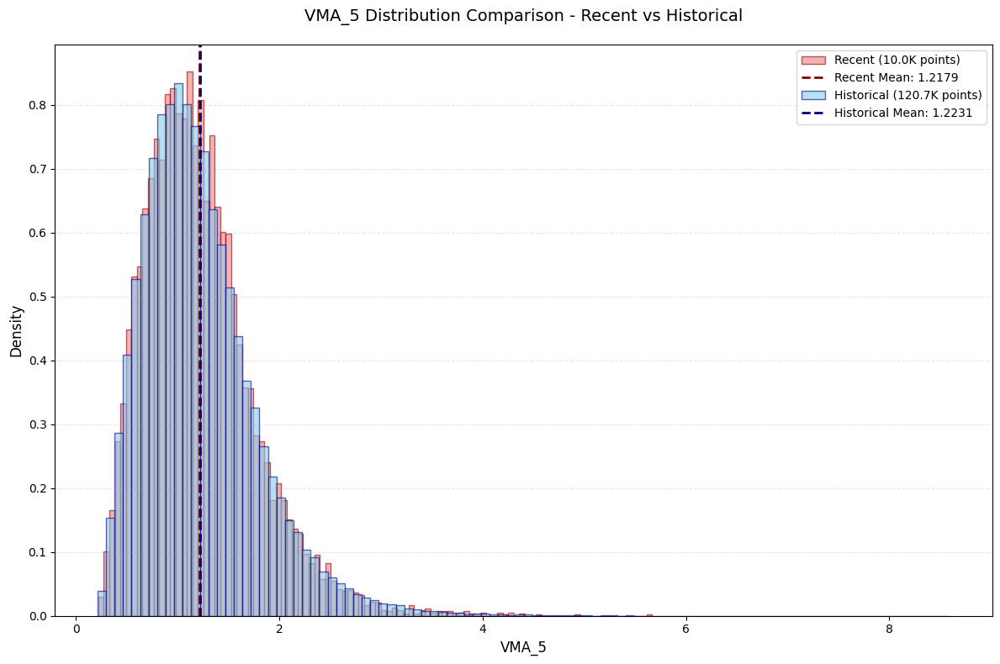

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  83%|████████▎ | 119/143 [02:30<00:32,  1.36s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.001929
   Rank_IC (Spearman): -0.000748
📊 信息比率:
   IR: 0.127487
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSTD_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


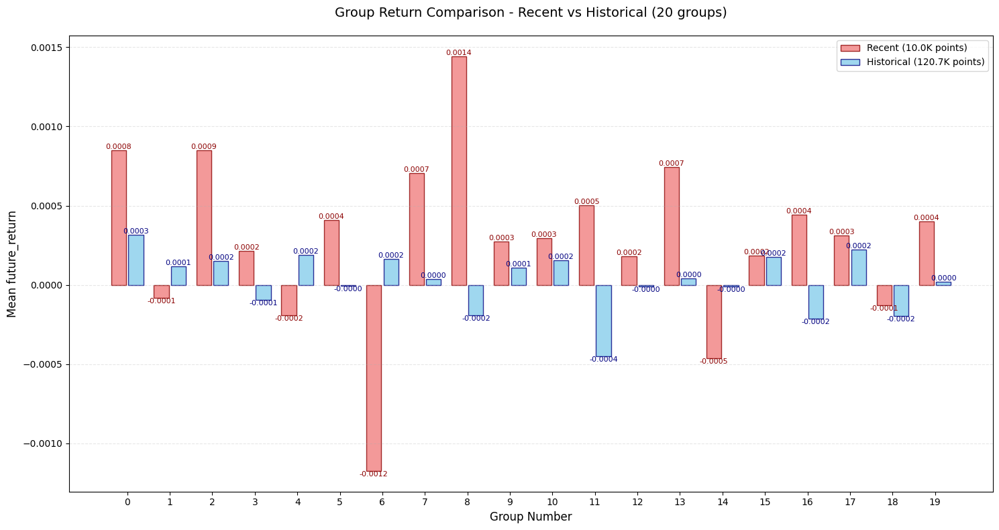

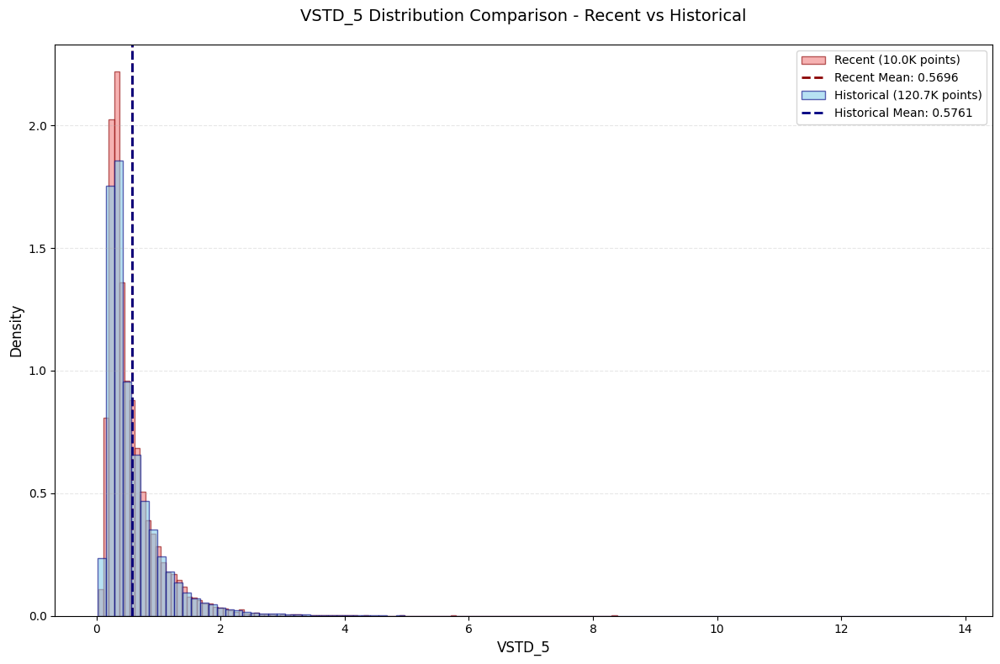

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  84%|████████▍ | 120/143 [02:31<00:32,  1.40s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.002007
   Rank_IC (Spearman): -0.006272
📊 信息比率:
   IR: -0.173296
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMP_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


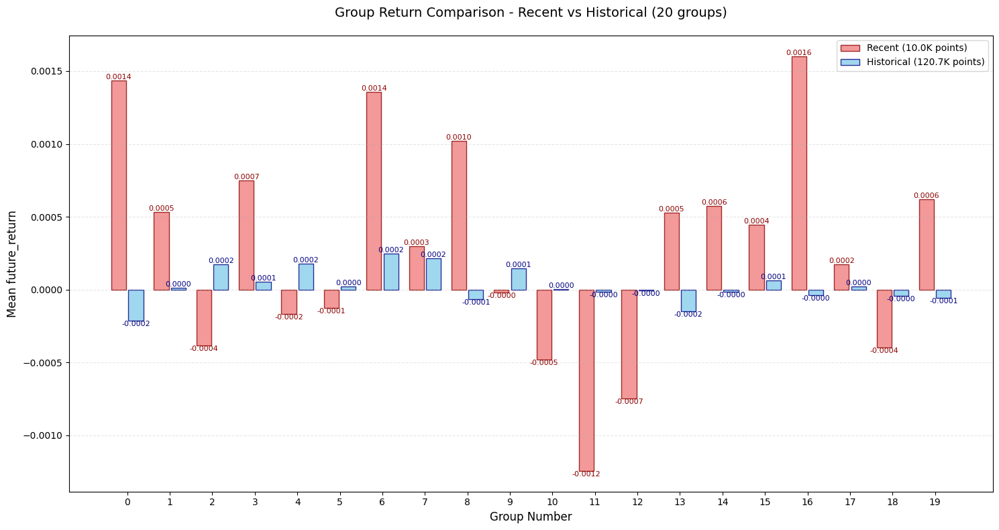

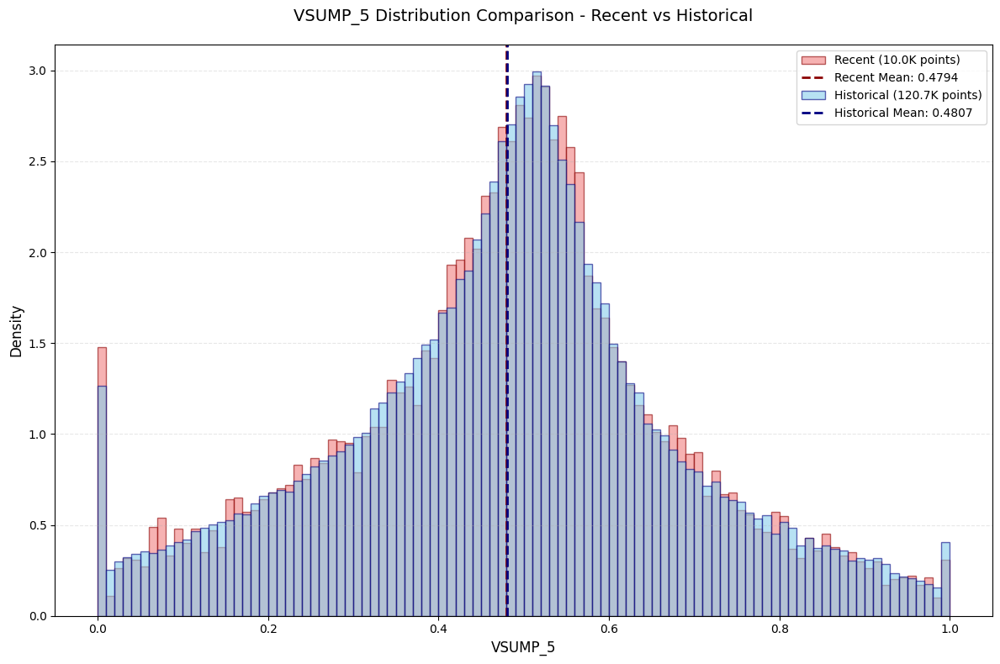

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  85%|████████▍ | 121/143 [02:33<00:30,  1.39s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.002007
   Rank_IC (Spearman): 0.006272
📊 信息比率:
   IR: 0.196001
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMN_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


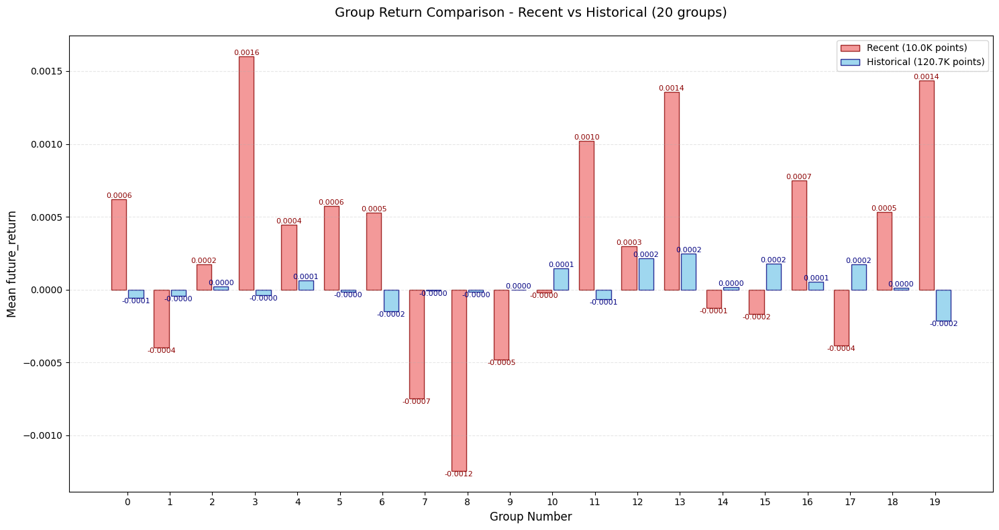

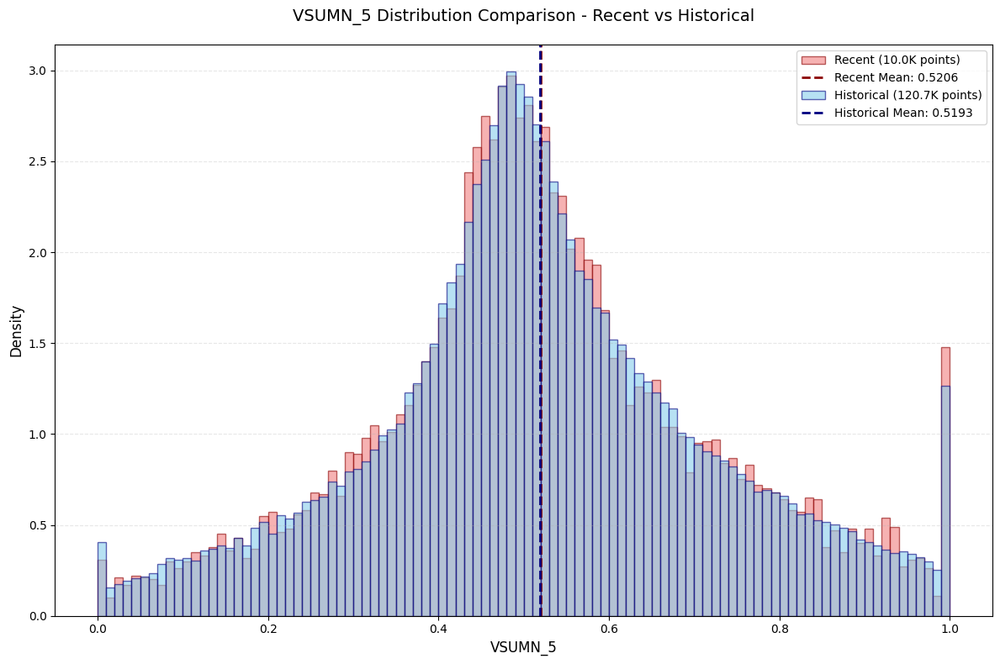

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  85%|████████▌ | 122/143 [02:34<00:29,  1.38s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.002007
   Rank_IC (Spearman): -0.006272
📊 信息比率:
   IR: -0.173296
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMD_5
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


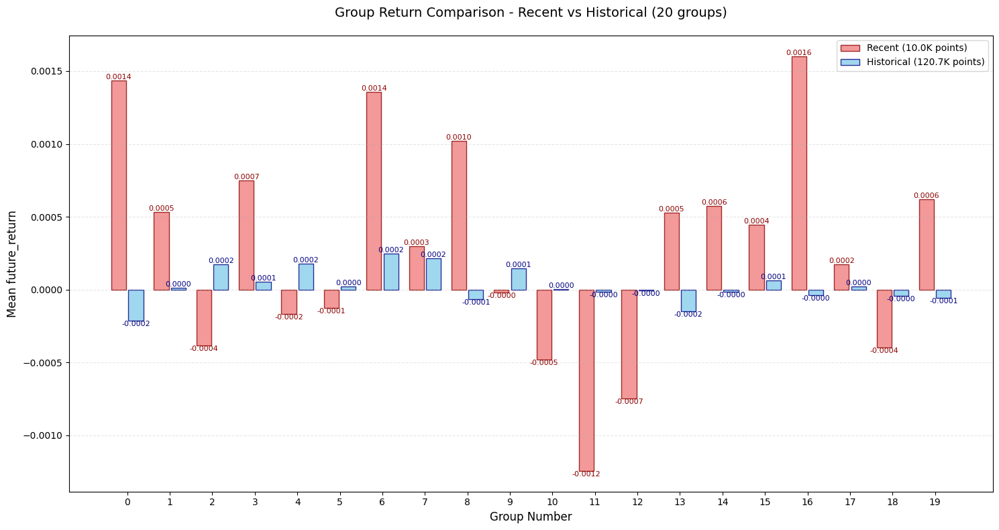

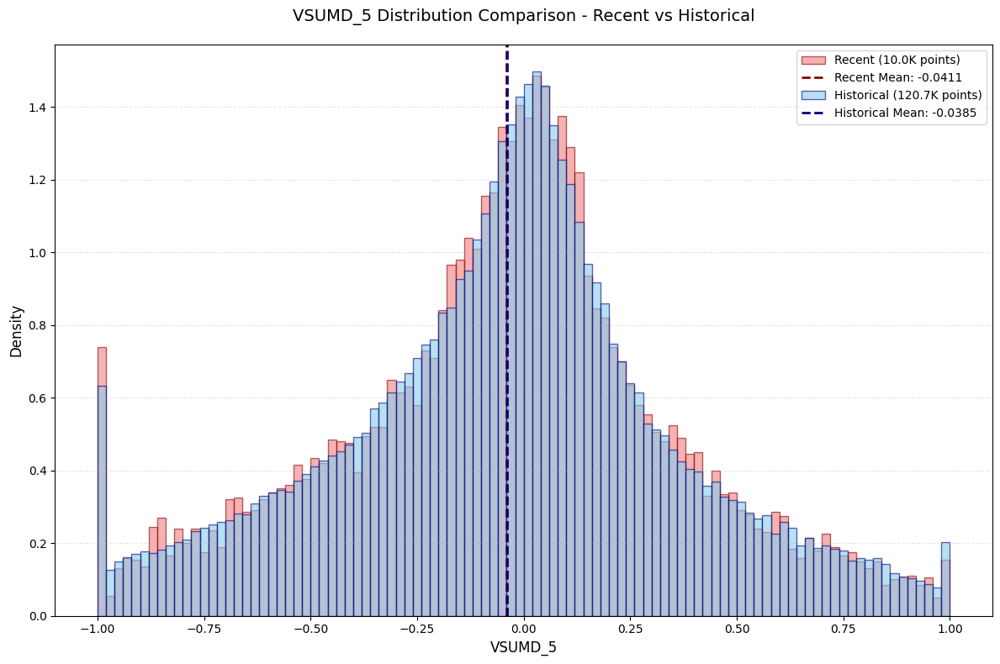

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  86%|████████▌ | 123/143 [02:36<00:28,  1.42s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.002096
   Rank_IC (Spearman): 0.005907
📊 信息比率:
   IR: 0.844439
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VMA_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


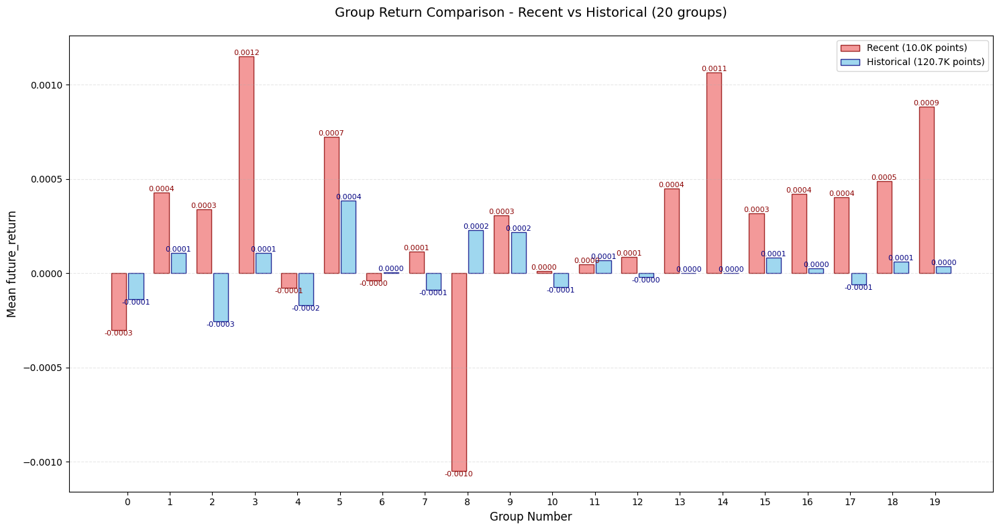

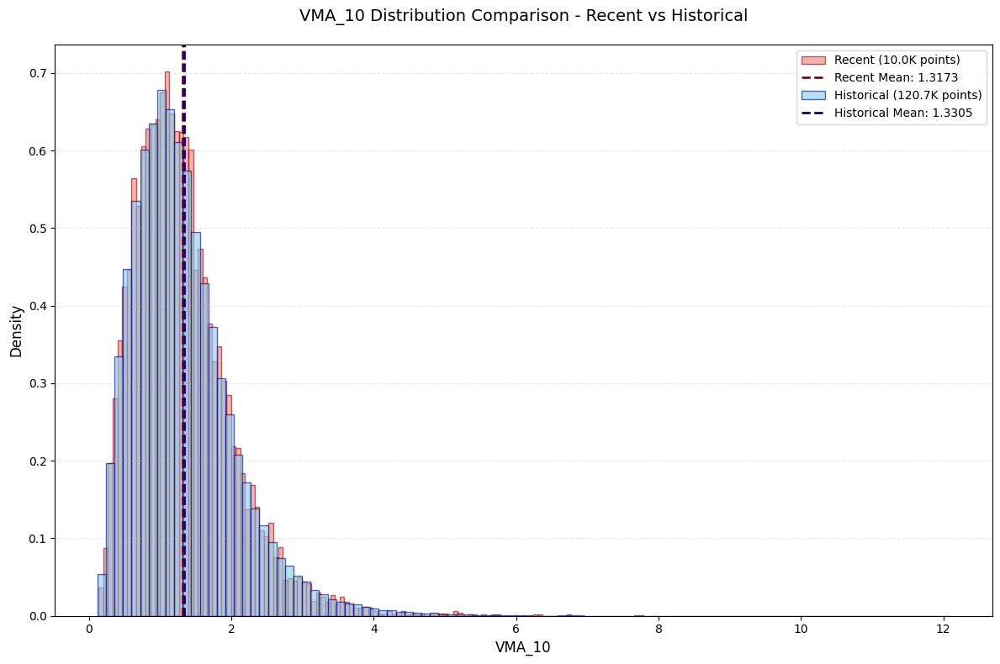

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  87%|████████▋ | 124/143 [02:37<00:26,  1.40s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.001596
   Rank_IC (Spearman): 0.004842
📊 信息比率:
   IR: 0.737886
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSTD_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


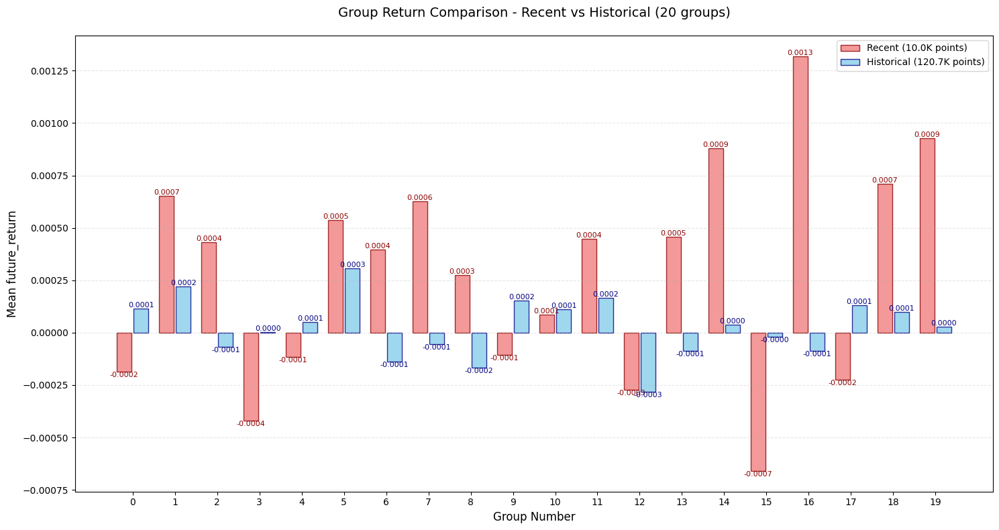

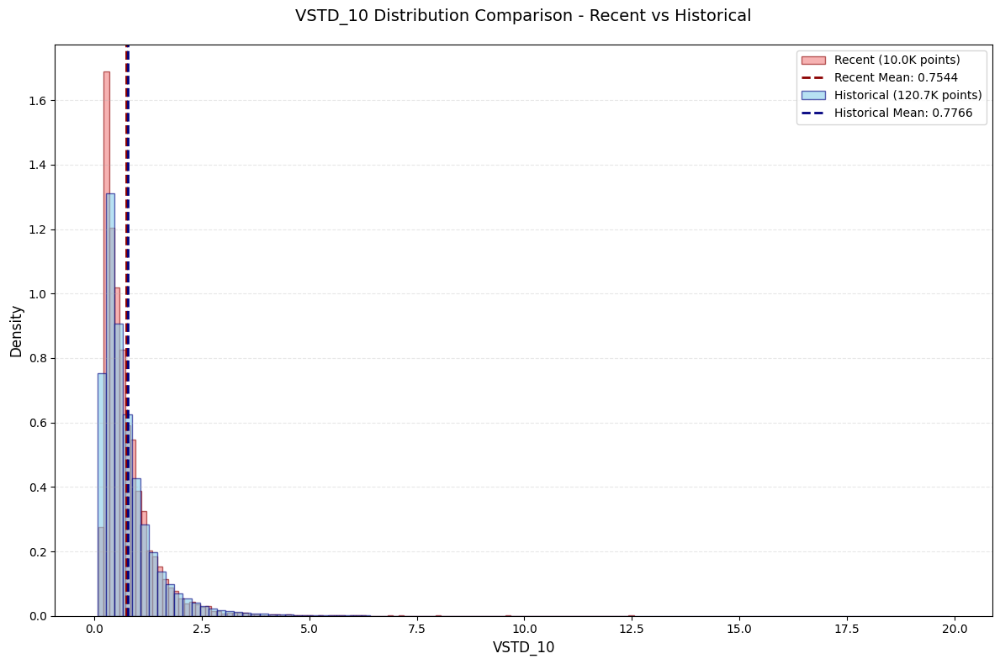

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  87%|████████▋ | 125/143 [02:38<00:25,  1.39s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.007202
   Rank_IC (Spearman): -0.008738
📊 信息比率:
   IR: -0.274712
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMP_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


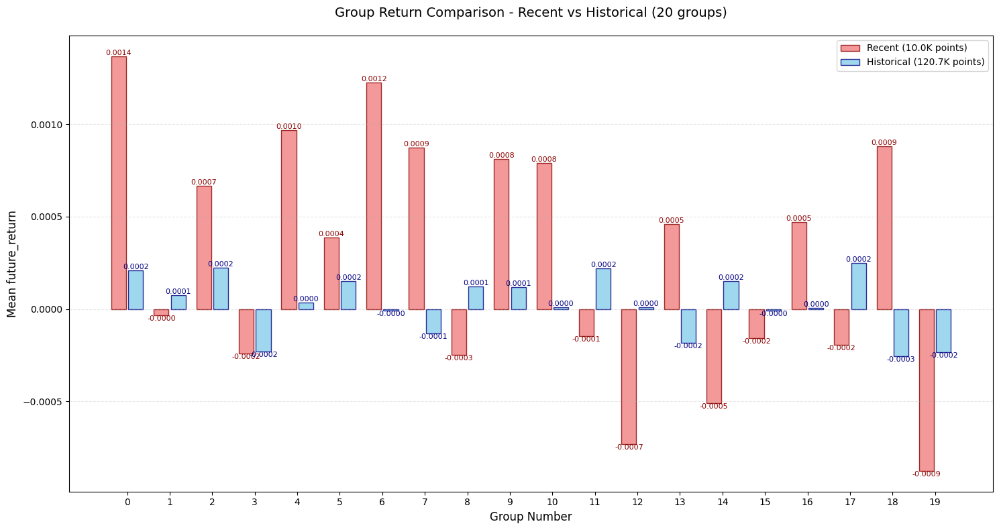

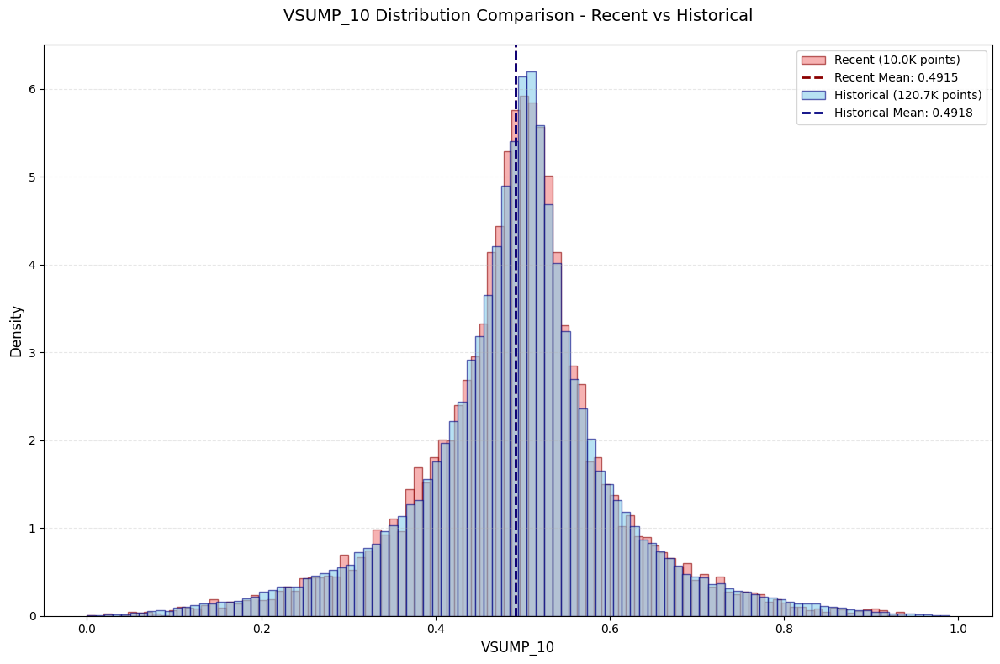

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  88%|████████▊ | 126/143 [02:40<00:24,  1.42s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.007202
   Rank_IC (Spearman): 0.008738
📊 信息比率:
   IR: 0.274210
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMN_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


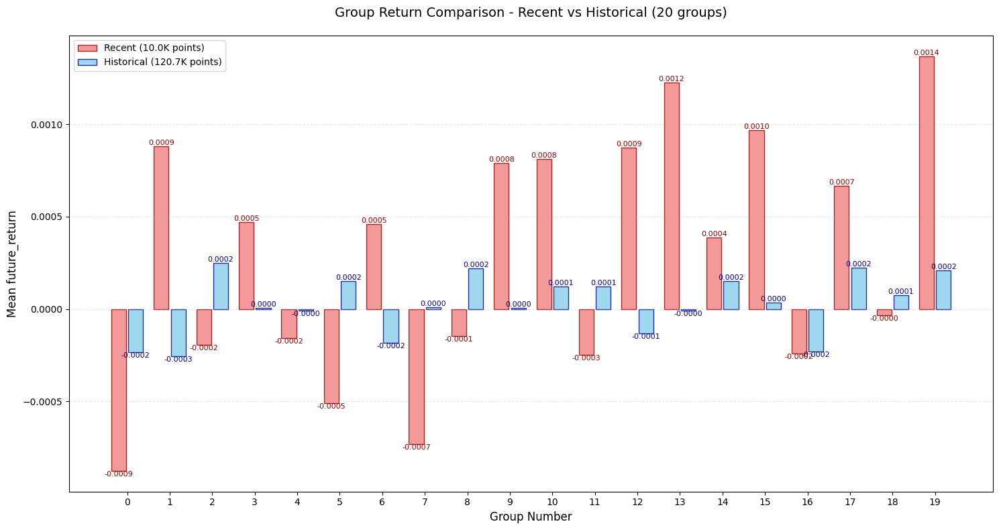

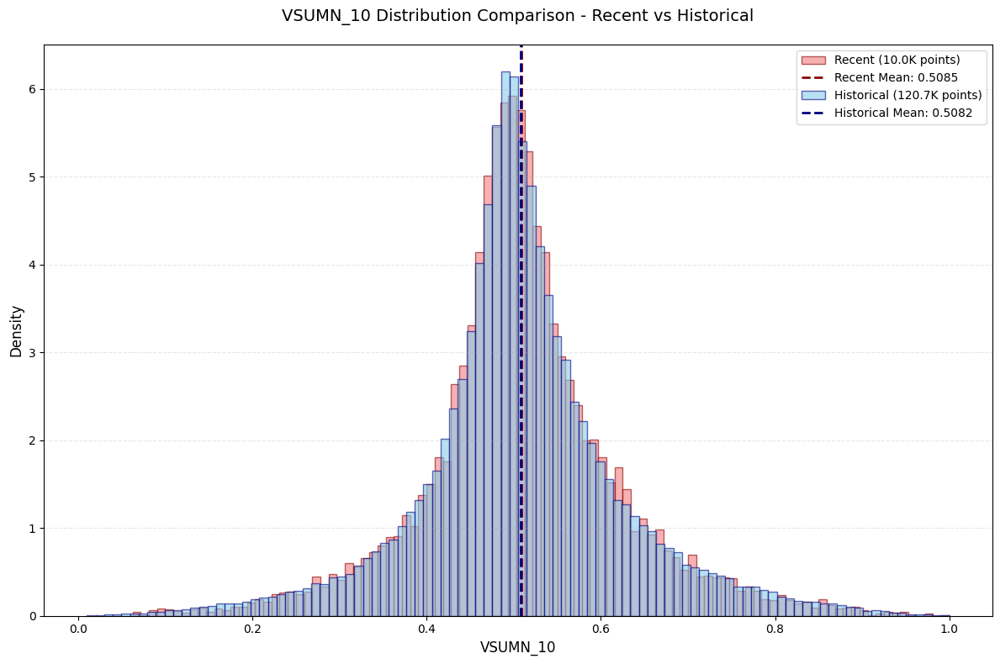

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  89%|████████▉ | 127/143 [02:41<00:22,  1.39s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.007202
   Rank_IC (Spearman): -0.008738
📊 信息比率:
   IR: -0.274712
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMD_10
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


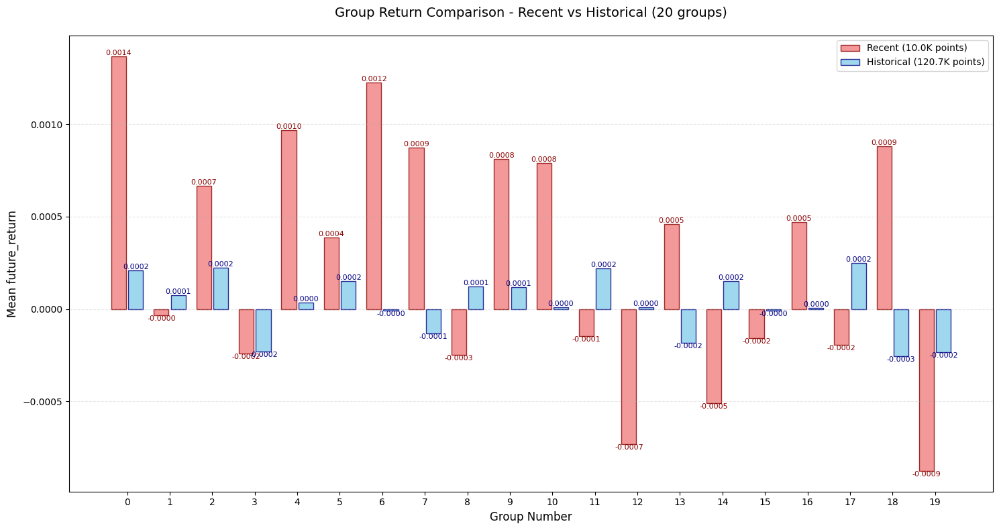

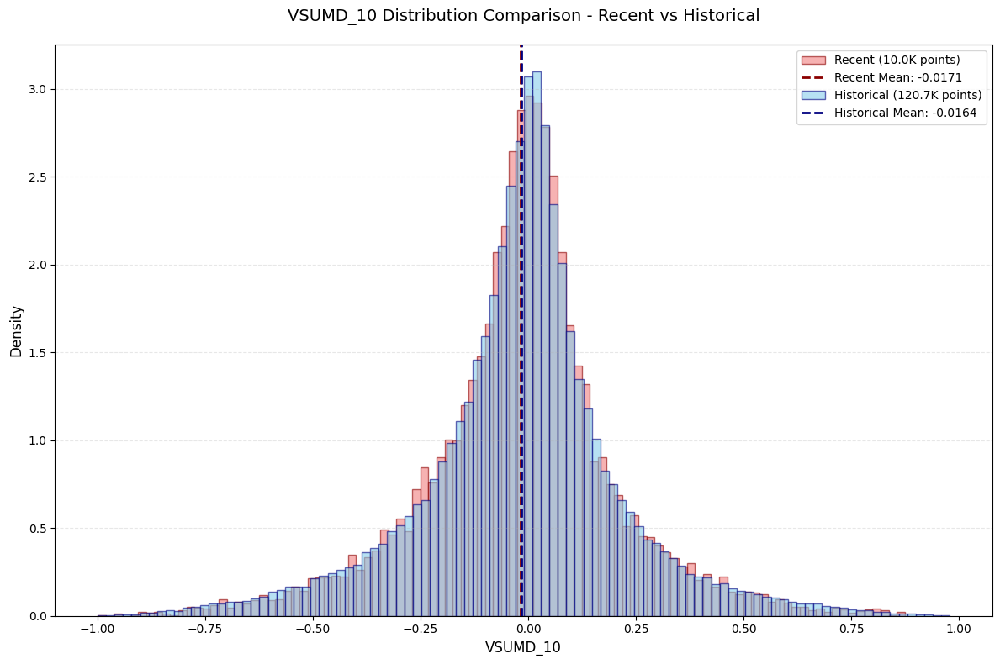

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  90%|████████▉ | 128/143 [02:42<00:20,  1.37s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.000080
   Rank_IC (Spearman): 0.006893
📊 信息比率:
   IR: -1.125076
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VMA_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


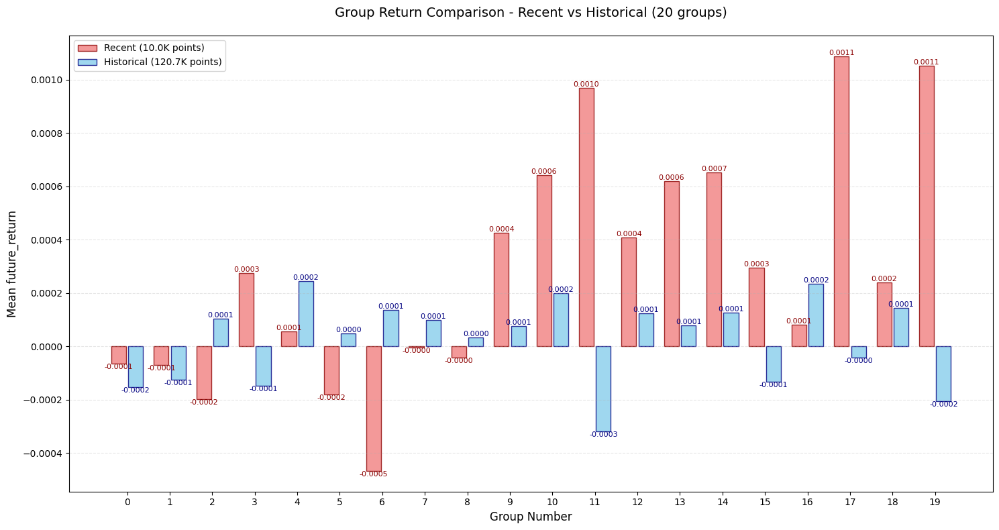

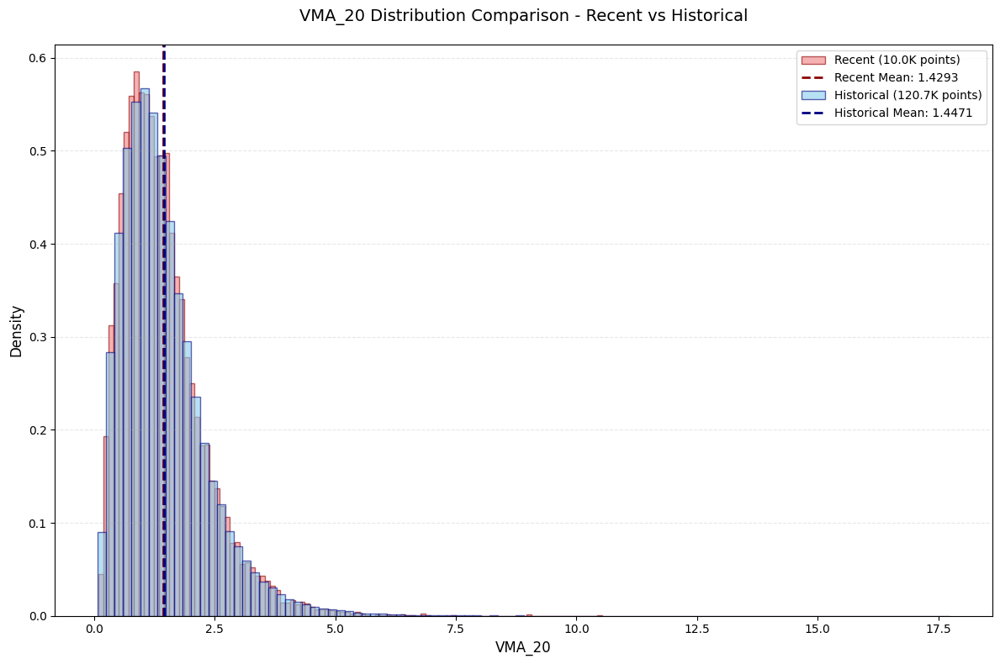

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  90%|█████████ | 129/143 [02:44<00:19,  1.42s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.000414
   Rank_IC (Spearman): 0.007222
📊 信息比率:
   IR: 0.244575
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSTD_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


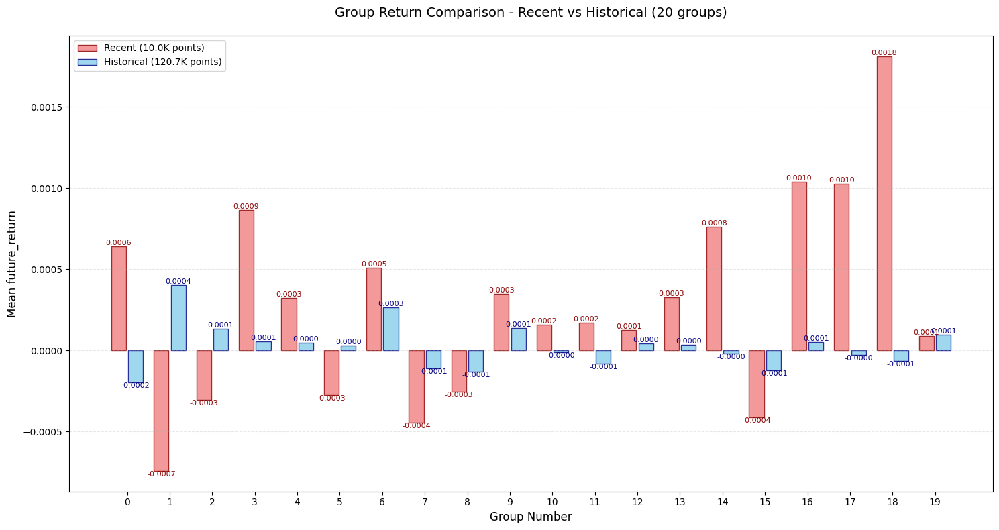

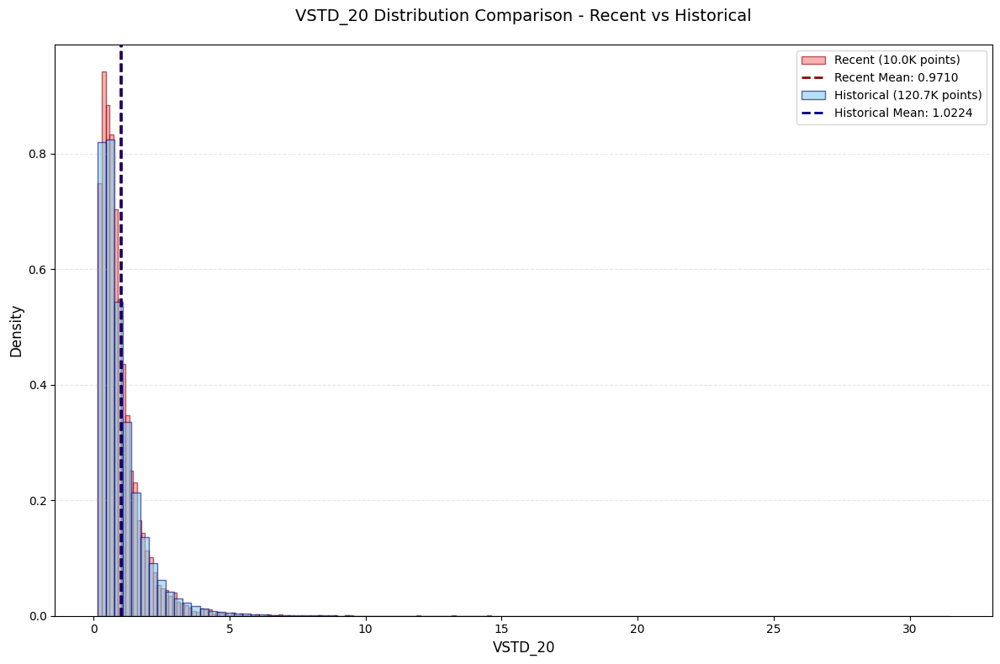

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  91%|█████████ | 130/143 [02:45<00:18,  1.39s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.001040
   Rank_IC (Spearman): -0.004565
📊 信息比率:
   IR: -0.039119
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMP_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


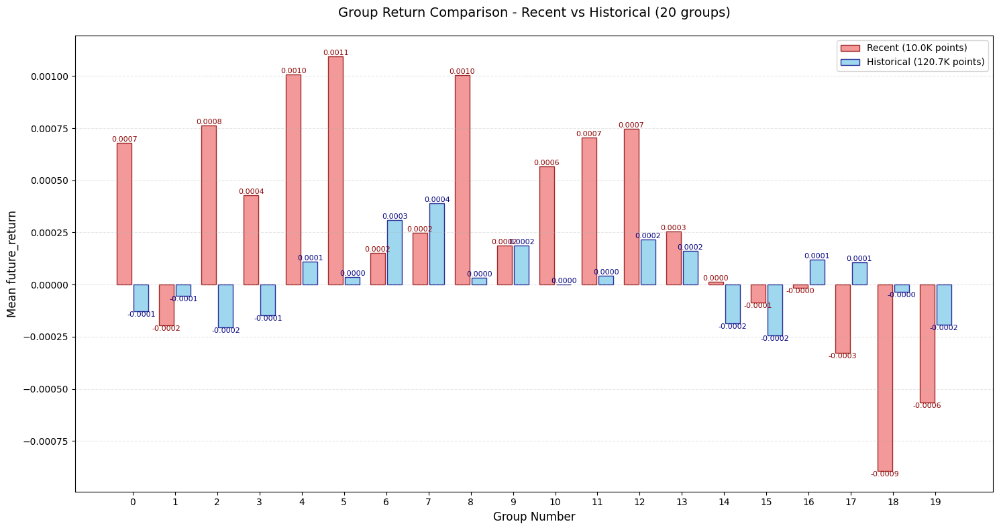

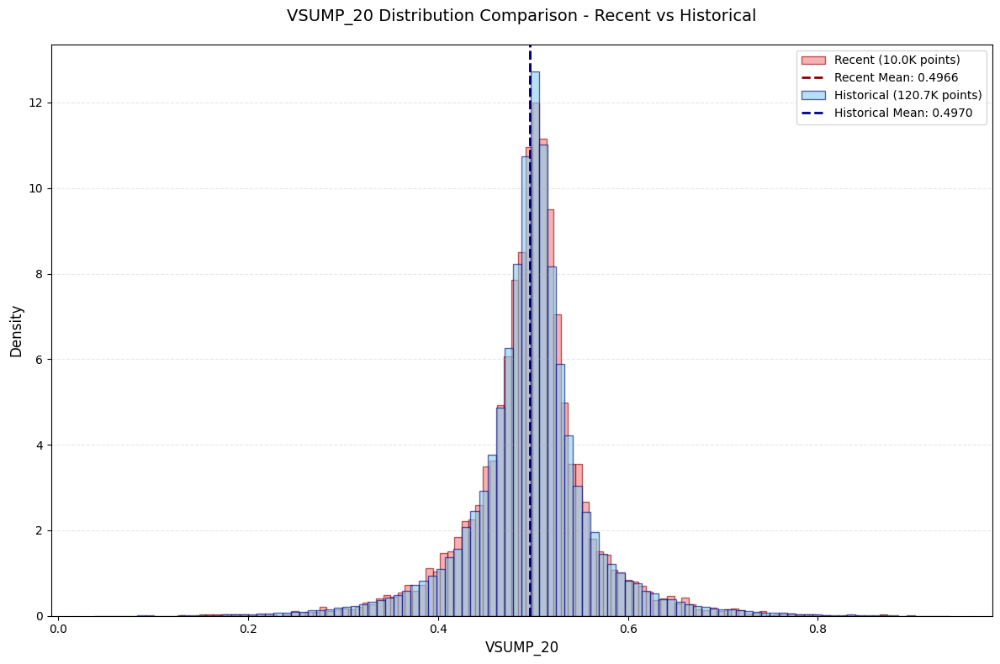

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  92%|█████████▏| 131/143 [02:47<00:16,  1.39s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.001040
   Rank_IC (Spearman): 0.004565
📊 信息比率:
   IR: 0.035873
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMN_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


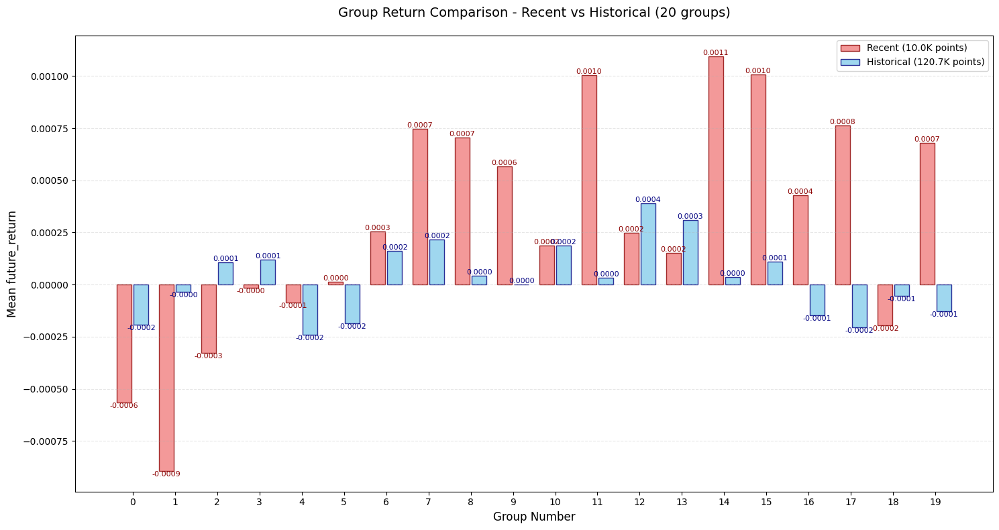

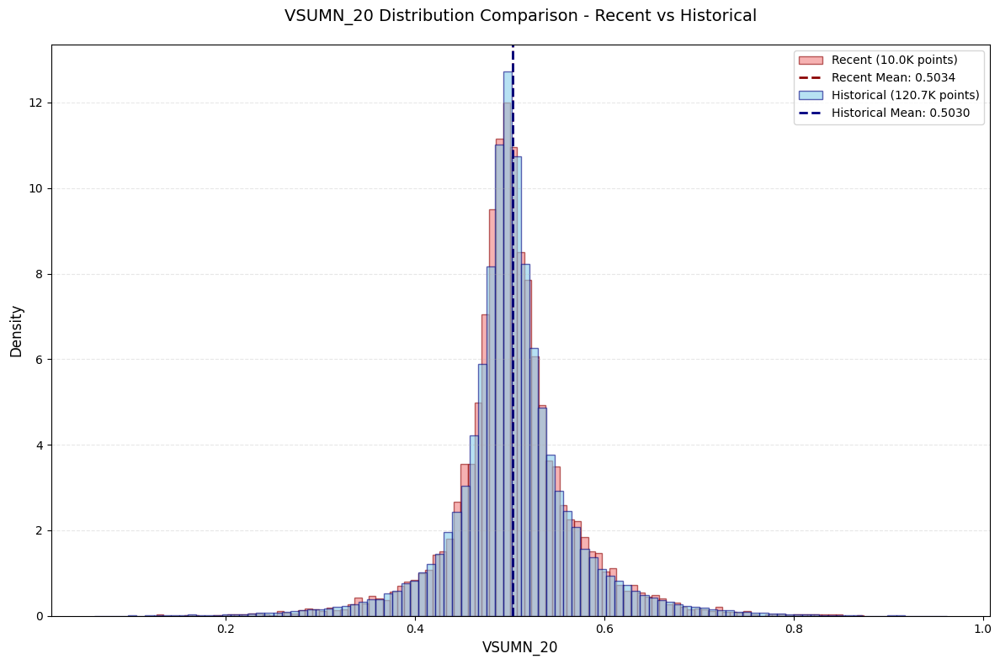

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  92%|█████████▏| 132/143 [02:48<00:15,  1.43s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.001040
   Rank_IC (Spearman): -0.004565
📊 信息比率:
   IR: -0.039119
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMD_20
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


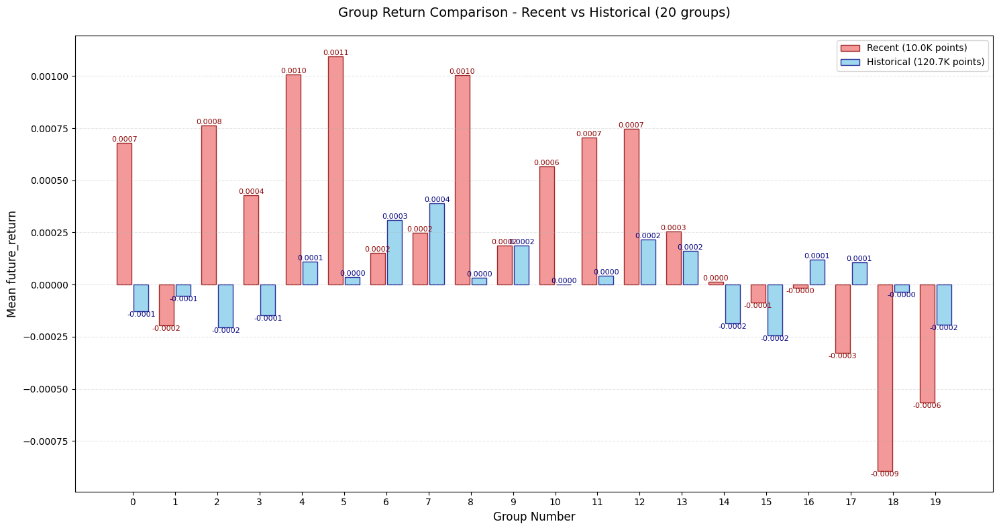

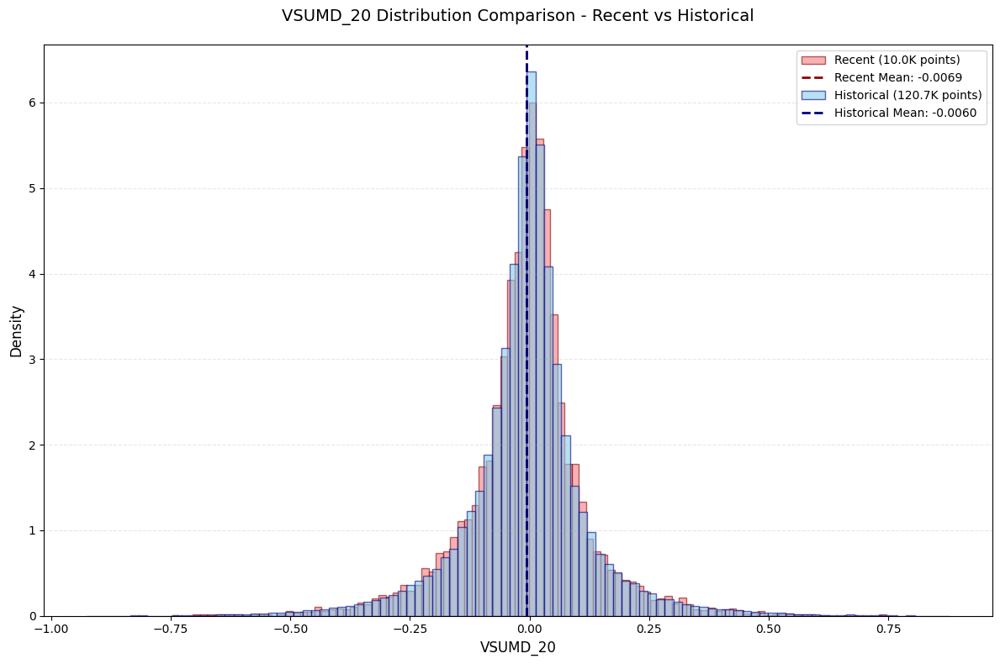

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  93%|█████████▎| 133/143 [02:50<00:14,  1.43s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.000779
   Rank_IC (Spearman): 0.005570
📊 信息比率:
   IR: -0.224395
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VMA_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


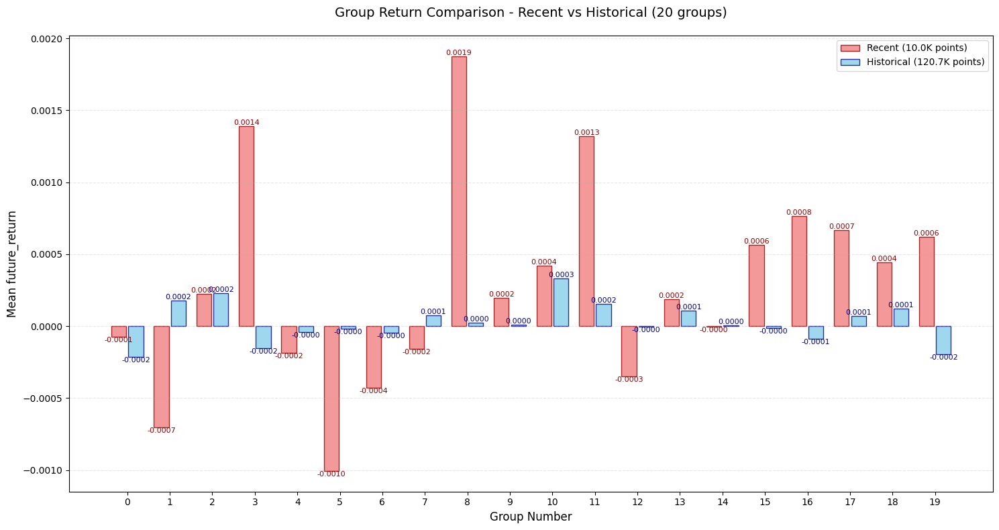

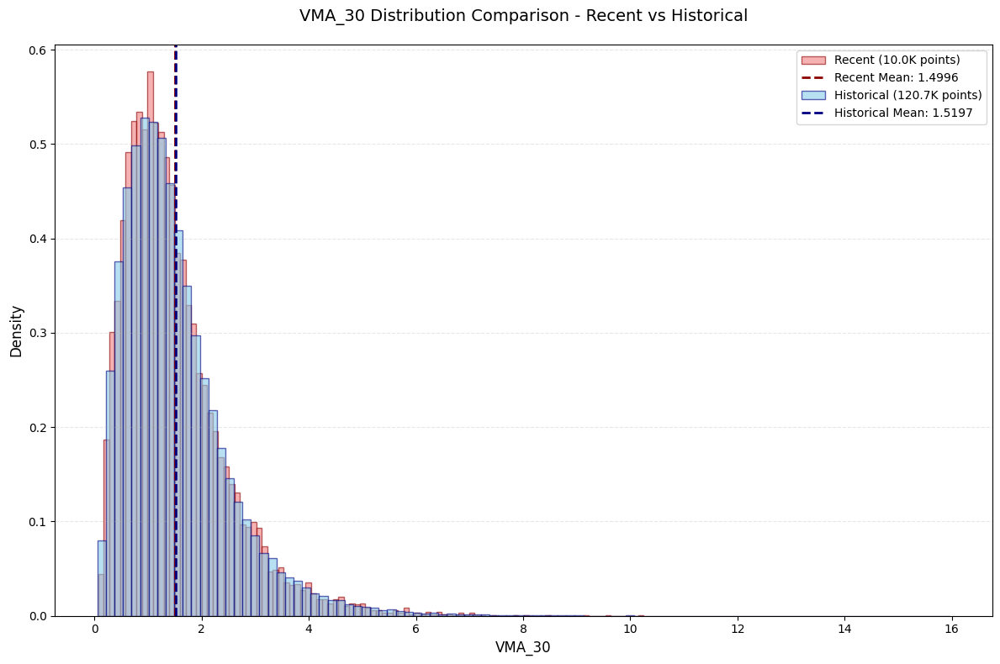

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  94%|█████████▎| 134/143 [02:51<00:12,  1.42s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.000792
   Rank_IC (Spearman): 0.007336
📊 信息比率:
   IR: -0.419440
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSTD_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


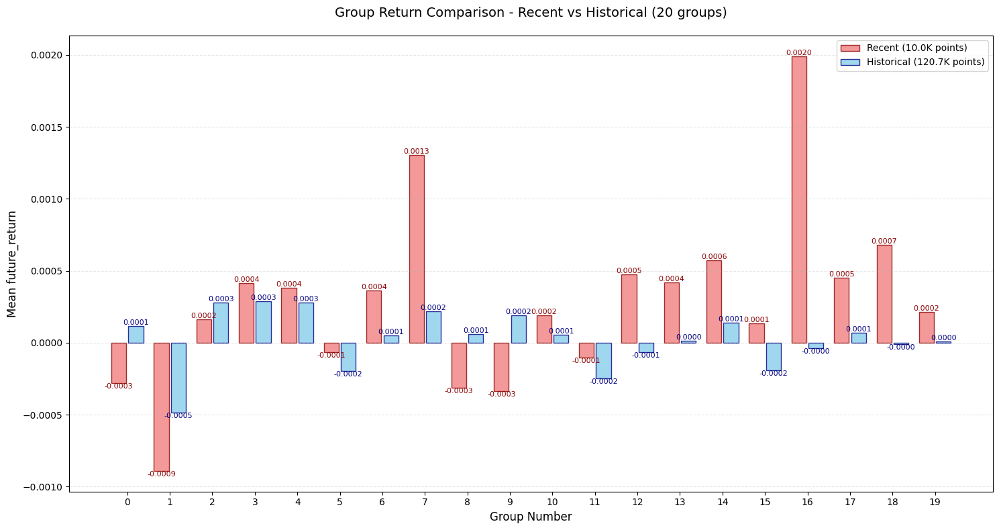

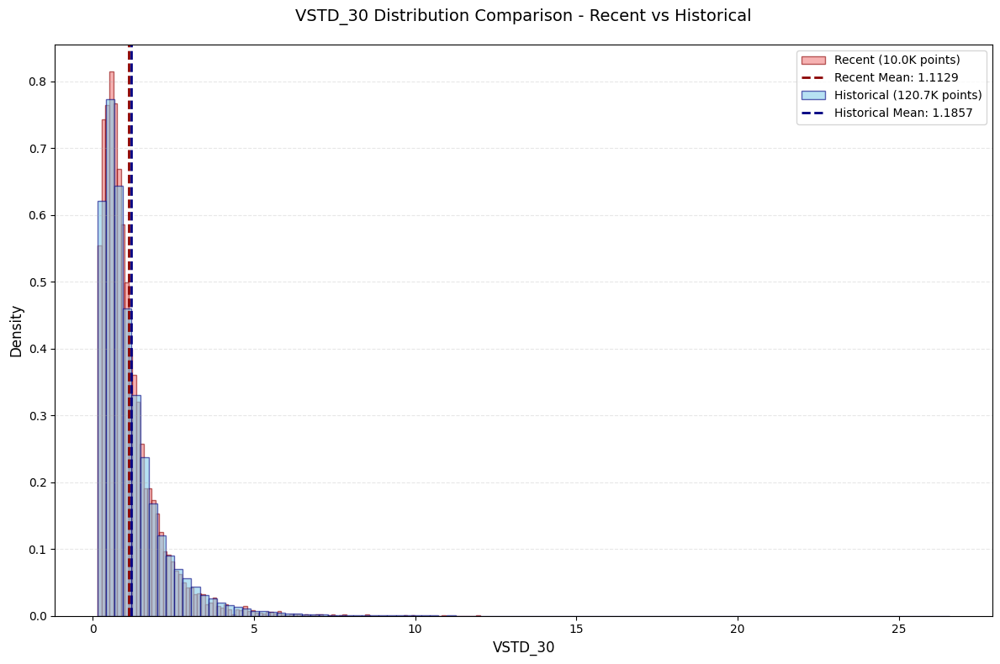

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  94%|█████████▍| 135/143 [02:52<00:11,  1.40s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.000349
   Rank_IC (Spearman): -0.001914
📊 信息比率:
   IR: 0.533223
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMP_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


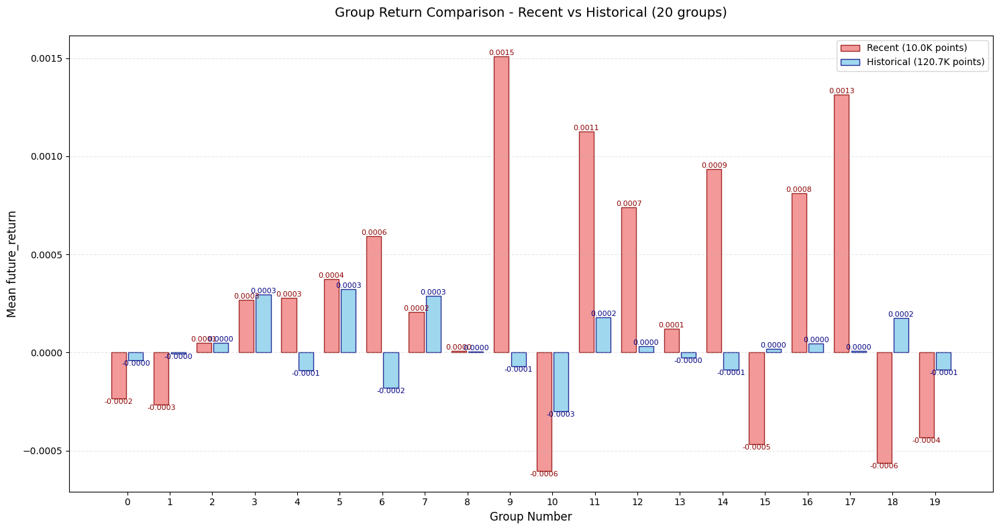

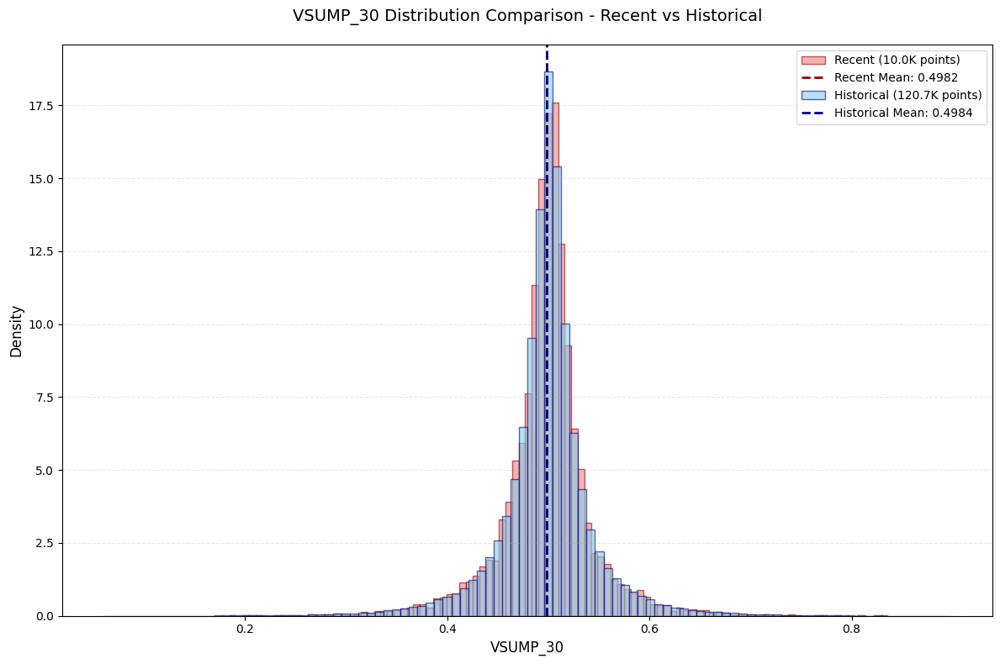

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  95%|█████████▌| 136/143 [02:54<00:10,  1.44s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.000349
   Rank_IC (Spearman): 0.001914
📊 信息比率:
   IR: -0.532993
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMN_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


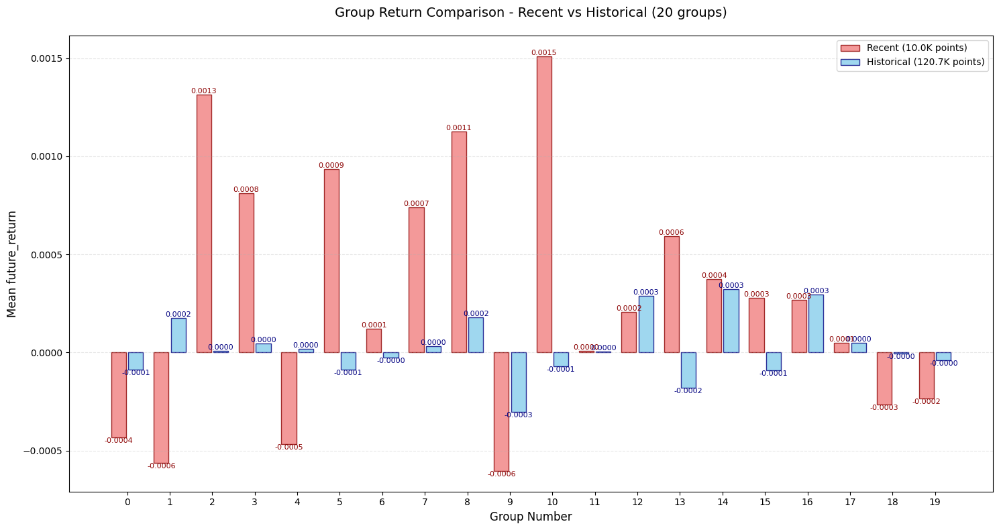

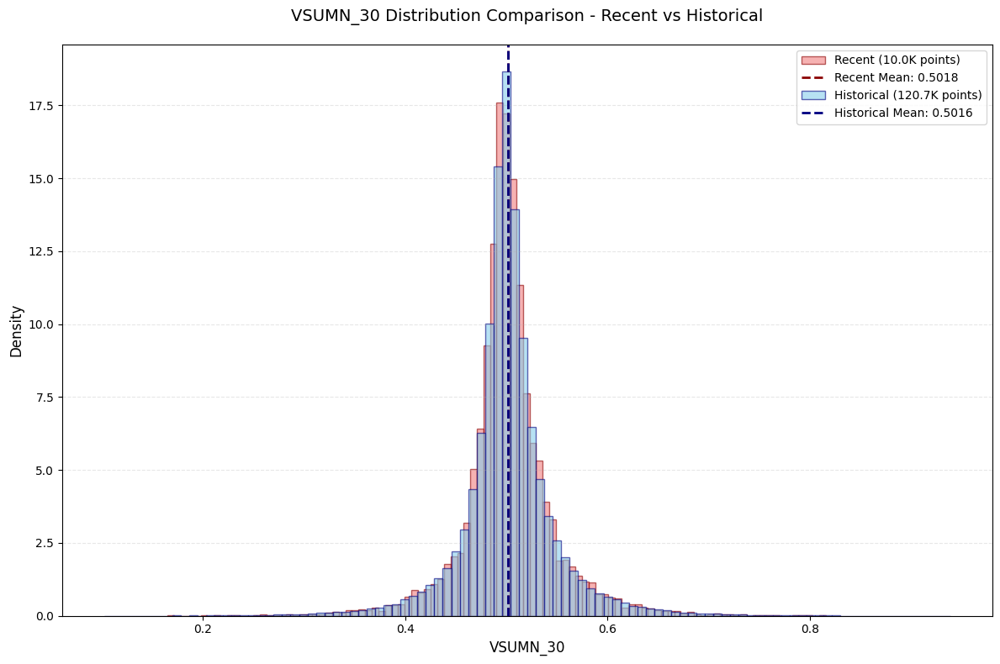

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  96%|█████████▌| 137/143 [02:55<00:08,  1.41s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.000349
   Rank_IC (Spearman): -0.001914
📊 信息比率:
   IR: 0.533223
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMD_30
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


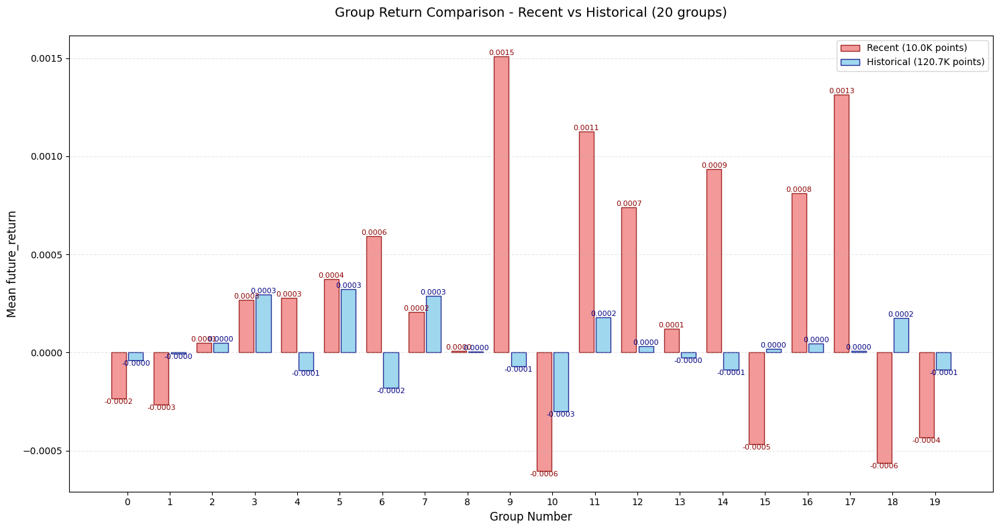

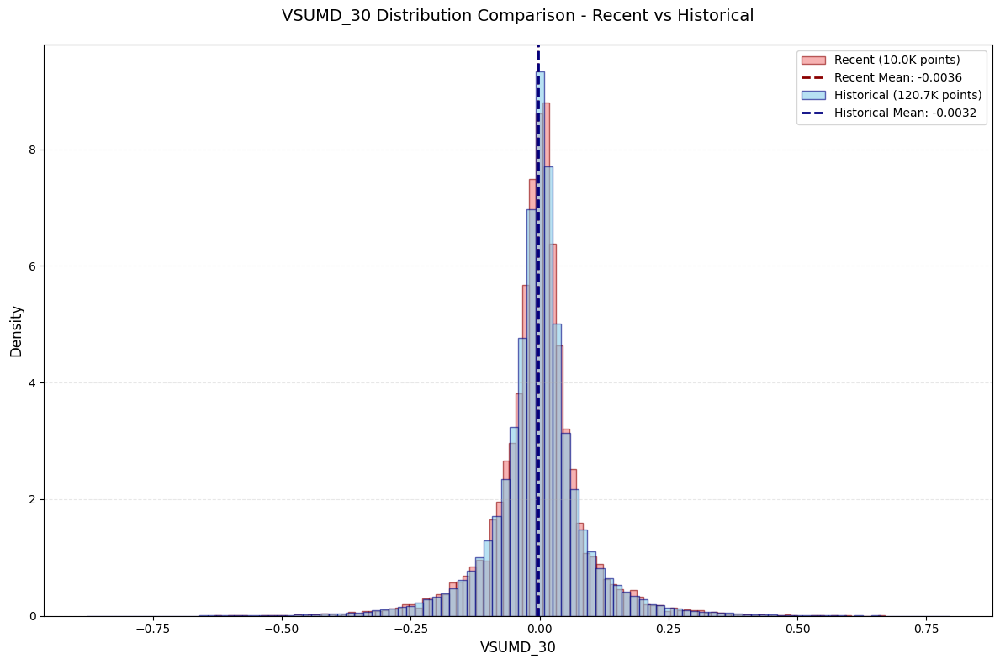

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  97%|█████████▋| 138/143 [02:57<00:07,  1.40s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.002686
   Rank_IC (Spearman): 0.005372
📊 信息比率:
   IR: 0.037100
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VMA_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


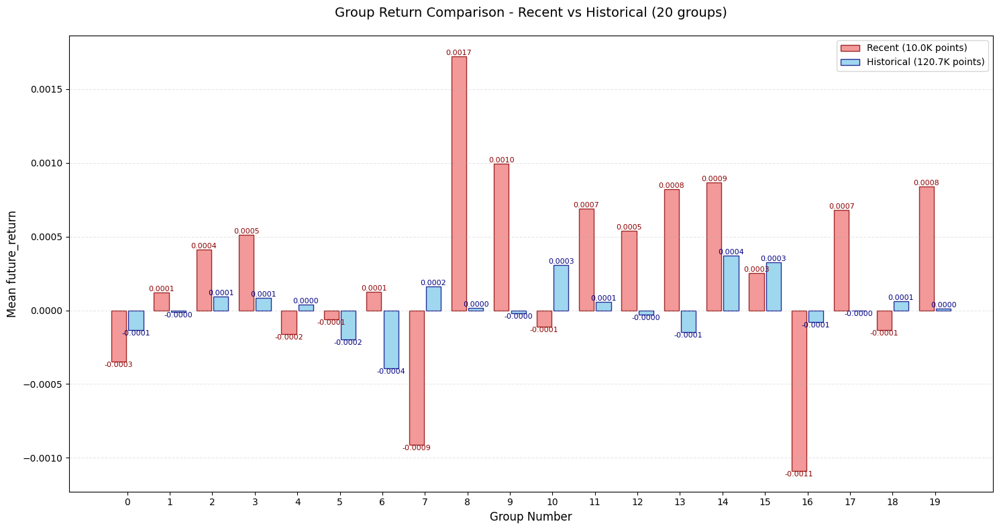

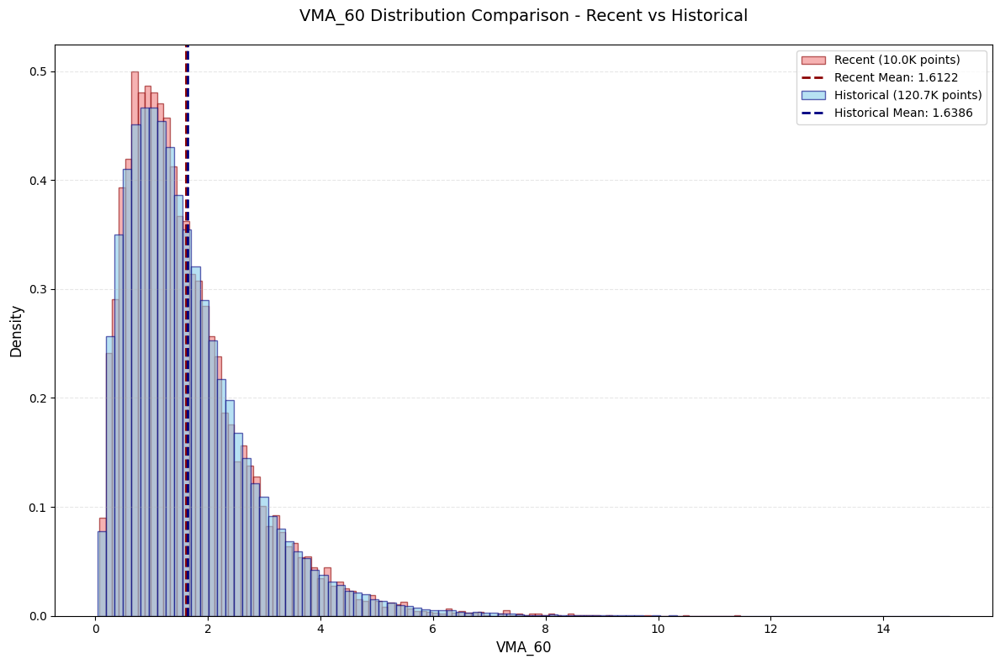

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  97%|█████████▋| 139/143 [02:58<00:05,  1.44s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.000815
   Rank_IC (Spearman): 0.001795
📊 信息比率:
   IR: 0.455698
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSTD_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


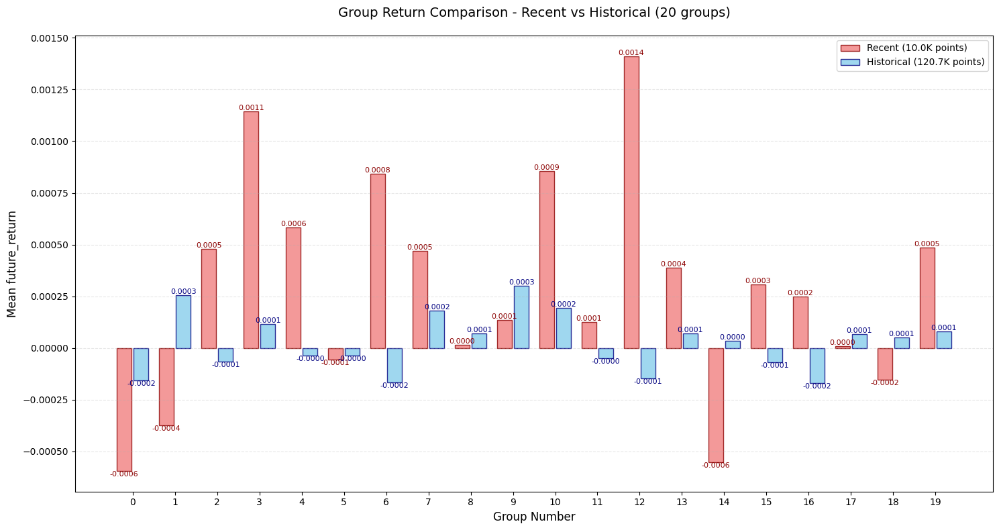

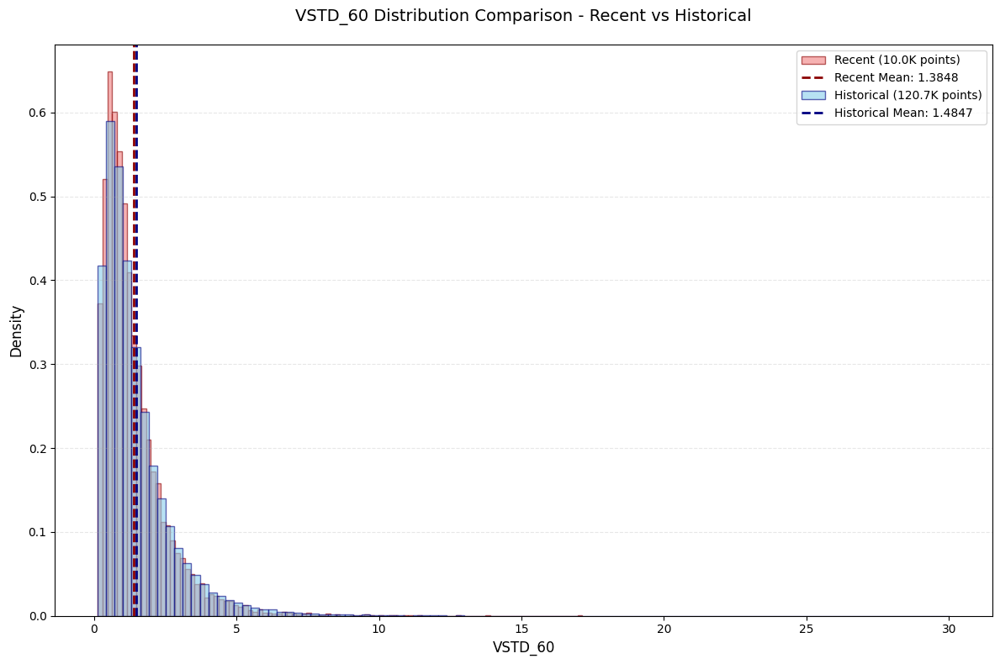

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  98%|█████████▊| 140/143 [03:00<00:04,  1.43s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.004363
   Rank_IC (Spearman): -0.009772
📊 信息比率:
   IR: 0.021981
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMP_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


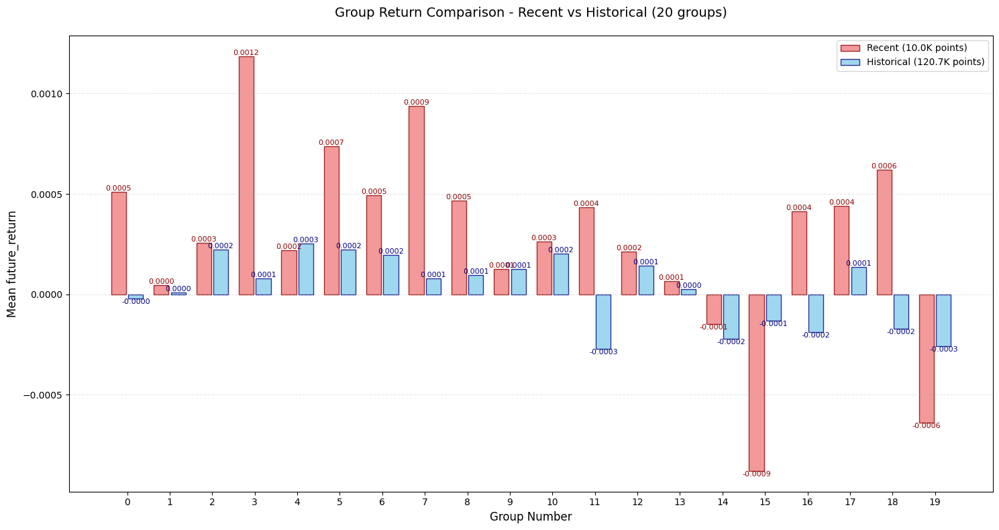

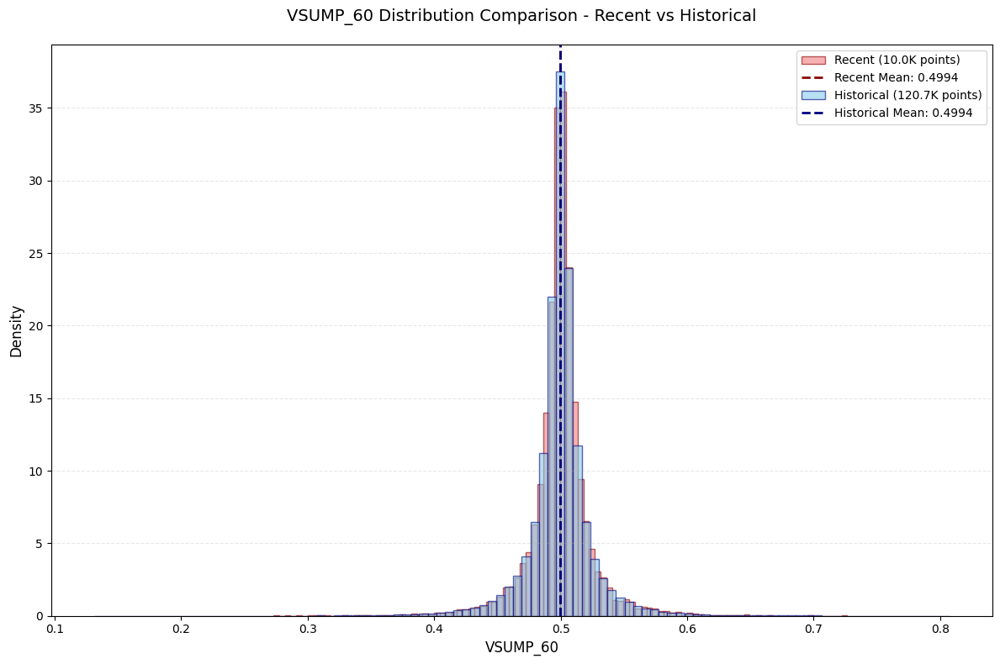

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  99%|█████████▊| 141/143 [03:01<00:02,  1.40s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): 0.004363
   Rank_IC (Spearman): 0.009772
📊 信息比率:
   IR: -0.021976
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMN_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


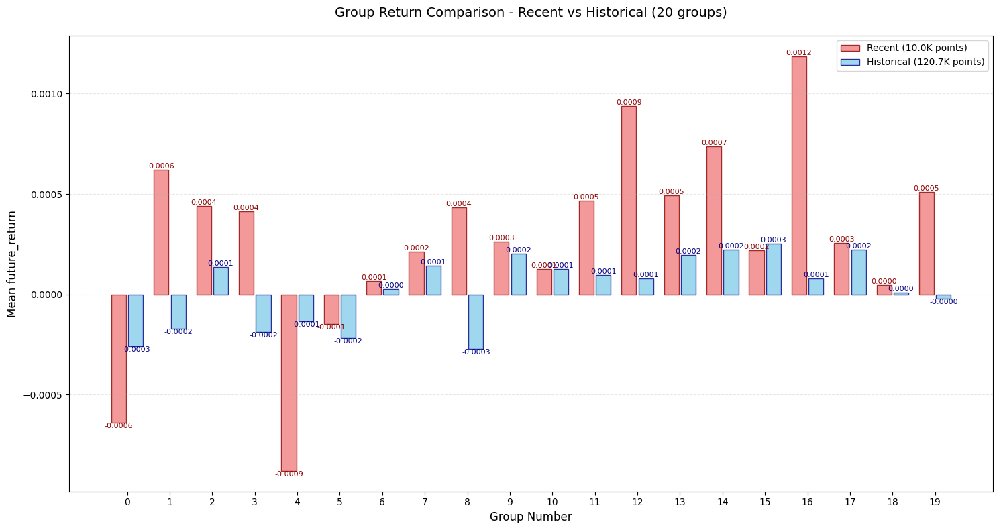

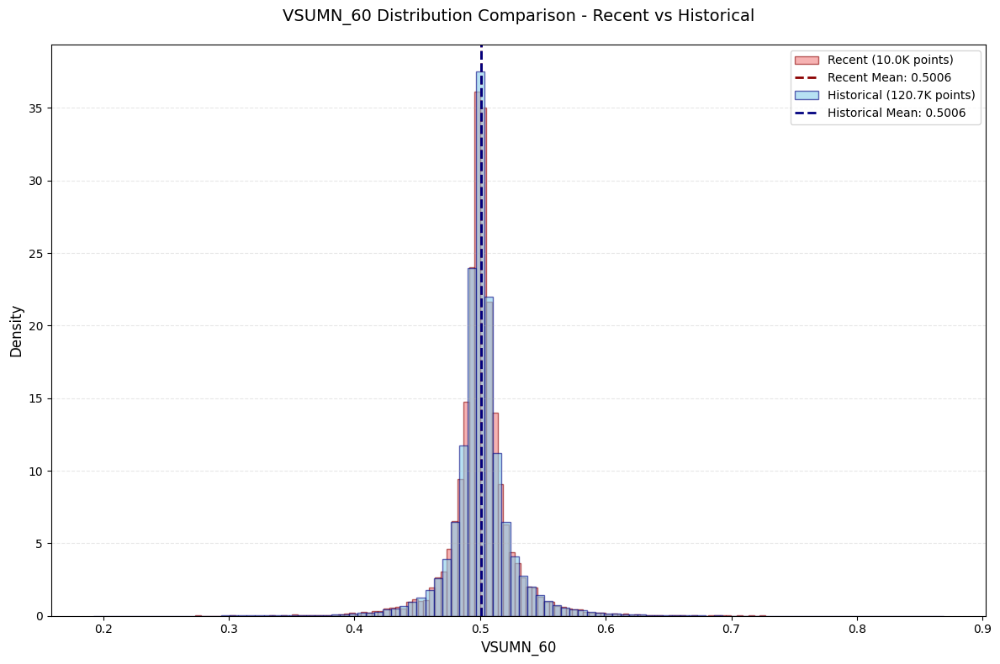

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors:  99%|█████████▉| 142/143 [03:02<00:01,  1.43s/it]


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
🔗 相关性分析:
   IC (Pearson): -0.004363
   Rank_IC (Spearman): -0.009772
📊 信息比率:
   IR: 0.021981
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130685
   因子列: VSUMD_60
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


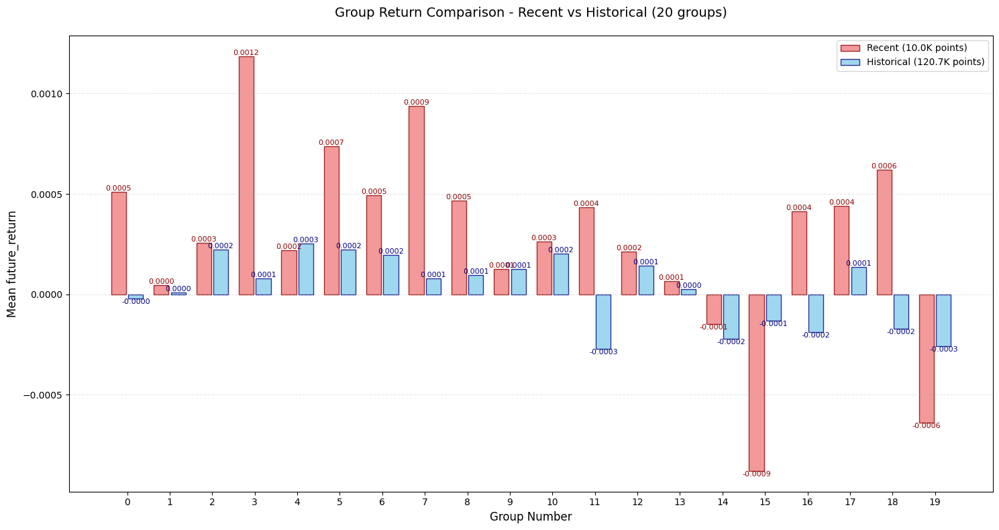

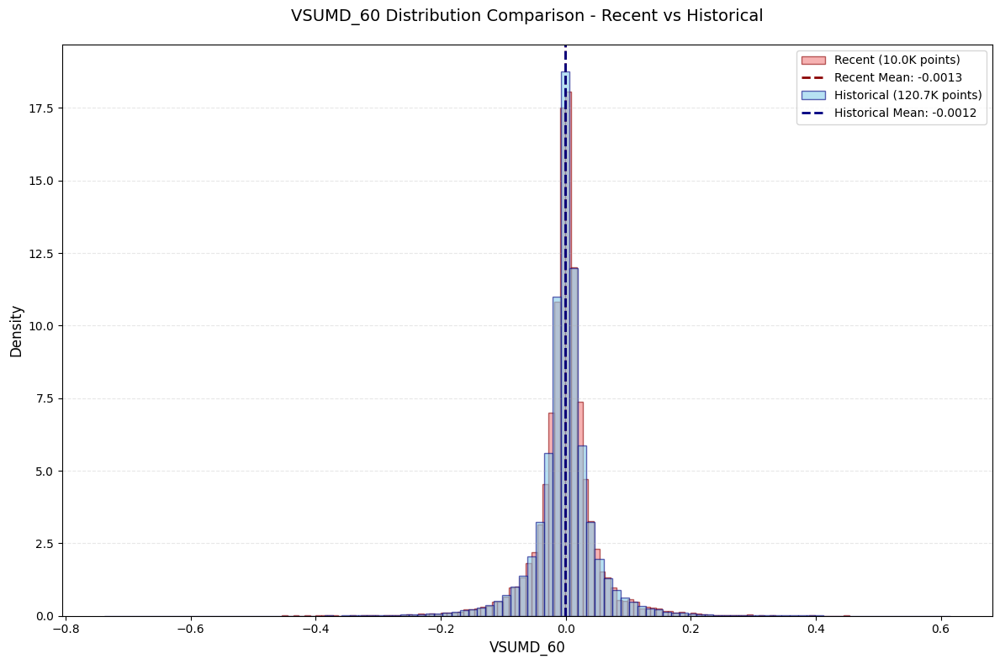

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


Evaluating Factors: 100%|██████████| 143/143 [03:04<00:00,  1.29s/it]


In [46]:
results = {}

# 遍历所有因子
for factor_name in tqdm(all_factors.columns, desc="Evaluating Factors"):
    try:
        evaluator.set_factor(
            factor_data_or_func=all_factors[factor_name],
            factor_name=factor_name
        )
        results[factor_name] = evaluator.run_full_evaluation(
            run_stationarity_test=False
        )
    except Exception as e:
        print(f"Error evaluating {factor_name}: {str(e)}")
        results[factor_name] = None


📊 单币种 (single) 详细评估结果:
--------------------------------------------------
📈 平稳性检验 (ADF):
   p_value: 0.000000
   是否平稳: 是
🔗 相关性分析:
   IC (Pearson): 0.014790
   Rank_IC (Spearman): 0.027601
📊 信息比率:
   IR: 0.402161
   有效分组数: 10
📊 因子分布:
📋 数据概况:
   数据长度: 130747
   因子列: improved_factor_with_rsrs
   收益率列: future_return
   未来收益周期: 10
--------------------------------------------------

🖼️  单币种 (single) 图片展示:
----------------------------------------
📊 显示分组分析图...


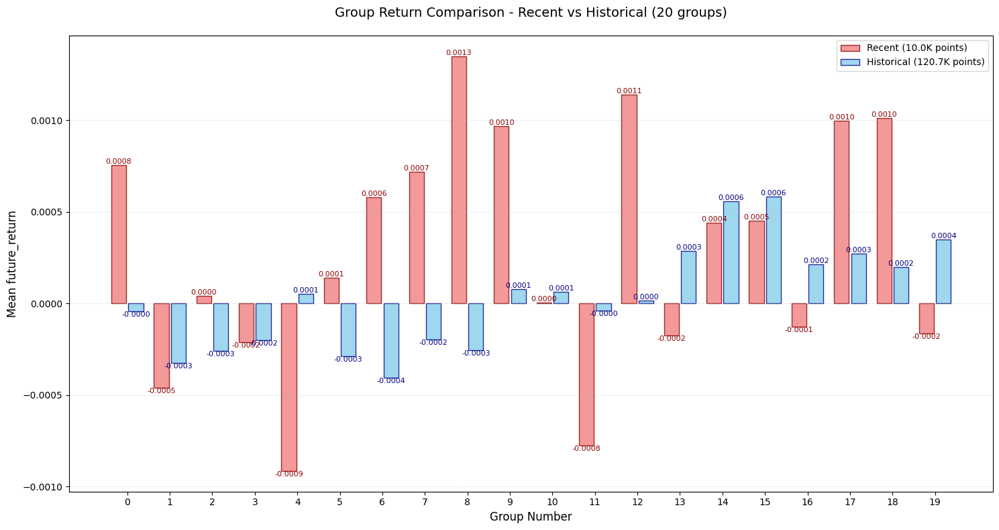

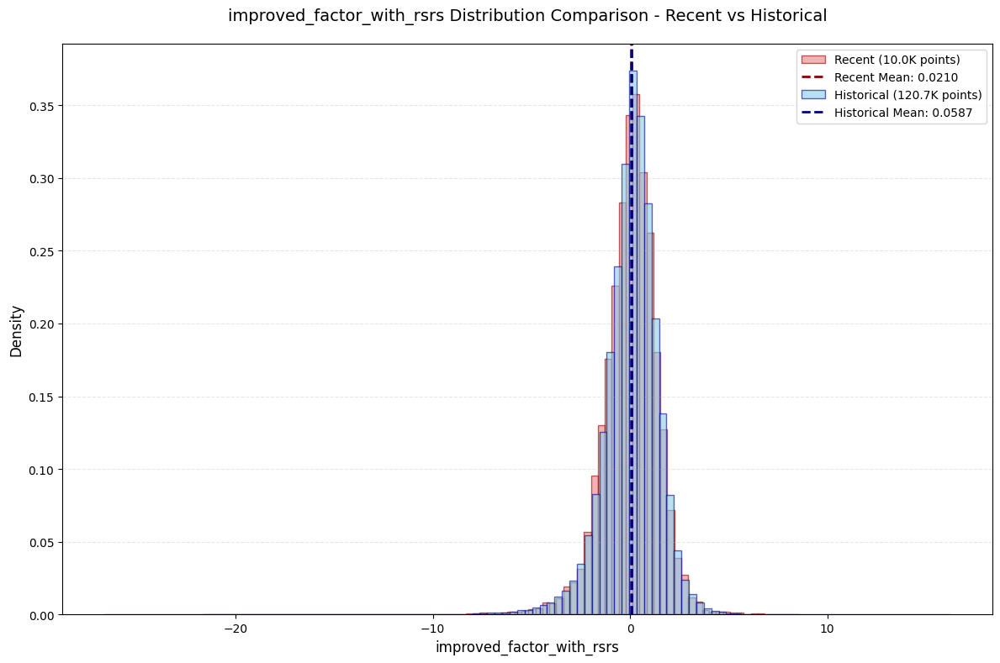

📈 显示因子分布图...
✅ 已显示 2 个图片
----------------------------------------


In [ ]:
# 结果分析（示例）
successful_factors = [k for k, v in results.items() if v is not None]
print(f"成功评估因子数量: {len(successful_factors)}/{len(all_factors.columns)}")